In [1]:
# This code is used for JHU Medical Image Analysis Project
# Copyright: Zhaoshuo Li
import os

import torch
import torchvision
from torch import nn
from torch.autograd import Variable
import torch.nn.functional as functional
from torch.utils.data import DataLoader, Dataset
# from torchvision import transforms
import torchvision.transforms.functional as TF

import copy
import numpy as np
import random
from tensorboardX import SummaryWriter

from dataset import *
from visualization import *
from dice_loss import *
from model_training import *
from albumentations import *
from unet import *

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"]="2"

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:
print(device)

cuda


# Seed pytorch and numpy and random

In [3]:
# IMPORTANT!
# must seed the same value each time when training a new network
seed = 256
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
pretrain_seed = 128

## Hyperparameters

In [4]:
train_batch_size = 1
validation_batch_size = 1
learning_rate = 0.001
num_epochs = 70
num_class = 4

In [5]:
weights = torch.tensor([10.0,2.0,1.0,2.0])
weights = 1/weights
weights = weights/torch.sum(weights)*4
print(weights)

tensor([0.1905, 0.9524, 1.9048, 0.9524])


In [6]:
dice_loss = DICELoss(weights.to(device)) 
dice_loss.to(device)

DICELoss()

## Visualization

In [7]:
# Initialize the visualization environment
writer = SummaryWriter()

# Baseline, without augmentation

### seed

In [8]:
# IMPORTANT!
# must seed the same value each time when training a new network
seed = 256
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

### Unet

In [9]:
# UNET
model = unet(useBN=True)
model.to(device)
print("model created")

model created


### optimizer and learing rate decay

In [10]:
# intialize optimizer and lr decay
optimizer = torch.optim.Adam(model.parameters(),lr=learning_rate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.995)

### data generator

In [11]:
train_both_aug = Compose([
    PadIfNeeded(min_height=256, min_width=256, border_mode=0, value=0,p=1),
    RandomCrop(height=256, width=256, p=1),
])
val_both_aug = Compose([
    PadIfNeeded(min_height=256, min_width=256, border_mode=0, value=0,p=1),
    RandomCrop(height=256, width=256, p=1),
])

train_dataset=ACDCDataset(data_type="train",transform_both=train_both_aug,transform_image=None)
validation_dataset=ACDCDataset(data_type="validation",transform_both=val_both_aug,transform_image=None)

# # show one example
# img_ED,img_ES,label_ED,label_ES = train_dataset.__getitem__(0)
# imshow(img_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(img_ES.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ES.permute(1,2,0)[:,:,3],denormalize=False)

# # show one example
# img_ED,img_ES,label_ED,label_ES = validation_dataset.__getitem__(0)
# imshow(img_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(img_ES.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ES.permute(1,2,0)[:,:,3],denormalize=False)

# intialize the dataloader
train_generator = DataLoader(train_dataset,shuffle=True,batch_size=train_batch_size,num_workers=8)
validation_generator = DataLoader(validation_dataset,shuffle=True,batch_size=validation_batch_size,num_workers=8)

### Start training

Training Started!

EPOCH 1 of 70

Training Loss: 17.0986
0 Class, True Pos 33557528.0, False Pos 125920.0, False Neg 24171256.0, Dice score 0.73
1 Class, True Pos 173033.0, False Pos 7783942.0, False Neg 427454.0, Dice score 0.04
2 Class, True Pos 470216.0, False Pos 13241294.0, False Neg 184511.0, Dice score 0.07
3 Class, True Pos 396415.0, False Pos 3889416.0, False Neg 257351.0, Dice score 0.16
----------
Vaildation Loss: 18.6069
0 Class, True Pos 39120076.0, False Pos 303063.0, False Neg 23948384.0, Dice score 0.76
1 Class, True Pos 141721.0, False Pos 5607092.0, False Neg 489205.0, Dice score 0.04
2 Class, True Pos 494166.0, False Pos 16956520.0, False Neg 173759.0, Dice score 0.05
3 Class, True Pos 319129.0, False Pos 2069942.0, False Neg 325275.0, Dice score 0.21
----------
worst performance: dice 0.13, idx 17


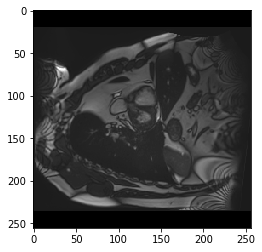

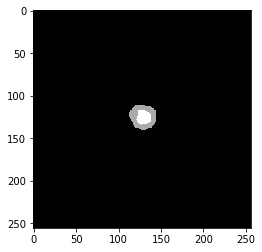

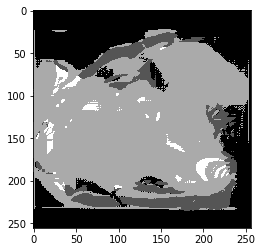

best performance: dice 0.40, idx 30


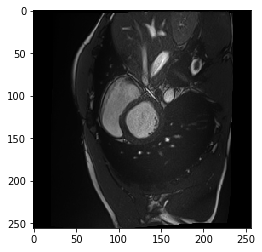

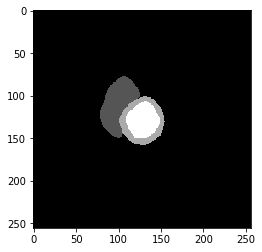

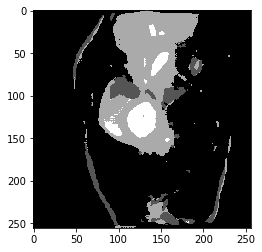

Dice Score: 0.2682
----------

EPOCH 2 of 70

Training Loss: 16.5110
0 Class, True Pos 36267128.0, False Pos 74097.0, False Neg 21487388.0, Dice score 0.77
1 Class, True Pos 328202.0, False Pos 16023199.0, False Neg 259106.0, Dice score 0.04
2 Class, True Pos 484750.0, False Pos 4863127.0, False Neg 162312.0, Dice score 0.16
3 Class, True Pos 409229.0, False Pos 1188034.0, False Neg 239651.0, Dice score 0.36
----------
Vaildation Loss: 18.0610
0 Class, True Pos 42076548.0, False Pos 337898.0, False Neg 20991912.0, Dice score 0.80
1 Class, True Pos 382814.0, False Pos 16254499.0, False Neg 248112.0, Dice score 0.04
2 Class, True Pos 301178.0, False Pos 2729177.0, False Neg 366747.0, Dice score 0.16
3 Class, True Pos 329384.0, False Pos 2600218.0, False Neg 315020.0, Dice score 0.18
----------
worst performance: dice 0.14, idx 17


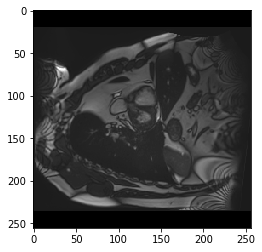

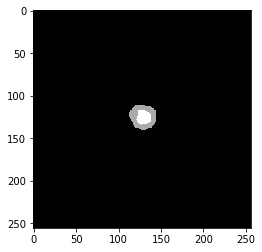

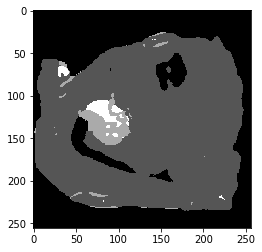

best performance: dice 0.43, idx 30


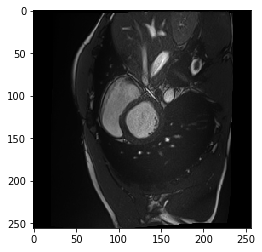

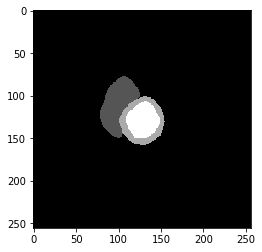

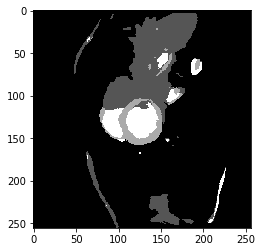

Dice Score: 0.2973
----------

EPOCH 3 of 70

Training Loss: 15.6924
0 Class, True Pos 40397604.0, False Pos 101994.0, False Neg 17334922.0, Dice score 0.82
1 Class, True Pos 388726.0, False Pos 15580445.0, False Neg 208435.0, Dice score 0.05
2 Class, True Pos 465346.0, False Pos 1669973.0, False Neg 189162.0, Dice score 0.33
3 Class, True Pos 403011.0, False Pos 630668.0, False Neg 250562.0, Dice score 0.48
----------
Vaildation Loss: 17.9045
0 Class, True Pos 50052048.0, False Pos 408580.0, False Neg 13016407.0, Dice score 0.88
1 Class, True Pos 256123.0, False Pos 10954143.0, False Neg 374803.0, Dice score 0.04
2 Class, True Pos 283433.0, False Pos 1884681.0, False Neg 384492.0, Dice score 0.20
3 Class, True Pos 261982.0, False Pos 910720.0, False Neg 382422.0, Dice score 0.29
----------
worst performance: dice 0.20, idx 17


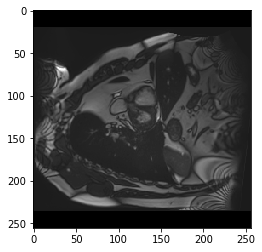

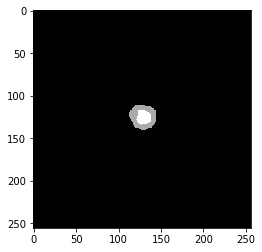

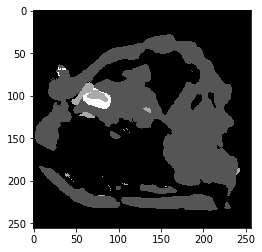

best performance: dice 0.52, idx 4


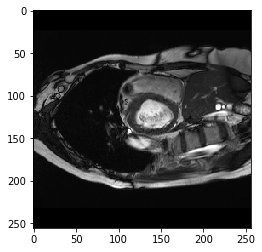

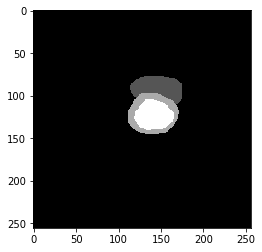

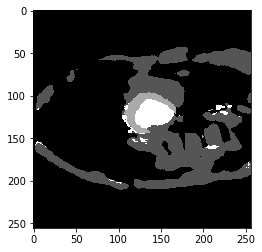

Dice Score: 0.3533
----------

EPOCH 4 of 70

Training Loss: 14.3203
0 Class, True Pos 46526032.0, False Pos 199800.0, False Neg 11191982.0, Dice score 0.89
1 Class, True Pos 361205.0, False Pos 9789014.0, False Neg 243920.0, Dice score 0.07
2 Class, True Pos 431646.0, False Pos 1266085.0, False Neg 228773.0, Dice score 0.37
3 Class, True Pos 424560.0, False Pos 639408.0, False Neg 229632.0, Dice score 0.49
----------
Vaildation Loss: 16.0292
0 Class, True Pos 51534264.0, False Pos 391946.0, False Neg 11534195.0, Dice score 0.90
1 Class, True Pos 269474.0, False Pos 8078763.0, False Neg 361452.0, Dice score 0.06
2 Class, True Pos 442158.0, False Pos 2450361.0, False Neg 225767.0, Dice score 0.25
3 Class, True Pos 408171.0, False Pos 1436577.0, False Neg 236233.0, Dice score 0.33
----------
worst performance: dice 0.24, idx 17


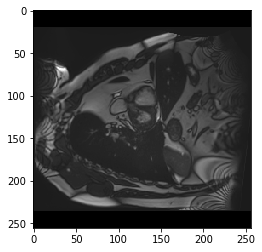

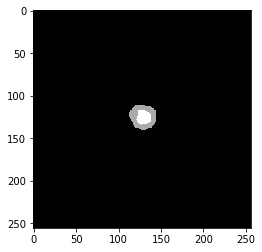

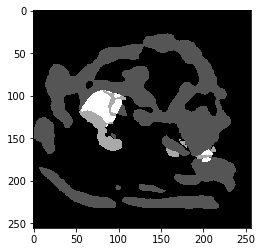

best performance: dice 0.54, idx 30


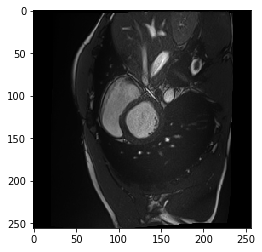

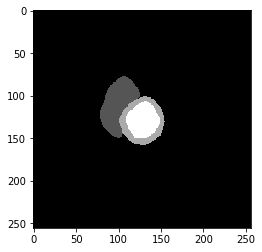

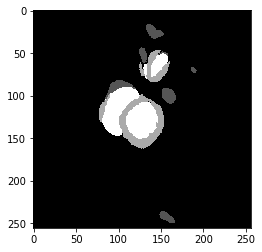

Dice Score: 0.3832
----------

EPOCH 5 of 70

Training Loss: 11.4718
0 Class, True Pos 51662152.0, False Pos 385175.0, False Neg 6060034.0, Dice score 0.94
1 Class, True Pos 367656.0, False Pos 5651786.0, False Neg 236475.0, Dice score 0.11
2 Class, True Pos 385043.0, False Pos 472564.0, False Neg 272296.0, Dice score 0.51
3 Class, True Pos 468362.0, False Pos 245016.0, False Neg 185736.0, Dice score 0.69
----------
Vaildation Loss: 13.6631
0 Class, True Pos 59861640.0, False Pos 782483.0, False Neg 3206808.0, Dice score 0.97
1 Class, True Pos 357320.0, False Pos 3274106.0, False Neg 273606.0, Dice score 0.17
2 Class, True Pos 228739.0, False Pos 153151.0, False Neg 439186.0, Dice score 0.44
3 Class, True Pos 299035.0, False Pos 55229.0, False Neg 345369.0, Dice score 0.60
----------
worst performance: dice 0.24, idx 3


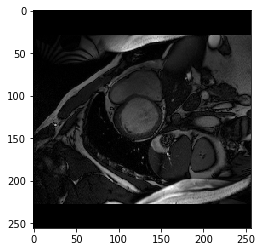

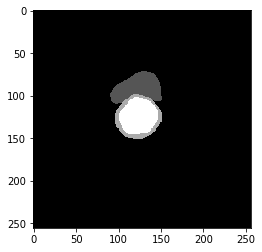

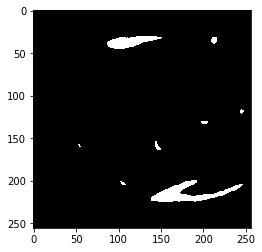

best performance: dice 0.73, idx 41


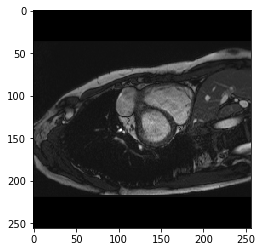

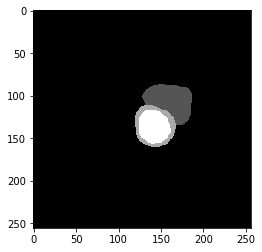

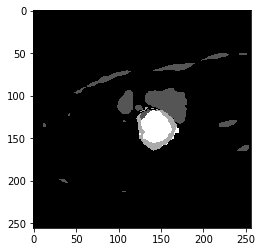

Dice Score: 0.5425
----------

EPOCH 6 of 70

Training Loss: 9.1226
0 Class, True Pos 55654652.0, False Pos 432371.0, False Neg 2104399.0, Dice score 0.98
1 Class, True Pos 358062.0, False Pos 1976630.0, False Neg 224016.0, Dice score 0.25
2 Class, True Pos 385889.0, False Pos 309144.0, False Neg 262794.0, Dice score 0.57
3 Class, True Pos 420291.0, False Pos 100716.0, False Neg 227652.0, Dice score 0.72
----------
Vaildation Loss: 11.4337
0 Class, True Pos 62486012.0, False Pos 661544.0, False Neg 582445.0, Dice score 0.99
1 Class, True Pos 368819.0, False Pos 614748.0, False Neg 262107.0, Dice score 0.46
2 Class, True Pos 250705.0, False Pos 153947.0, False Neg 417220.0, Dice score 0.47
3 Class, True Pos 389724.0, False Pos 86213.0, False Neg 254680.0, Dice score 0.70
----------
worst performance: dice 0.25, idx 2


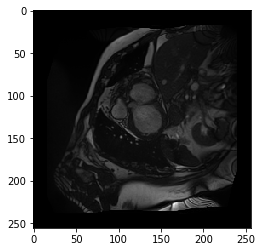

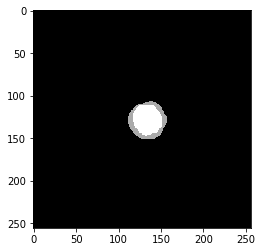

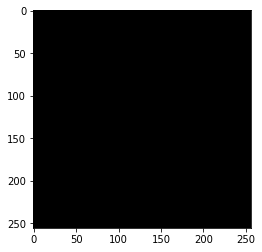

best performance: dice 0.83, idx 49


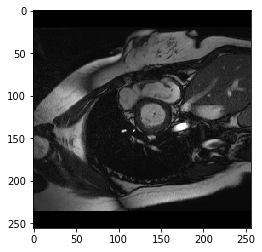

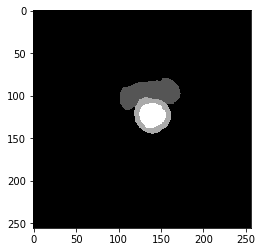

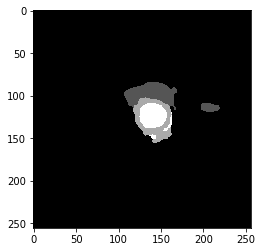

Dice Score: 0.6526
----------

EPOCH 7 of 70

Training Loss: 6.5248
0 Class, True Pos 57368800.0, False Pos 438877.0, False Neg 388713.0, Dice score 0.99
1 Class, True Pos 360713.0, False Pos 292601.0, False Neg 228852.0, Dice score 0.58
2 Class, True Pos 412560.0, False Pos 243864.0, False Neg 229917.0, Dice score 0.64
3 Class, True Pos 458242.0, False Pos 62097.0, False Neg 189957.0, Dice score 0.78
----------
Vaildation Loss: 9.2642
0 Class, True Pos 62963408.0, False Pos 828171.0, False Neg 105053.0, Dice score 0.99
1 Class, True Pos 295594.0, False Pos 102714.0, False Neg 335332.0, Dice score 0.57
2 Class, True Pos 299695.0, False Pos 145431.0, False Neg 368230.0, Dice score 0.54
3 Class, True Pos 356151.0, False Pos 20552.0, False Neg 288253.0, Dice score 0.70
----------
worst performance: dice 0.25, idx 2


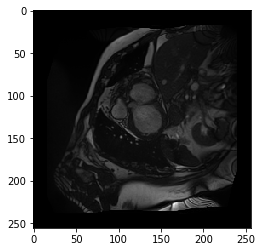

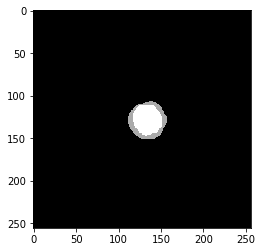

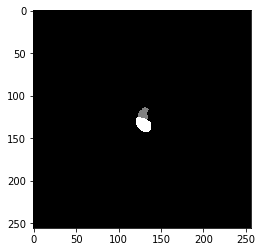

best performance: dice 0.87, idx 37


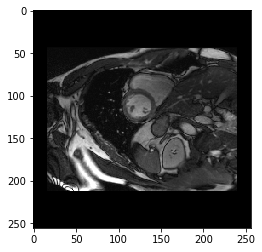

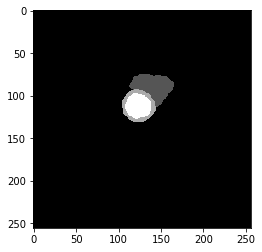

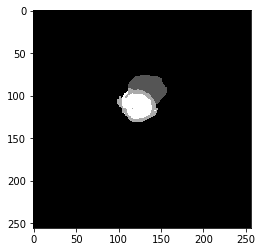

Dice Score: 0.7008
----------

EPOCH 8 of 70

Training Loss: 5.2171
0 Class, True Pos 57430304.0, False Pos 396001.0, False Neg 289561.0, Dice score 0.99
1 Class, True Pos 398391.0, False Pos 207268.0, False Neg 204896.0, Dice score 0.66
2 Class, True Pos 443746.0, False Pos 212235.0, False Neg 216673.0, Dice score 0.67
3 Class, True Pos 496548.0, False Pos 53270.0, False Neg 157644.0, Dice score 0.82
----------
Vaildation Loss: 10.3875
0 Class, True Pos 62866268.0, False Pos 833778.0, False Neg 202187.0, Dice score 0.99
1 Class, True Pos 333503.0, False Pos 302241.0, False Neg 297423.0, Dice score 0.53
2 Class, True Pos 258608.0, False Pos 107173.0, False Neg 409317.0, Dice score 0.50
3 Class, True Pos 293933.0, False Pos 16206.0, False Neg 350471.0, Dice score 0.62
----------
worst performance: dice 0.25, idx 1


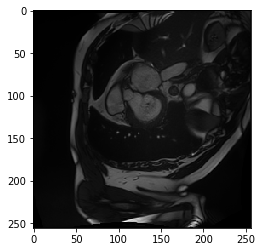

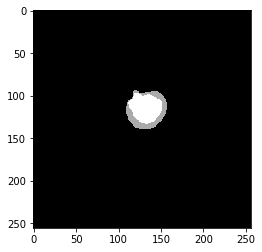

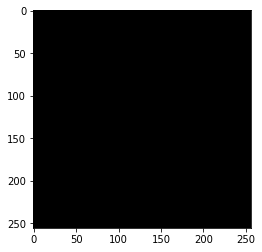

best performance: dice 0.88, idx 37


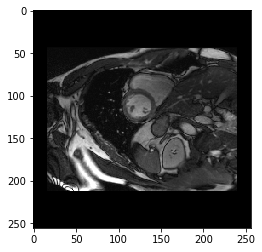

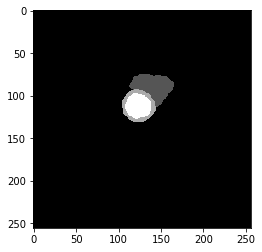

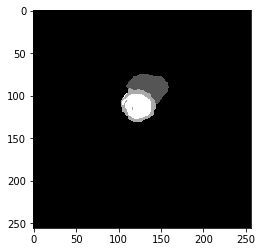

----------

EPOCH 9 of 70

Training Loss: 4.8216
0 Class, True Pos 57503920.0, False Pos 380834.0, False Neg 219729.0, Dice score 0.99
1 Class, True Pos 410508.0, False Pos 164081.0, False Neg 189600.0, Dice score 0.70
2 Class, True Pos 447992.0, False Pos 194827.0, False Neg 211814.0, Dice score 0.69
3 Class, True Pos 490467.0, False Pos 45126.0, False Neg 163725.0, Dice score 0.82
----------
Vaildation Loss: 9.5117
0 Class, True Pos 62946684.0, False Pos 829688.0, False Neg 121763.0, Dice score 0.99
1 Class, True Pos 363396.0, False Pos 136527.0, False Neg 267530.0, Dice score 0.64
2 Class, True Pos 250575.0, False Pos 139165.0, False Neg 417350.0, Dice score 0.47
3 Class, True Pos 337509.0, False Pos 8158.0, False Neg 306895.0, Dice score 0.68
----------
worst performance: dice 0.25, idx 2


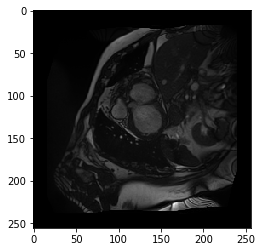

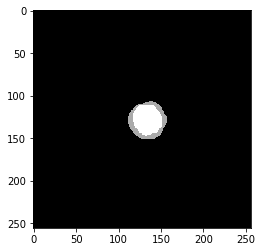

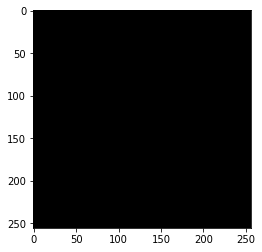

best performance: dice 0.89, idx 45


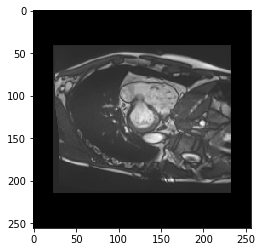

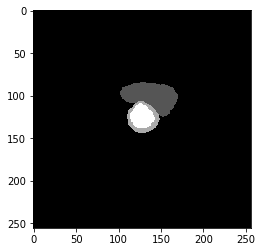

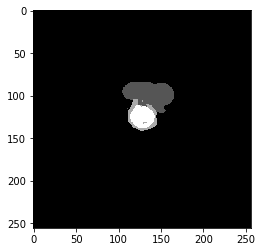

----------

EPOCH 10 of 70

Training Loss: 4.3757
0 Class, True Pos 57545456.0, False Pos 339624.0, False Neg 206404.0, Dice score 1.00
1 Class, True Pos 409738.0, False Pos 130965.0, False Neg 186955.0, Dice score 0.72
2 Class, True Pos 470838.0, False Pos 189796.0, False Neg 175502.0, Dice score 0.72
3 Class, True Pos 505989.0, False Pos 45355.0, False Neg 136879.0, Dice score 0.85
----------
Vaildation Loss: 7.8813
0 Class, True Pos 62665144.0, False Pos 603722.0, False Neg 403309.0, Dice score 0.99
1 Class, True Pos 412258.0, False Pos 280168.0, False Neg 218668.0, Dice score 0.62
2 Class, True Pos 337471.0, False Pos 232261.0, False Neg 330454.0, Dice score 0.55
3 Class, True Pos 438519.0, False Pos 42165.0, False Neg 205885.0, Dice score 0.78
----------
worst performance: dice 0.25, idx 33


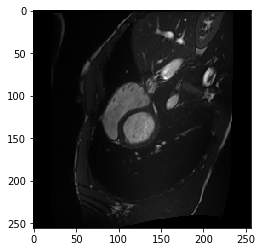

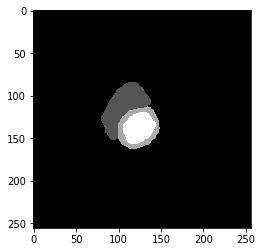

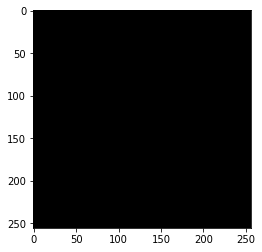

best performance: dice 0.92, idx 37


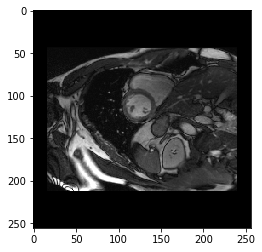

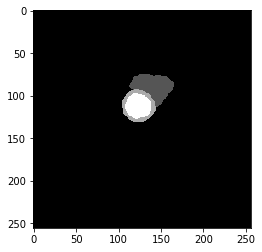

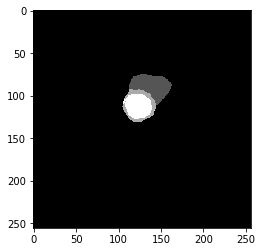

Dice Score: 0.7350
----------

EPOCH 11 of 70

Training Loss: 3.9587
0 Class, True Pos 57563008.0, False Pos 307059.0, False Neg 183992.0, Dice score 1.00
1 Class, True Pos 436123.0, False Pos 131803.0, False Neg 154134.0, Dice score 0.75
2 Class, True Pos 479111.0, False Pos 162634.0, False Neg 173206.0, Dice score 0.74
3 Class, True Pos 519675.0, False Pos 38343.0, False Neg 128507.0, Dice score 0.86
----------
Vaildation Loss: 10.4029
0 Class, True Pos 62997296.0, False Pos 999719.0, False Neg 71151.0, Dice score 0.99
1 Class, True Pos 363494.0, False Pos 127671.0, False Neg 267432.0, Dice score 0.65
2 Class, True Pos 183139.0, False Pos 88375.0, False Neg 484786.0, Dice score 0.39
3 Class, True Pos 241303.0, False Pos 10705.0, False Neg 403101.0, Dice score 0.54
----------
worst performance: dice 0.25, idx 2


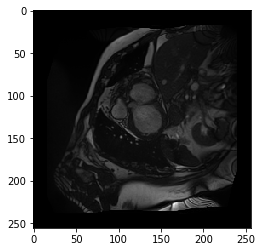

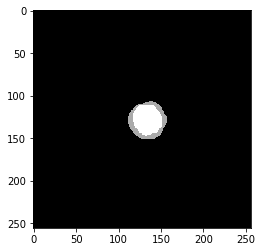

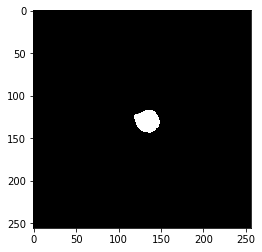

best performance: dice 0.91, idx 37


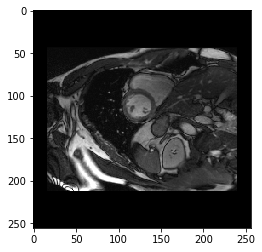

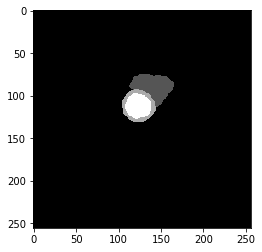

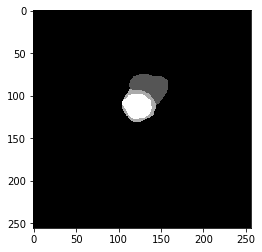

----------

EPOCH 12 of 70

Training Loss: 3.9245
0 Class, True Pos 57554216.0, False Pos 335638.0, False Neg 193859.0, Dice score 1.00
1 Class, True Pos 427115.0, False Pos 126926.0, False Neg 156634.0, Dice score 0.75
2 Class, True Pos 466913.0, False Pos 157255.0, False Neg 186919.0, Dice score 0.73
3 Class, True Pos 518965.0, False Pos 50736.0, False Neg 133143.0, Dice score 0.85
----------
Vaildation Loss: 7.2655
0 Class, True Pos 62959656.0, False Pos 663797.0, False Neg 108807.0, Dice score 0.99
1 Class, True Pos 363845.0, False Pos 89372.0, False Neg 267081.0, Dice score 0.67
2 Class, True Pos 366951.0, False Pos 135766.0, False Neg 300974.0, Dice score 0.63
3 Class, True Pos 419801.0, False Pos 12530.0, False Neg 224603.0, Dice score 0.78
----------
worst performance: dice 0.25, idx 2


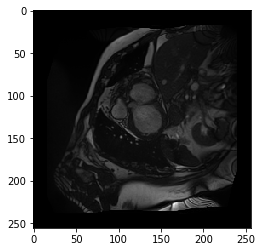

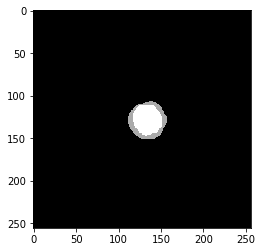

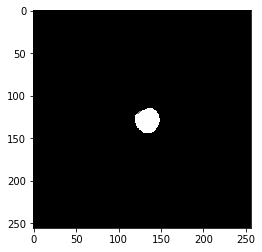

best performance: dice 0.91, idx 37


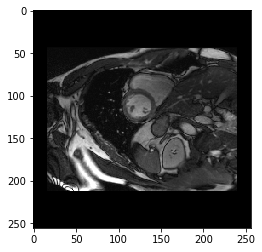

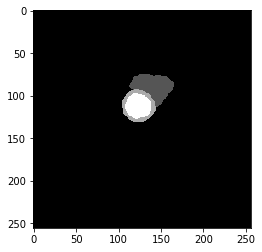

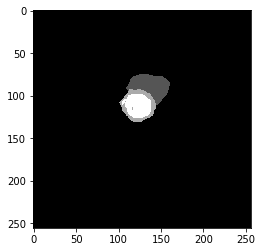

Dice Score: 0.7680
----------

EPOCH 13 of 70

Training Loss: 3.5215
0 Class, True Pos 57566628.0, False Pos 311416.0, False Neg 162528.0, Dice score 1.00
1 Class, True Pos 434372.0, False Pos 109952.0, False Neg 167136.0, Dice score 0.76
2 Class, True Pos 486973.0, False Pos 148397.0, False Neg 165950.0, Dice score 0.76
3 Class, True Pos 547146.0, False Pos 32873.0, False Neg 107024.0, Dice score 0.89
----------
Vaildation Loss: 7.5130
0 Class, True Pos 62947232.0, False Pos 650303.0, False Neg 121220.0, Dice score 0.99
1 Class, True Pos 403030.0, False Pos 99080.0, False Neg 227896.0, Dice score 0.71
2 Class, True Pos 320700.0, False Pos 148100.0, False Neg 347225.0, Dice score 0.56
3 Class, True Pos 428297.0, False Pos 14965.0, False Neg 216107.0, Dice score 0.79
----------
worst performance: dice 0.25, idx 2


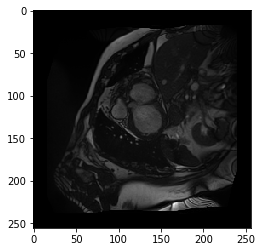

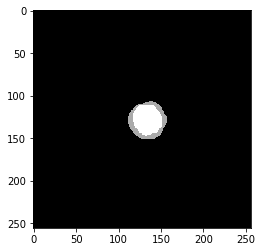

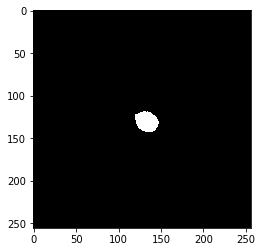

best performance: dice 0.93, idx 37


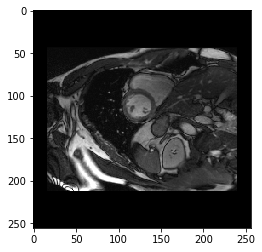

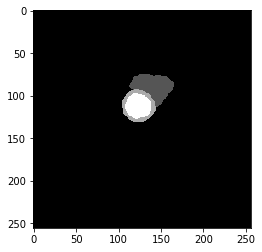

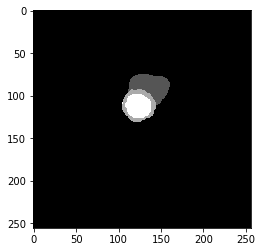

----------

EPOCH 14 of 70

Training Loss: 3.4133
0 Class, True Pos 57557512.0, False Pos 302356.0, False Neg 161099.0, Dice score 1.00
1 Class, True Pos 453286.0, False Pos 107804.0, False Neg 151686.0, Dice score 0.78
2 Class, True Pos 498864.0, False Pos 147772.0, False Neg 161122.0, Dice score 0.76
3 Class, True Pos 537631.0, False Pos 32536.0, False Neg 116561.0, Dice score 0.88
----------
Vaildation Loss: 9.8114
0 Class, True Pos 63002460.0, False Pos 1039702.0, False Neg 66000.0, Dice score 0.99
1 Class, True Pos 284303.0, False Pos 52758.0, False Neg 346623.0, Dice score 0.59
2 Class, True Pos 252765.0, False Pos 77038.0, False Neg 415160.0, Dice score 0.51
3 Class, True Pos 291878.0, False Pos 10811.0, False Neg 352526.0, Dice score 0.62
----------
worst performance: dice 0.25, idx 1


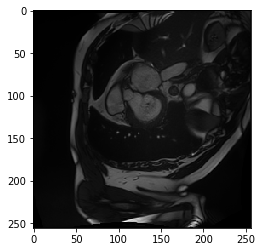

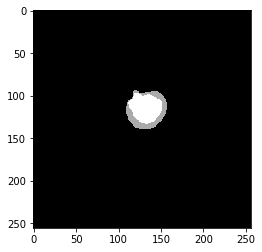

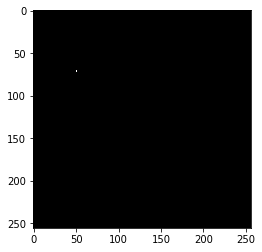

best performance: dice 0.92, idx 37


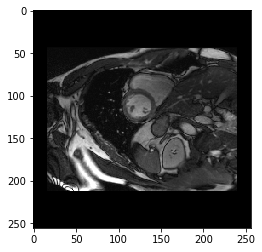

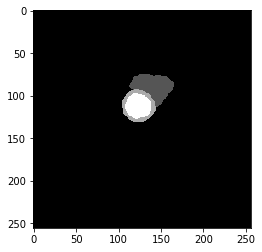

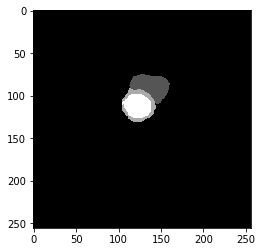

----------

EPOCH 15 of 70

Training Loss: 3.3699
0 Class, True Pos 57551304.0, False Pos 290895.0, False Neg 169765.0, Dice score 1.00
1 Class, True Pos 468004.0, False Pos 111922.0, False Neg 136858.0, Dice score 0.79
2 Class, True Pos 491222.0, False Pos 144039.0, False Neg 166423.0, Dice score 0.76
3 Class, True Pos 543700.0, False Pos 36682.0, False Neg 110492.0, Dice score 0.88
----------
Vaildation Loss: 5.6557
0 Class, True Pos 62728536.0, False Pos 309268.0, False Neg 339929.0, Dice score 0.99
1 Class, True Pos 476678.0, False Pos 251114.0, False Neg 154248.0, Dice score 0.70
2 Class, True Pos 449293.0, False Pos 154360.0, False Neg 218632.0, Dice score 0.71
3 Class, True Pos 552750.0, False Pos 89721.0, False Neg 91654.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 20


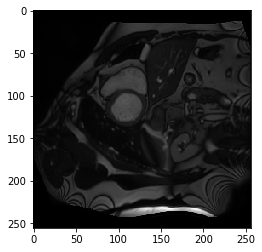

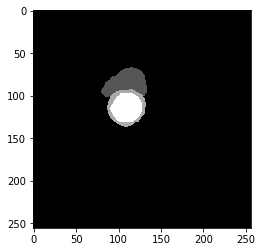

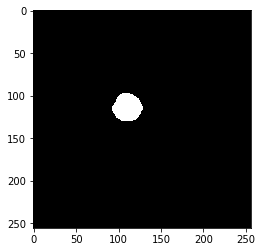

best performance: dice 0.90, idx 0


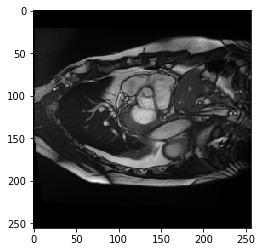

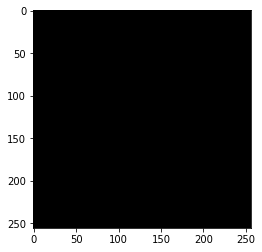

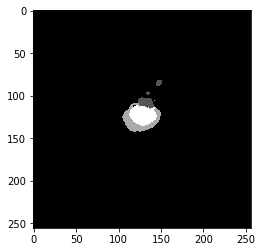

Dice Score: 0.8156
----------

EPOCH 16 of 70

Training Loss: 3.0327
0 Class, True Pos 57604092.0, False Pos 253034.0, False Neg 133349.0, Dice score 1.00
1 Class, True Pos 457507.0, False Pos 91803.0, False Neg 128294.0, Dice score 0.81
2 Class, True Pos 504993.0, False Pos 131588.0, False Neg 155325.0, Dice score 0.78
3 Class, True Pos 562816.0, False Pos 31919.0, False Neg 91376.0, Dice score 0.90
----------
Vaildation Loss: 6.1362
0 Class, True Pos 62958036.0, False Pos 522831.0, False Neg 110417.0, Dice score 0.99
1 Class, True Pos 402859.0, False Pos 77384.0, False Neg 228067.0, Dice score 0.73
2 Class, True Pos 443295.0, False Pos 166684.0, False Neg 224630.0, Dice score 0.69
3 Class, True Pos 432421.0, False Pos 8198.0, False Neg 211983.0, Dice score 0.80
----------
worst performance: dice 0.25, idx 20


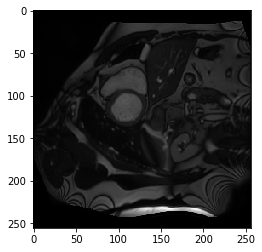

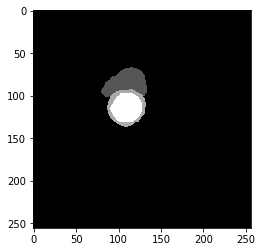

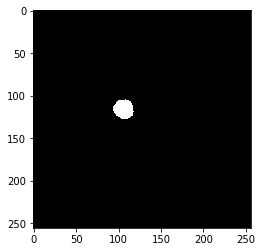

best performance: dice 0.91, idx 39


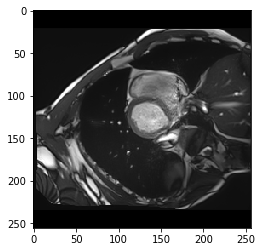

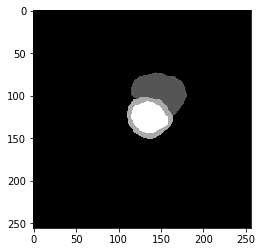

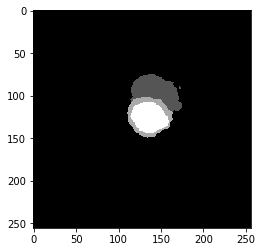

----------

EPOCH 17 of 70

Training Loss: 2.7892
0 Class, True Pos 57605212.0, False Pos 220487.0, False Neg 129712.0, Dice score 1.00
1 Class, True Pos 483509.0, False Pos 88757.0, False Neg 108029.0, Dice score 0.83
2 Class, True Pos 521576.0, False Pos 126901.0, False Neg 135534.0, Dice score 0.80
3 Class, True Pos 563303.0, False Pos 28013.0, False Neg 90883.0, Dice score 0.90
----------
Vaildation Loss: 6.4215
0 Class, True Pos 63014332.0, False Pos 659196.0, False Neg 54125.0, Dice score 0.99
1 Class, True Pos 267121.0, False Pos 28397.0, False Neg 363805.0, Dice score 0.58
2 Class, True Pos 417304.0, False Pos 99004.0, False Neg 250621.0, Dice score 0.70
3 Class, True Pos 496437.0, False Pos 29921.0, False Neg 147967.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 20


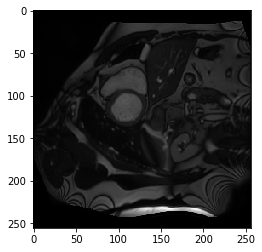

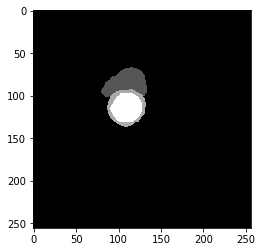

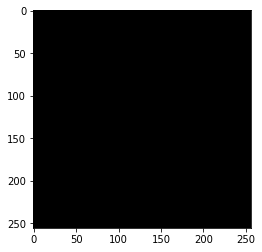

best performance: dice 0.92, idx 37


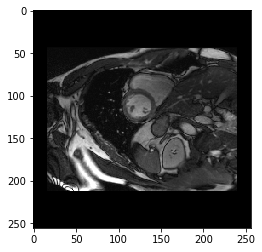

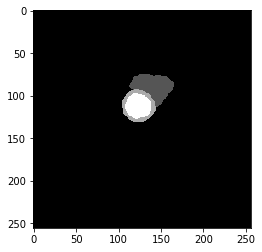

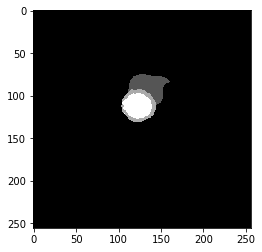

----------

EPOCH 18 of 70

Training Loss: 2.6977
0 Class, True Pos 57613648.0, False Pos 207796.0, False Neg 130004.0, Dice score 1.00
1 Class, True Pos 485343.0, False Pos 82978.0, False Neg 106107.0, Dice score 0.84
2 Class, True Pos 518727.0, False Pos 125057.0, False Neg 130979.0, Dice score 0.80
3 Class, True Pos 574292.0, False Pos 29921.0, False Neg 78662.0, Dice score 0.91
----------
Vaildation Loss: 4.9976
0 Class, True Pos 62823324.0, False Pos 318958.0, False Neg 245126.0, Dice score 1.00
1 Class, True Pos 479749.0, False Pos 159661.0, False Neg 151177.0, Dice score 0.76
2 Class, True Pos 504177.0, False Pos 191765.0, False Neg 163748.0, Dice score 0.74
3 Class, True Pos 501865.0, False Pos 32206.0, False Neg 142539.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 20


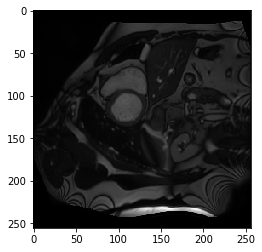

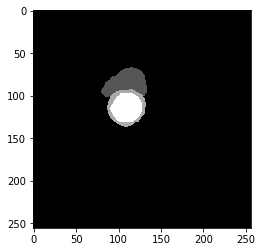

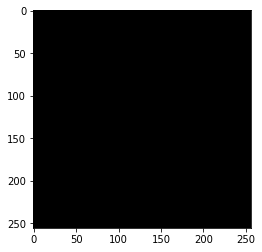

best performance: dice 0.93, idx 37


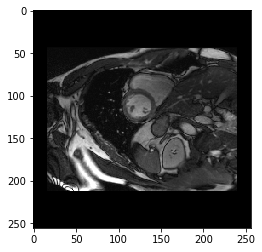

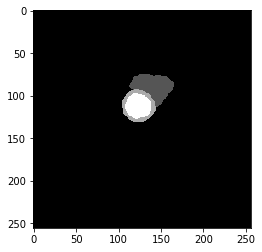

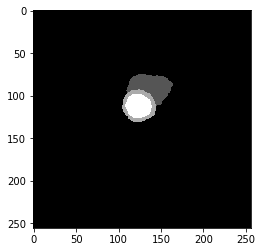

Dice Score: 0.8355
----------

EPOCH 19 of 70

Training Loss: 2.6454
0 Class, True Pos 57603600.0, False Pos 220223.0, False Neg 124677.0, Dice score 1.00
1 Class, True Pos 488095.0, False Pos 81690.0, False Neg 112606.0, Dice score 0.83
2 Class, True Pos 525369.0, False Pos 118431.0, False Neg 129999.0, Dice score 0.81
3 Class, True Pos 569994.0, False Pos 30365.0, False Neg 83427.0, Dice score 0.91
----------
Vaildation Loss: 7.3348
0 Class, True Pos 62992036.0, False Pos 678381.0, False Neg 76414.0, Dice score 0.99
1 Class, True Pos 335888.0, False Pos 37623.0, False Neg 295038.0, Dice score 0.67
2 Class, True Pos 334402.0, False Pos 109398.0, False Neg 333523.0, Dice score 0.60
3 Class, True Pos 483914.0, False Pos 40063.0, False Neg 160490.0, Dice score 0.83
----------
worst performance: dice 0.25, idx 33


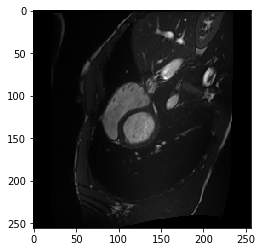

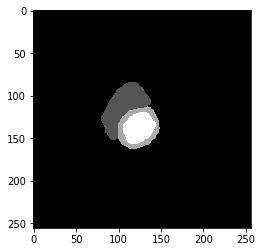

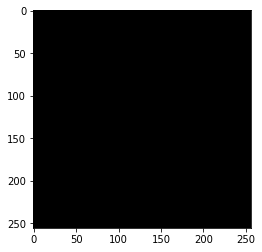

best performance: dice 0.91, idx 37


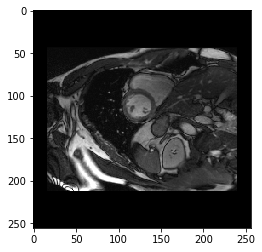

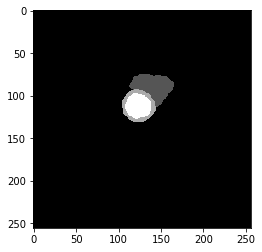

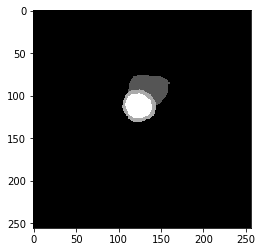

----------

EPOCH 20 of 70

Training Loss: 2.6166
0 Class, True Pos 57640924.0, False Pos 215372.0, False Neg 115335.0, Dice score 1.00
1 Class, True Pos 481145.0, False Pos 76395.0, False Neg 107240.0, Dice score 0.84
2 Class, True Pos 520175.0, False Pos 111480.0, False Neg 128039.0, Dice score 0.81
3 Class, True Pos 562735.0, False Pos 29539.0, False Neg 82172.0, Dice score 0.91
----------
Vaildation Loss: 5.5485
0 Class, True Pos 62914748.0, False Pos 447320.0, False Neg 153697.0, Dice score 1.00
1 Class, True Pos 454541.0, False Pos 124691.0, False Neg 176385.0, Dice score 0.75
2 Class, True Pos 437334.0, False Pos 119105.0, False Neg 230591.0, Dice score 0.71
3 Class, True Pos 488936.0, False Pos 25025.0, False Neg 155468.0, Dice score 0.84
----------
worst performance: dice 0.25, idx 20


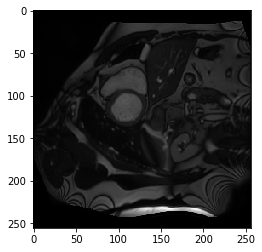

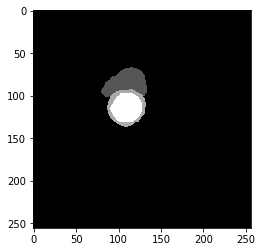

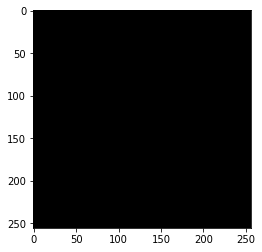

best performance: dice 0.93, idx 37


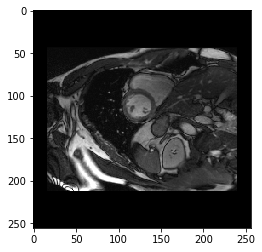

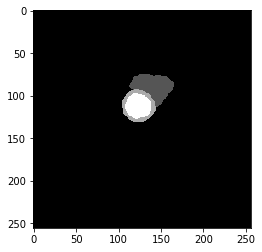

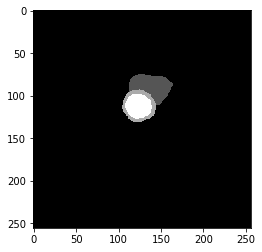

----------

EPOCH 21 of 70

Training Loss: 2.4452
0 Class, True Pos 57617168.0, False Pos 193510.0, False Neg 106490.0, Dice score 1.00
1 Class, True Pos 503356.0, False Pos 67332.0, False Neg 96131.0, Dice score 0.86
2 Class, True Pos 540562.0, False Pos 113106.0, False Neg 119857.0, Dice score 0.82
3 Class, True Pos 574967.0, False Pos 27755.0, False Neg 79225.0, Dice score 0.91
----------
Vaildation Loss: 6.4906
0 Class, True Pos 62901480.0, False Pos 535341.0, False Neg 166977.0, Dice score 0.99
1 Class, True Pos 433489.0, False Pos 124859.0, False Neg 197437.0, Dice score 0.73
2 Class, True Pos 369861.0, False Pos 92982.0, False Neg 298064.0, Dice score 0.65
3 Class, True Pos 496195.0, False Pos 57505.0, False Neg 148209.0, Dice score 0.83
----------
worst performance: dice 0.25, idx 33


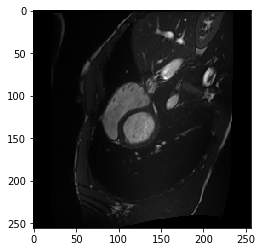

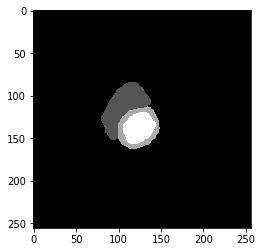

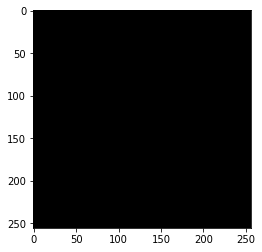

best performance: dice 0.91, idx 9


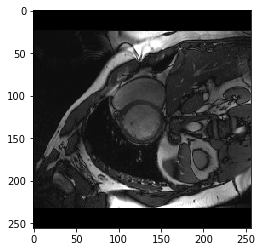

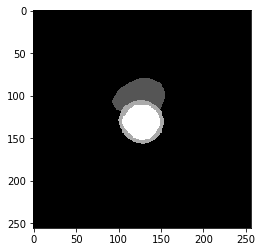

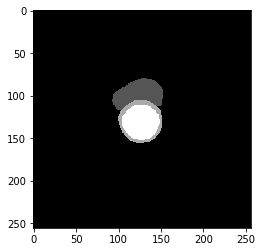

----------

EPOCH 22 of 70

Training Loss: 2.4417
0 Class, True Pos 57613024.0, False Pos 192308.0, False Neg 105601.0, Dice score 1.00
1 Class, True Pos 509751.0, False Pos 70985.0, False Neg 95183.0, Dice score 0.86
2 Class, True Pos 533588.0, False Pos 108279.0, False Neg 126424.0, Dice score 0.82
3 Class, True Pos 578501.0, False Pos 31327.0, False Neg 75691.0, Dice score 0.92
----------
Vaildation Loss: 6.9536
0 Class, True Pos 63003448.0, False Pos 692459.0, False Neg 65000.0, Dice score 0.99
1 Class, True Pos 374456.0, False Pos 44810.0, False Neg 256470.0, Dice score 0.71
2 Class, True Pos 362385.0, False Pos 93296.0, False Neg 305540.0, Dice score 0.65
3 Class, True Pos 428098.0, False Pos 12751.0, False Neg 216306.0, Dice score 0.79
----------
worst performance: dice 0.25, idx 2


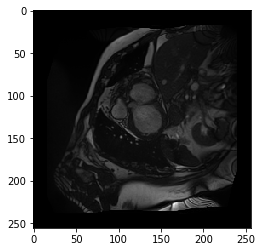

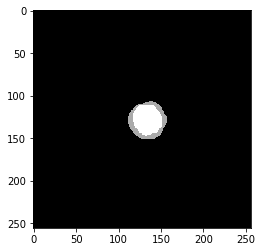

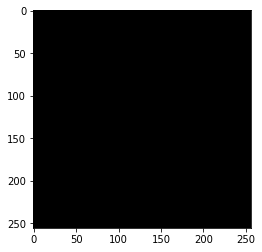

best performance: dice 0.93, idx 37


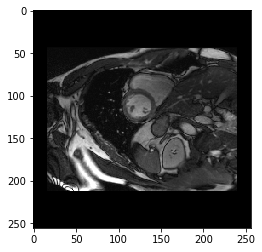

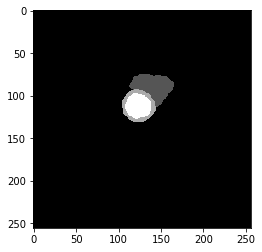

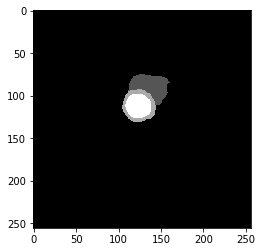

----------

EPOCH 23 of 70

Training Loss: 2.3119
0 Class, True Pos 57630436.0, False Pos 161117.0, False Neg 113314.0, Dice score 1.00
1 Class, True Pos 503785.0, False Pos 72197.0, False Neg 79992.0, Dice score 0.87
2 Class, True Pos 543159.0, False Pos 108151.0, False Neg 112920.0, Dice score 0.83
3 Class, True Pos 590484.0, False Pos 28438.0, False Neg 63677.0, Dice score 0.93
----------
Vaildation Loss: 5.0584
0 Class, True Pos 62818876.0, False Pos 310511.0, False Neg 249581.0, Dice score 1.00
1 Class, True Pos 430981.0, False Pos 84288.0, False Neg 199945.0, Dice score 0.75
2 Class, True Pos 521880.0, False Pos 238207.0, False Neg 146045.0, Dice score 0.73
3 Class, True Pos 537980.0, False Pos 68989.0, False Neg 106424.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 20


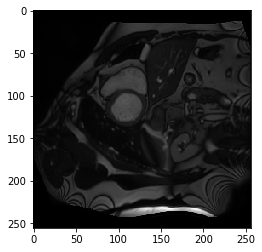

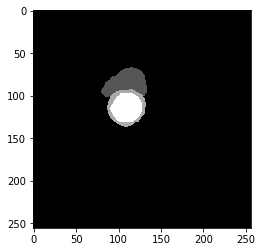

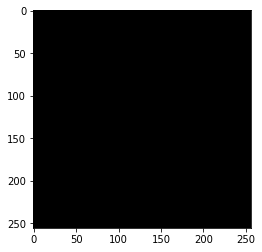

best performance: dice 0.94, idx 19


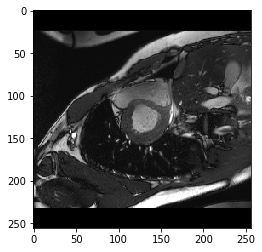

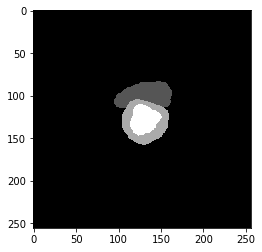

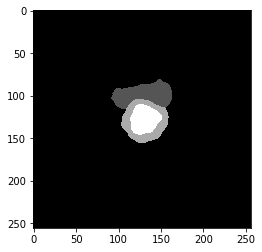

----------

EPOCH 24 of 70

Training Loss: 2.2811
0 Class, True Pos 57635048.0, False Pos 168987.0, False Neg 100026.0, Dice score 1.00
1 Class, True Pos 504799.0, False Pos 60350.0, False Neg 83271.0, Dice score 0.88
2 Class, True Pos 537262.0, False Pos 107849.0, False Neg 123157.0, Dice score 0.82
3 Class, True Pos 593229.0, False Pos 30231.0, False Neg 60963.0, Dice score 0.93
----------
Vaildation Loss: 4.7462
0 Class, True Pos 63002444.0, False Pos 452759.0, False Neg 66013.0, Dice score 1.00
1 Class, True Pos 390401.0, False Pos 36035.0, False Neg 240525.0, Dice score 0.74
2 Class, True Pos 473931.0, False Pos 105951.0, False Neg 193994.0, Dice score 0.76
3 Class, True Pos 528411.0, False Pos 21780.0, False Neg 115993.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


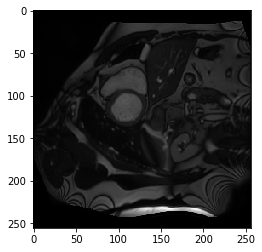

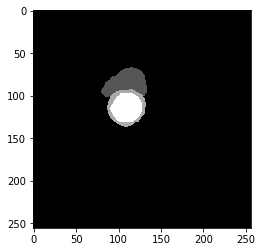

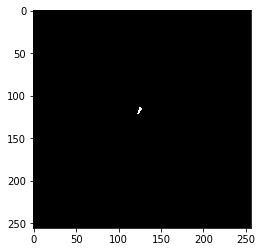

best performance: dice 0.94, idx 37


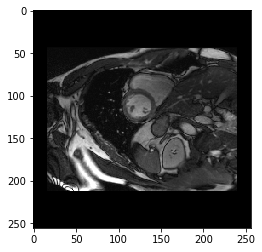

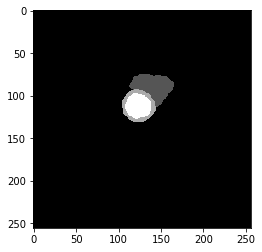

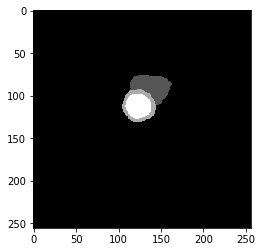

Dice Score: 0.8447
----------

EPOCH 25 of 70

Training Loss: 2.2530
0 Class, True Pos 57650744.0, False Pos 173708.0, False Neg 97638.0, Dice score 1.00
1 Class, True Pos 488404.0, False Pos 59002.0, False Neg 103654.0, Dice score 0.86
2 Class, True Pos 539449.0, False Pos 104935.0, False Neg 106145.0, Dice score 0.84
3 Class, True Pos 590253.0, False Pos 31272.0, False Neg 61480.0, Dice score 0.93
----------
Vaildation Loss: 5.4715
0 Class, True Pos 62945148.0, False Pos 455965.0, False Neg 123311.0, Dice score 1.00
1 Class, True Pos 435136.0, False Pos 84494.0, False Neg 195790.0, Dice score 0.76
2 Class, True Pos 459320.0, False Pos 130277.0, False Neg 208605.0, Dice score 0.73
3 Class, True Pos 484991.0, False Pos 16383.0, False Neg 159413.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 20


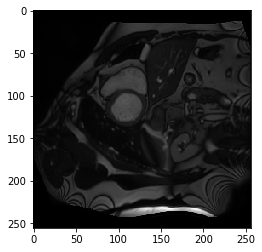

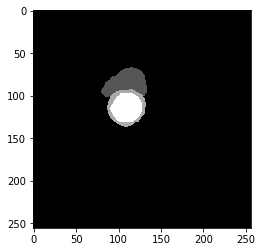

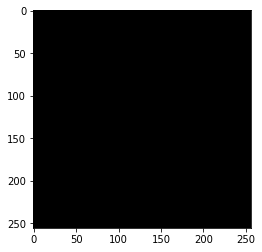

best performance: dice 0.94, idx 37


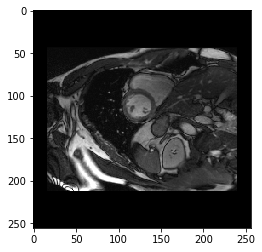

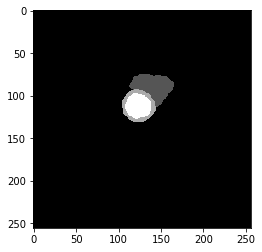

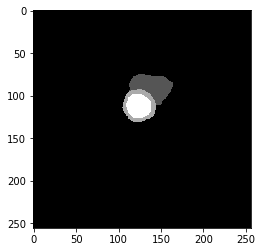

----------

EPOCH 26 of 70

Training Loss: 2.1599
0 Class, True Pos 57632632.0, False Pos 157066.0, False Neg 91921.0, Dice score 1.00
1 Class, True Pos 513988.0, False Pos 60335.0, False Neg 84884.0, Dice score 0.88
2 Class, True Pos 547751.0, False Pos 102881.0, False Neg 112386.0, Dice score 0.84
3 Class, True Pos 597037.0, False Pos 26064.0, False Neg 57155.0, Dice score 0.93
----------
Vaildation Loss: 5.1906
0 Class, True Pos 62847696.0, False Pos 373144.0, False Neg 220769.0, Dice score 1.00
1 Class, True Pos 454311.0, False Pos 133869.0, False Neg 176615.0, Dice score 0.75
2 Class, True Pos 466801.0, False Pos 151583.0, False Neg 201124.0, Dice score 0.73
3 Class, True Pos 535631.0, False Pos 48685.0, False Neg 108773.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


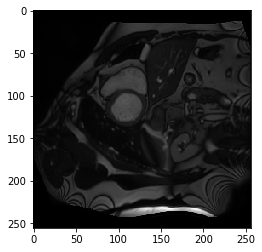

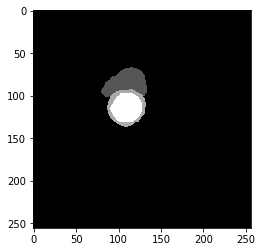

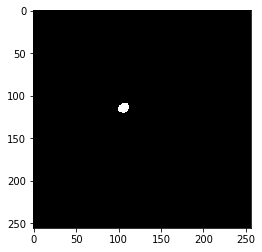

best performance: dice 0.94, idx 37


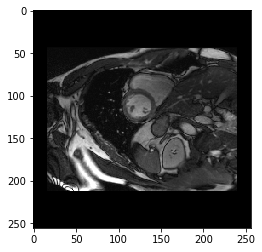

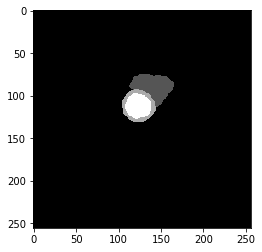

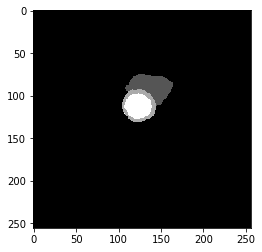

----------

EPOCH 27 of 70

Training Loss: 2.0093
0 Class, True Pos 57638352.0, False Pos 135692.0, False Neg 86220.0, Dice score 1.00
1 Class, True Pos 526056.0, False Pos 55195.0, False Neg 72933.0, Dice score 0.89
2 Class, True Pos 559139.0, False Pos 97026.0, False Neg 100876.0, Dice score 0.85
3 Class, True Pos 600706.0, False Pos 25602.0, False Neg 53486.0, Dice score 0.94
----------
Vaildation Loss: 4.8422
0 Class, True Pos 62938984.0, False Pos 391761.0, False Neg 129469.0, Dice score 1.00
1 Class, True Pos 457793.0, False Pos 84204.0, False Neg 173133.0, Dice score 0.78
2 Class, True Pos 451679.0, False Pos 109980.0, False Neg 216246.0, Dice score 0.73
3 Class, True Pos 540443.0, False Pos 36864.0, False Neg 103961.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


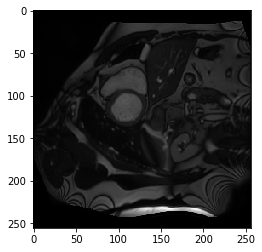

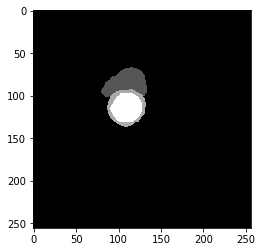

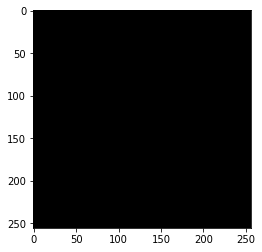

best performance: dice 0.94, idx 37


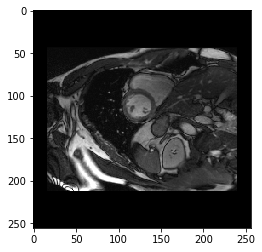

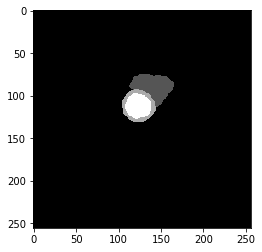

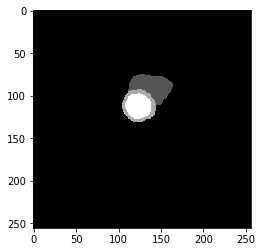

Dice Score: 0.8490
----------

EPOCH 28 of 70

Training Loss: 1.9759
0 Class, True Pos 57663832.0, False Pos 126301.0, False Neg 88525.0, Dice score 1.00
1 Class, True Pos 519169.0, False Pos 56213.0, False Neg 72056.0, Dice score 0.89
2 Class, True Pos 558406.0, False Pos 95760.0, False Neg 86204.0, Dice score 0.86
3 Class, True Pos 592024.0, False Pos 26048.0, False Neg 57537.0, Dice score 0.93
----------
Vaildation Loss: 7.9409
0 Class, True Pos 63040632.0, False Pos 866548.0, False Neg 27823.0, Dice score 0.99
1 Class, True Pos 228737.0, False Pos 13543.0, False Neg 402189.0, Dice score 0.52
2 Class, True Pos 345964.0, False Pos 78170.0, False Neg 321961.0, Dice score 0.63
3 Class, True Pos 428060.0, False Pos 10056.0, False Neg 216344.0, Dice score 0.79
----------
worst performance: dice 0.25, idx 33


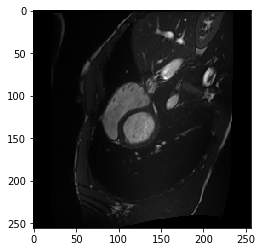

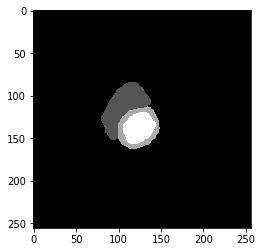

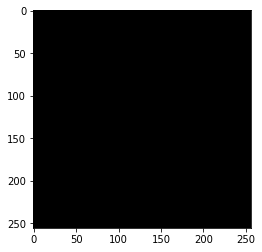

best performance: dice 0.94, idx 37


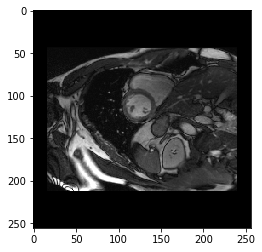

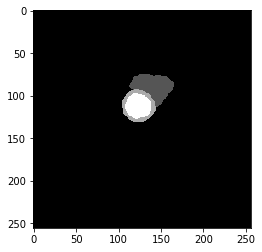

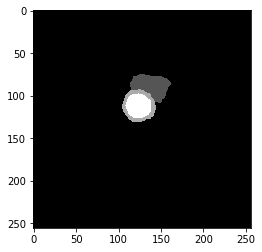

----------

EPOCH 29 of 70

Training Loss: 2.1150
0 Class, True Pos 57623008.0, False Pos 172044.0, False Neg 95017.0, Dice score 1.00
1 Class, True Pos 510512.0, False Pos 60620.0, False Neg 94613.0, Dice score 0.87
2 Class, True Pos 551777.0, False Pos 93375.0, False Neg 108642.0, Dice score 0.85
3 Class, True Pos 598890.0, False Pos 27535.0, False Neg 55302.0, Dice score 0.94
----------
Vaildation Loss: 5.0703
0 Class, True Pos 62970372.0, False Pos 474757.0, False Neg 98082.0, Dice score 1.00
1 Class, True Pos 356276.0, False Pos 43618.0, False Neg 274650.0, Dice score 0.69
2 Class, True Pos 486744.0, False Pos 122748.0, False Neg 181181.0, Dice score 0.76
3 Class, True Pos 527421.0, False Pos 29773.0, False Neg 116983.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


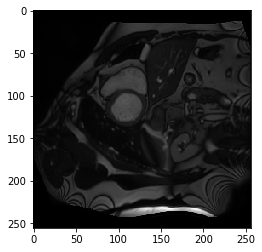

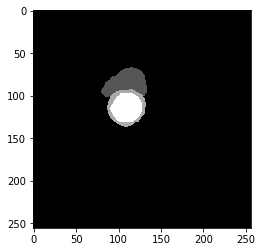

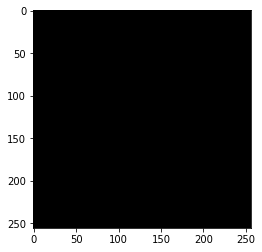

best performance: dice 0.93, idx 19


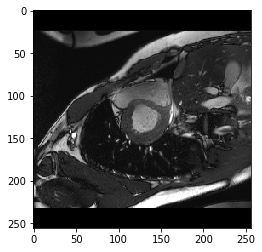

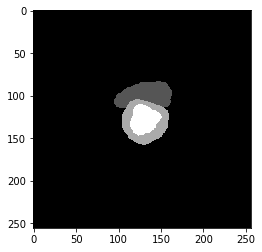

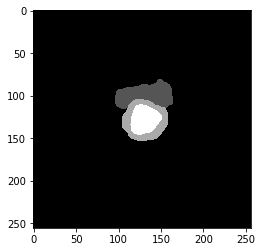

----------

EPOCH 30 of 70

Training Loss: 1.9198
0 Class, True Pos 57664816.0, False Pos 131311.0, False Neg 93875.0, Dice score 1.00
1 Class, True Pos 516127.0, False Pos 56293.0, False Neg 62678.0, Dice score 0.90
2 Class, True Pos 557775.0, False Pos 93081.0, False Neg 92924.0, Dice score 0.86
3 Class, True Pos 591646.0, False Pos 26707.0, False Neg 57915.0, Dice score 0.93
----------
Vaildation Loss: 4.9067
0 Class, True Pos 62902284.0, False Pos 361858.0, False Neg 166177.0, Dice score 1.00
1 Class, True Pos 464521.0, False Pos 87573.0, False Neg 166405.0, Dice score 0.79
2 Class, True Pos 479324.0, False Pos 157225.0, False Neg 188601.0, Dice score 0.73
3 Class, True Pos 527562.0, False Pos 31369.0, False Neg 116842.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


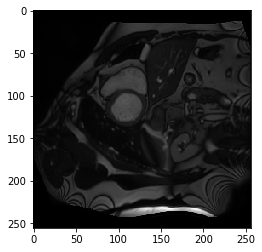

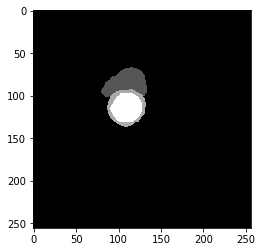

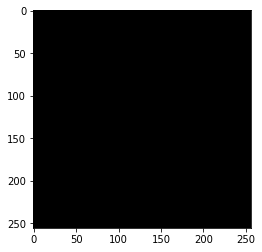

best performance: dice 0.94, idx 37


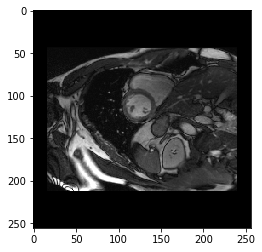

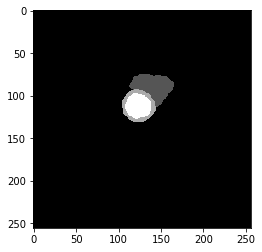

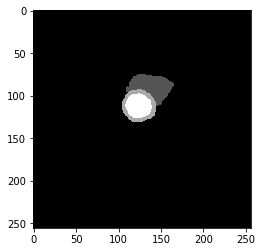

----------

EPOCH 31 of 70

Training Loss: 1.9400
0 Class, True Pos 57631352.0, False Pos 145153.0, False Neg 87280.0, Dice score 1.00
1 Class, True Pos 527508.0, False Pos 54370.0, False Neg 77032.0, Dice score 0.89
2 Class, True Pos 557576.0, False Pos 98663.0, False Neg 102828.0, Dice score 0.85
3 Class, True Pos 597744.0, False Pos 25402.0, False Neg 56448.0, Dice score 0.94
----------
Vaildation Loss: 6.0991
0 Class, True Pos 63000128.0, False Pos 600631.0, False Neg 68330.0, Dice score 0.99
1 Class, True Pos 331034.0, False Pos 30251.0, False Neg 299892.0, Dice score 0.67
2 Class, True Pos 443370.0, False Pos 130907.0, False Neg 224555.0, Dice score 0.71
3 Class, True Pos 465149.0, False Pos 10243.0, False Neg 179255.0, Dice score 0.83
----------
worst performance: dice 0.25, idx 35


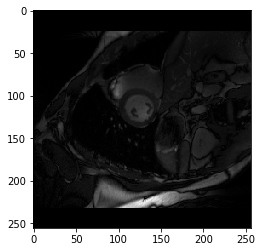

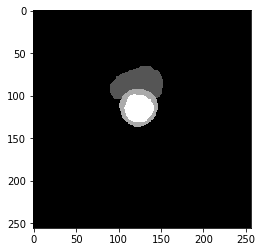

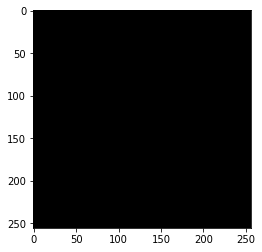

best performance: dice 0.94, idx 37


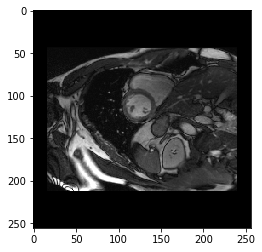

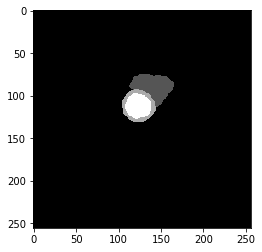

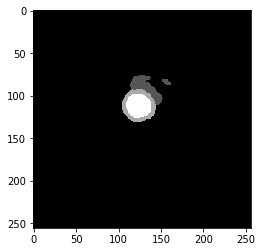

----------

EPOCH 32 of 70

Training Loss: 1.8735
0 Class, True Pos 57653856.0, False Pos 121350.0, False Neg 81736.0, Dice score 1.00
1 Class, True Pos 526441.0, False Pos 53084.0, False Neg 69761.0, Dice score 0.90
2 Class, True Pos 571461.0, False Pos 96290.0, False Neg 83083.0, Dice score 0.86
3 Class, True Pos 590386.0, False Pos 24889.0, False Neg 61033.0, Dice score 0.93
----------
Vaildation Loss: 4.8086
0 Class, True Pos 62887032.0, False Pos 390695.0, False Neg 181426.0, Dice score 1.00
1 Class, True Pos 446057.0, False Pos 127742.0, False Neg 184869.0, Dice score 0.74
2 Class, True Pos 478444.0, False Pos 121672.0, False Neg 189481.0, Dice score 0.75
3 Class, True Pos 529706.0, False Pos 30365.0, False Neg 114698.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


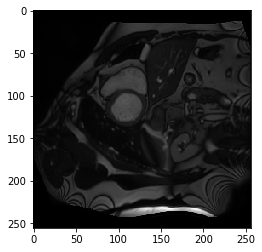

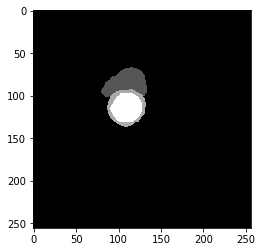

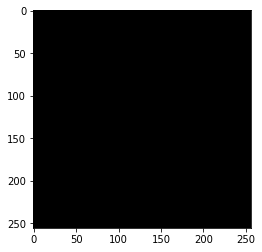

best performance: dice 0.94, idx 37


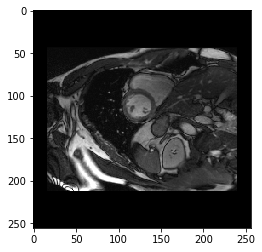

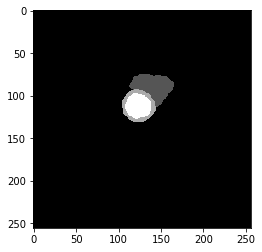

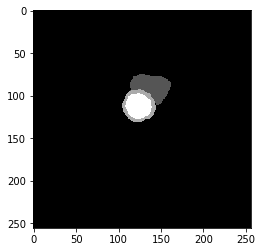

----------

EPOCH 33 of 70

Training Loss: 1.8183
0 Class, True Pos 57657248.0, False Pos 108915.0, False Neg 81121.0, Dice score 1.00
1 Class, True Pos 533864.0, False Pos 52984.0, False Neg 60188.0, Dice score 0.90
2 Class, True Pos 566005.0, False Pos 90918.0, False Neg 85312.0, Dice score 0.87
3 Class, True Pos 604011.0, False Pos 23815.0, False Neg 50011.0, Dice score 0.94
----------
Vaildation Loss: 4.7920
0 Class, True Pos 62960120.0, False Pos 404757.0, False Neg 108324.0, Dice score 1.00
1 Class, True Pos 444277.0, False Pos 78238.0, False Neg 186649.0, Dice score 0.77
2 Class, True Pos 472742.0, False Pos 120413.0, False Neg 195183.0, Dice score 0.75
3 Class, True Pos 513766.0, False Pos 17386.0, False Neg 130638.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


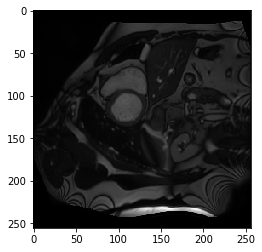

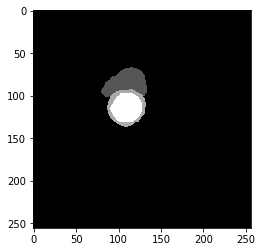

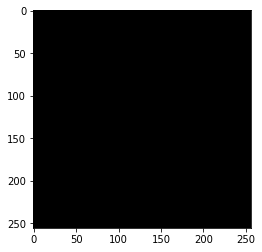

best performance: dice 0.95, idx 37


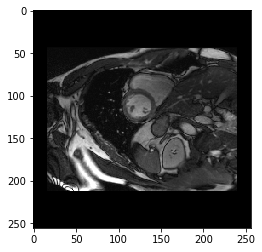

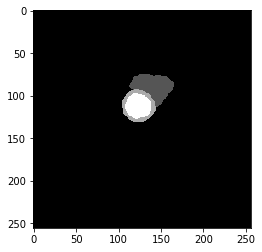

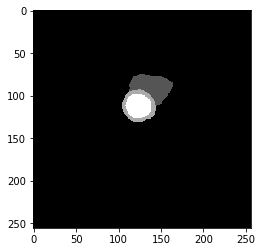

----------

EPOCH 34 of 70

Training Loss: 1.7741
0 Class, True Pos 57653792.0, False Pos 123643.0, False Neg 78361.0, Dice score 1.00
1 Class, True Pos 533708.0, False Pos 45666.0, False Neg 64752.0, Dice score 0.91
2 Class, True Pos 562489.0, False Pos 92771.0, False Neg 91039.0, Dice score 0.86
3 Class, True Pos 603926.0, False Pos 21758.0, False Neg 49686.0, Dice score 0.94
----------
Vaildation Loss: 5.2999
0 Class, True Pos 62990352.0, False Pos 486881.0, False Neg 78097.0, Dice score 1.00
1 Class, True Pos 405764.0, False Pos 51429.0, False Neg 225162.0, Dice score 0.75
2 Class, True Pos 459035.0, False Pos 106439.0, False Neg 208890.0, Dice score 0.74
3 Class, True Pos 496565.0, False Pos 15239.0, False Neg 147839.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 20


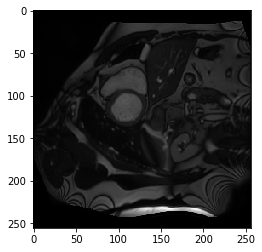

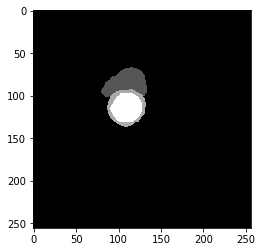

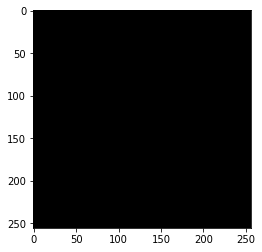

best performance: dice 0.95, idx 37


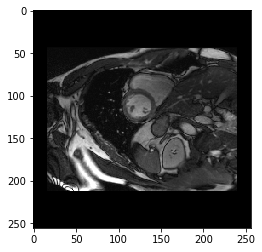

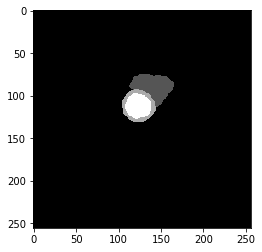

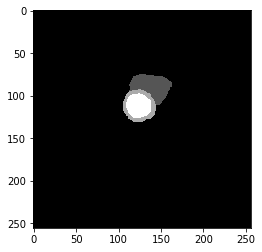

----------

EPOCH 35 of 70

Training Loss: 1.7735
0 Class, True Pos 57636424.0, False Pos 107116.0, False Neg 82992.0, Dice score 1.00
1 Class, True Pos 543412.0, False Pos 49741.0, False Neg 60496.0, Dice score 0.91
2 Class, True Pos 574711.0, False Pos 90037.0, False Neg 85537.0, Dice score 0.87
3 Class, True Pos 609625.0, False Pos 26698.0, False Neg 44567.0, Dice score 0.94
----------
Vaildation Loss: 4.6718
0 Class, True Pos 62929072.0, False Pos 361863.0, False Neg 139383.0, Dice score 1.00
1 Class, True Pos 454052.0, False Pos 77190.0, False Neg 176874.0, Dice score 0.78
2 Class, True Pos 495403.0, False Pos 142887.0, False Neg 172522.0, Dice score 0.76
3 Class, True Pos 522691.0, False Pos 28552.0, False Neg 121713.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


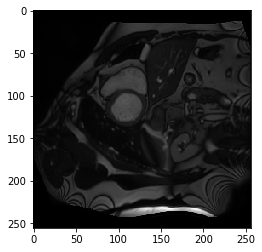

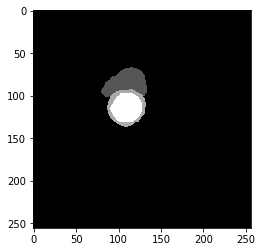

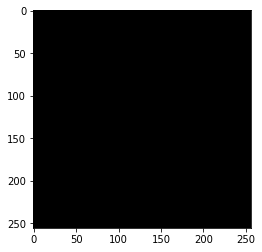

best performance: dice 0.94, idx 37


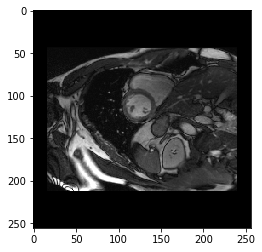

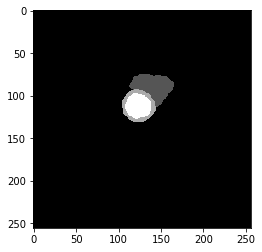

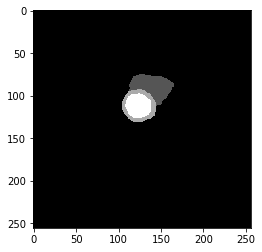

Dice Score: 0.8526
----------

EPOCH 36 of 70

Training Loss: 1.6972
0 Class, True Pos 57671656.0, False Pos 90998.0, False Neg 79985.0, Dice score 1.00
1 Class, True Pos 525088.0, False Pos 44384.0, False Neg 54140.0, Dice score 0.91
2 Class, True Pos 581313.0, False Pos 90379.0, False Neg 72855.0, Dice score 0.88
3 Class, True Pos 607861.0, False Pos 26088.0, False Neg 44869.0, Dice score 0.94
----------
Vaildation Loss: 4.3583
0 Class, True Pos 62900568.0, False Pos 329629.0, False Neg 167882.0, Dice score 1.00
1 Class, True Pos 470602.0, False Pos 96744.0, False Neg 160324.0, Dice score 0.79
2 Class, True Pos 512822.0, False Pos 156178.0, False Neg 155103.0, Dice score 0.77
3 Class, True Pos 525469.0, False Pos 19693.0, False Neg 118935.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


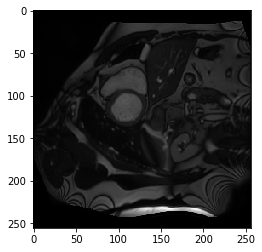

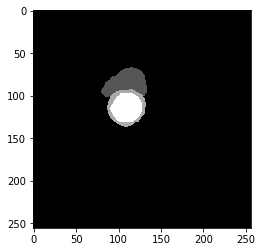

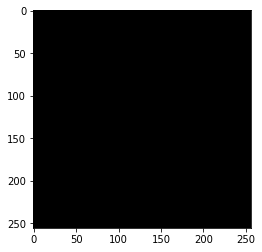

best performance: dice 0.95, idx 48


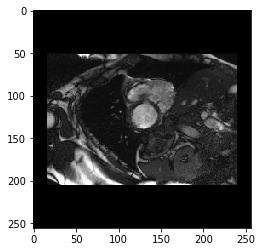

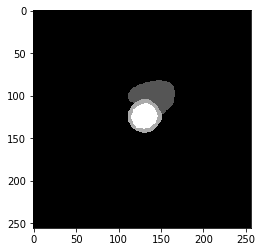

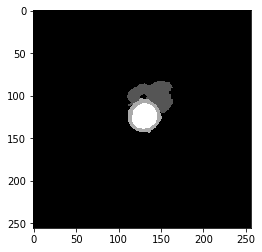

Dice Score: 0.8580
----------

EPOCH 37 of 70

Training Loss: 1.7421
0 Class, True Pos 57690848.0, False Pos 101911.0, False Neg 84110.0, Dice score 1.00
1 Class, True Pos 515581.0, False Pos 47968.0, False Neg 52852.0, Dice score 0.91
2 Class, True Pos 571056.0, False Pos 86829.0, False Neg 74792.0, Dice score 0.88
3 Class, True Pos 596045.0, False Pos 27531.0, False Neg 52485.0, Dice score 0.94
----------
Vaildation Loss: 4.8168
0 Class, True Pos 62896724.0, False Pos 396884.0, False Neg 171738.0, Dice score 1.00
1 Class, True Pos 433360.0, False Pos 115439.0, False Neg 197566.0, Dice score 0.73
2 Class, True Pos 495201.0, False Pos 130066.0, False Neg 172724.0, Dice score 0.77
3 Class, True Pos 520100.0, False Pos 23943.0, False Neg 124304.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


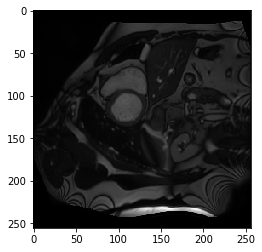

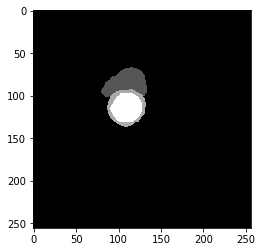

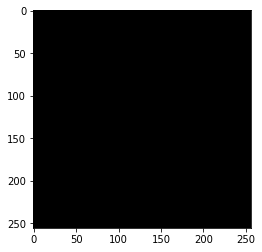

best performance: dice 0.95, idx 37


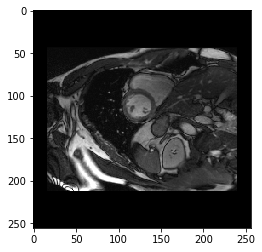

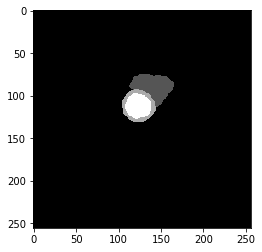

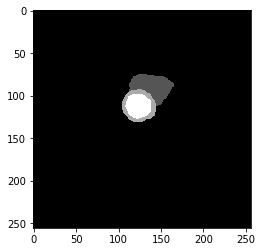

----------

EPOCH 38 of 70

Training Loss: 1.6301
0 Class, True Pos 57674036.0, False Pos 98883.0, False Neg 73327.0, Dice score 1.00
1 Class, True Pos 537994.0, False Pos 46878.0, False Neg 62667.0, Dice score 0.91
2 Class, True Pos 570826.0, False Pos 78455.0, False Neg 71760.0, Dice score 0.88
3 Class, True Pos 608789.0, False Pos 21902.0, False Neg 38364.0, Dice score 0.95
----------
Vaildation Loss: 4.5395
0 Class, True Pos 62988304.0, False Pos 410815.0, False Neg 80160.0, Dice score 1.00
1 Class, True Pos 406797.0, False Pos 43157.0, False Neg 224129.0, Dice score 0.75
2 Class, True Pos 487413.0, False Pos 97871.0, False Neg 180512.0, Dice score 0.78
3 Class, True Pos 545597.0, False Pos 31765.0, False Neg 98807.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


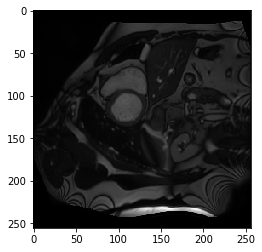

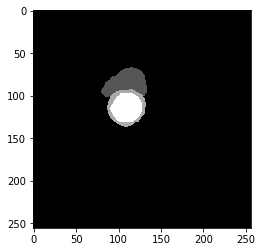

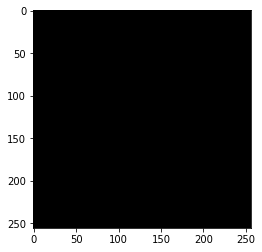

best performance: dice 0.95, idx 37


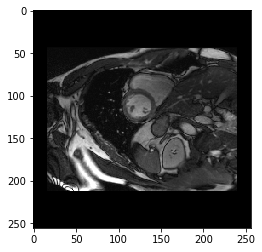

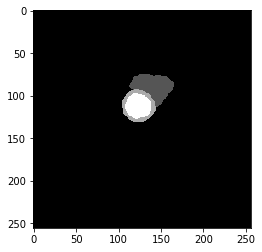

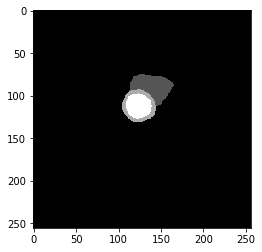

----------

EPOCH 39 of 70

Training Loss: 1.6186
0 Class, True Pos 57690572.0, False Pos 97826.0, False Neg 70752.0, Dice score 1.00
1 Class, True Pos 534001.0, False Pos 43094.0, False Neg 55227.0, Dice score 0.92
2 Class, True Pos 572718.0, False Pos 80231.0, False Neg 69447.0, Dice score 0.88
3 Class, True Pos 598424.0, False Pos 20897.0, False Neg 46622.0, Dice score 0.95
----------
Vaildation Loss: 4.4702
0 Class, True Pos 62954980.0, False Pos 363207.0, False Neg 113471.0, Dice score 1.00
1 Class, True Pos 415490.0, False Pos 44414.0, False Neg 215436.0, Dice score 0.76
2 Class, True Pos 509646.0, False Pos 150933.0, False Neg 158279.0, Dice score 0.77
3 Class, True Pos 541367.0, False Pos 31669.0, False Neg 103037.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


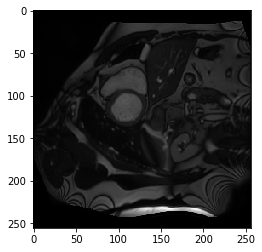

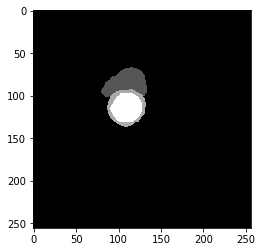

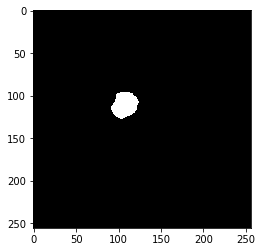

best performance: dice 0.95, idx 37


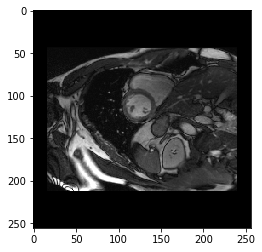

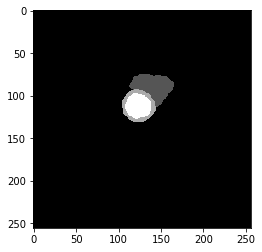

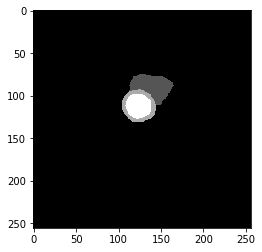

----------

EPOCH 40 of 70

Training Loss: 1.7641
0 Class, True Pos 57637316.0, False Pos 113025.0, False Neg 80706.0, Dice score 1.00
1 Class, True Pos 538771.0, False Pos 51851.0, False Neg 66354.0, Dice score 0.90
2 Class, True Pos 577717.0, False Pos 84073.0, False Neg 82702.0, Dice score 0.87
3 Class, True Pos 612758.0, False Pos 22247.0, False Neg 41434.0, Dice score 0.95
----------
Vaildation Loss: 5.2187
0 Class, True Pos 62979156.0, False Pos 494712.0, False Neg 89303.0, Dice score 1.00
1 Class, True Pos 399991.0, False Pos 64034.0, False Neg 230935.0, Dice score 0.73
2 Class, True Pos 450901.0, False Pos 96630.0, False Neg 217024.0, Dice score 0.74
3 Class, True Pos 507098.0, False Pos 19192.0, False Neg 137306.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


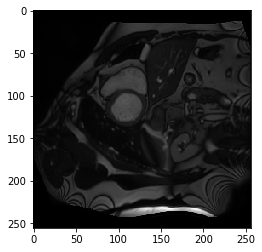

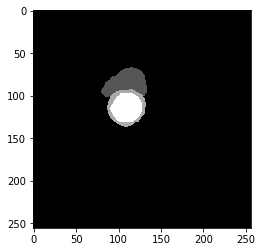

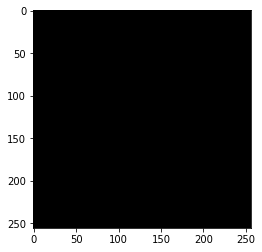

best performance: dice 0.94, idx 37


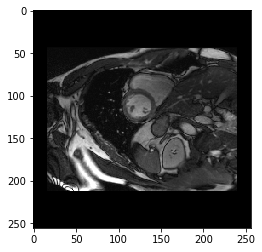

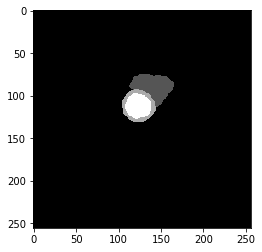

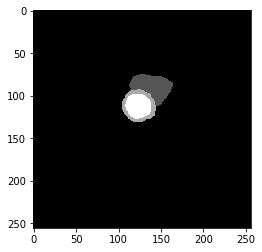

----------

EPOCH 41 of 70

Training Loss: 1.6891
0 Class, True Pos 57641616.0, False Pos 128059.0, False Neg 76402.0, Dice score 1.00
1 Class, True Pos 540406.0, False Pos 48186.0, False Neg 64719.0, Dice score 0.91
2 Class, True Pos 566368.0, False Pos 81186.0, False Neg 94051.0, Dice score 0.87
3 Class, True Pos 608716.0, False Pos 23217.0, False Neg 45476.0, Dice score 0.95
----------
Vaildation Loss: 4.7468
0 Class, True Pos 62970828.0, False Pos 406793.0, False Neg 97631.0, Dice score 1.00
1 Class, True Pos 442653.0, False Pos 63396.0, False Neg 188273.0, Dice score 0.78
2 Class, True Pos 476629.0, False Pos 115875.0, False Neg 191296.0, Dice score 0.76
3 Class, True Pos 514592.0, False Pos 20948.0, False Neg 129812.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


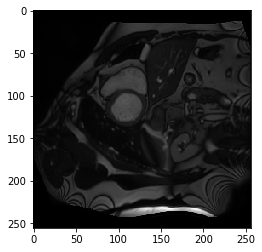

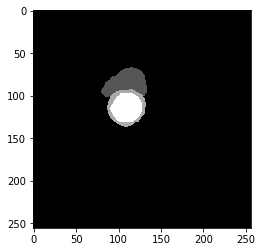

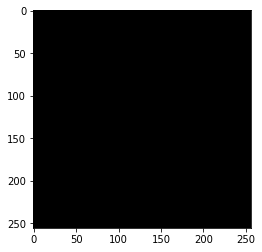

best performance: dice 0.95, idx 37


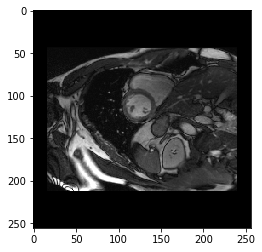

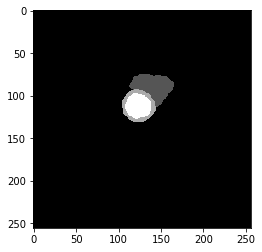

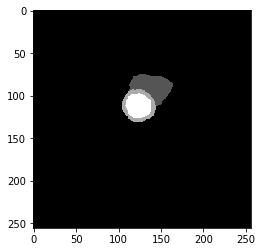

----------

EPOCH 42 of 70

Training Loss: 1.7146
0 Class, True Pos 57667216.0, False Pos 100029.0, False Neg 75984.0, Dice score 1.00
1 Class, True Pos 530929.0, False Pos 46859.0, False Neg 51426.0, Dice score 0.92
2 Class, True Pos 569740.0, False Pos 85760.0, False Neg 88274.0, Dice score 0.87
3 Class, True Pos 611335.0, False Pos 25893.0, False Neg 42857.0, Dice score 0.95
----------
Vaildation Loss: 4.5187
0 Class, True Pos 62900392.0, False Pos 336352.0, False Neg 168079.0, Dice score 1.00
1 Class, True Pos 447680.0, False Pos 82827.0, False Neg 183246.0, Dice score 0.77
2 Class, True Pos 512343.0, False Pos 162575.0, False Neg 155582.0, Dice score 0.76
3 Class, True Pos 538208.0, False Pos 31349.0, False Neg 106196.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


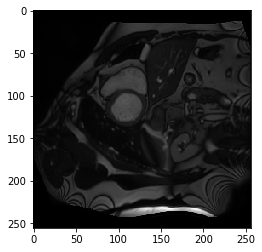

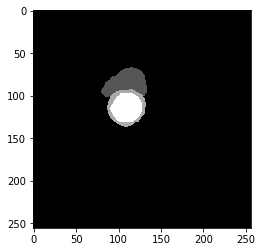

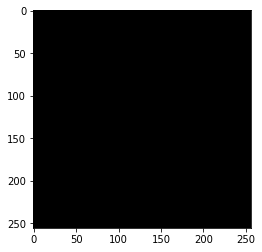

best performance: dice 0.95, idx 37


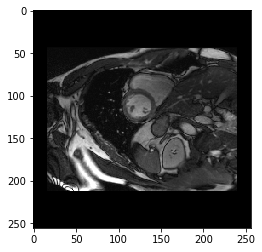

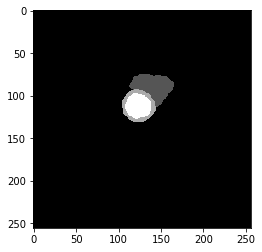

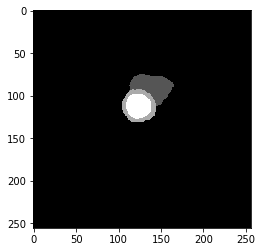

----------

EPOCH 43 of 70

Training Loss: 1.5406
0 Class, True Pos 57671596.0, False Pos 84072.0, False Neg 66934.0, Dice score 1.00
1 Class, True Pos 541156.0, False Pos 38756.0, False Neg 50297.0, Dice score 0.92
2 Class, True Pos 584392.0, False Pos 82157.0, False Neg 69200.0, Dice score 0.89
3 Class, True Pos 615326.0, False Pos 20312.0, False Neg 38866.0, Dice score 0.95
----------
Vaildation Loss: 4.2923
0 Class, True Pos 62956064.0, False Pos 373644.0, False Neg 112377.0, Dice score 1.00
1 Class, True Pos 441401.0, False Pos 77062.0, False Neg 189525.0, Dice score 0.77
2 Class, True Pos 493807.0, False Pos 104681.0, False Neg 174118.0, Dice score 0.78
3 Class, True Pos 539025.0, False Pos 26012.0, False Neg 105379.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


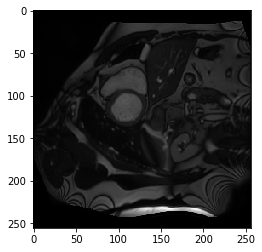

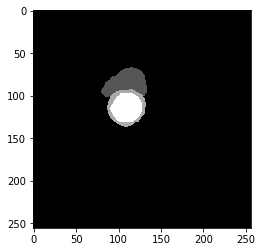

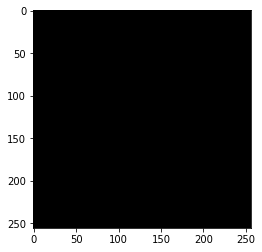

best performance: dice 0.95, idx 37


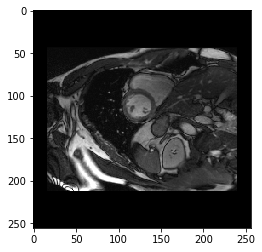

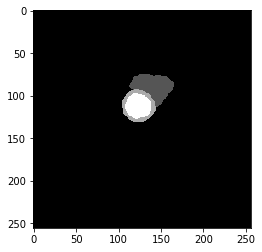

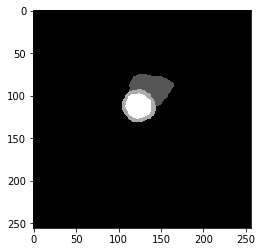

Dice Score: 0.8589
----------

EPOCH 44 of 70

Training Loss: 1.4529
0 Class, True Pos 57696352.0, False Pos 76541.0, False Neg 62198.0, Dice score 1.00
1 Class, True Pos 531518.0, False Pos 38467.0, False Neg 44817.0, Dice score 0.93
2 Class, True Pos 589199.0, False Pos 76029.0, False Neg 64105.0, Dice score 0.89
3 Class, True Pos 609028.0, False Pos 20616.0, False Neg 40533.0, Dice score 0.95
----------
Vaildation Loss: 4.6609
0 Class, True Pos 62936892.0, False Pos 388681.0, False Neg 131564.0, Dice score 1.00
1 Class, True Pos 433185.0, False Pos 69504.0, False Neg 197741.0, Dice score 0.76
2 Class, True Pos 484612.0, False Pos 126008.0, False Neg 183313.0, Dice score 0.76
3 Class, True Pos 538994.0, False Pos 33835.0, False Neg 105410.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


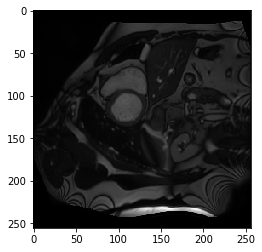

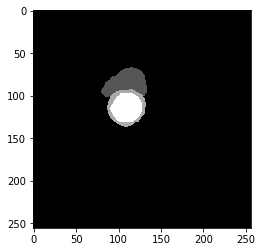

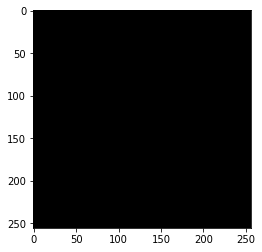

best performance: dice 0.95, idx 37


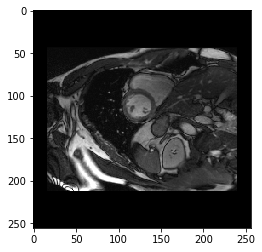

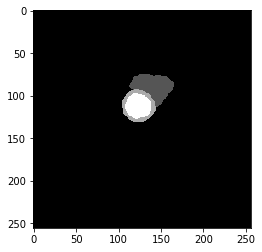

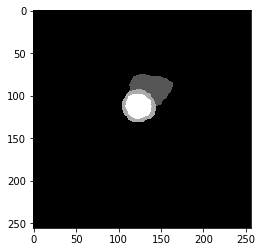

----------

EPOCH 45 of 70

Training Loss: 1.4501
0 Class, True Pos 57659152.0, False Pos 80303.0, False Neg 65338.0, Dice score 1.00
1 Class, True Pos 546743.0, False Pos 40626.0, False Neg 51913.0, Dice score 0.92
2 Class, True Pos 597857.0, False Pos 73605.0, False Neg 62562.0, Dice score 0.90
3 Class, True Pos 619251.0, False Pos 20220.0, False Neg 34941.0, Dice score 0.96
----------
Vaildation Loss: 4.5893
0 Class, True Pos 62966228.0, False Pos 390541.0, False Neg 102231.0, Dice score 1.00
1 Class, True Pos 413437.0, False Pos 49646.0, False Neg 217489.0, Dice score 0.76
2 Class, True Pos 508523.0, False Pos 139725.0, False Neg 159402.0, Dice score 0.77
3 Class, True Pos 522595.0, False Pos 21019.0, False Neg 121809.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


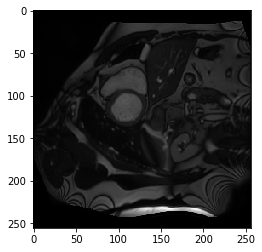

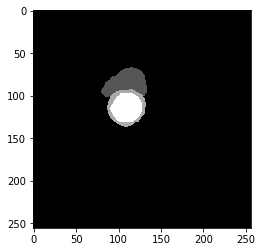

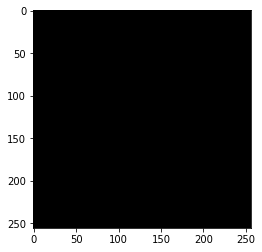

best performance: dice 0.95, idx 37


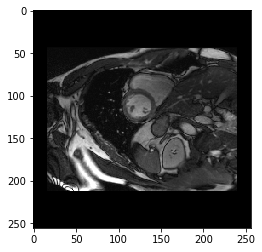

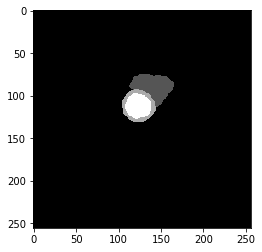

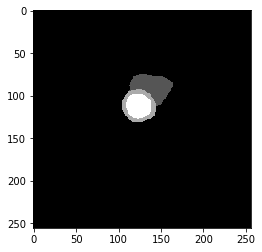

----------

EPOCH 46 of 70

Training Loss: 1.4019
0 Class, True Pos 57659052.0, False Pos 75250.0, False Neg 63531.0, Dice score 1.00
1 Class, True Pos 550485.0, False Pos 38095.0, False Neg 50086.0, Dice score 0.93
2 Class, True Pos 600671.0, False Pos 71962.0, False Neg 59748.0, Dice score 0.90
3 Class, True Pos 620648.0, False Pos 21602.0, False Neg 33544.0, Dice score 0.96
----------
Vaildation Loss: 3.7302
0 Class, True Pos 62880960.0, False Pos 252515.0, False Neg 187498.0, Dice score 1.00
1 Class, True Pos 503820.0, False Pos 131241.0, False Neg 127106.0, Dice score 0.80
2 Class, True Pos 519133.0, False Pos 121958.0, False Neg 148792.0, Dice score 0.79
3 Class, True Pos 565220.0, False Pos 36866.0, False Neg 79184.0, Dice score 0.91
----------
worst performance: dice 0.26, idx 20


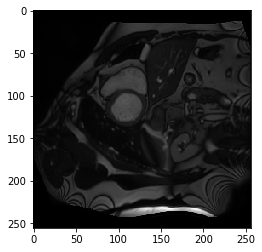

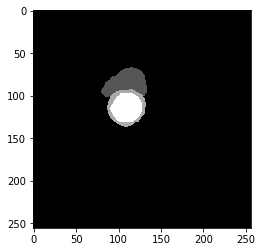

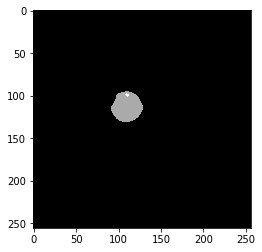

best performance: dice 0.95, idx 31


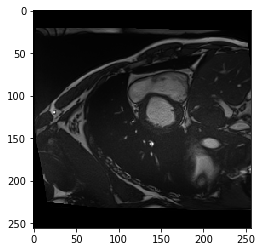

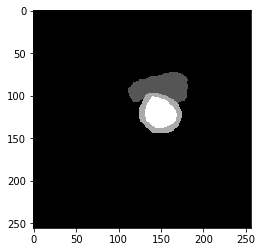

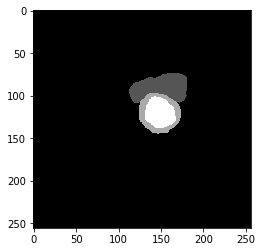

Dice Score: 0.8731
----------

EPOCH 47 of 70

Training Loss: 1.3852
0 Class, True Pos 57656640.0, False Pos 77666.0, False Neg 61399.0, Dice score 1.00
1 Class, True Pos 556544.0, False Pos 37717.0, False Neg 48581.0, Dice score 0.93
2 Class, True Pos 598124.0, False Pos 71564.0, False Neg 62293.0, Dice score 0.90
3 Class, True Pos 620039.0, False Pos 19479.0, False Neg 34153.0, Dice score 0.96
----------
Vaildation Loss: 4.1127
0 Class, True Pos 62984408.0, False Pos 366286.0, False Neg 84048.0, Dice score 1.00
1 Class, True Pos 417692.0, False Pos 41440.0, False Neg 213234.0, Dice score 0.77
2 Class, True Pos 525551.0, False Pos 119256.0, False Neg 142374.0, Dice score 0.80
3 Class, True Pos 537041.0, False Pos 20037.0, False Neg 107363.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


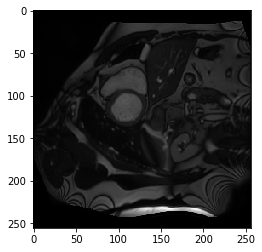

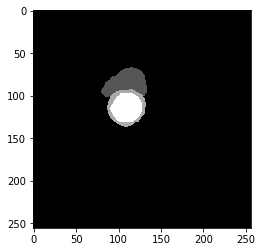

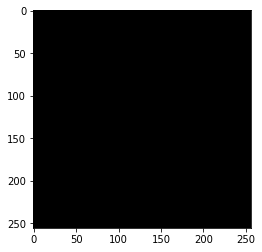

best performance: dice 0.95, idx 37


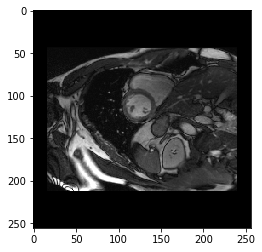

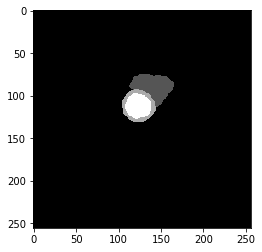

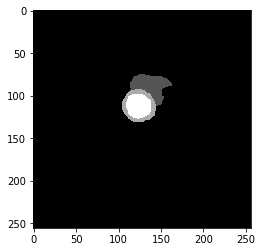

----------

EPOCH 48 of 70

Training Loss: 1.4161
0 Class, True Pos 57710648.0, False Pos 69132.0, False Neg 63091.0, Dice score 1.00
1 Class, True Pos 534403.0, False Pos 36576.0, False Neg 43908.0, Dice score 0.93
2 Class, True Pos 587855.0, False Pos 76420.0, False Neg 56868.0, Dice score 0.90
3 Class, True Pos 603652.0, False Pos 19067.0, False Neg 37328.0, Dice score 0.96
----------
Vaildation Loss: 4.1286
0 Class, True Pos 62998160.0, False Pos 400036.0, False Neg 70293.0, Dice score 1.00
1 Class, True Pos 389502.0, False Pos 34164.0, False Neg 241424.0, Dice score 0.74
2 Class, True Pos 516015.0, False Pos 102941.0, False Neg 151910.0, Dice score 0.80
3 Class, True Pos 547668.0, False Pos 23222.0, False Neg 96736.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


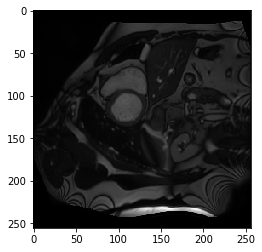

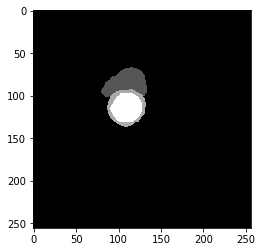

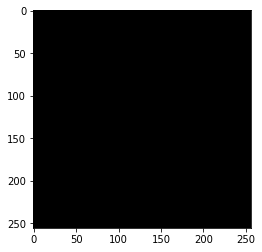

best performance: dice 0.95, idx 37


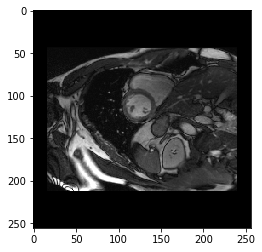

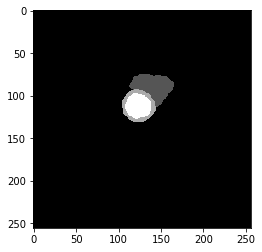

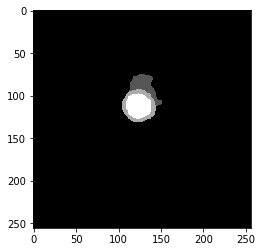

----------

EPOCH 49 of 70

Training Loss: 1.5361
0 Class, True Pos 57703076.0, False Pos 85553.0, False Neg 79604.0, Dice score 1.00
1 Class, True Pos 541049.0, False Pos 39594.0, False Neg 50493.0, Dice score 0.92
2 Class, True Pos 561484.0, False Pos 82281.0, False Neg 66588.0, Dice score 0.88
3 Class, True Pos 601643.0, False Pos 23075.0, False Neg 33818.0, Dice score 0.95
----------
Vaildation Loss: 3.7847
0 Class, True Pos 62866060.0, False Pos 264141.0, False Neg 202392.0, Dice score 1.00
1 Class, True Pos 485134.0, False Pos 107439.0, False Neg 145792.0, Dice score 0.79
2 Class, True Pos 530349.0, False Pos 152432.0, False Neg 137576.0, Dice score 0.79
3 Class, True Pos 565887.0, False Pos 40265.0, False Neg 78517.0, Dice score 0.91
----------
worst performance: dice 0.25, idx 20


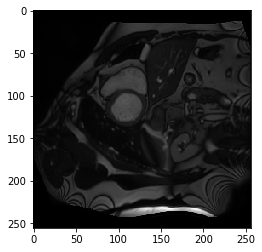

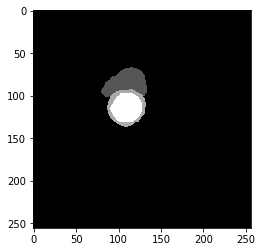

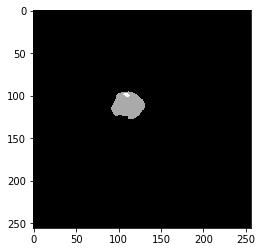

best performance: dice 0.95, idx 37


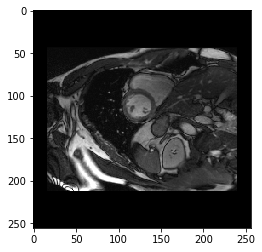

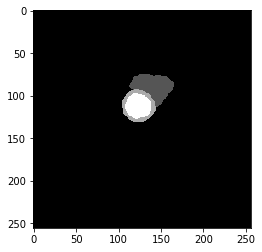

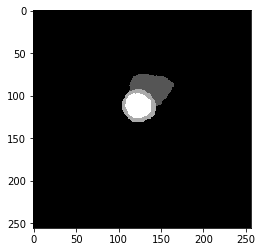

----------

EPOCH 50 of 70

Training Loss: 1.5891
0 Class, True Pos 57647500.0, False Pos 99509.0, False Neg 83354.0, Dice score 1.00
1 Class, True Pos 536972.0, False Pos 54271.0, False Neg 58436.0, Dice score 0.91
2 Class, True Pos 584041.0, False Pos 78872.0, False Neg 73260.0, Dice score 0.88
3 Class, True Pos 615948.0, False Pos 20642.0, False Neg 38244.0, Dice score 0.95
----------
Vaildation Loss: 4.0750
0 Class, True Pos 62960088.0, False Pos 351414.0, False Neg 108373.0, Dice score 1.00
1 Class, True Pos 431951.0, False Pos 65257.0, False Neg 198975.0, Dice score 0.77
2 Class, True Pos 527225.0, False Pos 131297.0, False Neg 140700.0, Dice score 0.79
3 Class, True Pos 526390.0, False Pos 18094.0, False Neg 118014.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


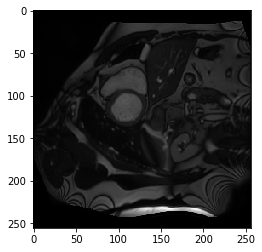

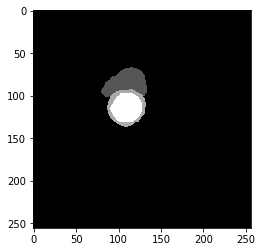

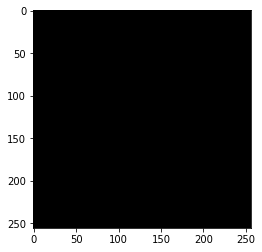

best performance: dice 0.95, idx 37


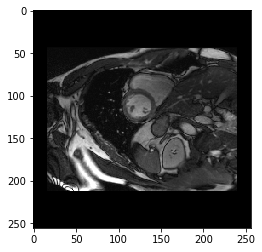

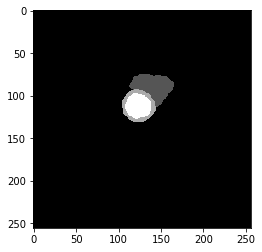

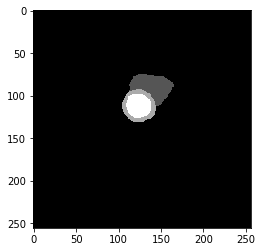

----------

EPOCH 51 of 70

Training Loss: 1.4536
0 Class, True Pos 57660656.0, False Pos 78295.0, False Neg 69762.0, Dice score 1.00
1 Class, True Pos 546803.0, False Pos 42516.0, False Neg 47411.0, Dice score 0.92
2 Class, True Pos 594886.0, False Pos 74659.0, False Neg 64048.0, Dice score 0.90
3 Class, True Pos 619584.0, False Pos 20359.0, False Neg 34608.0, Dice score 0.96
----------
Vaildation Loss: 3.9513
0 Class, True Pos 63002988.0, False Pos 390422.0, False Neg 65463.0, Dice score 1.00
1 Class, True Pos 413973.0, False Pos 43485.0, False Neg 216953.0, Dice score 0.76
2 Class, True Pos 508369.0, False Pos 94697.0, False Neg 159556.0, Dice score 0.80
3 Class, True Pos 541675.0, False Pos 16097.0, False Neg 102729.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


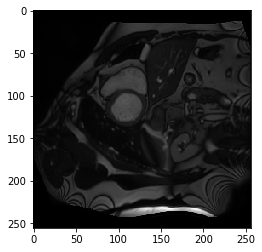

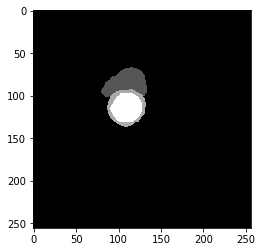

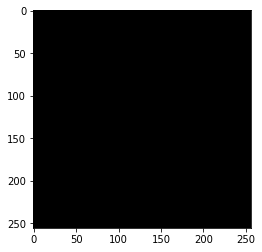

best performance: dice 0.95, idx 37


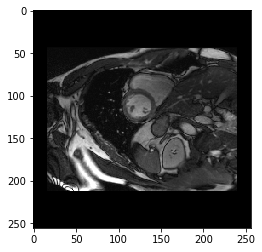

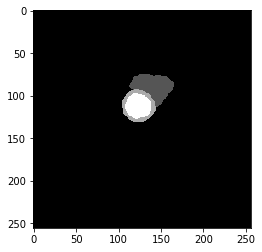

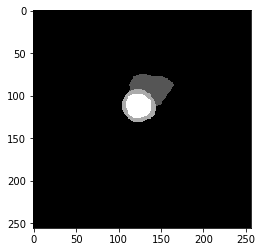

----------

EPOCH 52 of 70

Training Loss: 1.4860
0 Class, True Pos 57661744.0, False Pos 76666.0, False Neg 72204.0, Dice score 1.00
1 Class, True Pos 542051.0, False Pos 42086.0, False Neg 47148.0, Dice score 0.92
2 Class, True Pos 595104.0, False Pos 77305.0, False Neg 65315.0, Dice score 0.89
3 Class, True Pos 619558.0, False Pos 23244.0, False Neg 34634.0, Dice score 0.96
----------
Vaildation Loss: 3.6281
0 Class, True Pos 63011176.0, False Pos 357181.0, False Neg 57278.0, Dice score 1.00
1 Class, True Pos 422041.0, False Pos 36730.0, False Neg 208885.0, Dice score 0.77
2 Class, True Pos 519518.0, False Pos 83311.0, False Neg 148407.0, Dice score 0.82
3 Class, True Pos 560963.0, False Pos 20789.0, False Neg 83441.0, Dice score 0.91
----------
worst performance: dice 0.31, idx 20


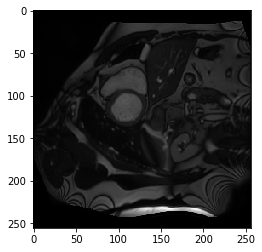

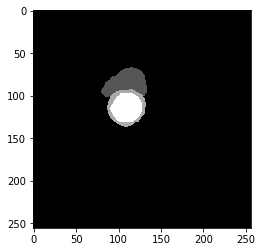

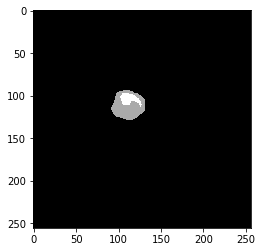

best performance: dice 0.95, idx 34


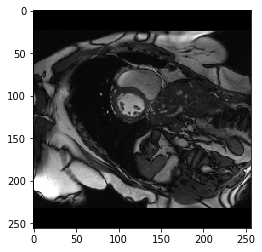

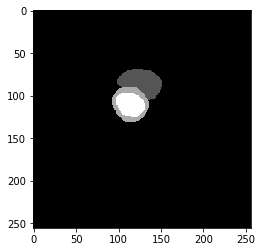

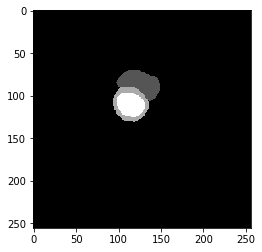

Dice Score: 0.8760
----------

EPOCH 53 of 70

Training Loss: 1.6348
0 Class, True Pos 57645224.0, False Pos 94533.0, False Neg 77217.0, Dice score 1.00
1 Class, True Pos 545656.0, False Pos 41375.0, False Neg 59317.0, Dice score 0.92
2 Class, True Pos 586492.0, False Pos 81824.0, False Neg 69664.0, Dice score 0.89
3 Class, True Pos 616364.0, False Pos 26294.0, False Neg 37828.0, Dice score 0.95
----------
Vaildation Loss: 4.3615
0 Class, True Pos 62964940.0, False Pos 393679.0, False Neg 103511.0, Dice score 1.00
1 Class, True Pos 442217.0, False Pos 63206.0, False Neg 188709.0, Dice score 0.78
2 Class, True Pos 491220.0, False Pos 90073.0, False Neg 176705.0, Dice score 0.79
3 Class, True Pos 534977.0, False Pos 31394.0, False Neg 109427.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


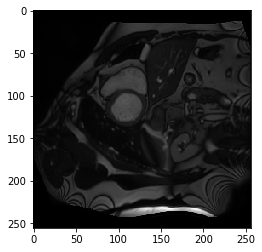

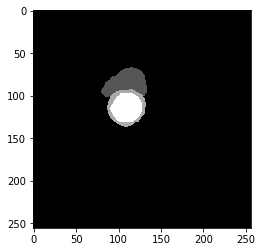

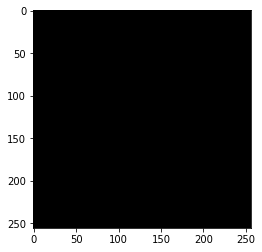

best performance: dice 0.95, idx 31


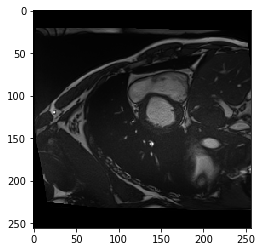

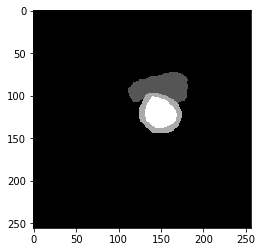

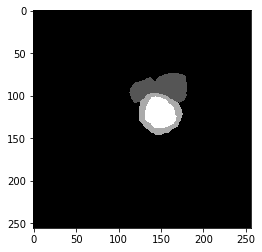

----------

EPOCH 54 of 70

Training Loss: 1.7257
0 Class, True Pos 57686004.0, False Pos 114083.0, False Neg 78384.0, Dice score 1.00
1 Class, True Pos 514553.0, False Pos 46900.0, False Neg 53440.0, Dice score 0.91
2 Class, True Pos 566411.0, False Pos 82705.0, False Neg 85400.0, Dice score 0.87
3 Class, True Pos 603104.0, False Pos 24005.0, False Neg 50469.0, Dice score 0.94
----------
Vaildation Loss: 4.7137
0 Class, True Pos 62864784.0, False Pos 374805.0, False Neg 203667.0, Dice score 1.00
1 Class, True Pos 476941.0, False Pos 162123.0, False Neg 153985.0, Dice score 0.75
2 Class, True Pos 485510.0, False Pos 112460.0, False Neg 182415.0, Dice score 0.77
3 Class, True Pos 513497.0, False Pos 21586.0, False Neg 130907.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


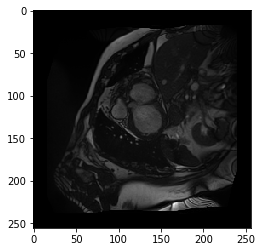

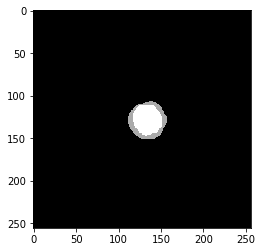

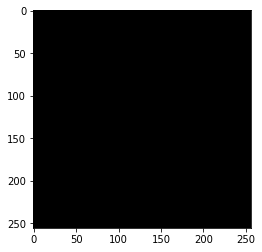

best performance: dice 0.94, idx 37


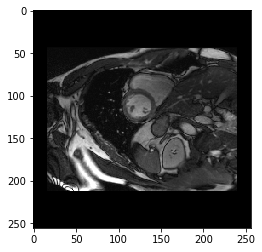

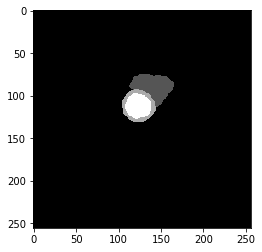

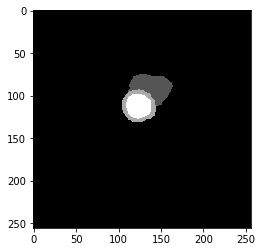

----------

EPOCH 55 of 70

Training Loss: 1.5861
0 Class, True Pos 57650396.0, False Pos 117963.0, False Neg 72666.0, Dice score 1.00
1 Class, True Pos 544069.0, False Pos 46074.0, False Neg 56076.0, Dice score 0.91
2 Class, True Pos 579006.0, False Pos 78764.0, False Neg 81342.0, Dice score 0.88
3 Class, True Pos 599694.0, False Pos 21781.0, False Neg 54498.0, Dice score 0.94
----------
Vaildation Loss: 3.9349
0 Class, True Pos 62950888.0, False Pos 319138.0, False Neg 117552.0, Dice score 1.00
1 Class, True Pos 467295.0, False Pos 74937.0, False Neg 163631.0, Dice score 0.80
2 Class, True Pos 528772.0, False Pos 141671.0, False Neg 139153.0, Dice score 0.79
3 Class, True Pos 518035.0, False Pos 10959.0, False Neg 126369.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


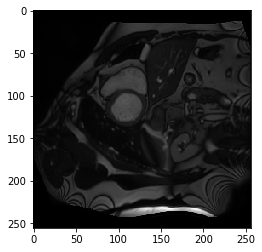

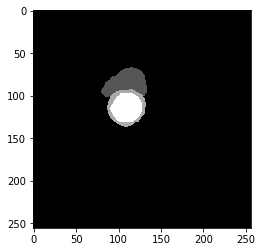

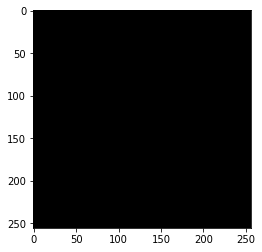

best performance: dice 0.95, idx 34


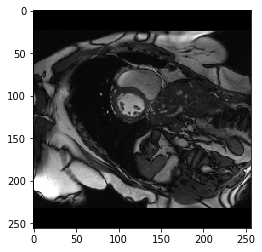

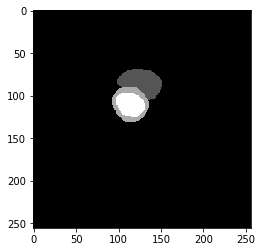

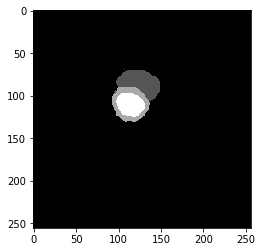

----------

EPOCH 56 of 70

Training Loss: 1.7789
0 Class, True Pos 57665720.0, False Pos 135158.0, False Neg 88993.0, Dice score 1.00
1 Class, True Pos 527197.0, False Pos 53292.0, False Neg 61343.0, Dice score 0.90
2 Class, True Pos 556840.0, False Pos 83703.0, False Neg 93202.0, Dice score 0.86
3 Class, True Pos 590207.0, False Pos 25640.0, False Neg 54255.0, Dice score 0.94
----------
Vaildation Loss: 5.4864
0 Class, True Pos 63010644.0, False Pos 531748.0, False Neg 57819.0, Dice score 1.00
1 Class, True Pos 411367.0, False Pos 43320.0, False Neg 219559.0, Dice score 0.76
2 Class, True Pos 428943.0, False Pos 117876.0, False Neg 238982.0, Dice score 0.71
3 Class, True Pos 459775.0, False Pos 8045.0, False Neg 184629.0, Dice score 0.83
----------
worst performance: dice 0.25, idx 20


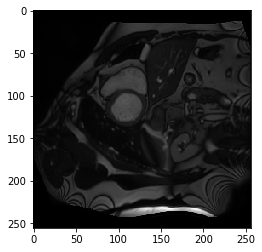

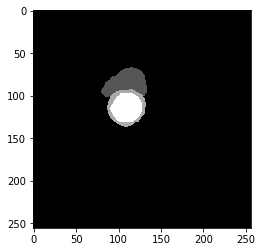

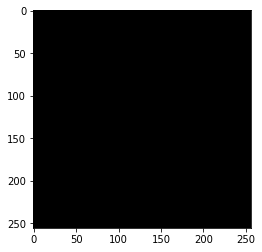

best performance: dice 0.94, idx 37


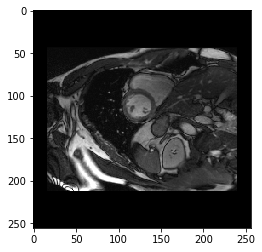

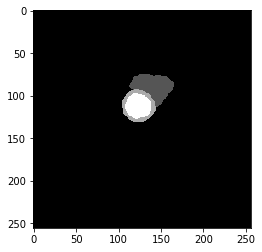

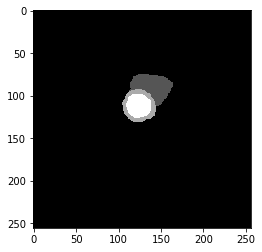

----------

EPOCH 57 of 70

Training Loss: 1.5771
0 Class, True Pos 57652000.0, False Pos 121154.0, False Neg 70822.0, Dice score 1.00
1 Class, True Pos 527196.0, False Pos 43039.0, False Neg 75122.0, Dice score 0.90
2 Class, True Pos 578915.0, False Pos 78402.0, False Neg 79520.0, Dice score 0.88
3 Class, True Pos 613520.0, False Pos 23529.0, False Neg 40660.0, Dice score 0.95
----------
Vaildation Loss: 4.0697
0 Class, True Pos 62993924.0, False Pos 390334.0, False Neg 74531.0, Dice score 1.00
1 Class, True Pos 402445.0, False Pos 36340.0, False Neg 228481.0, Dice score 0.75
2 Class, True Pos 509109.0, False Pos 89522.0, False Neg 158816.0, Dice score 0.80
3 Class, True Pos 557034.0, False Pos 33002.0, False Neg 87370.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


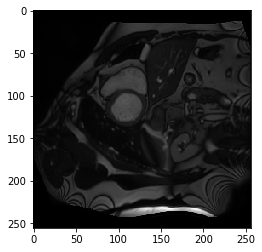

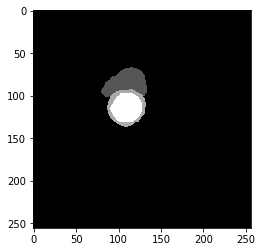

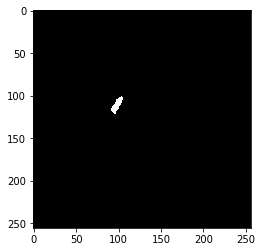

best performance: dice 0.95, idx 37


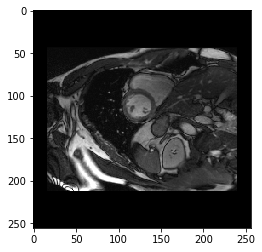

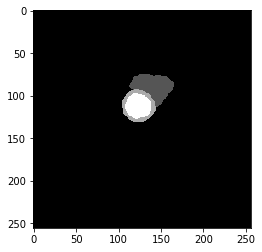

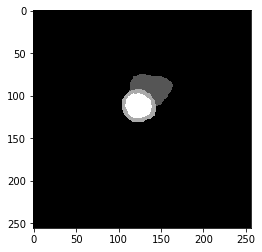

----------

EPOCH 58 of 70

Training Loss: 1.3705
0 Class, True Pos 57656508.0, False Pos 72391.0, False Neg 66843.0, Dice score 1.00
1 Class, True Pos 551867.0, False Pos 40651.0, False Neg 47934.0, Dice score 0.93
2 Class, True Pos 601069.0, False Pos 71810.0, False Neg 59350.0, Dice score 0.90
3 Class, True Pos 622639.0, False Pos 20828.0, False Neg 31553.0, Dice score 0.96
----------
Vaildation Loss: 3.7538
0 Class, True Pos 63001372.0, False Pos 354379.0, False Neg 67083.0, Dice score 1.00
1 Class, True Pos 412317.0, False Pos 33974.0, False Neg 218609.0, Dice score 0.77
2 Class, True Pos 534157.0, False Pos 105561.0, False Neg 133768.0, Dice score 0.82
3 Class, True Pos 549801.0, False Pos 20149.0, False Neg 94603.0, Dice score 0.91
----------
worst performance: dice 0.25, idx 20


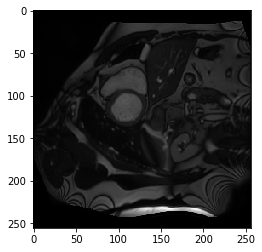

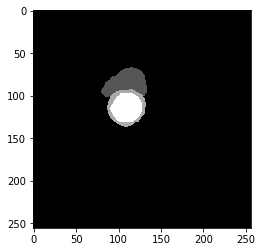

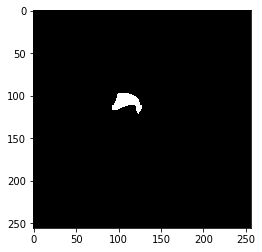

best performance: dice 0.95, idx 37


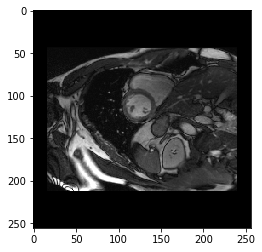

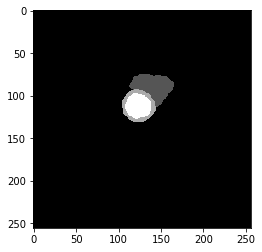

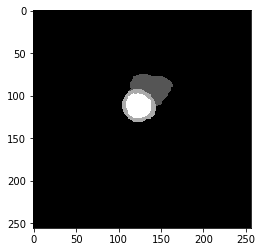

----------

EPOCH 59 of 70

Training Loss: 1.2993
0 Class, True Pos 57668664.0, False Pos 71968.0, False Neg 60319.0, Dice score 1.00
1 Class, True Pos 556694.0, False Pos 37753.0, False Neg 46806.0, Dice score 0.93
2 Class, True Pos 593765.0, False Pos 67154.0, False Neg 57331.0, Dice score 0.91
3 Class, True Pos 623005.0, False Pos 18756.0, False Neg 31175.0, Dice score 0.96
----------
Vaildation Loss: 4.7270
0 Class, True Pos 62995004.0, False Pos 445774.0, False Neg 73441.0, Dice score 1.00
1 Class, True Pos 409595.0, False Pos 38432.0, False Neg 221331.0, Dice score 0.76
2 Class, True Pos 488461.0, False Pos 103675.0, False Neg 179464.0, Dice score 0.78
3 Class, True Pos 514307.0, False Pos 16452.0, False Neg 130097.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


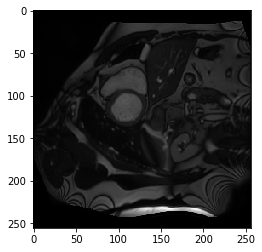

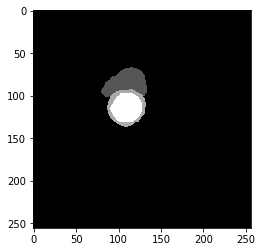

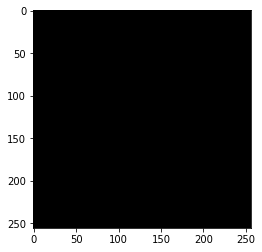

best performance: dice 0.95, idx 37


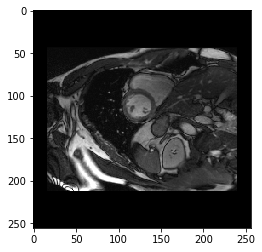

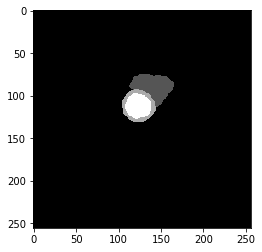

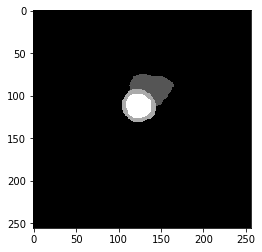

----------

EPOCH 60 of 70

Training Loss: 1.2642
0 Class, True Pos 57658948.0, False Pos 65794.0, False Neg 59986.0, Dice score 1.00
1 Class, True Pos 559884.0, False Pos 36751.0, False Neg 44332.0, Dice score 0.93
2 Class, True Pos 606923.0, False Pos 67175.0, False Neg 53496.0, Dice score 0.91
3 Class, True Pos 623892.0, False Pos 18394.0, False Neg 30300.0, Dice score 0.96
----------
Vaildation Loss: 3.7217
0 Class, True Pos 62978048.0, False Pos 325386.0, False Neg 90408.0, Dice score 1.00
1 Class, True Pos 449814.0, False Pos 47715.0, False Neg 181112.0, Dice score 0.80
2 Class, True Pos 528146.0, False Pos 110255.0, False Neg 139779.0, Dice score 0.81
3 Class, True Pos 549810.0, False Pos 22537.0, False Neg 94594.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


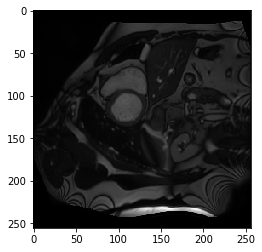

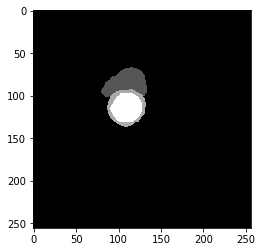

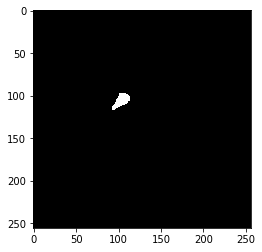

best performance: dice 0.95, idx 37


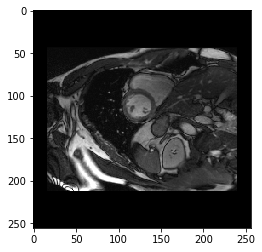

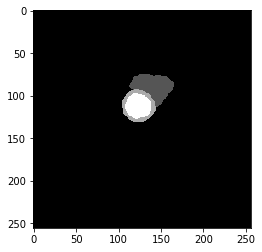

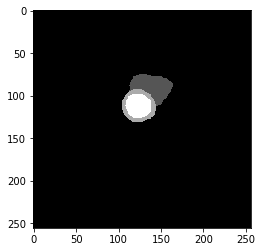

Dice Score: 0.8766
----------

EPOCH 61 of 70

Training Loss: 1.3035
0 Class, True Pos 57689060.0, False Pos 73424.0, False Neg 60904.0, Dice score 1.00
1 Class, True Pos 548749.0, False Pos 36640.0, False Neg 41072.0, Dice score 0.93
2 Class, True Pos 591930.0, False Pos 67309.0, False Neg 59441.0, Dice score 0.90
3 Class, True Pos 610440.0, False Pos 20215.0, False Neg 36171.0, Dice score 0.96
----------
Vaildation Loss: 4.7269
0 Class, True Pos 62960760.0, False Pos 411166.0, False Neg 107695.0, Dice score 1.00
1 Class, True Pos 435995.0, False Pos 54390.0, False Neg 194931.0, Dice score 0.78
2 Class, True Pos 485354.0, False Pos 118986.0, False Neg 182571.0, Dice score 0.76
3 Class, True Pos 519765.0, False Pos 25294.0, False Neg 124639.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


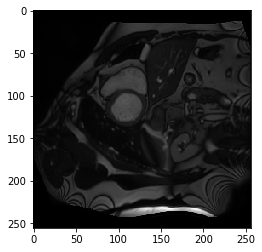

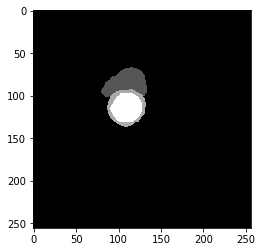

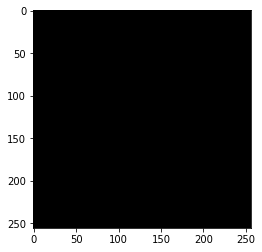

best performance: dice 0.95, idx 37


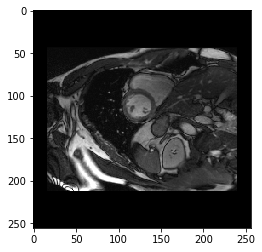

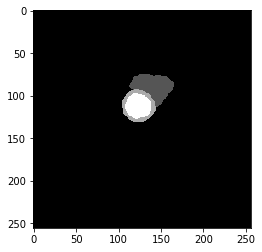

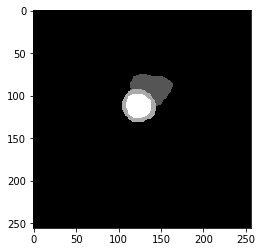

----------

EPOCH 62 of 70

Training Loss: 1.2840
0 Class, True Pos 57664608.0, False Pos 68557.0, False Neg 59088.0, Dice score 1.00
1 Class, True Pos 560119.0, False Pos 35091.0, False Neg 44110.0, Dice score 0.93
2 Class, True Pos 598302.0, False Pos 67717.0, False Neg 57356.0, Dice score 0.91
3 Class, True Pos 624096.0, False Pos 19254.0, False Neg 30065.0, Dice score 0.96
----------
Vaildation Loss: 3.6767
0 Class, True Pos 62970040.0, False Pos 317104.0, False Neg 98410.0, Dice score 1.00
1 Class, True Pos 460960.0, False Pos 63936.0, False Neg 169966.0, Dice score 0.80
2 Class, True Pos 524938.0, False Pos 105663.0, False Neg 142987.0, Dice score 0.81
3 Class, True Pos 546649.0, False Pos 22415.0, False Neg 97755.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


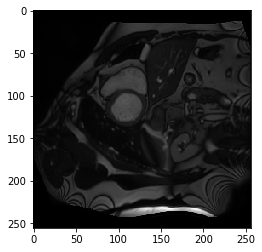

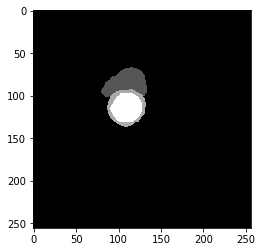

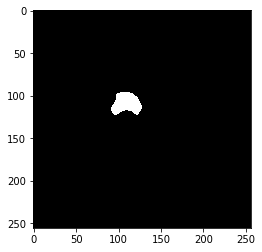

best performance: dice 0.95, idx 31


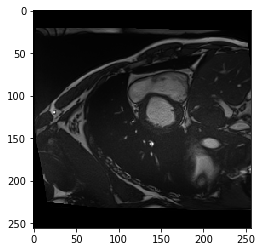

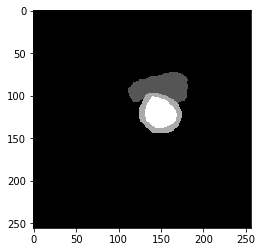

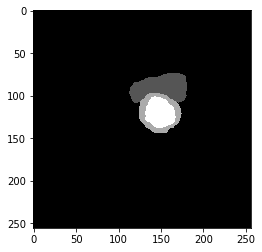

----------

EPOCH 63 of 70

Training Loss: 1.2428
0 Class, True Pos 57681736.0, False Pos 67266.0, False Neg 51383.0, Dice score 1.00
1 Class, True Pos 553027.0, False Pos 30825.0, False Neg 41475.0, Dice score 0.94
2 Class, True Pos 599061.0, False Pos 62805.0, False Neg 57667.0, Dice score 0.91
3 Class, True Pos 623355.0, False Pos 19695.0, False Neg 30066.0, Dice score 0.96
----------
Vaildation Loss: 3.9974
0 Class, True Pos 62947560.0, False Pos 326204.0, False Neg 120896.0, Dice score 1.00
1 Class, True Pos 469454.0, False Pos 71821.0, False Neg 161472.0, Dice score 0.80
2 Class, True Pos 503228.0, False Pos 98491.0, False Neg 164697.0, Dice score 0.79
3 Class, True Pos 555706.0, False Pos 39247.0, False Neg 88698.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


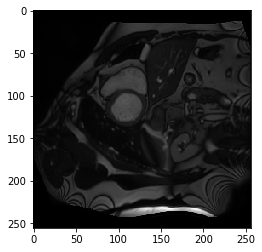

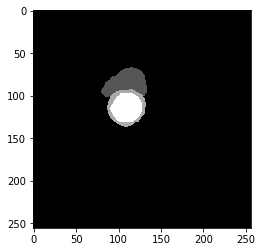

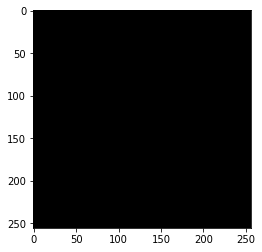

best performance: dice 0.95, idx 37


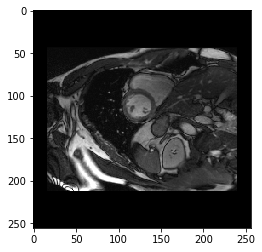

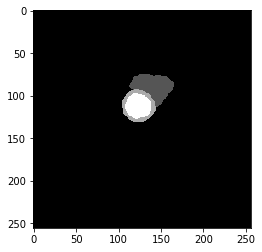

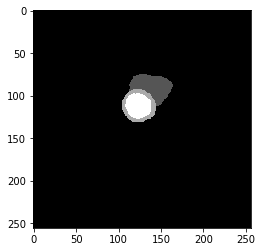

----------

EPOCH 64 of 70

Training Loss: 1.2109
0 Class, True Pos 57685224.0, False Pos 56565.0, False Neg 56786.0, Dice score 1.00
1 Class, True Pos 546495.0, False Pos 35776.0, False Neg 35585.0, Dice score 0.94
2 Class, True Pos 606396.0, False Pos 62877.0, False Neg 53088.0, Dice score 0.91
3 Class, True Pos 625949.0, False Pos 18484.0, False Neg 28243.0, Dice score 0.96
----------
Vaildation Loss: 4.0104
0 Class, True Pos 62975280.0, False Pos 348969.0, False Neg 93178.0, Dice score 1.00
1 Class, True Pos 449302.0, False Pos 52611.0, False Neg 181624.0, Dice score 0.79
2 Class, True Pos 516091.0, False Pos 107617.0, False Neg 151834.0, Dice score 0.80
3 Class, True Pos 538376.0, False Pos 23467.0, False Neg 106028.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


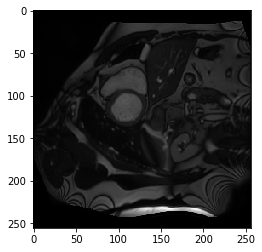

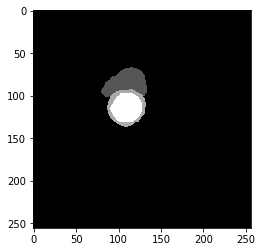

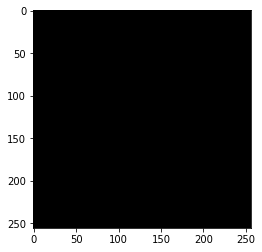

best performance: dice 0.95, idx 34


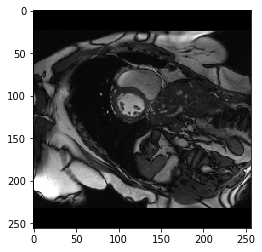

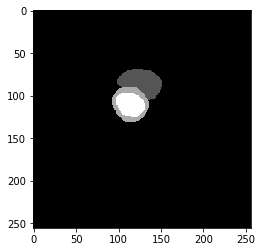

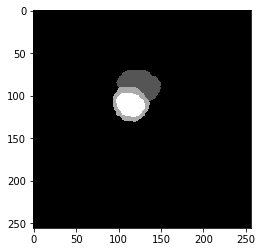

----------

EPOCH 65 of 70

Training Loss: 1.2042
0 Class, True Pos 57668376.0, False Pos 57920.0, False Neg 56177.0, Dice score 1.00
1 Class, True Pos 559204.0, False Pos 32774.0, False Neg 39526.0, Dice score 0.94
2 Class, True Pos 609729.0, False Pos 65722.0, False Neg 50563.0, Dice score 0.91
3 Class, True Pos 625890.0, False Pos 18152.0, False Neg 28302.0, Dice score 0.96
----------
Vaildation Loss: 4.0653
0 Class, True Pos 62995592.0, False Pos 386798.0, False Neg 72864.0, Dice score 1.00
1 Class, True Pos 422723.0, False Pos 40166.0, False Neg 208203.0, Dice score 0.77
2 Class, True Pos 499981.0, False Pos 83663.0, False Neg 167944.0, Dice score 0.80
3 Class, True Pos 553483.0, False Pos 29305.0, False Neg 90921.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


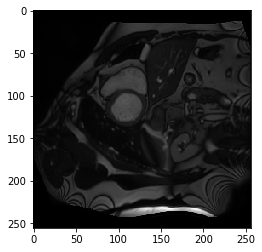

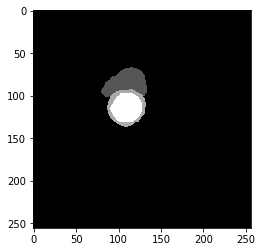

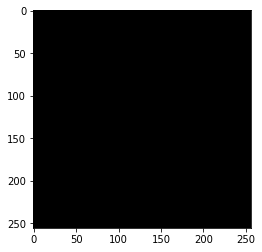

best performance: dice 0.95, idx 37


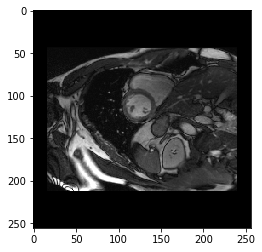

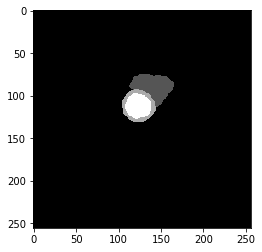

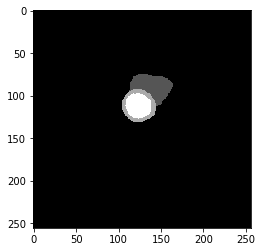

----------

EPOCH 66 of 70

Training Loss: 1.2198
0 Class, True Pos 57660764.0, False Pos 59634.0, False Neg 58512.0, Dice score 1.00
1 Class, True Pos 564017.0, False Pos 35769.0, False Neg 39860.0, Dice score 0.94
2 Class, True Pos 609286.0, False Pos 65660.0, False Neg 51133.0, Dice score 0.91
3 Class, True Pos 624495.0, False Pos 18139.0, False Neg 29697.0, Dice score 0.96
----------
Vaildation Loss: 3.7273
0 Class, True Pos 62983132.0, False Pos 325803.0, False Neg 85337.0, Dice score 1.00
1 Class, True Pos 448763.0, False Pos 42455.0, False Neg 182163.0, Dice score 0.80
2 Class, True Pos 529125.0, False Pos 102568.0, False Neg 138800.0, Dice score 0.81
3 Class, True Pos 552530.0, False Pos 27348.0, False Neg 91874.0, Dice score 0.90
----------
worst performance: dice 0.25, idx 20


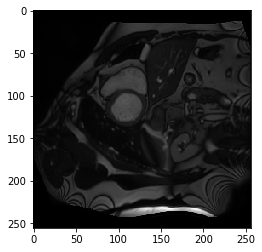

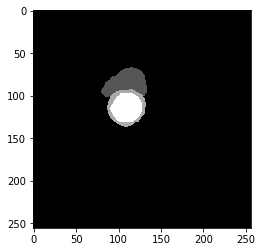

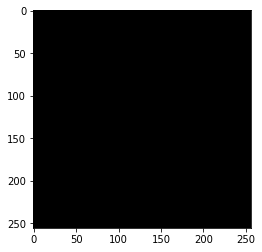

best performance: dice 0.95, idx 31


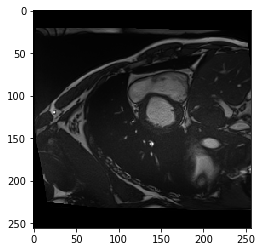

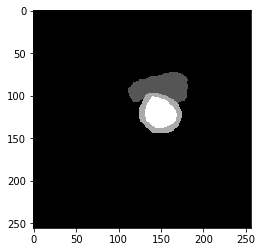

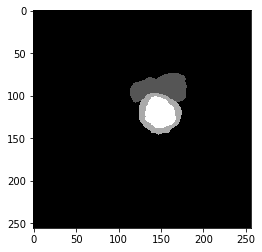

Dice Score: 0.8784
----------

EPOCH 67 of 70

Training Loss: 1.1976
0 Class, True Pos 57685308.0, False Pos 60149.0, False Neg 55795.0, Dice score 1.00
1 Class, True Pos 561890.0, False Pos 35768.0, False Neg 37466.0, Dice score 0.94
2 Class, True Pos 595103.0, False Pos 60307.0, False Neg 54101.0, Dice score 0.91
3 Class, True Pos 620424.0, False Pos 18810.0, False Neg 27672.0, Dice score 0.96
----------
Vaildation Loss: 4.9313
0 Class, True Pos 63001172.0, False Pos 497328.0, False Neg 67273.0, Dice score 1.00
1 Class, True Pos 342197.0, False Pos 21760.0, False Neg 288729.0, Dice score 0.69
2 Class, True Pos 488857.0, False Pos 98100.0, False Neg 179068.0, Dice score 0.78
3 Class, True Pos 535500.0, False Pos 26786.0, False Neg 108904.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


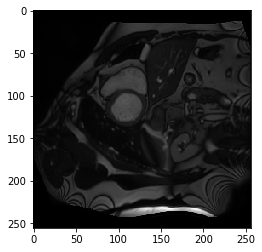

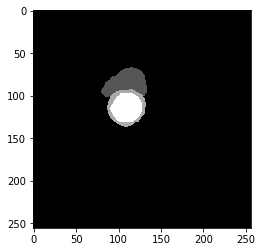

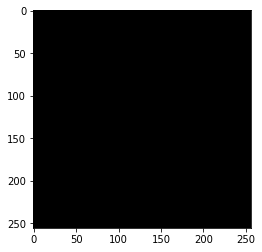

best performance: dice 0.95, idx 37


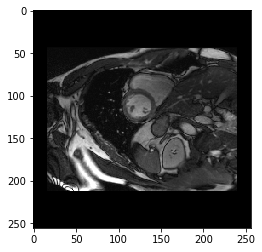

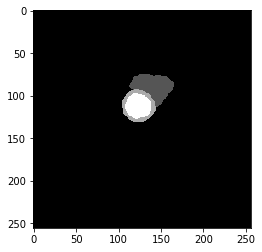

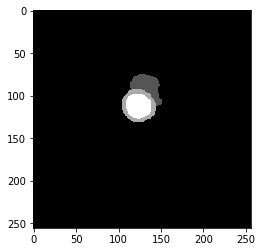

----------

EPOCH 68 of 70

Training Loss: 1.2154
0 Class, True Pos 57684840.0, False Pos 56404.0, False Neg 56469.0, Dice score 1.00
1 Class, True Pos 552754.0, False Pos 35276.0, False Neg 37128.0, Dice score 0.94
2 Class, True Pos 600911.0, False Pos 62826.0, False Neg 52708.0, Dice score 0.91
3 Class, True Pos 625641.0, False Pos 19100.0, False Neg 27301.0, Dice score 0.96
----------
Vaildation Loss: 4.5352
0 Class, True Pos 62994272.0, False Pos 432807.0, False Neg 74196.0, Dice score 1.00
1 Class, True Pos 423718.0, False Pos 43280.0, False Neg 207208.0, Dice score 0.77
2 Class, True Pos 479691.0, False Pos 95624.0, False Neg 188234.0, Dice score 0.77
3 Class, True Pos 524507.0, False Pos 17824.0, False Neg 119897.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


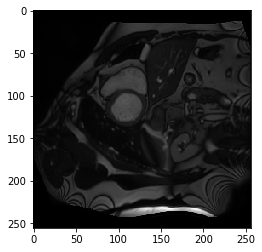

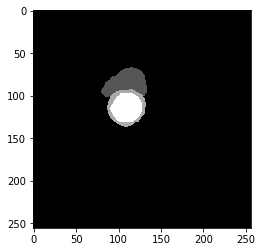

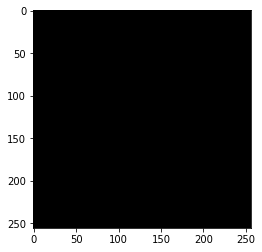

best performance: dice 0.95, idx 37


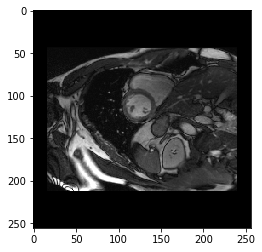

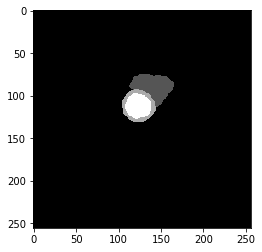

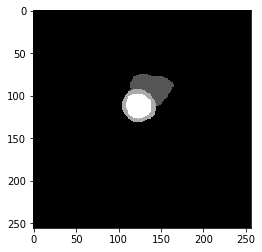

----------

EPOCH 69 of 70

Training Loss: 1.1763
0 Class, True Pos 57678920.0, False Pos 61633.0, False Neg 51449.0, Dice score 1.00
1 Class, True Pos 561122.0, False Pos 30872.0, False Neg 38367.0, Dice score 0.94
2 Class, True Pos 603503.0, False Pos 61740.0, False Neg 52071.0, Dice score 0.91
3 Class, True Pos 622140.0, False Pos 17829.0, False Neg 30187.0, Dice score 0.96
----------
Vaildation Loss: 3.9218
0 Class, True Pos 62985628.0, False Pos 350348.0, False Neg 82815.0, Dice score 1.00
1 Class, True Pos 449417.0, False Pos 46832.0, False Neg 181509.0, Dice score 0.80
2 Class, True Pos 517791.0, False Pos 102187.0, False Neg 150134.0, Dice score 0.80
3 Class, True Pos 538039.0, False Pos 21456.0, False Neg 106365.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


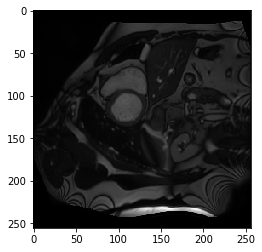

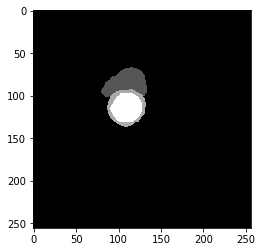

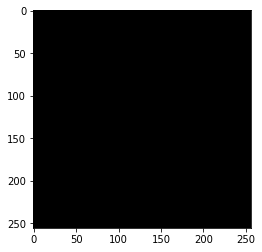

best performance: dice 0.95, idx 31


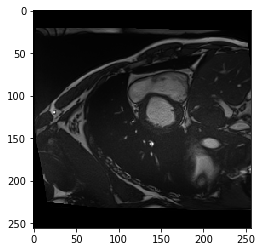

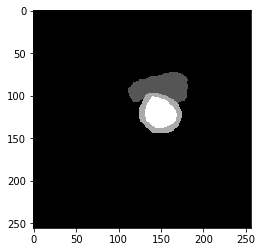

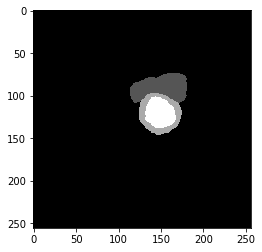

----------

EPOCH 70 of 70

Training Loss: 1.2127
0 Class, True Pos 57702544.0, False Pos 54689.0, False Neg 55677.0, Dice score 1.00
1 Class, True Pos 544566.0, False Pos 34204.0, False Neg 33304.0, Dice score 0.94
2 Class, True Pos 598885.0, False Pos 64212.0, False Neg 52271.0, Dice score 0.91
3 Class, True Pos 620244.0, False Pos 18419.0, False Neg 30272.0, Dice score 0.96
----------
Vaildation Loss: 3.8497
0 Class, True Pos 62993224.0, False Pos 366402.0, False Neg 75234.0, Dice score 1.00
1 Class, True Pos 411284.0, False Pos 34997.0, False Neg 219642.0, Dice score 0.76
2 Class, True Pos 526083.0, False Pos 96070.0, False Neg 141842.0, Dice score 0.82
3 Class, True Pos 557088.0, False Pos 26565.0, False Neg 87316.0, Dice score 0.91
----------
worst performance: dice 0.25, idx 20


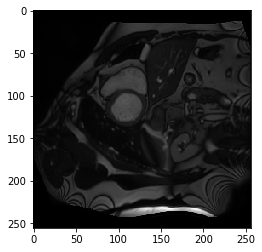

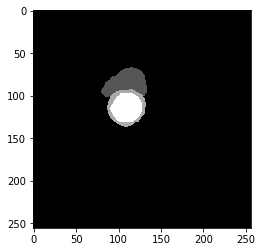

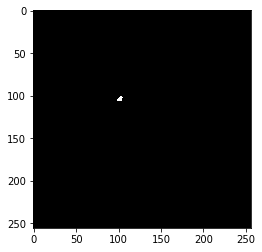

best performance: dice 0.95, idx 34


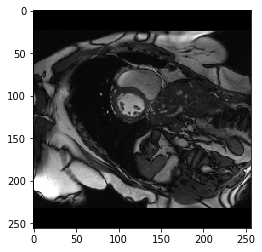

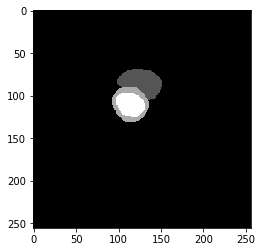

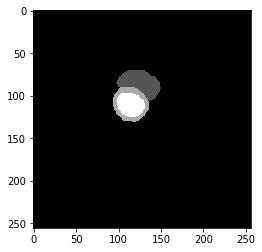

----------
tensor(0.8784)


In [12]:
best_model_wts, dice_score = run_training(model,device,num_class,scheduler,optimizer,dice_loss,num_epochs,train_generator,train_dataset,validation_generator,validation_dataset,writer)
print(dice_score)

### save model

In [13]:
## load best model weights
model.load_state_dict(best_model_wts)
## save model
torch.save(model.state_dict(), 'new_weight.pt')

### Save model as ONNX

In [14]:
dummy_input = torch.randn(1, 1, 256, 256, device='cpu')
torch.onnx.export(model.cpu(), dummy_input, "new_weight.onnx", verbose=True)

graph(%0 : Float(1, 1, 256, 256)
      %1 : Float(16, 1, 3, 3)
      %2 : Float(16)
      %3 : Float(16)
      %4 : Float(16)
      %5 : Float(16)
      %6 : Float(16)
      %7 : Long()
      %8 : Float(16, 16, 3, 3)
      %9 : Float(16)
      %10 : Float(16)
      %11 : Float(16)
      %12 : Float(16)
      %13 : Float(16)
      %14 : Long()
      %15 : Float(32, 16, 3, 3)
      %16 : Float(32)
      %17 : Float(32)
      %18 : Float(32)
      %19 : Float(32)
      %20 : Float(32)
      %21 : Long()
      %22 : Float(32, 32, 3, 3)
      %23 : Float(32)
      %24 : Float(32)
      %25 : Float(32)
      %26 : Float(32)
      %27 : Float(32)
      %28 : Long()
      %29 : Float(64, 32, 3, 3)
      %30 : Float(64)
      %31 : Float(64)
      %32 : Float(64)
      %33 : Float(64)
      %34 : Float(64)
      %35 : Long()
      %36 : Float(64, 64, 3, 3)
      %37 : Float(64)
      %38 : Float(64)
      %39 : Float(64)
      %40 : Float(64)
      %41 : Float(64)
      %42 : Long()
      %43 :

In [ ]:
# print learnt weights to verify MATLAB has correctly imported them
for name, param in model.named_parameters():
    print (name, param.data)

# With Data Augmentation

### seed

In [15]:
# IMPORTANT!
# must seed the same value each time when training a new network
seed = 256
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

### Unet

In [16]:
# initialize model
model = unet(useBN=True)
model.to(device)

unet(
  (conv1): Sequential(
    (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv2): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv3): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e

### optimizer and learing rate decay

In [17]:
# intialize optimizer and lr decay
optimizer = torch.optim.Adam(model.parameters(),lr=learning_rate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

In [18]:
train_both_aug = Compose([
        PadIfNeeded(min_height=256, min_width=256, border_mode=0, value=0,p=1),
        RandomCrop(height=256, width=256, p=1),
        Cutout(p=0.5),
        OneOf([
            ShiftScaleRotate(p=0.7),
            HorizontalFlip(p=0.8),
            VerticalFlip(p=0.8)
        ])
    ])
train_img_aug = Compose([
    OneOf([
            RandomBrightnessContrast(brightness_limit=(-0.2,0.2), contrast_limit=(-0.5,0.5),p=0.9),
            RandomGamma(gamma_limit=(50,200),p=0.8)
        ]),
])


val_both_aug = Compose([
    PadIfNeeded(min_height=256, min_width=256, border_mode=0, value=0,p=1),
    RandomCrop(height=256, width=256, p=1)
])

train_dataset=ACDCDataset(data_type="train",transform_both=train_both_aug,transform_image=None)
validation_dataset=ACDCDataset(data_type="validation",transform_both=val_both_aug,transform_image=None)

# # show one example
# img_ED,img_ES,label_ED,label_ES = train_dataset.__getitem__(0)
# imshow(img_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(img_ES.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ES.permute(1,2,0)[:,:,3],denormalize=False)

# # show one example
# img_ED,img_ES,label_ED,label_ES = validation_dataset.__getitem__(0)
# imshow(img_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(img_ES.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ED.permute(1,2,0)[:,:,3],denormalize=False)
# imshow(label_ES.permute(1,2,0)[:,:,3],denormalize=False)

# intialize the dataloader
train_generator = DataLoader(train_dataset,shuffle=True,batch_size=train_batch_size,num_workers=8)
validation_generator = DataLoader(validation_dataset,shuffle=True,batch_size=validation_batch_size,num_workers=8)

### Start Training

Training Started!

EPOCH 1 of 140

Training Loss: 17.1172
0 Class, True Pos 33212660.0, False Pos 118464.0, False Neg 24522848.0, Dice score 0.73
1 Class, True Pos 107789.0, False Pos 6372458.0, False Neg 487711.0, Dice score 0.03
2 Class, True Pos 506530.0, False Pos 14396216.0, False Neg 151105.0, Dice score 0.07
3 Class, True Pos 397373.0, False Pos 4526273.0, False Neg 251749.0, Dice score 0.14
----------
Vaildation Loss: 18.4012
0 Class, True Pos 37323864.0, False Pos 162674.0, False Neg 25744600.0, Dice score 0.74
1 Class, True Pos 325569.0, False Pos 8926616.0, False Neg 305357.0, Dice score 0.07
2 Class, True Pos 549376.0, False Pos 16657331.0, False Neg 118549.0, Dice score 0.06
3 Class, True Pos 282105.0, False Pos 784179.0, False Neg 362299.0, Dice score 0.33
----------
worst performance: dice 0.13, idx 17


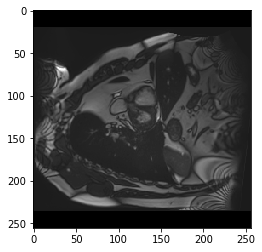

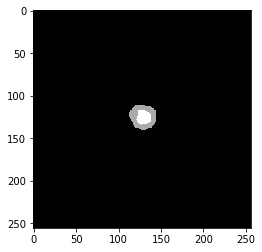

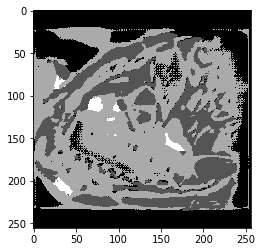

best performance: dice 0.39, idx 4


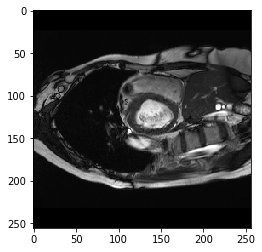

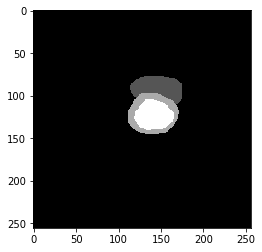

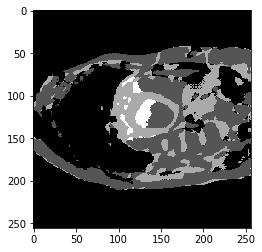

Dice Score: 0.2999
----------

EPOCH 2 of 140

Training Loss: 16.5099
0 Class, True Pos 40082244.0, False Pos 135679.0, False Neg 17664418.0, Dice score 0.82
1 Class, True Pos 301354.0, False Pos 12592152.0, False Neg 278831.0, Dice score 0.04
2 Class, True Pos 475166.0, False Pos 4288659.0, False Neg 182524.0, Dice score 0.18
3 Class, True Pos 415010.0, False Pos 1347501.0, False Neg 238217.0, Dice score 0.34
----------
Vaildation Loss: 17.9563
0 Class, True Pos 46361776.0, False Pos 375339.0, False Neg 16706673.0, Dice score 0.84
1 Class, True Pos 450592.0, False Pos 15894797.0, False Neg 180334.0, Dice score 0.05
2 Class, True Pos 300734.0, False Pos 746638.0, False Neg 367191.0, Dice score 0.35
3 Class, True Pos 343701.0, False Pos 538127.0, False Neg 300703.0, Dice score 0.45
----------
worst performance: dice 0.24, idx 3


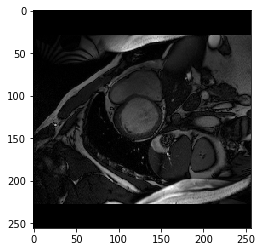

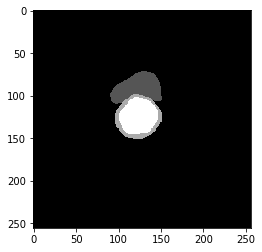

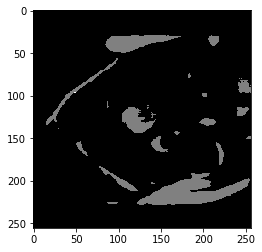

best performance: dice 0.57, idx 24


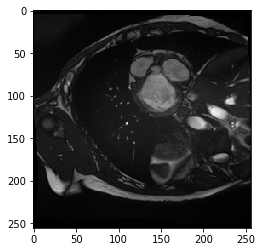

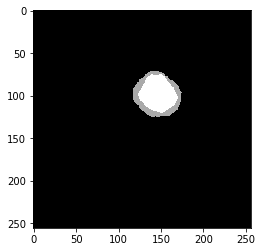

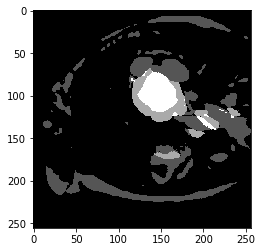

Dice Score: 0.4246
----------

EPOCH 3 of 140

Training Loss: 15.6724
0 Class, True Pos 43167572.0, False Pos 158405.0, False Neg 14549964.0, Dice score 0.85
1 Class, True Pos 369271.0, False Pos 12725865.0, False Neg 233082.0, Dice score 0.05
2 Class, True Pos 458994.0, False Pos 1666954.0, False Neg 201886.0, Dice score 0.33
3 Class, True Pos 417842.0, False Pos 672852.0, False Neg 239144.0, Dice score 0.48
----------
Vaildation Loss: 17.6211
0 Class, True Pos 38089768.0, False Pos 105097.0, False Neg 24978676.0, Dice score 0.75
1 Class, True Pos 184056.0, False Pos 6486652.0, False Neg 446870.0, Dice score 0.05
2 Class, True Pos 544859.0, False Pos 17261120.0, False Neg 123066.0, Dice score 0.06
3 Class, True Pos 467417.0, False Pos 1872733.0, False Neg 176987.0, Dice score 0.31
----------
worst performance: dice 0.10, idx 17


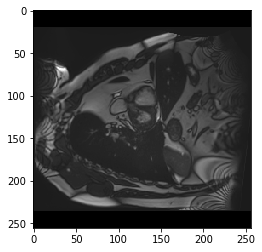

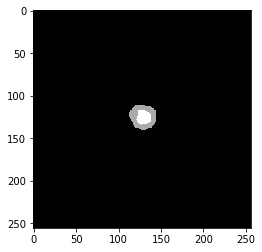

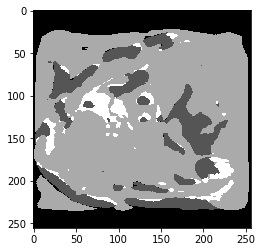

best performance: dice 0.45, idx 24


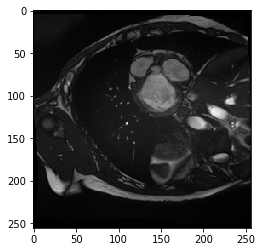

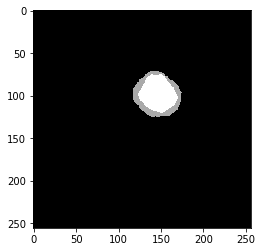

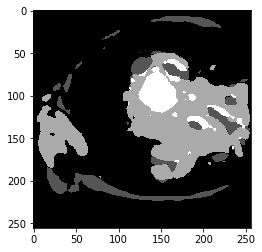

----------

EPOCH 4 of 140

Training Loss: 13.9095
0 Class, True Pos 46618248.0, False Pos 221009.0, False Neg 11098249.0, Dice score 0.89
1 Class, True Pos 364000.0, False Pos 9680302.0, False Neg 241461.0, Dice score 0.07
2 Class, True Pos 436561.0, False Pos 1306216.0, False Neg 224278.0, Dice score 0.36
3 Class, True Pos 454956.0, False Pos 556472.0, False Neg 200011.0, Dice score 0.55
----------
Vaildation Loss: 14.9533
0 Class, True Pos 50587856.0, False Pos 357805.0, False Neg 12480614.0, Dice score 0.89
1 Class, True Pos 248107.0, False Pos 11209597.0, False Neg 382819.0, Dice score 0.04
2 Class, True Pos 410279.0, False Pos 1060052.0, False Neg 257646.0, Dice score 0.38
3 Class, True Pos 489776.0, False Pos 648253.0, False Neg 154628.0, Dice score 0.55
----------
worst performance: dice 0.24, idx 2


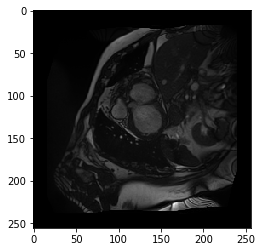

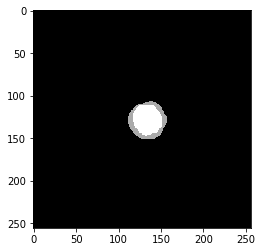

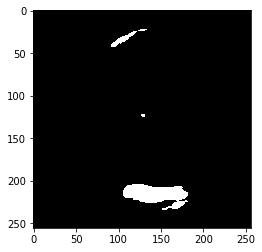

best performance: dice 0.59, idx 12


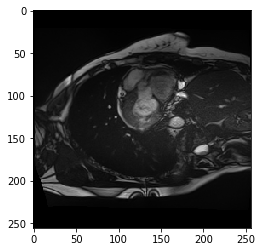

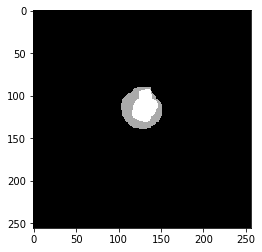

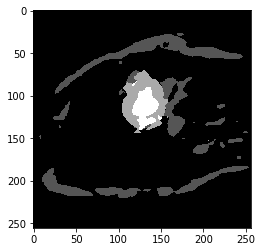

Dice Score: 0.4654
----------

EPOCH 5 of 140

Training Loss: 10.9697
0 Class, True Pos 49881744.0, False Pos 377966.0, False Neg 7844942.0, Dice score 0.92
1 Class, True Pos 382489.0, False Pos 7533857.0, False Neg 219278.0, Dice score 0.09
2 Class, True Pos 386268.0, False Pos 421605.0, False Neg 271980.0, Dice score 0.53
3 Class, True Pos 452772.0, False Pos 201064.0, False Neg 198292.0, Dice score 0.69
----------
Vaildation Loss: 14.1313
0 Class, True Pos 55308492.0, False Pos 513971.0, False Neg 7759959.0, Dice score 0.93
1 Class, True Pos 427112.0, False Pos 7731898.0, False Neg 203814.0, Dice score 0.10
2 Class, True Pos 359226.0, False Pos 543297.0, False Neg 308699.0, Dice score 0.46
3 Class, True Pos 108909.0, False Pos 18801.0, False Neg 535495.0, Dice score 0.28
----------
worst performance: dice 0.24, idx 3


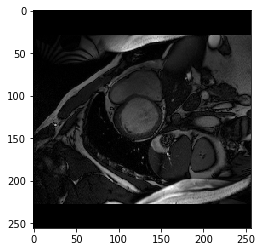

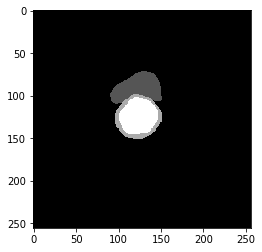

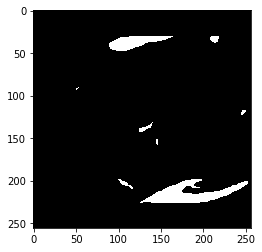

best performance: dice 0.55, idx 23


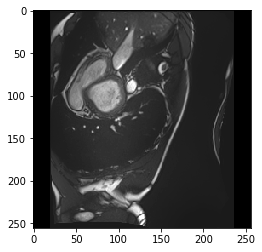

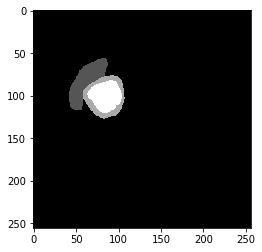

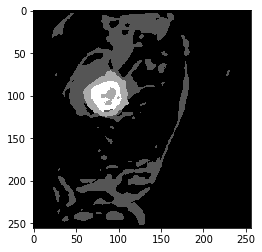

----------

EPOCH 6 of 140

Training Loss: 8.7883
0 Class, True Pos 52471356.0, False Pos 420852.0, False Neg 5257028.0, Dice score 0.95
1 Class, True Pos 374953.0, False Pos 5178920.0, False Neg 214226.0, Dice score 0.12
2 Class, True Pos 403953.0, False Pos 256260.0, False Neg 252523.0, Dice score 0.61
3 Class, True Pos 456757.0, False Pos 74700.0, False Neg 206955.0, Dice score 0.76
----------
Vaildation Loss: 9.9113
0 Class, True Pos 61560356.0, False Pos 653484.0, False Neg 1508113.0, Dice score 0.98
1 Class, True Pos 287491.0, False Pos 1435024.0, False Neg 343435.0, Dice score 0.24
2 Class, True Pos 355377.0, False Pos 113364.0, False Neg 312548.0, Dice score 0.63
3 Class, True Pos 489546.0, False Pos 117082.0, False Neg 154858.0, Dice score 0.78
----------
worst performance: dice 0.25, idx 2


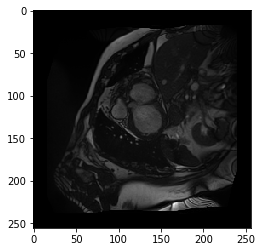

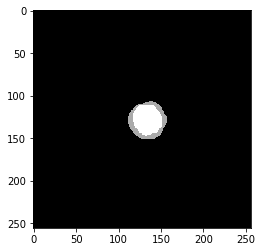

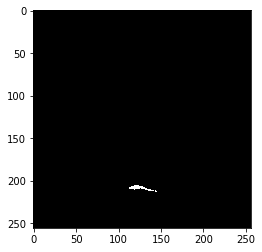

best performance: dice 0.82, idx 30


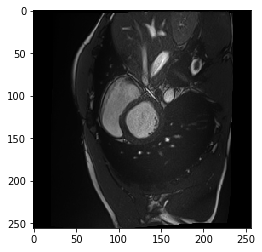

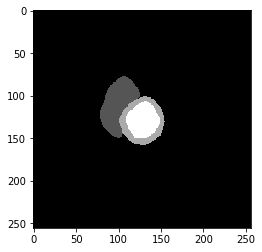

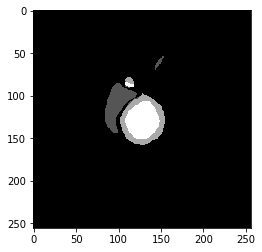

Dice Score: 0.6587
----------

EPOCH 7 of 140

Training Loss: 7.2482
0 Class, True Pos 56204228.0, False Pos 509045.0, False Neg 1531427.0, Dice score 0.98
1 Class, True Pos 292716.0, False Pos 1479048.0, False Neg 304470.0, Dice score 0.25
2 Class, True Pos 428727.0, False Pos 200822.0, False Neg 226841.0, Dice score 0.67
3 Class, True Pos 470976.0, False Pos 52201.0, False Neg 178378.0, Dice score 0.80
----------
Vaildation Loss: 8.6484
0 Class, True Pos 62074544.0, False Pos 482694.0, False Neg 993899.0, Dice score 0.99
1 Class, True Pos 412998.0, False Pos 909478.0, False Neg 217928.0, Dice score 0.42
2 Class, True Pos 429906.0, False Pos 194005.0, False Neg 238019.0, Dice score 0.67
3 Class, True Pos 455715.0, False Pos 52358.0, False Neg 188689.0, Dice score 0.79
----------
worst performance: dice 0.25, idx 2


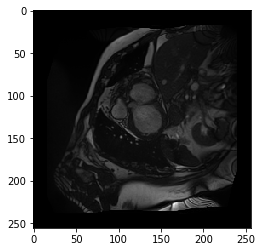

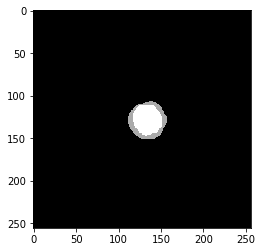

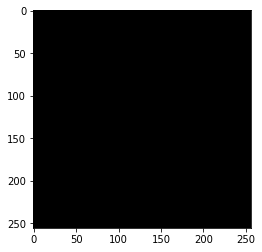

best performance: dice 0.85, idx 41


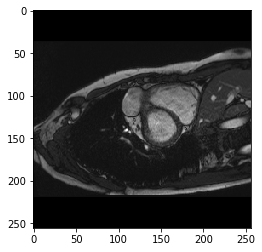

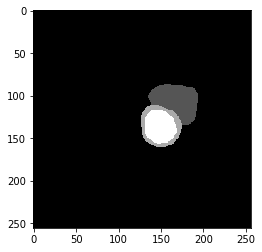

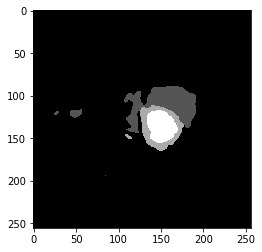

Dice Score: 0.7169
----------

EPOCH 8 of 140

Training Loss: 5.7397
0 Class, True Pos 57417852.0, False Pos 418295.0, False Neg 347594.0, Dice score 0.99
1 Class, True Pos 343462.0, False Pos 282578.0, False Neg 236148.0, Dice score 0.57
2 Class, True Pos 432649.0, False Pos 185349.0, False Neg 214394.0, Dice score 0.68
3 Class, True Pos 494148.0, False Pos 63437.0, False Neg 151523.0, Dice score 0.82
----------
Vaildation Loss: 12.2203
0 Class, True Pos 63008000.0, False Pos 1149312.0, False Neg 60458.0, Dice score 0.99
1 Class, True Pos 245846.0, False Pos 162053.0, False Neg 385080.0, Dice score 0.47
2 Class, True Pos 162206.0, False Pos 45445.0, False Neg 505719.0, Dice score 0.37
3 Class, True Pos 235419.0, False Pos 3432.0, False Neg 408985.0, Dice score 0.53
----------
worst performance: dice 0.24, idx 1


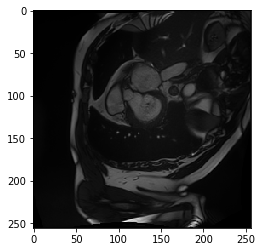

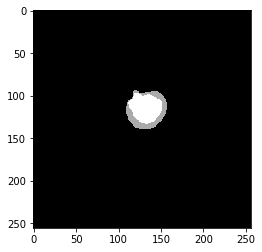

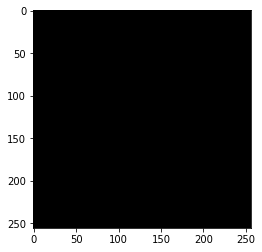

best performance: dice 0.90, idx 45


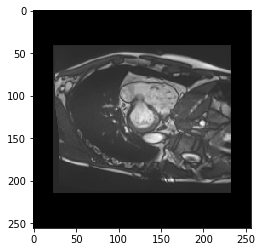

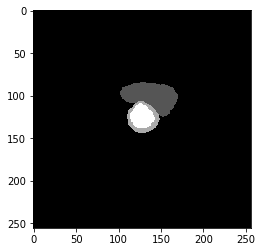

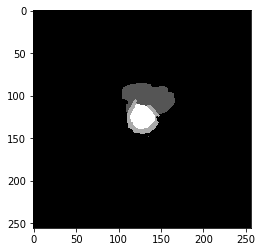

----------

EPOCH 9 of 140

Training Loss: 5.5467
0 Class, True Pos 57488636.0, False Pos 407383.0, False Neg 310543.0, Dice score 0.99
1 Class, True Pos 329017.0, False Pos 245461.0, False Neg 252704.0, Dice score 0.57
2 Class, True Pos 427940.0, False Pos 183093.0, False Neg 196376.0, Dice score 0.69
3 Class, True Pos 495013.0, False Pos 61218.0, False Neg 137532.0, Dice score 0.83
----------
Vaildation Loss: 8.0850
0 Class, True Pos 62949948.0, False Pos 751072.0, False Neg 118503.0, Dice score 0.99
1 Class, True Pos 308498.0, False Pos 96780.0, False Neg 322428.0, Dice score 0.60
2 Class, True Pos 358548.0, False Pos 165068.0, False Neg 309377.0, Dice score 0.60
3 Class, True Pos 372981.0, False Pos 8811.0, False Neg 271423.0, Dice score 0.73
----------
worst performance: dice 0.25, idx 2


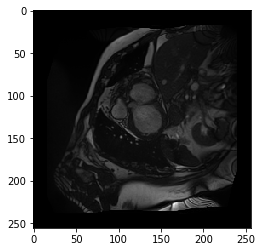

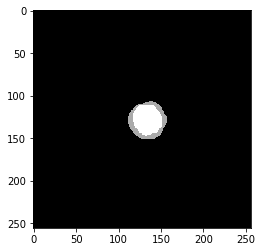

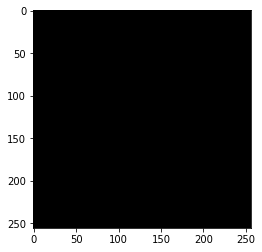

best performance: dice 0.88, idx 29


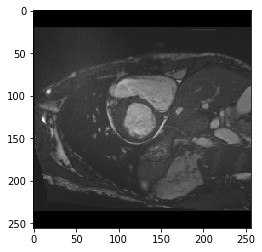

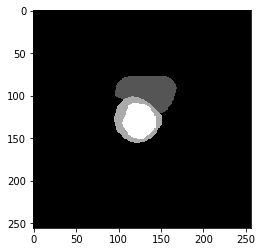

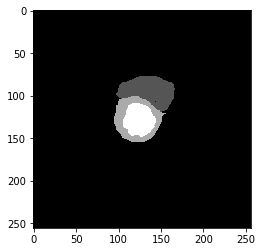

Dice Score: 0.7293
----------

EPOCH 10 of 140

Training Loss: 4.7348
0 Class, True Pos 57495908.0, False Pos 406334.0, False Neg 253472.0, Dice score 0.99
1 Class, True Pos 357120.0, False Pos 199275.0, False Neg 228332.0, Dice score 0.63
2 Class, True Pos 448041.0, False Pos 159018.0, False Neg 205048.0, Dice score 0.71
3 Class, True Pos 520982.0, False Pos 51081.0, False Neg 128856.0, Dice score 0.85
----------
Vaildation Loss: 8.7151
0 Class, True Pos 62992876.0, False Pos 883188.0, False Neg 75576.0, Dice score 0.99
1 Class, True Pos 288870.0, False Pos 148363.0, False Neg 342056.0, Dice score 0.54
2 Class, True Pos 280555.0, False Pos 69262.0, False Neg 387370.0, Dice score 0.55
3 Class, True Pos 344959.0, False Pos 3634.0, False Neg 299445.0, Dice score 0.69
----------
worst performance: dice 0.25, idx 2


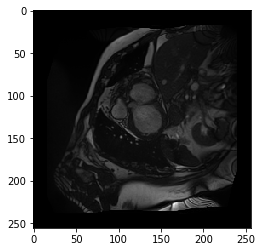

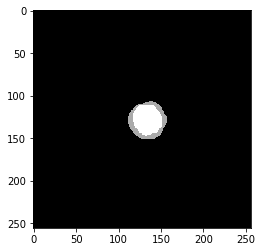

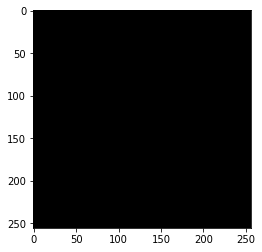

best performance: dice 0.90, idx 37


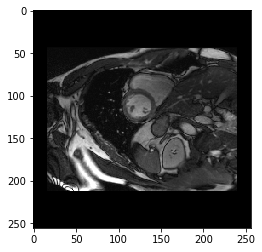

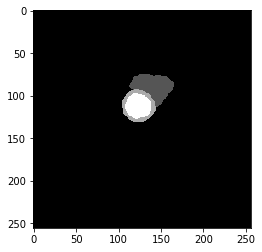

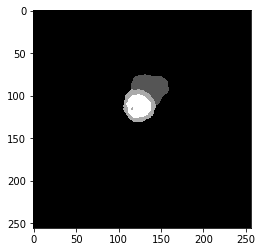

----------

EPOCH 11 of 140

Training Loss: 4.0187
0 Class, True Pos 57565684.0, False Pos 379828.0, False Neg 156983.0, Dice score 1.00
1 Class, True Pos 399184.0, False Pos 155551.0, False Neg 206007.0, Dice score 0.69
2 Class, True Pos 462988.0, False Pos 126796.0, False Neg 193916.0, Dice score 0.74
3 Class, True Pos 518524.0, False Pos 29204.0, False Neg 134473.0, Dice score 0.86
----------
Vaildation Loss: 5.9429
0 Class, True Pos 62793488.0, False Pos 446819.0, False Neg 274953.0, Dice score 0.99
1 Class, True Pos 438444.0, False Pos 204656.0, False Neg 192482.0, Dice score 0.69
2 Class, True Pos 457523.0, False Pos 137087.0, False Neg 210402.0, Dice score 0.72
3 Class, True Pos 503115.0, False Pos 30564.0, False Neg 141289.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 2


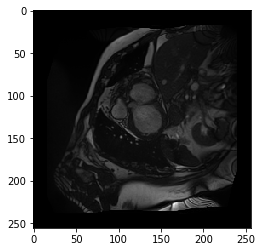

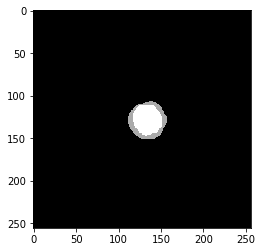

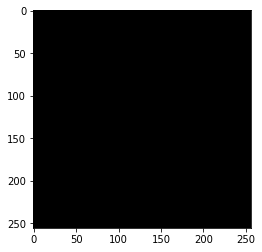

best performance: dice 0.91, idx 48


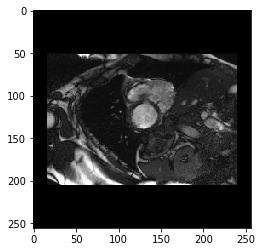

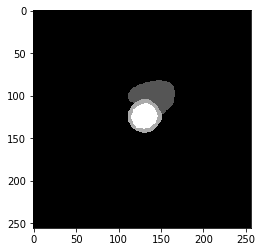

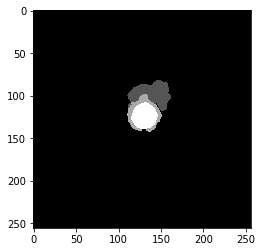

Dice Score: 0.8154
----------

EPOCH 12 of 140

Training Loss: 3.9098
0 Class, True Pos 57562704.0, False Pos 390046.0, False Neg 169205.0, Dice score 1.00
1 Class, True Pos 380708.0, False Pos 132874.0, False Neg 207480.0, Dice score 0.69
2 Class, True Pos 472954.0, False Pos 128147.0, False Neg 181755.0, Dice score 0.75
3 Class, True Pos 532395.0, False Pos 37934.0, False Neg 130561.0, Dice score 0.86
----------
Vaildation Loss: 5.4723
0 Class, True Pos 62751840.0, False Pos 361589.0, False Neg 316621.0, Dice score 0.99
1 Class, True Pos 462054.0, False Pos 250713.0, False Neg 168872.0, Dice score 0.69
2 Class, True Pos 478348.0, False Pos 140373.0, False Neg 189577.0, Dice score 0.74
3 Class, True Pos 528053.0, False Pos 38746.0, False Neg 116351.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 20


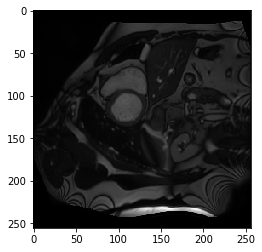

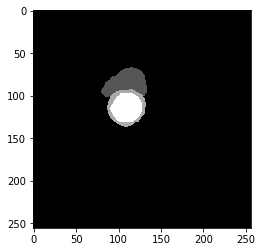

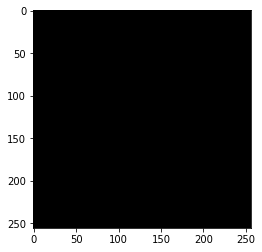

best performance: dice 0.91, idx 48


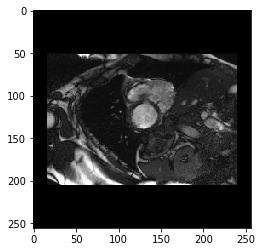

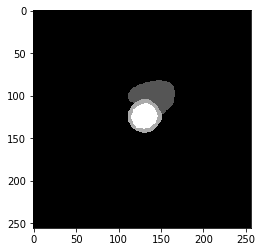

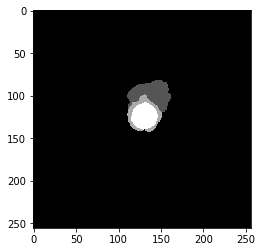

Dice Score: 0.8245
----------

EPOCH 13 of 140

Training Loss: 3.5550
0 Class, True Pos 57559392.0, False Pos 322763.0, False Neg 162486.0, Dice score 1.00
1 Class, True Pos 426140.0, False Pos 137731.0, False Neg 178205.0, Dice score 0.73
2 Class, True Pos 490826.0, False Pos 125232.0, False Neg 167506.0, Dice score 0.77
3 Class, True Pos 546754.0, False Pos 28915.0, False Neg 106444.0, Dice score 0.89
----------
Vaildation Loss: 5.6180
0 Class, True Pos 62843128.0, False Pos 435538.0, False Neg 225334.0, Dice score 0.99
1 Class, True Pos 431318.0, False Pos 165573.0, False Neg 199608.0, Dice score 0.70
2 Class, True Pos 469930.0, False Pos 129825.0, False Neg 197995.0, Dice score 0.74
3 Class, True Pos 509445.0, False Pos 26960.0, False Neg 134959.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


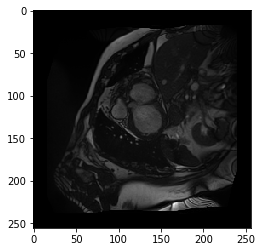

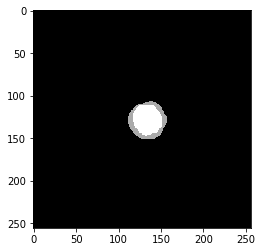

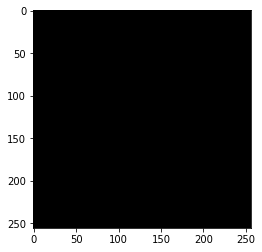

best performance: dice 0.92, idx 48


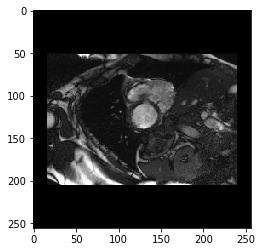

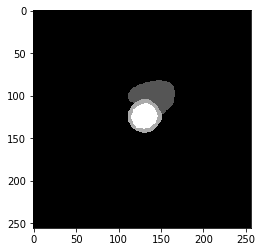

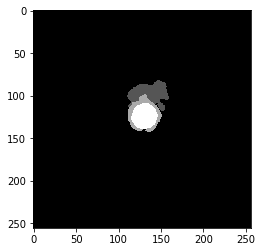

Dice Score: 0.8254
----------

EPOCH 14 of 140

Training Loss: 3.4797
0 Class, True Pos 57570516.0, False Pos 324927.0, False Neg 150660.0, Dice score 1.00
1 Class, True Pos 422886.0, False Pos 124660.0, False Neg 173668.0, Dice score 0.74
2 Class, True Pos 492426.0, False Pos 122834.0, False Neg 166793.0, Dice score 0.77
3 Class, True Pos 554713.0, False Pos 24792.0, False Neg 106092.0, Dice score 0.89
----------
Vaildation Loss: 5.8060
0 Class, True Pos 62875200.0, False Pos 481843.0, False Neg 193255.0, Dice score 0.99
1 Class, True Pos 428148.0, False Pos 150872.0, False Neg 202778.0, Dice score 0.71
2 Class, True Pos 446692.0, False Pos 110850.0, False Neg 221233.0, Dice score 0.73
3 Class, True Pos 495248.0, False Pos 22857.0, False Neg 149156.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 2


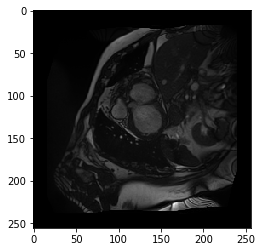

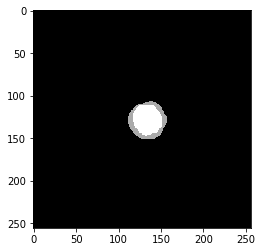

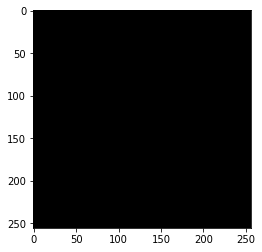

best performance: dice 0.92, idx 48


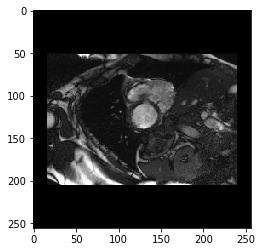

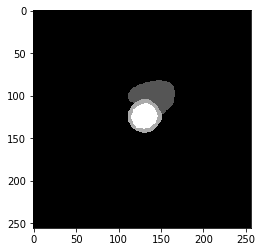

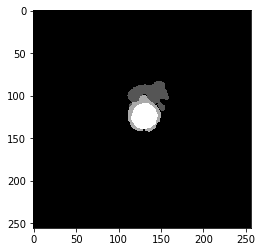

----------

EPOCH 15 of 140

Training Loss: 3.4364
0 Class, True Pos 57590224.0, False Pos 287065.0, False Neg 161511.0, Dice score 1.00
1 Class, True Pos 434728.0, False Pos 131643.0, False Neg 165344.0, Dice score 0.75
2 Class, True Pos 490495.0, False Pos 121799.0, False Neg 149033.0, Dice score 0.78
3 Class, True Pos 551767.0, False Pos 30035.0, False Neg 94654.0, Dice score 0.90
----------
Vaildation Loss: 5.2183
0 Class, True Pos 62856120.0, False Pos 393068.0, False Neg 212333.0, Dice score 1.00
1 Class, True Pos 442099.0, False Pos 163601.0, False Neg 188827.0, Dice score 0.72
2 Class, True Pos 472397.0, False Pos 118663.0, False Neg 195528.0, Dice score 0.75
3 Class, True Pos 530871.0, False Pos 34889.0, False Neg 113533.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


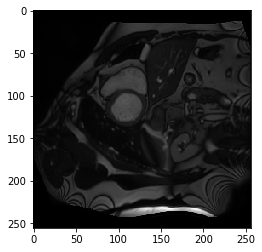

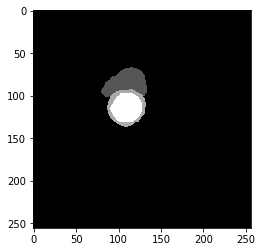

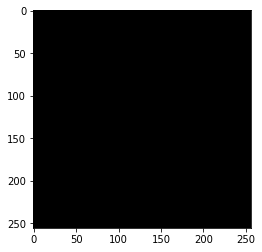

best performance: dice 0.92, idx 37


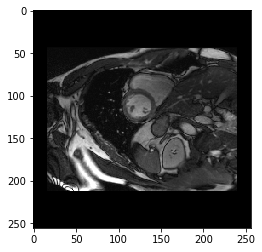

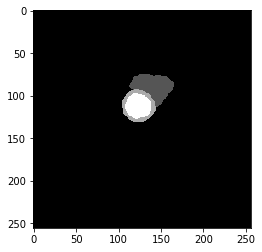

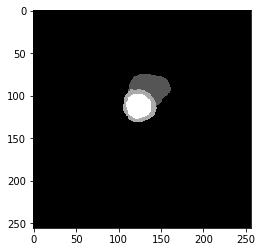

Dice Score: 0.8345
----------

EPOCH 16 of 140

Training Loss: 3.5813
0 Class, True Pos 57579068.0, False Pos 330502.0, False Neg 147139.0, Dice score 1.00
1 Class, True Pos 405806.0, False Pos 109010.0, False Neg 200444.0, Dice score 0.72
2 Class, True Pos 491707.0, False Pos 128725.0, False Neg 161635.0, Dice score 0.77
3 Class, True Pos 560915.0, False Pos 32033.0, False Neg 91052.0, Dice score 0.90
----------
Vaildation Loss: 5.3778
0 Class, True Pos 62820040.0, False Pos 409456.0, False Neg 248422.0, Dice score 0.99
1 Class, True Pos 454535.0, False Pos 219632.0, False Neg 176391.0, Dice score 0.70
2 Class, True Pos 461419.0, False Pos 104430.0, False Neg 206506.0, Dice score 0.75
3 Class, True Pos 516568.0, False Pos 25637.0, False Neg 127836.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


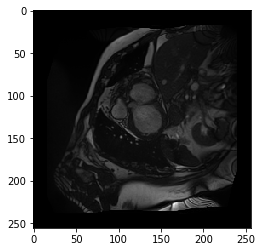

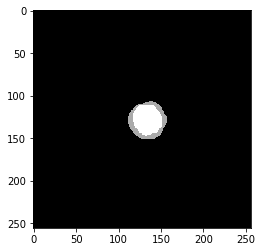

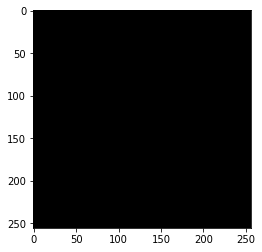

best performance: dice 0.92, idx 48


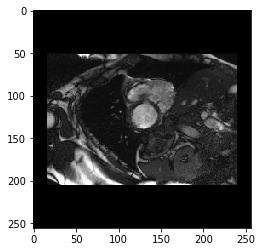

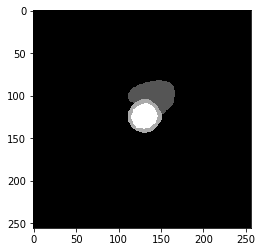

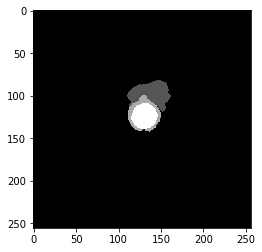

----------

EPOCH 17 of 140

Training Loss: 3.4922
0 Class, True Pos 57585532.0, False Pos 325959.0, False Neg 151057.0, Dice score 1.00
1 Class, True Pos 417409.0, False Pos 124099.0, False Neg 181279.0, Dice score 0.73
2 Class, True Pos 486078.0, False Pos 117048.0, False Neg 167313.0, Dice score 0.77
3 Class, True Pos 552641.0, False Pos 28985.0, False Neg 96442.0, Dice score 0.90
----------
Vaildation Loss: 5.3167
0 Class, True Pos 62831332.0, False Pos 394883.0, False Neg 237130.0, Dice score 0.99
1 Class, True Pos 451227.0, False Pos 192044.0, False Neg 179699.0, Dice score 0.71
2 Class, True Pos 467594.0, False Pos 113261.0, False Neg 200331.0, Dice score 0.75
3 Class, True Pos 528018.0, False Pos 33358.0, False Neg 116386.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


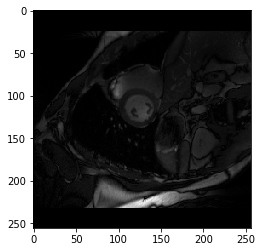

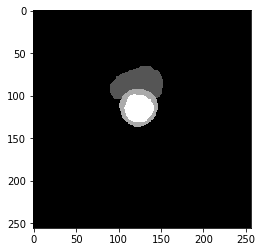

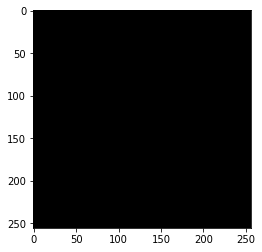

best performance: dice 0.92, idx 48


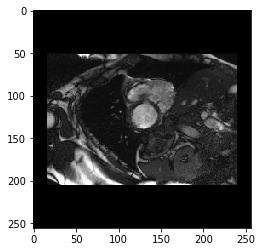

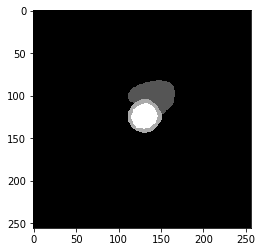

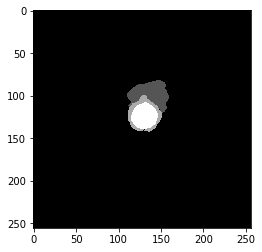

----------

EPOCH 18 of 140

Training Loss: 3.4244
0 Class, True Pos 57551608.0, False Pos 330516.0, False Neg 148498.0, Dice score 1.00
1 Class, True Pos 424693.0, False Pos 120858.0, False Neg 187927.0, Dice score 0.73
2 Class, True Pos 498544.0, False Pos 120520.0, False Neg 168658.0, Dice score 0.78
3 Class, True Pos 562926.0, False Pos 28095.0, False Neg 94906.0, Dice score 0.90
----------
Vaildation Loss: 5.2460
0 Class, True Pos 62863308.0, False Pos 403026.0, False Neg 205149.0, Dice score 1.00
1 Class, True Pos 457208.0, False Pos 182213.0, False Neg 173718.0, Dice score 0.72
2 Class, True Pos 461086.0, False Pos 105544.0, False Neg 206839.0, Dice score 0.75
3 Class, True Pos 517332.0, False Pos 21995.0, False Neg 127072.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


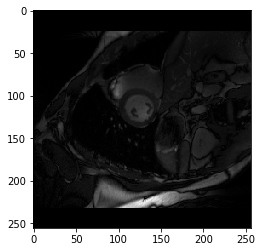

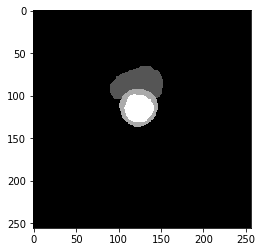

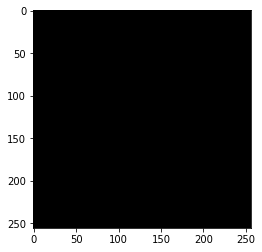

best performance: dice 0.92, idx 48


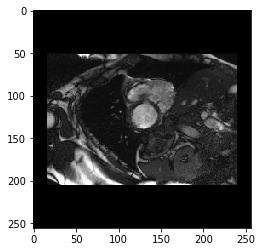

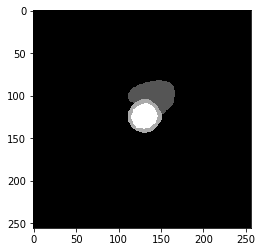

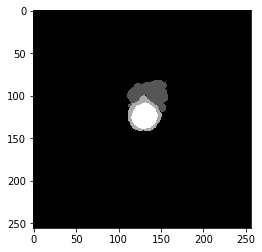

----------

EPOCH 19 of 140

Training Loss: 3.3442
0 Class, True Pos 57565768.0, False Pos 305260.0, False Neg 158614.0, Dice score 1.00
1 Class, True Pos 436794.0, False Pos 129448.0, False Neg 168396.0, Dice score 0.75
2 Class, True Pos 494114.0, False Pos 118799.0, False Neg 163317.0, Dice score 0.78
3 Class, True Pos 558590.0, False Pos 28984.0, False Neg 92164.0, Dice score 0.90
----------
Vaildation Loss: 5.4067
0 Class, True Pos 62909984.0, False Pos 455047.0, False Neg 158481.0, Dice score 1.00
1 Class, True Pos 424629.0, False Pos 132689.0, False Neg 206297.0, Dice score 0.71
2 Class, True Pos 452279.0, False Pos 99216.0, False Neg 215646.0, Dice score 0.74
3 Class, True Pos 514418.0, False Pos 23458.0, False Neg 129986.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


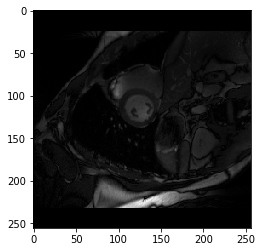

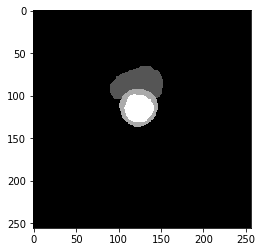

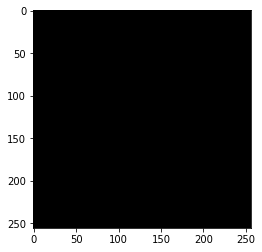

best performance: dice 0.92, idx 48


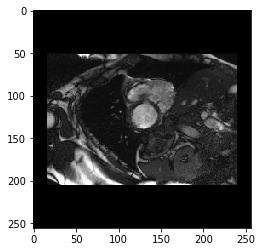

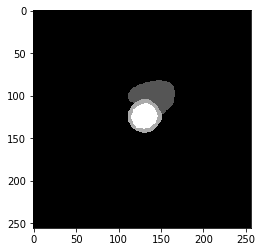

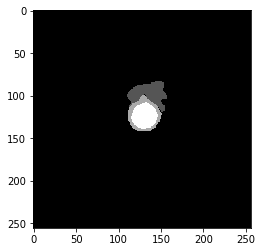

----------

EPOCH 20 of 140

Training Loss: 3.2215
0 Class, True Pos 57591000.0, False Pos 316856.0, False Neg 130033.0, Dice score 1.00
1 Class, True Pos 434784.0, False Pos 103557.0, False Neg 166240.0, Dice score 0.76
2 Class, True Pos 489322.0, False Pos 109781.0, False Neg 173018.0, Dice score 0.78
3 Class, True Pos 564061.0, False Pos 28402.0, False Neg 89305.0, Dice score 0.91
----------
Vaildation Loss: 5.4796
0 Class, True Pos 62938540.0, False Pos 483004.0, False Neg 129921.0, Dice score 1.00
1 Class, True Pos 409243.0, False Pos 101461.0, False Neg 221683.0, Dice score 0.72
2 Class, True Pos 453831.0, False Pos 104480.0, False Neg 214094.0, Dice score 0.74
3 Class, True Pos 503619.0, False Pos 17538.0, False Neg 140785.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


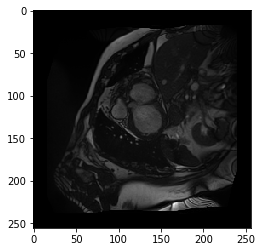

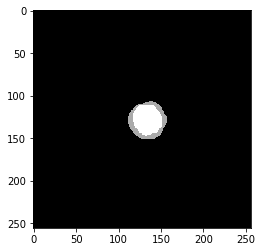

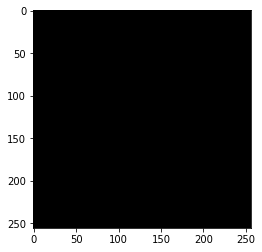

best performance: dice 0.92, idx 48


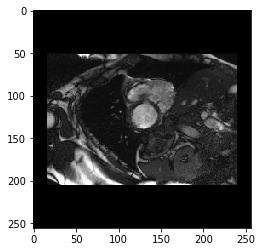

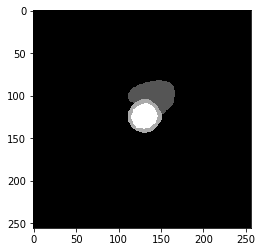

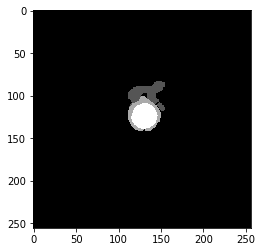

----------

EPOCH 21 of 140

Training Loss: 3.2221
0 Class, True Pos 57641088.0, False Pos 317826.0, False Neg 111666.0, Dice score 1.00
1 Class, True Pos 404298.0, False Pos 88400.0, False Neg 185817.0, Dice score 0.75
2 Class, True Pos 494776.0, False Pos 110933.0, False Neg 153396.0, Dice score 0.79
3 Class, True Pos 557564.0, False Pos 22872.0, False Neg 89152.0, Dice score 0.91
----------
Vaildation Loss: 5.4347
0 Class, True Pos 62904128.0, False Pos 452805.0, False Neg 164324.0, Dice score 1.00
1 Class, True Pos 432115.0, False Pos 136255.0, False Neg 198811.0, Dice score 0.72
2 Class, True Pos 456680.0, False Pos 105095.0, False Neg 211245.0, Dice score 0.74
3 Class, True Pos 505295.0, False Pos 19334.0, False Neg 139109.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


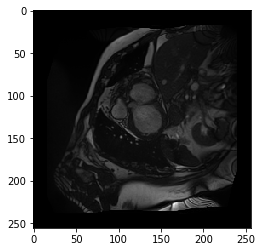

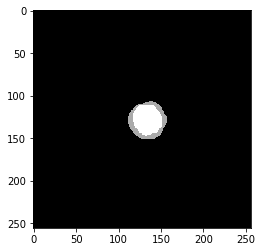

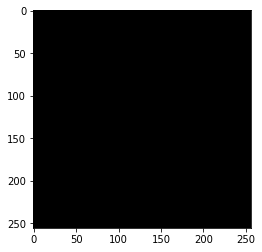

best performance: dice 0.93, idx 48


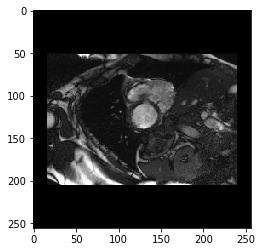

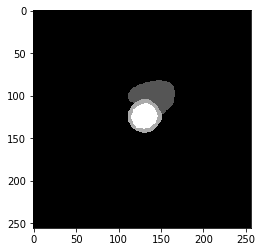

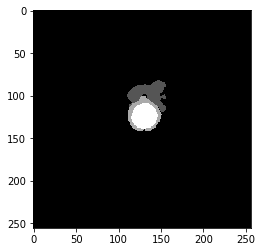

----------

EPOCH 22 of 140

Training Loss: 3.1812
0 Class, True Pos 57627272.0, False Pos 279741.0, False Neg 135643.0, Dice score 1.00
1 Class, True Pos 424089.0, False Pos 106022.0, False Neg 158204.0, Dice score 0.76
2 Class, True Pos 497245.0, False Pos 114090.0, False Neg 145667.0, Dice score 0.79
3 Class, True Pos 563339.0, False Pos 25962.0, False Neg 86301.0, Dice score 0.91
----------
Vaildation Loss: 5.7231
0 Class, True Pos 62906040.0, False Pos 490837.0, False Neg 162427.0, Dice score 0.99
1 Class, True Pos 421344.0, False Pos 127507.0, False Neg 209582.0, Dice score 0.71
2 Class, True Pos 442134.0, False Pos 102459.0, False Neg 225791.0, Dice score 0.73
3 Class, True Pos 499667.0, False Pos 21734.0, False Neg 144737.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


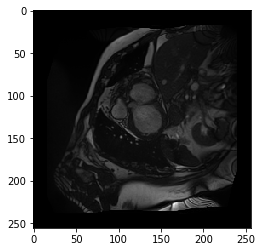

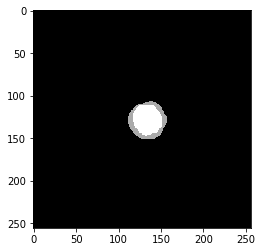

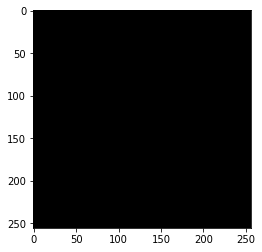

best performance: dice 0.92, idx 48


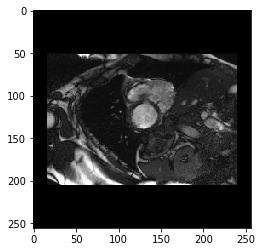

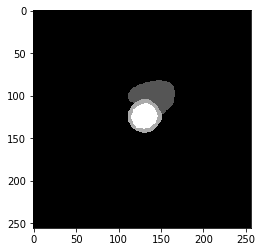

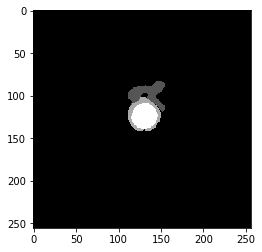

----------

EPOCH 23 of 140

Training Loss: 3.2827
0 Class, True Pos 57585232.0, False Pos 302298.0, False Neg 130399.0, Dice score 1.00
1 Class, True Pos 427948.0, False Pos 107225.0, False Neg 178482.0, Dice score 0.75
2 Class, True Pos 501590.0, False Pos 116908.0, False Neg 158142.0, Dice score 0.78
3 Class, True Pos 569663.0, False Pos 26895.0, False Neg 86303.0, Dice score 0.91
----------
Vaildation Loss: 5.1027
0 Class, True Pos 62858976.0, False Pos 384321.0, False Neg 209474.0, Dice score 1.00
1 Class, True Pos 455805.0, False Pos 172116.0, False Neg 175121.0, Dice score 0.72
2 Class, True Pos 475035.0, False Pos 116968.0, False Neg 192890.0, Dice score 0.75
3 Class, True Pos 523781.0, False Pos 24703.0, False Neg 120623.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


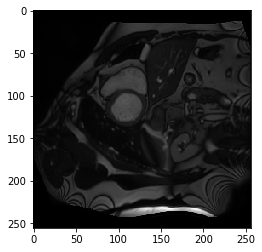

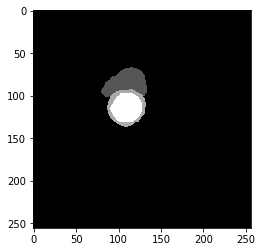

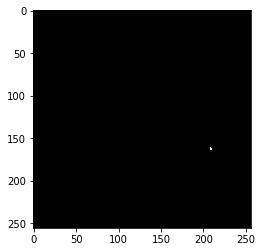

best performance: dice 0.93, idx 48


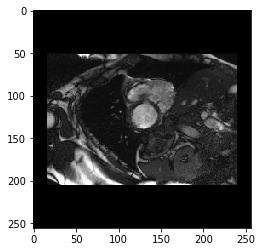

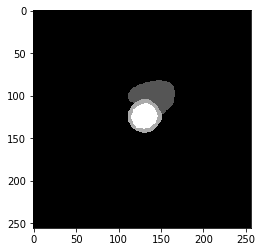

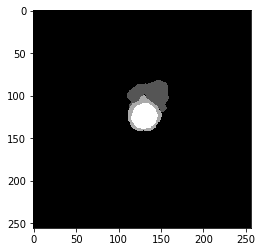

Dice Score: 0.8379
----------

EPOCH 24 of 140

Training Loss: 3.1113
0 Class, True Pos 57589112.0, False Pos 287144.0, False Neg 133020.0, Dice score 1.00
1 Class, True Pos 441063.0, False Pos 109658.0, False Neg 161900.0, Dice score 0.76
2 Class, True Pos 501579.0, False Pos 112700.0, False Neg 157354.0, Dice score 0.79
3 Class, True Pos 569623.0, False Pos 26874.0, False Neg 84102.0, Dice score 0.91
----------
Vaildation Loss: 5.1201
0 Class, True Pos 62850880.0, False Pos 383319.0, False Neg 217580.0, Dice score 1.00
1 Class, True Pos 457563.0, False Pos 174677.0, False Neg 173363.0, Dice score 0.72
2 Class, True Pos 476307.0, False Pos 119047.0, False Neg 191618.0, Dice score 0.75
3 Class, True Pos 524488.0, False Pos 25434.0, False Neg 119916.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


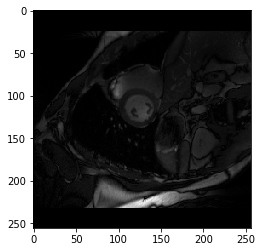

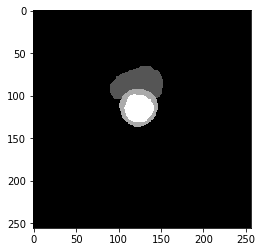

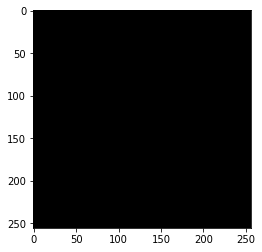

best performance: dice 0.93, idx 48


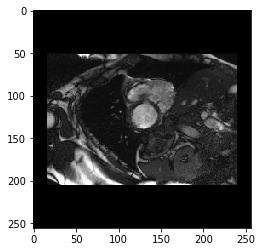

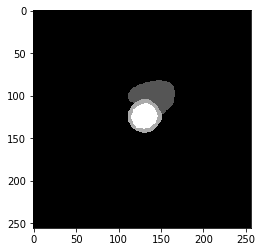

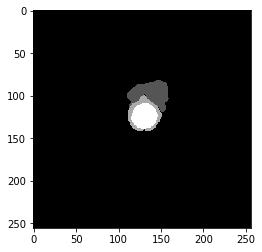

Dice Score: 0.8380
----------

EPOCH 25 of 140

Training Loss: 3.1564
0 Class, True Pos 57588552.0, False Pos 295848.0, False Neg 135489.0, Dice score 1.00
1 Class, True Pos 428984.0, False Pos 109595.0, False Neg 172120.0, Dice score 0.75
2 Class, True Pos 504644.0, False Pos 112695.0, False Neg 151704.0, Dice score 0.79
3 Class, True Pos 570268.0, False Pos 27166.0, False Neg 85991.0, Dice score 0.91
----------
Vaildation Loss: 5.5602
0 Class, True Pos 62874584.0, False Pos 451800.0, False Neg 193868.0, Dice score 0.99
1 Class, True Pos 438309.0, False Pos 153940.0, False Neg 192617.0, Dice score 0.72
2 Class, True Pos 457527.0, False Pos 111066.0, False Neg 210398.0, Dice score 0.74
3 Class, True Pos 502616.0, False Pos 21865.0, False Neg 141788.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


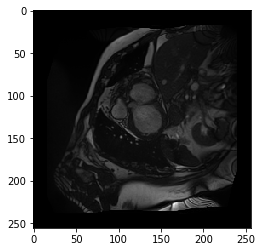

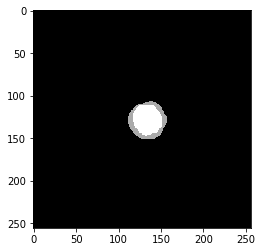

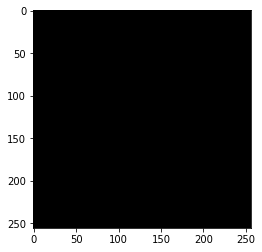

best performance: dice 0.93, idx 48


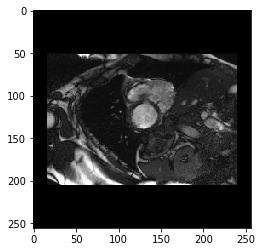

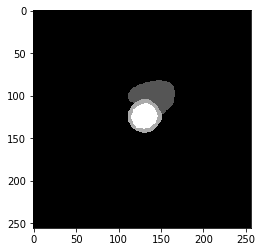

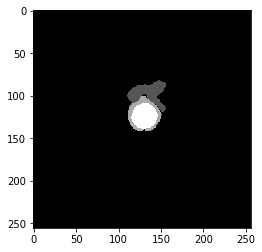

----------

EPOCH 26 of 140

Training Loss: 3.1781
0 Class, True Pos 57609048.0, False Pos 272654.0, False Neg 135398.0, Dice score 1.00
1 Class, True Pos 433156.0, False Pos 106107.0, False Neg 151860.0, Dice score 0.77
2 Class, True Pos 506979.0, False Pos 113922.0, False Neg 150331.0, Dice score 0.79
3 Class, True Pos 566851.0, False Pos 29047.0, False Neg 84141.0, Dice score 0.91
----------
Vaildation Loss: 5.1632
0 Class, True Pos 62851756.0, False Pos 391080.0, False Neg 216703.0, Dice score 1.00
1 Class, True Pos 454999.0, False Pos 173282.0, False Neg 175927.0, Dice score 0.72
2 Class, True Pos 469231.0, False Pos 113034.0, False Neg 198694.0, Dice score 0.75
3 Class, True Pos 528608.0, False Pos 29724.0, False Neg 115796.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


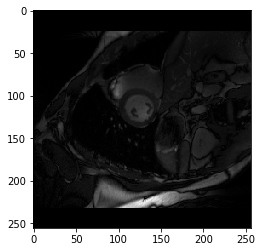

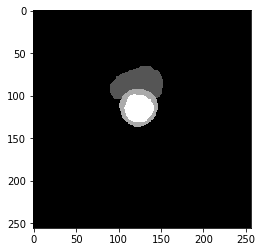

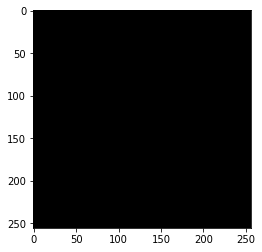

best performance: dice 0.92, idx 48


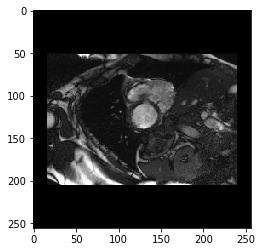

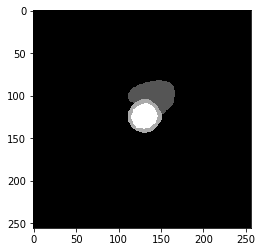

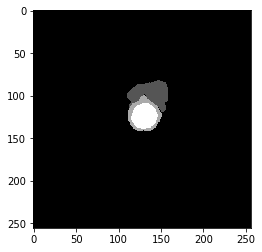

----------

EPOCH 27 of 140

Training Loss: 3.1474
0 Class, True Pos 57576040.0, False Pos 283268.0, False Neg 133297.0, Dice score 1.00
1 Class, True Pos 450070.0, False Pos 109121.0, False Neg 161359.0, Dice score 0.77
2 Class, True Pos 502197.0, False Pos 116671.0, False Neg 151952.0, Dice score 0.79
3 Class, True Pos 574037.0, False Pos 26352.0, False Neg 88804.0, Dice score 0.91
----------
Vaildation Loss: 5.6138
0 Class, True Pos 62915060.0, False Pos 480967.0, False Neg 153397.0, Dice score 0.99
1 Class, True Pos 426916.0, False Pos 126065.0, False Neg 204010.0, Dice score 0.72
2 Class, True Pos 442166.0, False Pos 98434.0, False Neg 225759.0, Dice score 0.73
3 Class, True Pos 501414.0, False Pos 20690.0, False Neg 142990.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


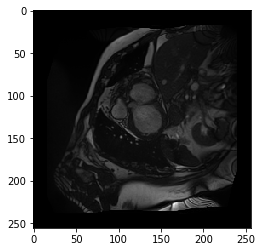

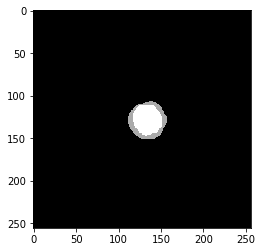

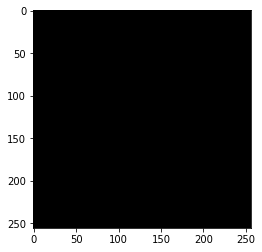

best performance: dice 0.93, idx 39


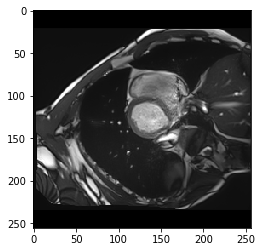

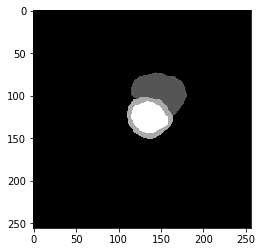

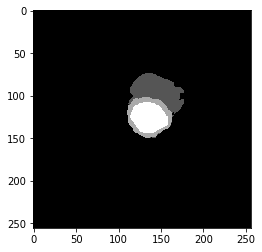

----------

EPOCH 28 of 140

Training Loss: 3.1090
0 Class, True Pos 57606728.0, False Pos 275529.0, False Neg 128504.0, Dice score 1.00
1 Class, True Pos 439734.0, False Pos 103159.0, False Neg 153534.0, Dice score 0.77
2 Class, True Pos 499233.0, False Pos 113510.0, False Neg 154442.0, Dice score 0.79
3 Class, True Pos 573281.0, False Pos 26587.0, False Neg 82305.0, Dice score 0.91
----------
Vaildation Loss: 5.5553
0 Class, True Pos 62901152.0, False Pos 463485.0, False Neg 167300.0, Dice score 1.00
1 Class, True Pos 431185.0, False Pos 132838.0, False Neg 199741.0, Dice score 0.72
2 Class, True Pos 454091.0, False Pos 108846.0, False Neg 213834.0, Dice score 0.74
3 Class, True Pos 500435.0, False Pos 19675.0, False Neg 143969.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


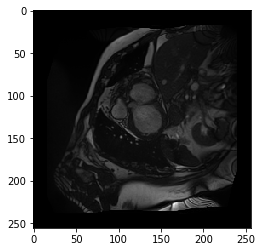

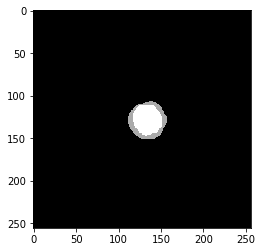

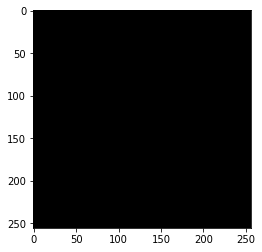

best performance: dice 0.93, idx 48


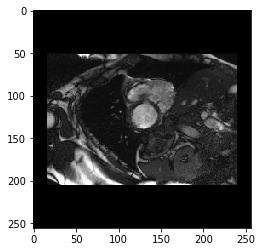

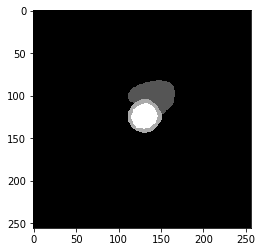

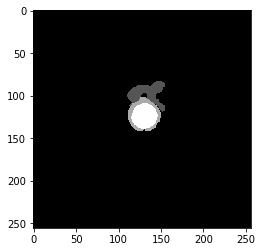

----------

EPOCH 29 of 140

Training Loss: 3.1465
0 Class, True Pos 57591792.0, False Pos 286004.0, False Neg 130920.0, Dice score 1.00
1 Class, True Pos 436572.0, False Pos 104663.0, False Neg 162491.0, Dice score 0.77
2 Class, True Pos 504600.0, False Pos 112400.0, False Neg 155747.0, Dice score 0.79
3 Class, True Pos 573535.0, False Pos 28190.0, False Neg 82099.0, Dice score 0.91
----------
Vaildation Loss: 5.0622
0 Class, True Pos 62842736.0, False Pos 371942.0, False Neg 225720.0, Dice score 1.00
1 Class, True Pos 462479.0, False Pos 187228.0, False Neg 168447.0, Dice score 0.72
2 Class, True Pos 476579.0, False Pos 117741.0, False Neg 191346.0, Dice score 0.76
3 Class, True Pos 526969.0, False Pos 26037.0, False Neg 117435.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


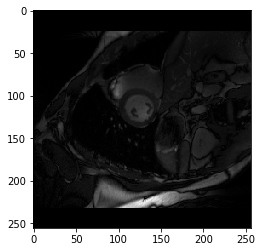

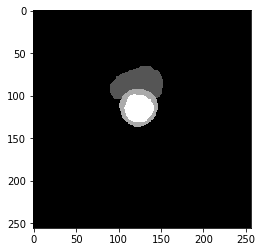

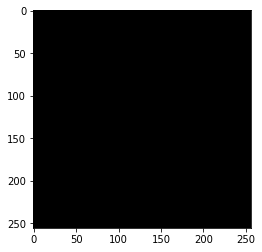

best performance: dice 0.92, idx 48


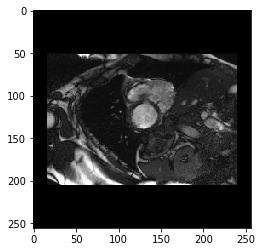

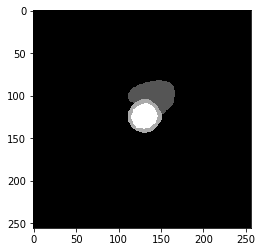

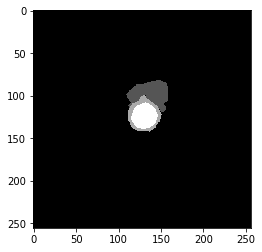

Dice Score: 0.8382
----------

EPOCH 30 of 140

Training Loss: 3.0087
0 Class, True Pos 57608024.0, False Pos 250265.0, False Neg 131507.0, Dice score 1.00
1 Class, True Pos 451702.0, False Pos 106025.0, False Neg 131257.0, Dice score 0.79
2 Class, True Pos 506191.0, False Pos 113129.0, False Neg 153667.0, Dice score 0.79
3 Class, True Pos 576006.0, False Pos 26422.0, False Neg 79410.0, Dice score 0.92
----------
Vaildation Loss: 5.2208
0 Class, True Pos 62889452.0, False Pos 420393.0, False Neg 179015.0, Dice score 1.00
1 Class, True Pos 444638.0, False Pos 145458.0, False Neg 186288.0, Dice score 0.73
2 Class, True Pos 463262.0, False Pos 108309.0, False Neg 204663.0, Dice score 0.75
3 Class, True Pos 517616.0, False Pos 22594.0, False Neg 126788.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


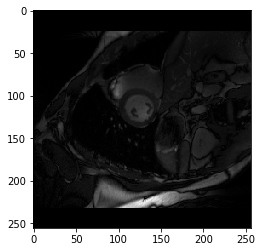

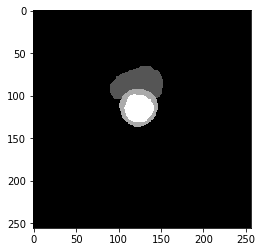

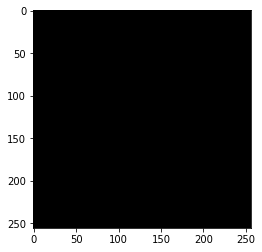

best performance: dice 0.93, idx 48


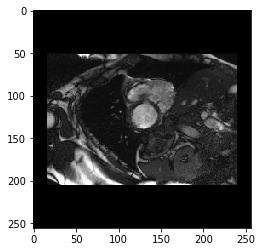

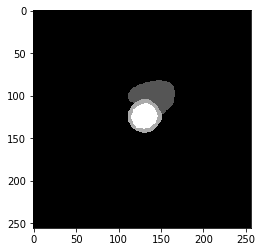

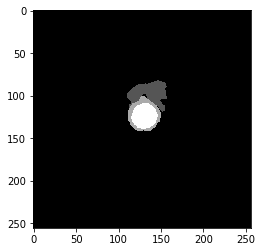

----------

EPOCH 31 of 140

Training Loss: 3.2101
0 Class, True Pos 57599940.0, False Pos 294672.0, False Neg 130554.0, Dice score 1.00
1 Class, True Pos 421632.0, False Pos 104845.0, False Neg 181635.0, Dice score 0.75
2 Class, True Pos 504319.0, False Pos 114927.0, False Neg 149677.0, Dice score 0.79
3 Class, True Pos 568337.0, False Pos 29087.0, False Neg 81665.0, Dice score 0.91
----------
Vaildation Loss: 5.4766
0 Class, True Pos 62900296.0, False Pos 451369.0, False Neg 168160.0, Dice score 1.00
1 Class, True Pos 431534.0, False Pos 128726.0, False Neg 199392.0, Dice score 0.72
2 Class, True Pos 460498.0, False Pos 115054.0, False Neg 207427.0, Dice score 0.74
3 Class, True Pos 503896.0, False Pos 20338.0, False Neg 140508.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


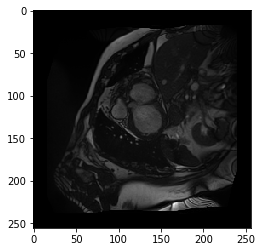

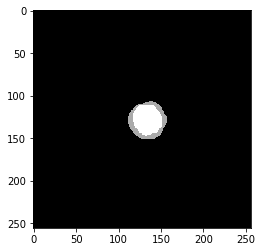

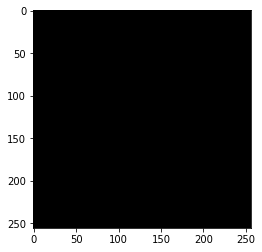

best performance: dice 0.93, idx 48


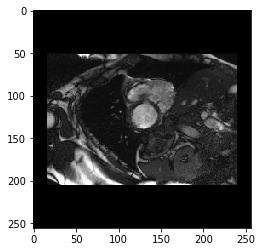

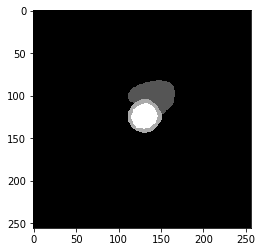

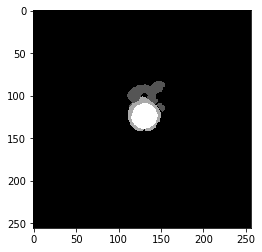

----------

EPOCH 32 of 140

Training Loss: 3.1240
0 Class, True Pos 57595720.0, False Pos 280089.0, False Neg 137994.0, Dice score 1.00
1 Class, True Pos 440854.0, False Pos 111265.0, False Neg 154130.0, Dice score 0.77
2 Class, True Pos 502513.0, False Pos 112450.0, False Neg 155633.0, Dice score 0.79
3 Class, True Pos 567000.0, False Pos 27855.0, False Neg 83902.0, Dice score 0.91
----------
Vaildation Loss: 5.2444
0 Class, True Pos 62870216.0, False Pos 415754.0, False Neg 198241.0, Dice score 1.00
1 Class, True Pos 450042.0, False Pos 164133.0, False Neg 180884.0, Dice score 0.72
2 Class, True Pos 456309.0, False Pos 102083.0, False Neg 211616.0, Dice score 0.74
3 Class, True Pos 524957.0, False Pos 28218.0, False Neg 119447.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


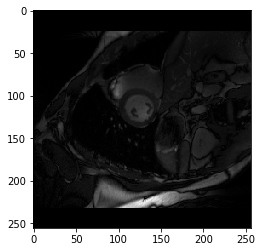

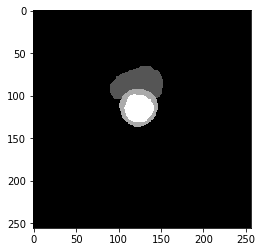

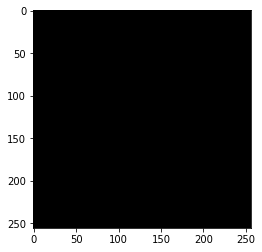

best performance: dice 0.92, idx 39


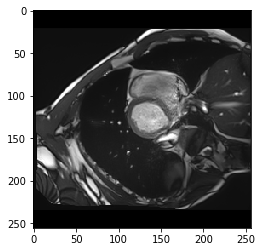

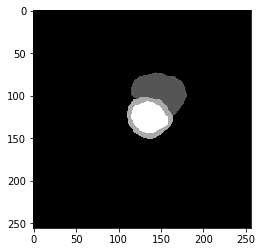

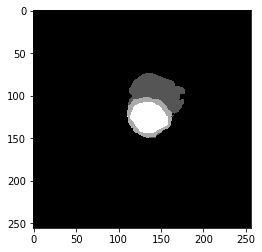

----------

EPOCH 33 of 140

Training Loss: 3.2089
0 Class, True Pos 57593672.0, False Pos 305253.0, False Neg 140971.0, Dice score 1.00
1 Class, True Pos 421661.0, False Pos 110605.0, False Neg 174011.0, Dice score 0.75
2 Class, True Pos 493988.0, False Pos 117336.0, False Neg 158635.0, Dice score 0.78
3 Class, True Pos 569949.0, False Pos 25292.0, False Neg 84869.0, Dice score 0.91
----------
Vaildation Loss: 5.2977
0 Class, True Pos 62872832.0, False Pos 420671.0, False Neg 195627.0, Dice score 1.00
1 Class, True Pos 449877.0, False Pos 162254.0, False Neg 181049.0, Dice score 0.72
2 Class, True Pos 460342.0, False Pos 105871.0, False Neg 207583.0, Dice score 0.75
3 Class, True Pos 516199.0, False Pos 23668.0, False Neg 128205.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


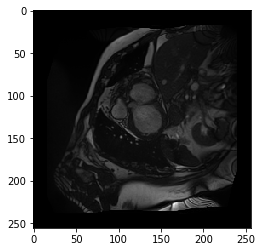

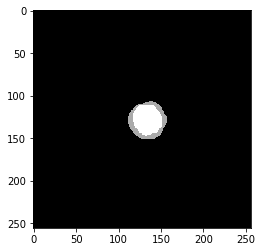

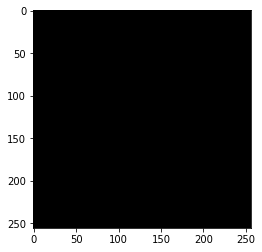

best performance: dice 0.93, idx 48


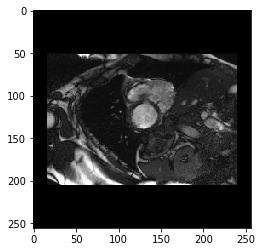

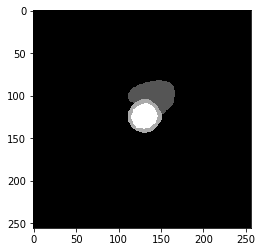

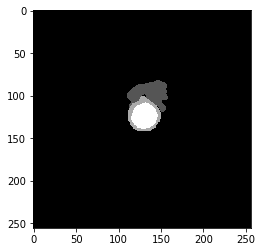

----------

EPOCH 34 of 140

Training Loss: 3.2058
0 Class, True Pos 57597740.0, False Pos 293434.0, False Neg 138352.0, Dice score 1.00
1 Class, True Pos 438455.0, False Pos 107446.0, False Neg 158744.0, Dice score 0.77
2 Class, True Pos 498422.0, False Pos 111916.0, False Neg 155052.0, Dice score 0.79
3 Class, True Pos 561754.0, False Pos 28591.0, False Neg 89239.0, Dice score 0.91
----------
Vaildation Loss: 5.3379
0 Class, True Pos 62908748.0, False Pos 445246.0, False Neg 159710.0, Dice score 1.00
1 Class, True Pos 430543.0, False Pos 124465.0, False Neg 200383.0, Dice score 0.73
2 Class, True Pos 459878.0, False Pos 108514.0, False Neg 208047.0, Dice score 0.74
3 Class, True Pos 512268.0, False Pos 22051.0, False Neg 132136.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


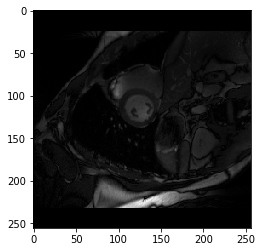

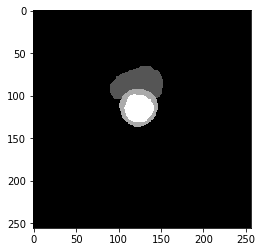

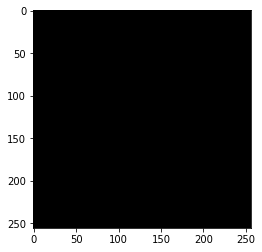

best performance: dice 0.93, idx 48


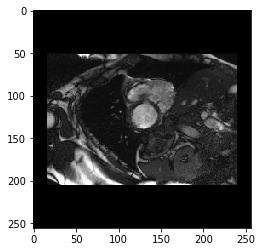

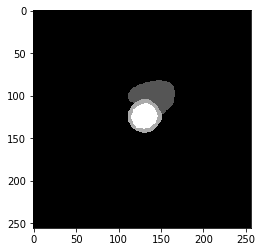

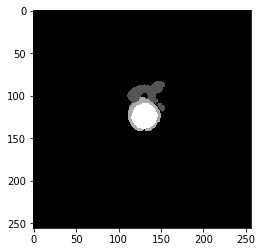

----------

EPOCH 35 of 140

Training Loss: 3.0343
0 Class, True Pos 57620984.0, False Pos 252952.0, False Neg 139331.0, Dice score 1.00
1 Class, True Pos 448719.0, False Pos 102504.0, False Neg 140635.0, Dice score 0.79
2 Class, True Pos 503209.0, False Pos 115081.0, False Neg 139380.0, Dice score 0.80
3 Class, True Pos 566753.0, False Pos 27550.0, False Neg 78741.0, Dice score 0.91
----------
Vaildation Loss: 5.3098
0 Class, True Pos 62899032.0, False Pos 437833.0, False Neg 169420.0, Dice score 1.00
1 Class, True Pos 435124.0, False Pos 132087.0, False Neg 195802.0, Dice score 0.73
2 Class, True Pos 463504.0, False Pos 109460.0, False Neg 204421.0, Dice score 0.75
3 Class, True Pos 513028.0, False Pos 21639.0, False Neg 131376.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


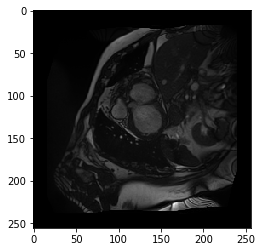

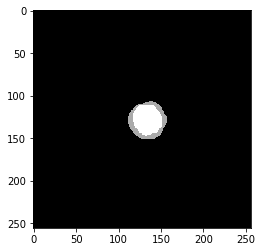

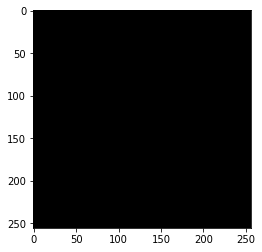

best performance: dice 0.93, idx 48


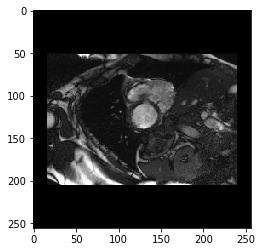

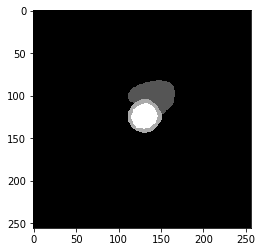

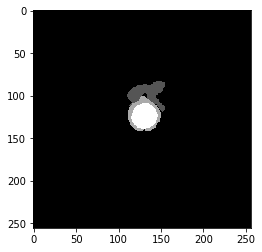

----------

EPOCH 36 of 140

Training Loss: 3.1114
0 Class, True Pos 57564544.0, False Pos 294224.0, False Neg 135820.0, Dice score 1.00
1 Class, True Pos 436799.0, False Pos 109267.0, False Neg 173678.0, Dice score 0.76
2 Class, True Pos 507330.0, False Pos 114856.0, False Neg 157567.0, Dice score 0.79
3 Class, True Pos 581161.0, False Pos 29565.0, False Neg 80847.0, Dice score 0.91
----------
Vaildation Loss: 5.2796
0 Class, True Pos 62869544.0, False Pos 417844.0, False Neg 198916.0, Dice score 1.00
1 Class, True Pos 446346.0, False Pos 156583.0, False Neg 184580.0, Dice score 0.72
2 Class, True Pos 467765.0, False Pos 114617.0, False Neg 200160.0, Dice score 0.75
3 Class, True Pos 515991.0, False Pos 23025.0, False Neg 128413.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


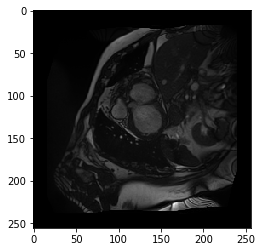

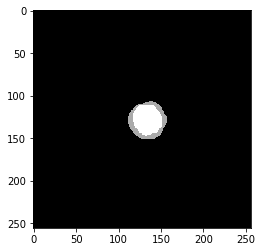

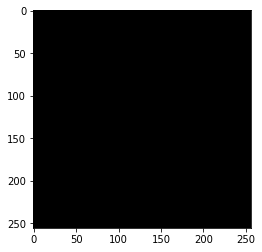

best performance: dice 0.93, idx 48


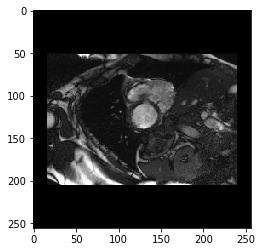

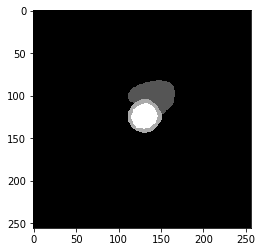

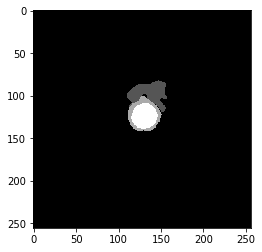

----------

EPOCH 37 of 140

Training Loss: 3.1273
0 Class, True Pos 57631128.0, False Pos 264168.0, False Neg 136748.0, Dice score 1.00
1 Class, True Pos 434917.0, False Pos 98261.0, False Neg 142322.0, Dice score 0.78
2 Class, True Pos 498515.0, False Pos 116015.0, False Neg 146822.0, Dice score 0.79
3 Class, True Pos 564855.0, False Pos 29892.0, False Neg 82444.0, Dice score 0.91
----------
Vaildation Loss: 5.0600
0 Class, True Pos 62855836.0, False Pos 376202.0, False Neg 212616.0, Dice score 1.00
1 Class, True Pos 459244.0, False Pos 171446.0, False Neg 171682.0, Dice score 0.73
2 Class, True Pos 477619.0, False Pos 119093.0, False Neg 190306.0, Dice score 0.76
3 Class, True Pos 526356.0, False Pos 25911.0, False Neg 118048.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


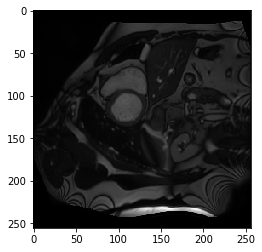

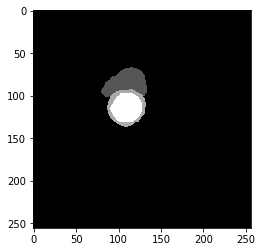

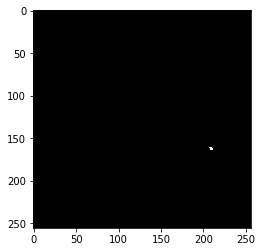

best performance: dice 0.93, idx 48


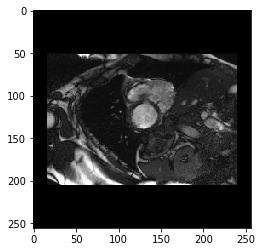

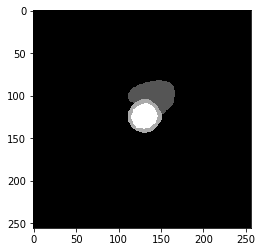

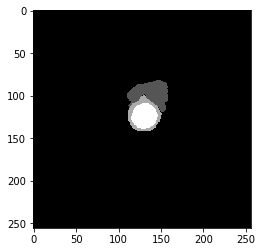

Dice Score: 0.8396
----------

EPOCH 38 of 140

Training Loss: 3.2913
0 Class, True Pos 57560344.0, False Pos 319356.0, False Neg 149596.0, Dice score 1.00
1 Class, True Pos 434643.0, False Pos 112275.0, False Neg 171150.0, Dice score 0.75
2 Class, True Pos 496483.0, False Pos 115684.0, False Neg 163537.0, Dice score 0.78
3 Class, True Pos 565784.0, False Pos 33190.0, False Neg 96222.0, Dice score 0.90
----------
Vaildation Loss: 5.3402
0 Class, True Pos 62878568.0, False Pos 427179.0, False Neg 189890.0, Dice score 1.00
1 Class, True Pos 442281.0, False Pos 147520.0, False Neg 188645.0, Dice score 0.72
2 Class, True Pos 465948.0, False Pos 113739.0, False Neg 201977.0, Dice score 0.75
3 Class, True Pos 513113.0, False Pos 23365.0, False Neg 131291.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


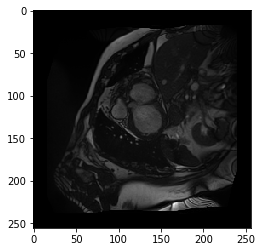

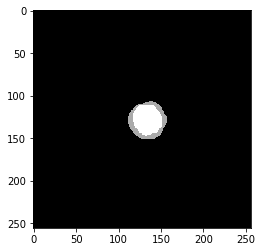

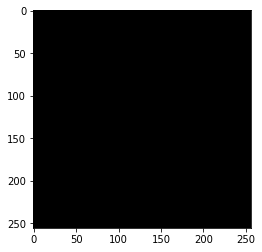

best performance: dice 0.93, idx 48


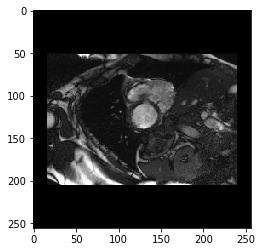

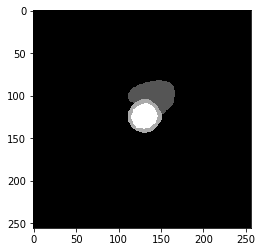

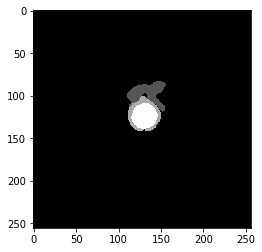

----------

EPOCH 39 of 140

Training Loss: 3.0564
0 Class, True Pos 57594976.0, False Pos 292873.0, False Neg 123213.0, Dice score 1.00
1 Class, True Pos 446210.0, False Pos 97834.0, False Neg 157861.0, Dice score 0.78
2 Class, True Pos 501547.0, False Pos 109873.0, False Neg 158261.0, Dice score 0.79
3 Class, True Pos 569836.0, False Pos 24609.0, False Neg 85854.0, Dice score 0.91
----------
Vaildation Loss: 5.1173
0 Class, True Pos 62860044.0, False Pos 390102.0, False Neg 208401.0, Dice score 1.00
1 Class, True Pos 453283.0, False Pos 164155.0, False Neg 177643.0, Dice score 0.73
2 Class, True Pos 475854.0, False Pos 116768.0, False Neg 192071.0, Dice score 0.75
3 Class, True Pos 525131.0, False Pos 26363.0, False Neg 119273.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


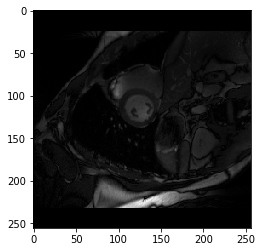

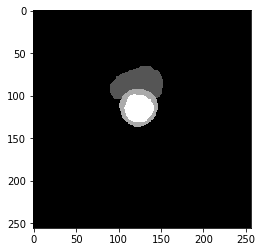

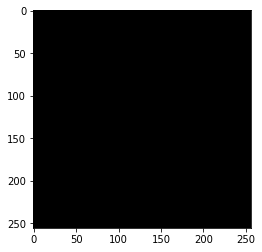

best performance: dice 0.93, idx 48


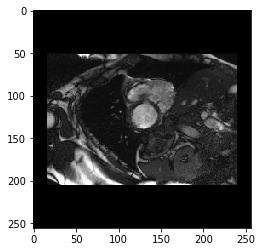

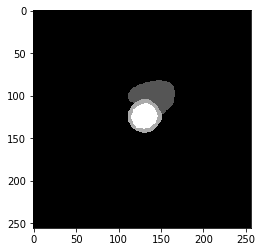

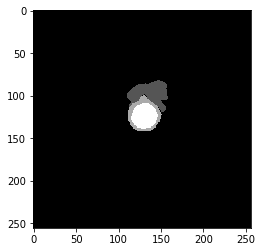

----------

EPOCH 40 of 140

Training Loss: 3.0289
0 Class, True Pos 57593188.0, False Pos 286467.0, False Neg 125892.0, Dice score 1.00
1 Class, True Pos 452182.0, False Pos 105081.0, False Neg 154999.0, Dice score 0.78
2 Class, True Pos 503321.0, False Pos 108635.0, False Neg 150166.0, Dice score 0.80
3 Class, True Pos 561703.0, False Pos 27177.0, False Neg 96303.0, Dice score 0.90
----------
Vaildation Loss: 5.1672
0 Class, True Pos 62873280.0, False Pos 404702.0, False Neg 195179.0, Dice score 1.00
1 Class, True Pos 451389.0, False Pos 162325.0, False Neg 179537.0, Dice score 0.73
2 Class, True Pos 467777.0, False Pos 109800.0, False Neg 200148.0, Dice score 0.75
3 Class, True Pos 519422.0, False Pos 23019.0, False Neg 124982.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


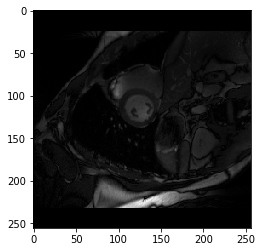

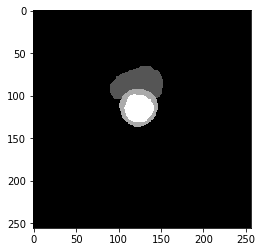

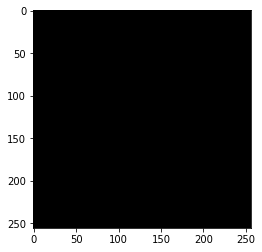

best performance: dice 0.93, idx 48


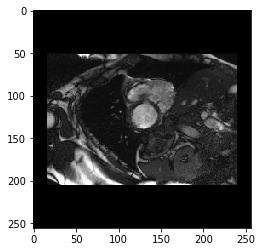

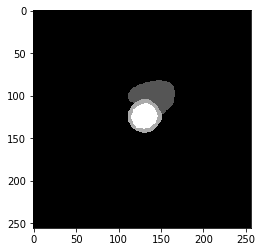

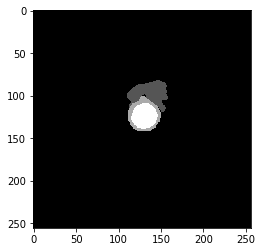

----------

EPOCH 41 of 140

Training Loss: 3.1020
0 Class, True Pos 57594624.0, False Pos 284518.0, False Neg 136312.0, Dice score 1.00
1 Class, True Pos 450338.0, False Pos 110271.0, False Neg 150873.0, Dice score 0.78
2 Class, True Pos 498623.0, False Pos 111487.0, False Neg 154787.0, Dice score 0.79
3 Class, True Pos 559995.0, False Pos 27907.0, False Neg 92211.0, Dice score 0.90
----------
Vaildation Loss: 5.6410
0 Class, True Pos 62922236.0, False Pos 489596.0, False Neg 146217.0, Dice score 0.99
1 Class, True Pos 417789.0, False Pos 110017.0, False Neg 213137.0, Dice score 0.72
2 Class, True Pos 445159.0, False Pos 103996.0, False Neg 222766.0, Dice score 0.73
3 Class, True Pos 501678.0, False Pos 21237.0, False Neg 142726.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


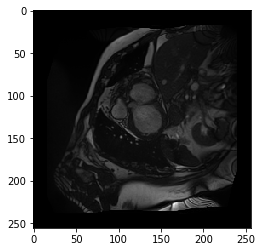

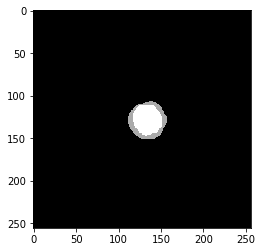

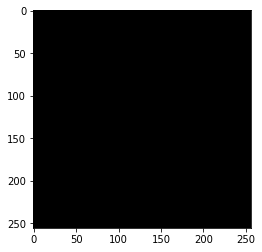

best performance: dice 0.92, idx 48


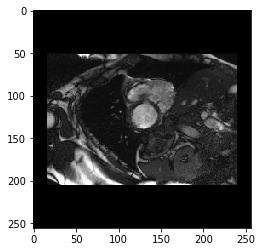

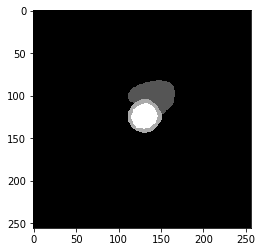

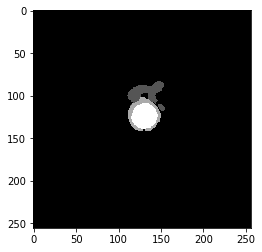

----------

EPOCH 42 of 140

Training Loss: 3.1130
0 Class, True Pos 57597192.0, False Pos 290837.0, False Neg 137075.0, Dice score 1.00
1 Class, True Pos 440591.0, False Pos 108440.0, False Neg 162553.0, Dice score 0.76
2 Class, True Pos 499636.0, False Pos 112989.0, False Neg 154232.0, Dice score 0.79
3 Class, True Pos 560471.0, False Pos 27611.0, False Neg 86017.0, Dice score 0.91
----------
Vaildation Loss: 5.2394
0 Class, True Pos 62886472.0, False Pos 417539.0, False Neg 181986.0, Dice score 1.00
1 Class, True Pos 444418.0, False Pos 146247.0, False Neg 186508.0, Dice score 0.73
2 Class, True Pos 467700.0, False Pos 110927.0, False Neg 200225.0, Dice score 0.75
3 Class, True Pos 515740.0, False Pos 22670.0, False Neg 128664.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


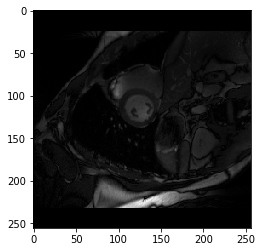

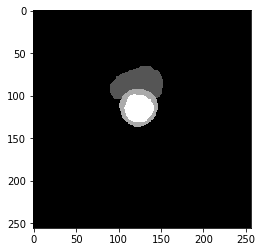

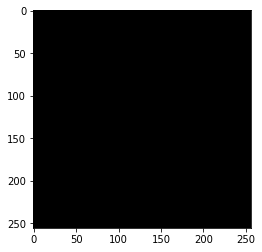

best performance: dice 0.93, idx 48


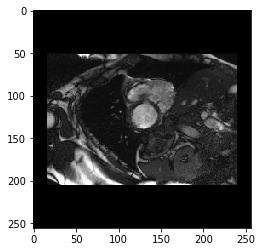

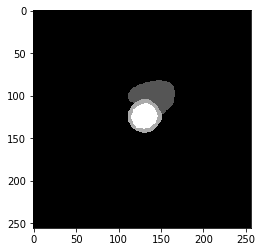

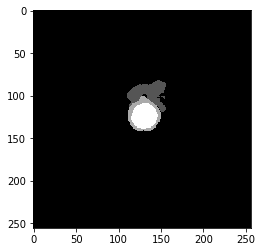

----------

EPOCH 43 of 140

Training Loss: 3.2018
0 Class, True Pos 57625952.0, False Pos 267430.0, False Neg 154759.0, Dice score 1.00
1 Class, True Pos 426360.0, False Pos 114051.0, False Neg 157992.0, Dice score 0.76
2 Class, True Pos 498780.0, False Pos 117487.0, False Neg 134933.0, Dice score 0.80
3 Class, True Pos 555736.0, False Pos 31951.0, False Neg 83235.0, Dice score 0.91
----------
Vaildation Loss: 4.9836
0 Class, True Pos 62836060.0, False Pos 361680.0, False Neg 232403.0, Dice score 1.00
1 Class, True Pos 467285.0, False Pos 193848.0, False Neg 163641.0, Dice score 0.72
2 Class, True Pos 476248.0, False Pos 114873.0, False Neg 191677.0, Dice score 0.76
3 Class, True Pos 532971.0, False Pos 28753.0, False Neg 111433.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


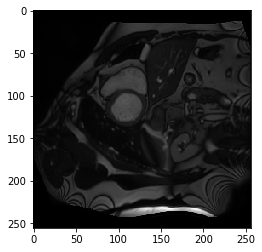

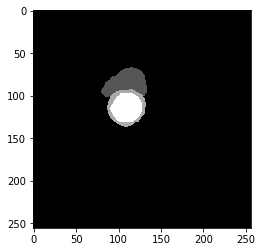

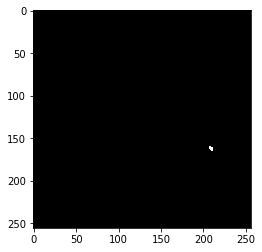

best performance: dice 0.92, idx 48


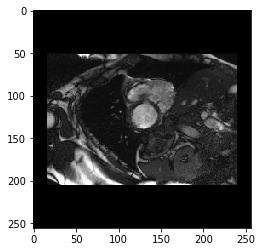

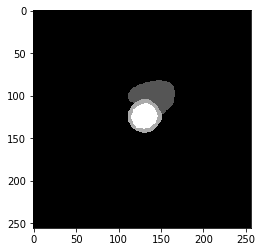

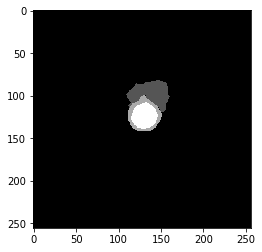

Dice Score: 0.8397
----------

EPOCH 44 of 140

Training Loss: 3.1580
0 Class, True Pos 57605200.0, False Pos 282424.0, False Neg 136461.0, Dice score 1.00
1 Class, True Pos 437259.0, False Pos 107315.0, False Neg 163418.0, Dice score 0.76
2 Class, True Pos 501719.0, False Pos 110917.0, False Neg 148306.0, Dice score 0.79
3 Class, True Pos 564246.0, False Pos 28684.0, False Neg 81155.0, Dice score 0.91
----------
Vaildation Loss: 5.1861
0 Class, True Pos 62854908.0, False Pos 398503.0, False Neg 213550.0, Dice score 1.00
1 Class, True Pos 456920.0, False Pos 177493.0, False Neg 174006.0, Dice score 0.72
2 Class, True Pos 464105.0, False Pos 106199.0, False Neg 203820.0, Dice score 0.75
3 Class, True Pos 525800.0, False Pos 27785.0, False Neg 118604.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


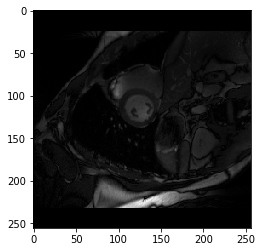

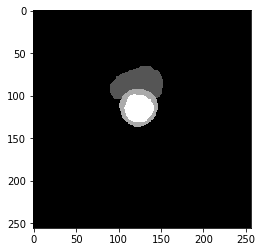

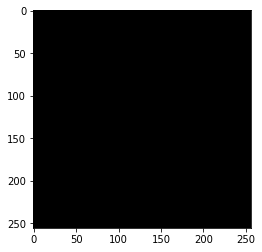

best performance: dice 0.93, idx 48


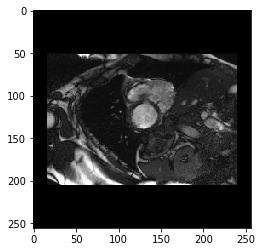

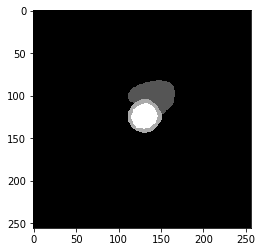

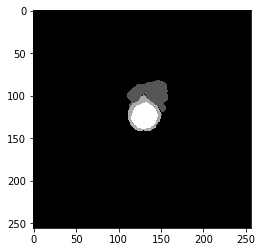

----------

EPOCH 45 of 140

Training Loss: 3.0685
0 Class, True Pos 57584916.0, False Pos 278930.0, False Neg 130315.0, Dice score 1.00
1 Class, True Pos 452516.0, False Pos 99691.0, False Neg 158306.0, Dice score 0.78
2 Class, True Pos 504326.0, False Pos 113944.0, False Neg 147071.0, Dice score 0.79
3 Class, True Pos 576246.0, False Pos 27196.0, False Neg 84069.0, Dice score 0.91
----------
Vaildation Loss: 5.2012
0 Class, True Pos 62891800.0, False Pos 415663.0, False Neg 176654.0, Dice score 1.00
1 Class, True Pos 441575.0, False Pos 137733.0, False Neg 189351.0, Dice score 0.73
2 Class, True Pos 471464.0, False Pos 115411.0, False Neg 196461.0, Dice score 0.75
3 Class, True Pos 516206.0, False Pos 21857.0, False Neg 128198.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


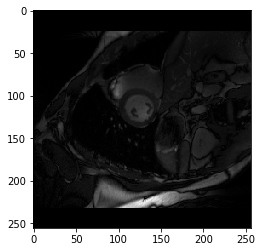

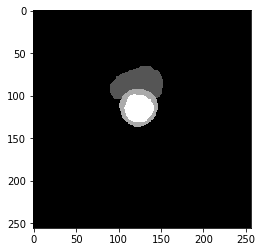

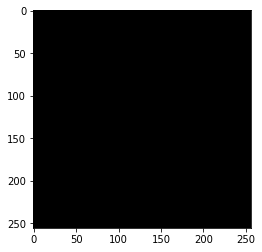

best performance: dice 0.93, idx 48


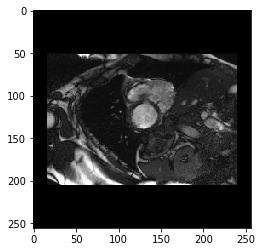

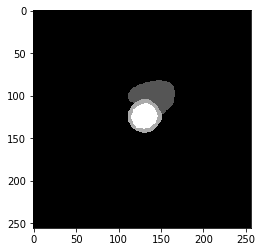

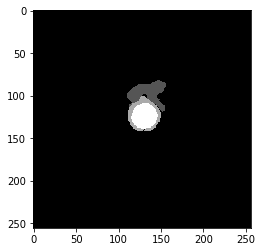

----------

EPOCH 46 of 140

Training Loss: 3.1127
0 Class, True Pos 57580132.0, False Pos 298162.0, False Neg 128533.0, Dice score 1.00
1 Class, True Pos 445787.0, False Pos 101993.0, False Neg 163100.0, Dice score 0.77
2 Class, True Pos 503626.0, False Pos 111070.0, False Neg 159365.0, Dice score 0.79
3 Class, True Pos 570158.0, False Pos 26829.0, False Neg 87056.0, Dice score 0.91
----------
Vaildation Loss: 4.7888
0 Class, True Pos 62827024.0, False Pos 335374.0, False Neg 241432.0, Dice score 1.00
1 Class, True Pos 475492.0, False Pos 207151.0, False Neg 155434.0, Dice score 0.72
2 Class, True Pos 480261.0, False Pos 111158.0, False Neg 187664.0, Dice score 0.76
3 Class, True Pos 543487.0, False Pos 31764.0, False Neg 100917.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


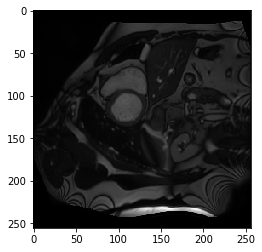

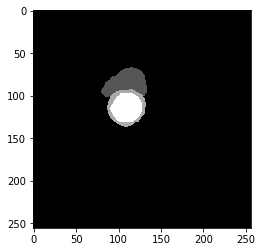

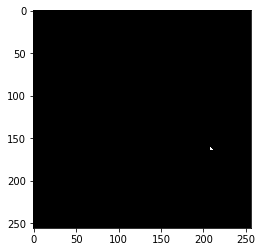

best performance: dice 0.92, idx 31


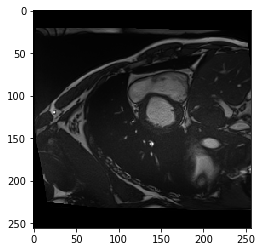

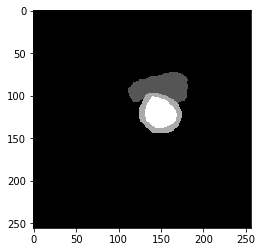

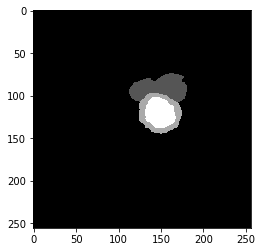

Dice Score: 0.8433
----------

EPOCH 47 of 140

Training Loss: 2.9752
0 Class, True Pos 57583512.0, False Pos 273715.0, False Neg 128123.0, Dice score 1.00
1 Class, True Pos 459554.0, False Pos 104249.0, False Neg 145799.0, Dice score 0.79
2 Class, True Pos 508483.0, False Pos 108373.0, False Neg 156211.0, Dice score 0.79
3 Class, True Pos 572483.0, False Pos 27387.0, False Neg 83591.0, Dice score 0.91
----------
Vaildation Loss: 5.3237
0 Class, True Pos 62896208.0, False Pos 433166.0, False Neg 172253.0, Dice score 1.00
1 Class, True Pos 437705.0, False Pos 134285.0, False Neg 193221.0, Dice score 0.73
2 Class, True Pos 466451.0, False Pos 114767.0, False Neg 201474.0, Dice score 0.75
3 Class, True Pos 509019.0, False Pos 20115.0, False Neg 135385.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


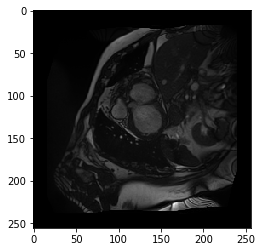

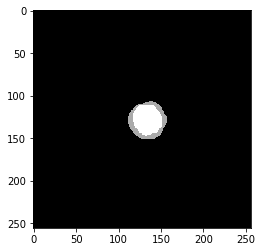

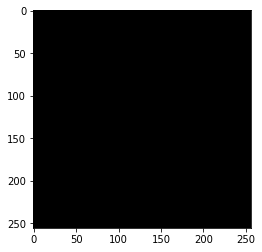

best performance: dice 0.93, idx 48


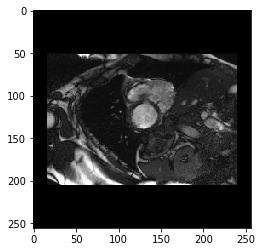

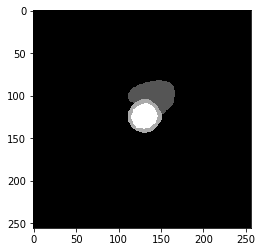

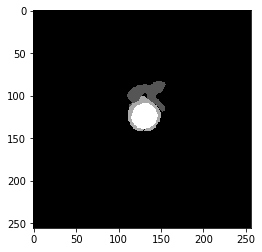

----------

EPOCH 48 of 140

Training Loss: 3.0864
0 Class, True Pos 57593360.0, False Pos 277927.0, False Neg 129444.0, Dice score 1.00
1 Class, True Pos 441564.0, False Pos 101811.0, False Neg 162706.0, Dice score 0.77
2 Class, True Pos 509470.0, False Pos 113142.0, False Neg 147889.0, Dice score 0.80
3 Class, True Pos 572068.0, False Pos 28404.0, False Neg 81245.0, Dice score 0.91
----------
Vaildation Loss: 5.0794
0 Class, True Pos 62891020.0, False Pos 399895.0, False Neg 177443.0, Dice score 1.00
1 Class, True Pos 448049.0, False Pos 145905.0, False Neg 182877.0, Dice score 0.73
2 Class, True Pos 470303.0, False Pos 112190.0, False Neg 197622.0, Dice score 0.75
3 Class, True Pos 521605.0, False Pos 22751.0, False Neg 122799.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


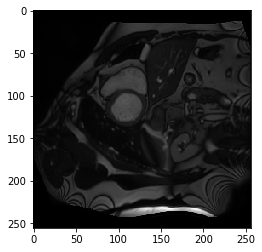

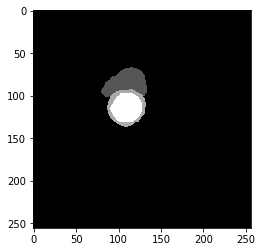

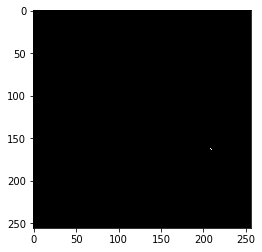

best performance: dice 0.93, idx 48


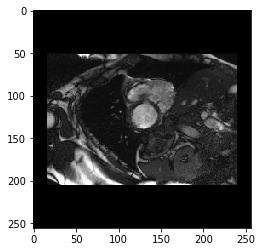

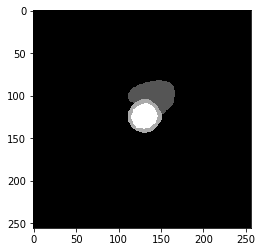

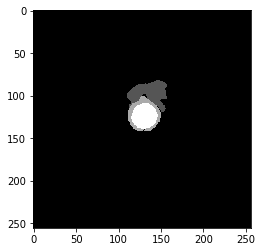

----------

EPOCH 49 of 140

Training Loss: 3.1313
0 Class, True Pos 57610896.0, False Pos 285294.0, False Neg 129641.0, Dice score 1.00
1 Class, True Pos 435550.0, False Pos 105052.0, False Neg 154565.0, Dice score 0.77
2 Class, True Pos 494167.0, False Pos 113303.0, False Neg 158919.0, Dice score 0.78
3 Class, True Pos 567992.0, False Pos 25504.0, False Neg 86028.0, Dice score 0.91
----------
Vaildation Loss: 5.1601
0 Class, True Pos 62820292.0, False Pos 378380.0, False Neg 248159.0, Dice score 1.00
1 Class, True Pos 463686.0, False Pos 200576.0, False Neg 167240.0, Dice score 0.72
2 Class, True Pos 477244.0, False Pos 120327.0, False Neg 190681.0, Dice score 0.75
3 Class, True Pos 524694.0, False Pos 26507.0, False Neg 119710.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


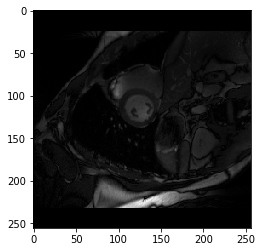

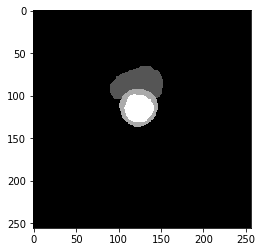

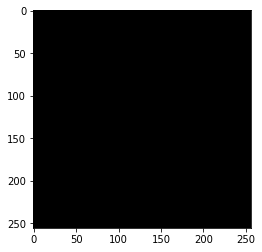

best performance: dice 0.93, idx 48


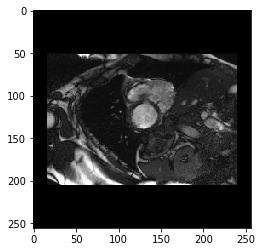

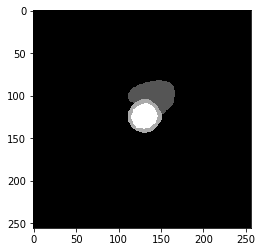

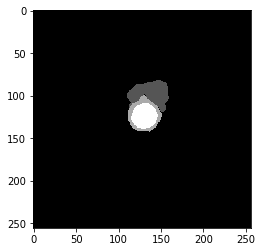

----------

EPOCH 50 of 140

Training Loss: 3.1829
0 Class, True Pos 57603028.0, False Pos 295269.0, False Neg 131988.0, Dice score 1.00
1 Class, True Pos 437498.0, False Pos 99724.0, False Neg 158032.0, Dice score 0.77
2 Class, True Pos 494479.0, False Pos 112204.0, False Neg 159850.0, Dice score 0.78
3 Class, True Pos 563660.0, False Pos 31901.0, False Neg 89228.0, Dice score 0.90
----------
Vaildation Loss: 5.3624
0 Class, True Pos 62890720.0, False Pos 438602.0, False Neg 177741.0, Dice score 1.00
1 Class, True Pos 440620.0, False Pos 143258.0, False Neg 190306.0, Dice score 0.73
2 Class, True Pos 458780.0, False Pos 107076.0, False Neg 209145.0, Dice score 0.74
3 Class, True Pos 510773.0, False Pos 21887.0, False Neg 133631.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


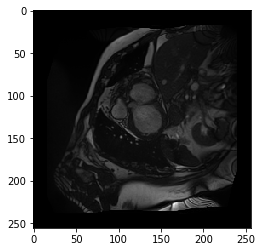

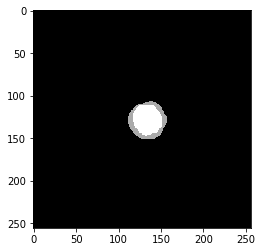

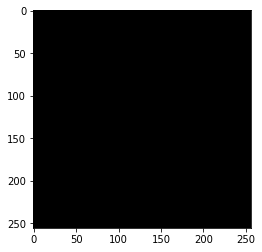

best performance: dice 0.93, idx 48


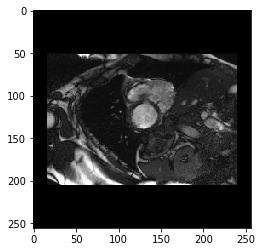

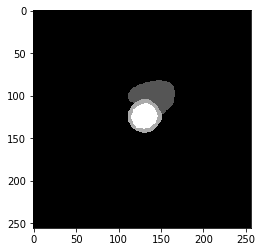

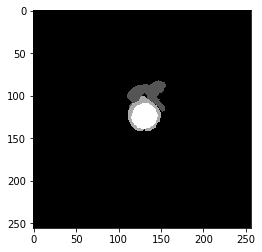

----------

EPOCH 51 of 140

Training Loss: 3.0416
0 Class, True Pos 57575472.0, False Pos 294228.0, False Neg 128766.0, Dice score 1.00
1 Class, True Pos 444662.0, False Pos 104192.0, False Neg 165058.0, Dice score 0.77
2 Class, True Pos 507206.0, False Pos 109647.0, False Neg 156469.0, Dice score 0.79
3 Class, True Pos 575208.0, False Pos 27145.0, False Neg 84919.0, Dice score 0.91
----------
Vaildation Loss: 4.9823
0 Class, True Pos 62888168.0, False Pos 384533.0, False Neg 180287.0, Dice score 1.00
1 Class, True Pos 449792.0, False Pos 150428.0, False Neg 181134.0, Dice score 0.73
2 Class, True Pos 478216.0, False Pos 114733.0, False Neg 189709.0, Dice score 0.76
3 Class, True Pos 523200.0, False Pos 22640.0, False Neg 121204.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


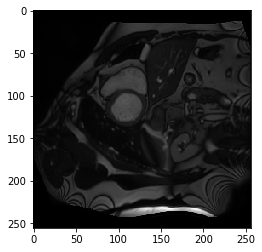

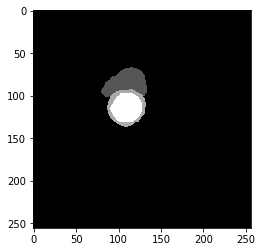

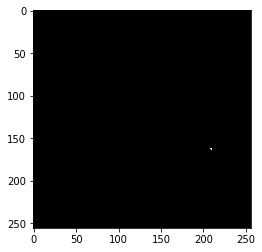

best performance: dice 0.93, idx 48


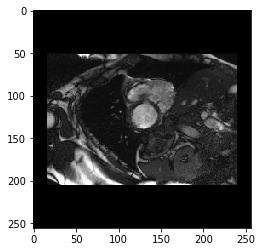

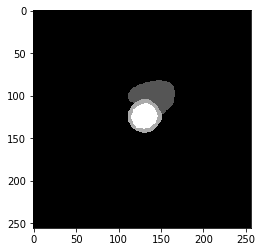

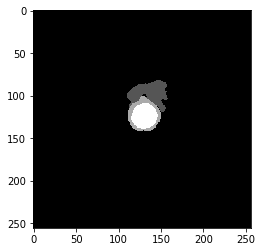

----------

EPOCH 52 of 140

Training Loss: 3.1199
0 Class, True Pos 57599144.0, False Pos 283669.0, False Neg 132906.0, Dice score 1.00
1 Class, True Pos 440698.0, False Pos 97493.0, False Neg 161454.0, Dice score 0.77
2 Class, True Pos 501392.0, False Pos 113871.0, False Neg 145794.0, Dice score 0.79
3 Class, True Pos 572892.0, False Pos 28595.0, False Neg 83474.0, Dice score 0.91
----------
Vaildation Loss: 5.0122
0 Class, True Pos 62852336.0, False Pos 370895.0, False Neg 216127.0, Dice score 1.00
1 Class, True Pos 461100.0, False Pos 175339.0, False Neg 169826.0, Dice score 0.73
2 Class, True Pos 478125.0, False Pos 117973.0, False Neg 189800.0, Dice score 0.76
3 Class, True Pos 529136.0, False Pos 26814.0, False Neg 115268.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


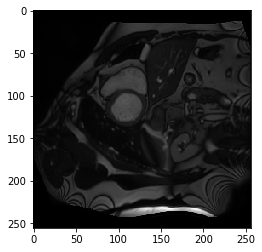

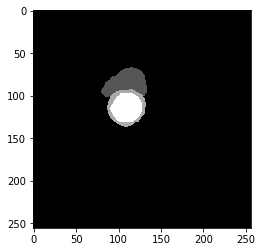

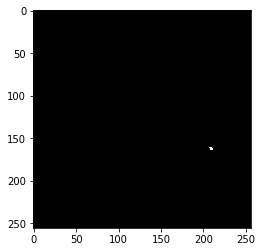

best performance: dice 0.93, idx 48


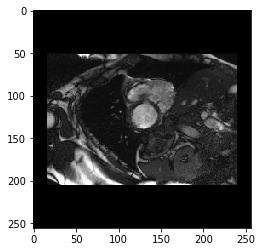

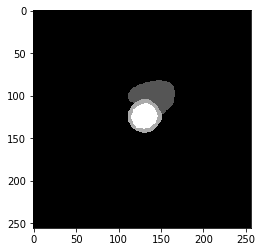

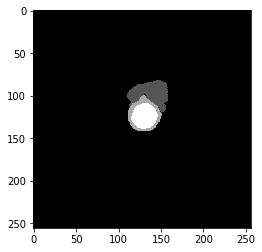

----------

EPOCH 53 of 140

Training Loss: 3.1094
0 Class, True Pos 57573492.0, False Pos 280797.0, False Neg 133856.0, Dice score 1.00
1 Class, True Pos 455142.0, False Pos 102722.0, False Neg 154577.0, Dice score 0.78
2 Class, True Pos 506591.0, False Pos 115032.0, False Neg 156001.0, Dice score 0.79
3 Class, True Pos 575883.0, False Pos 28098.0, False Neg 82215.0, Dice score 0.91
----------
Vaildation Loss: 4.9826
0 Class, True Pos 62834216.0, False Pos 358446.0, False Neg 234238.0, Dice score 1.00
1 Class, True Pos 466287.0, False Pos 190467.0, False Neg 164639.0, Dice score 0.72
2 Class, True Pos 481476.0, False Pos 119950.0, False Neg 186449.0, Dice score 0.76
3 Class, True Pos 532165.0, False Pos 28702.0, False Neg 112239.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


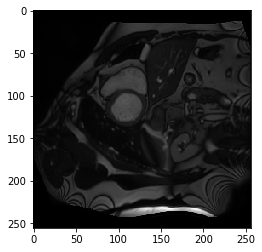

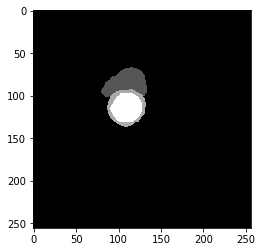

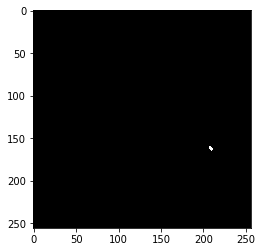

best performance: dice 0.93, idx 48


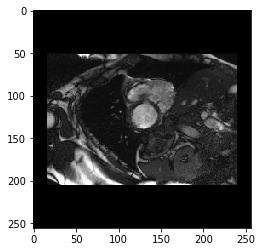

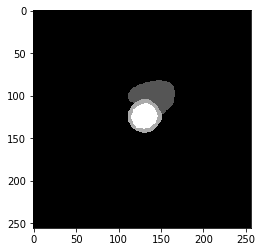

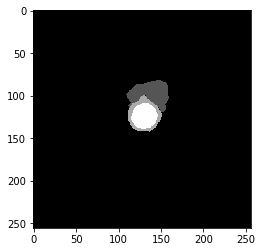

----------

EPOCH 54 of 140

Training Loss: 3.1080
0 Class, True Pos 57575656.0, False Pos 290905.0, False Neg 132833.0, Dice score 1.00
1 Class, True Pos 445850.0, False Pos 106603.0, False Neg 163605.0, Dice score 0.77
2 Class, True Pos 506882.0, False Pos 110118.0, False Neg 155333.0, Dice score 0.79
3 Class, True Pos 574227.0, False Pos 27519.0, False Neg 83374.0, Dice score 0.91
----------
Vaildation Loss: 4.8620
0 Class, True Pos 62831168.0, False Pos 344682.0, False Neg 237294.0, Dice score 1.00
1 Class, True Pos 471820.0, False Pos 200480.0, False Neg 159106.0, Dice score 0.72
2 Class, True Pos 480965.0, False Pos 114529.0, False Neg 186960.0, Dice score 0.76
3 Class, True Pos 538472.0, False Pos 29601.0, False Neg 105932.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


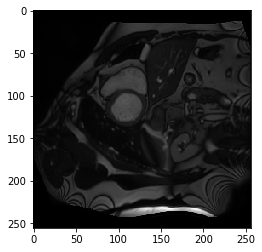

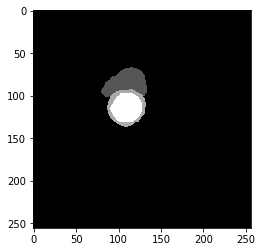

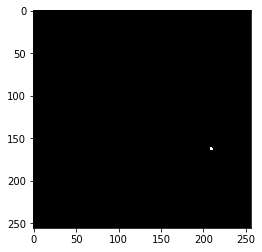

best performance: dice 0.92, idx 48


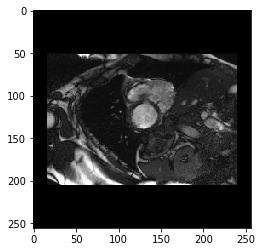

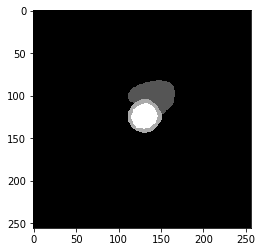

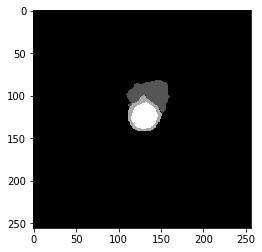

----------

EPOCH 55 of 140

Training Loss: 3.0041
0 Class, True Pos 57614644.0, False Pos 249825.0, False Neg 129091.0, Dice score 1.00
1 Class, True Pos 453056.0, False Pos 103116.0, False Neg 139375.0, Dice score 0.79
2 Class, True Pos 502959.0, False Pos 111034.0, False Neg 142224.0, Dice score 0.80
3 Class, True Pos 578547.0, False Pos 24560.0, False Neg 77845.0, Dice score 0.92
----------
Vaildation Loss: 4.7927
0 Class, True Pos 62818216.0, False Pos 331988.0, False Neg 250242.0, Dice score 1.00
1 Class, True Pos 472825.0, False Pos 207656.0, False Neg 158101.0, Dice score 0.72
2 Class, True Pos 491087.0, False Pos 123271.0, False Neg 176838.0, Dice score 0.77
3 Class, True Pos 538430.0, False Pos 28240.0, False Neg 105974.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


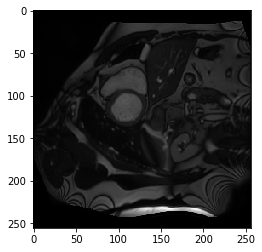

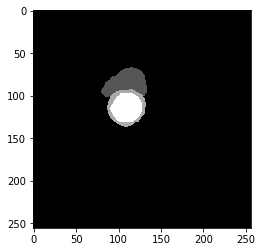

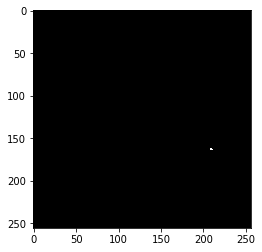

best performance: dice 0.92, idx 48


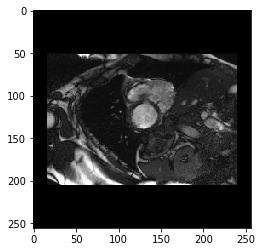

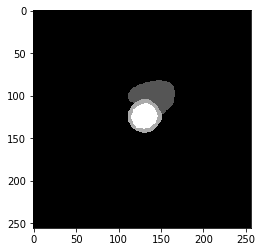

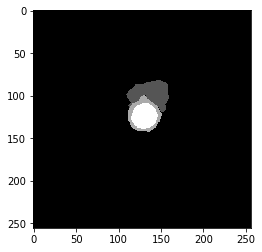

----------

EPOCH 56 of 140

Training Loss: 3.0864
0 Class, True Pos 57626952.0, False Pos 256051.0, False Neg 139018.0, Dice score 1.00
1 Class, True Pos 437874.0, False Pos 109436.0, False Neg 153912.0, Dice score 0.77
2 Class, True Pos 500838.0, False Pos 112109.0, False Neg 144119.0, Dice score 0.80
3 Class, True Pos 564898.0, False Pos 29604.0, False Neg 70151.0, Dice score 0.92
----------
Vaildation Loss: 5.0464
0 Class, True Pos 62844368.0, False Pos 368312.0, False Neg 224091.0, Dice score 1.00
1 Class, True Pos 462616.0, False Pos 182610.0, False Neg 168310.0, Dice score 0.73
2 Class, True Pos 482071.0, False Pos 121854.0, False Neg 185854.0, Dice score 0.76
3 Class, True Pos 525048.0, False Pos 24835.0, False Neg 119356.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


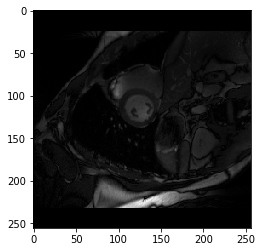

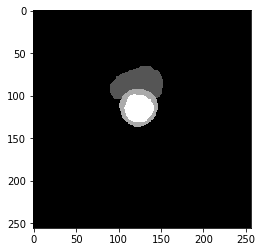

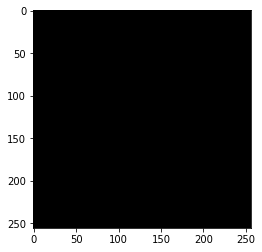

best performance: dice 0.93, idx 48


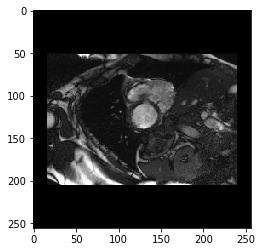

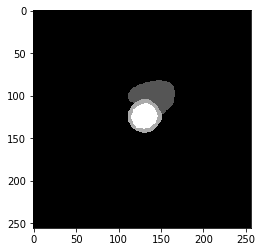

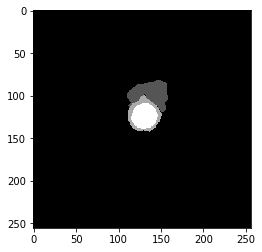

----------

EPOCH 57 of 140

Training Loss: 3.0485
0 Class, True Pos 57590288.0, False Pos 277806.0, False Neg 127255.0, Dice score 1.00
1 Class, True Pos 454706.0, False Pos 100789.0, False Neg 151865.0, Dice score 0.78
2 Class, True Pos 505080.0, False Pos 111179.0, False Neg 154126.0, Dice score 0.79
3 Class, True Pos 571504.0, False Pos 26408.0, False Neg 82936.0, Dice score 0.91
----------
Vaildation Loss: 4.8895
0 Class, True Pos 62820984.0, False Pos 345586.0, False Neg 247477.0, Dice score 1.00
1 Class, True Pos 474168.0, False Pos 212586.0, False Neg 156758.0, Dice score 0.72
2 Class, True Pos 475060.0, False Pos 108597.0, False Neg 192865.0, Dice score 0.76
3 Class, True Pos 542057.0, False Pos 32678.0, False Neg 102347.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


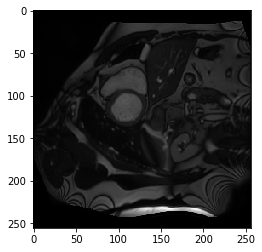

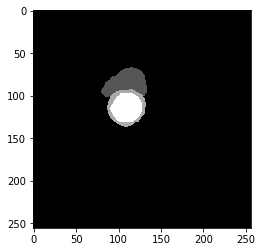

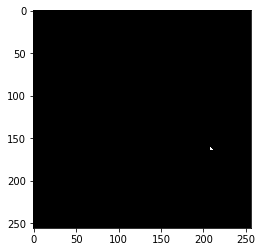

best performance: dice 0.92, idx 31


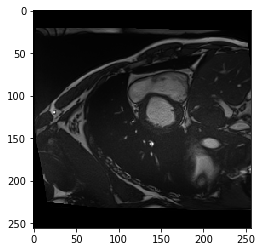

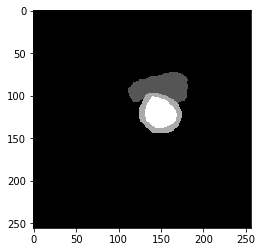

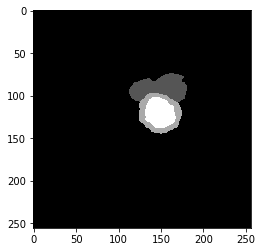

----------

EPOCH 58 of 140

Training Loss: 3.2438
0 Class, True Pos 57547444.0, False Pos 330133.0, False Neg 140739.0, Dice score 1.00
1 Class, True Pos 432322.0, False Pos 105915.0, False Neg 183160.0, Dice score 0.75
2 Class, True Pos 497589.0, False Pos 118901.0, False Neg 175334.0, Dice score 0.77
3 Class, True Pos 573279.0, False Pos 32173.0, False Neg 87889.0, Dice score 0.91
----------
Vaildation Loss: 5.2787
0 Class, True Pos 62875964.0, False Pos 420394.0, False Neg 192495.0, Dice score 1.00
1 Class, True Pos 444135.0, False Pos 150754.0, False Neg 186791.0, Dice score 0.72
2 Class, True Pos 465768.0, False Pos 111724.0, False Neg 202157.0, Dice score 0.75
3 Class, True Pos 518242.0, False Pos 24733.0, False Neg 126162.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


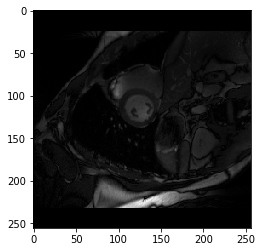

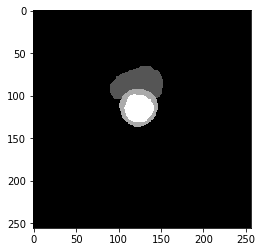

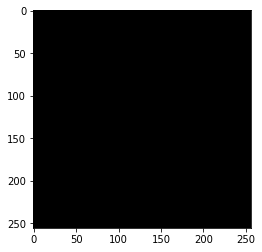

best performance: dice 0.93, idx 48


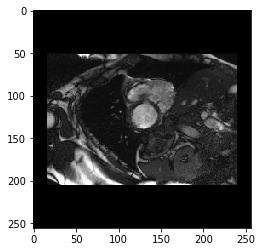

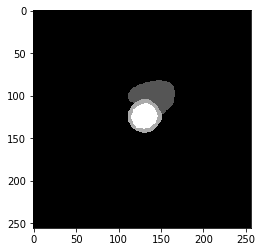

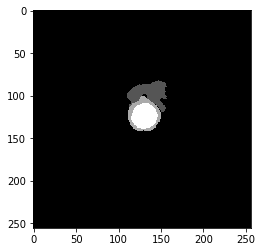

----------

EPOCH 59 of 140

Training Loss: 3.1223
0 Class, True Pos 57592104.0, False Pos 285102.0, False Neg 132275.0, Dice score 1.00
1 Class, True Pos 444411.0, False Pos 107841.0, False Neg 156491.0, Dice score 0.77
2 Class, True Pos 499713.0, False Pos 112178.0, False Neg 157300.0, Dice score 0.79
3 Class, True Pos 571637.0, False Pos 24775.0, False Neg 83830.0, Dice score 0.91
----------
Vaildation Loss: 5.5481
0 Class, True Pos 62924152.0, False Pos 474352.0, False Neg 144300.0, Dice score 1.00
1 Class, True Pos 426116.0, False Pos 117954.0, False Neg 204810.0, Dice score 0.73
2 Class, True Pos 448631.0, False Pos 104200.0, False Neg 219294.0, Dice score 0.74
3 Class, True Pos 498247.0, False Pos 18055.0, False Neg 146157.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


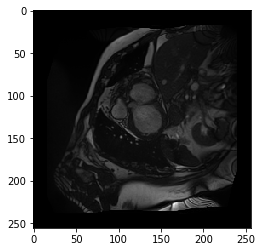

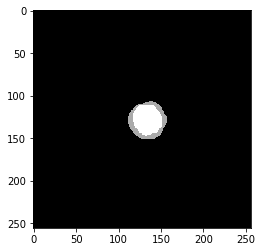

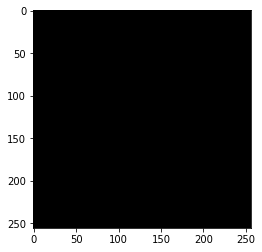

best performance: dice 0.93, idx 48


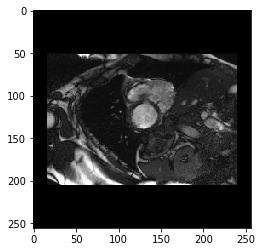

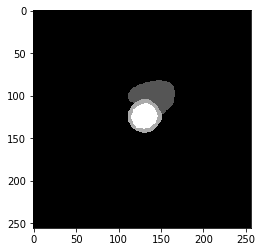

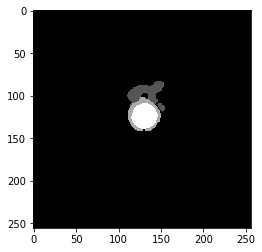

----------

EPOCH 60 of 140

Training Loss: 3.0865
0 Class, True Pos 57592328.0, False Pos 282394.0, False Neg 129041.0, Dice score 1.00
1 Class, True Pos 447058.0, False Pos 105983.0, False Neg 155720.0, Dice score 0.77
2 Class, True Pos 502683.0, False Pos 108175.0, False Neg 156460.0, Dice score 0.79
3 Class, True Pos 574597.0, False Pos 24544.0, False Neg 79875.0, Dice score 0.92
----------
Vaildation Loss: 5.1513
0 Class, True Pos 62841928.0, False Pos 386617.0, False Neg 226525.0, Dice score 1.00
1 Class, True Pos 459845.0, False Pos 182714.0, False Neg 171081.0, Dice score 0.72
2 Class, True Pos 474156.0, False Pos 117033.0, False Neg 193769.0, Dice score 0.75
3 Class, True Pos 523703.0, False Pos 25712.0, False Neg 120701.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


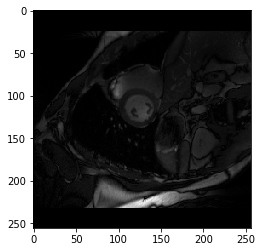

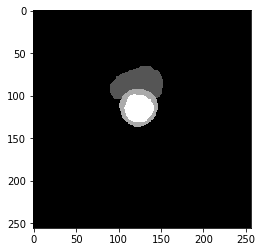

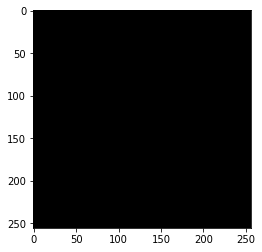

best performance: dice 0.93, idx 48


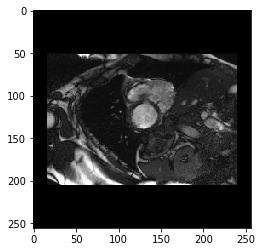

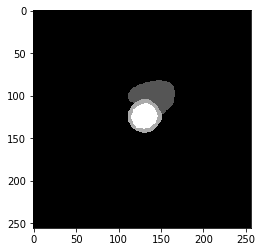

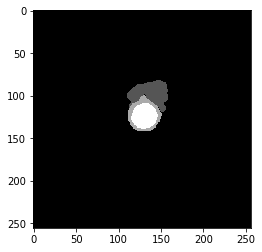

----------

EPOCH 61 of 140

Training Loss: 3.0791
0 Class, True Pos 57583492.0, False Pos 289569.0, False Neg 138708.0, Dice score 1.00
1 Class, True Pos 441297.0, False Pos 105731.0, False Neg 153962.0, Dice score 0.77
2 Class, True Pos 507314.0, False Pos 113831.0, False Neg 153644.0, Dice score 0.79
3 Class, True Pos 568928.0, False Pos 27603.0, False Neg 90420.0, Dice score 0.91
----------
Vaildation Loss: 5.3562
0 Class, True Pos 62868908.0, False Pos 421987.0, False Neg 199552.0, Dice score 1.00
1 Class, True Pos 442114.0, False Pos 149082.0, False Neg 188812.0, Dice score 0.72
2 Class, True Pos 472029.0, False Pos 124812.0, False Neg 195896.0, Dice score 0.75
3 Class, True Pos 510748.0, False Pos 22035.0, False Neg 133656.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


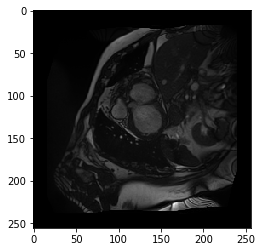

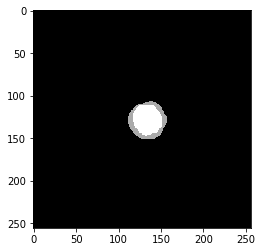

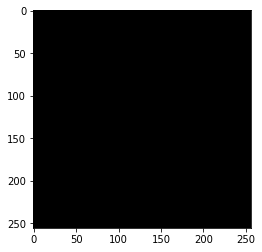

best performance: dice 0.93, idx 48


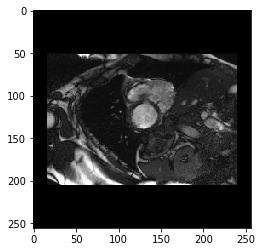

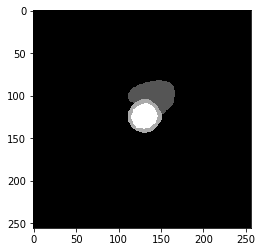

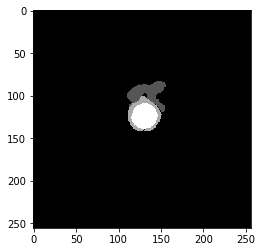

----------

EPOCH 62 of 140

Training Loss: 3.1602
0 Class, True Pos 57573248.0, False Pos 289641.0, False Neg 133141.0, Dice score 1.00
1 Class, True Pos 443517.0, False Pos 110609.0, False Neg 163228.0, Dice score 0.76
2 Class, True Pos 508065.0, False Pos 110411.0, False Neg 156529.0, Dice score 0.79
3 Class, True Pos 574019.0, False Pos 28254.0, False Neg 86017.0, Dice score 0.91
----------
Vaildation Loss: 4.9225
0 Class, True Pos 62817216.0, False Pos 346249.0, False Neg 251235.0, Dice score 1.00
1 Class, True Pos 471312.0, False Pos 207141.0, False Neg 159614.0, Dice score 0.72
2 Class, True Pos 482851.0, False Pos 118822.0, False Neg 185074.0, Dice score 0.76
3 Class, True Pos 537504.0, False Pos 30611.0, False Neg 106900.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


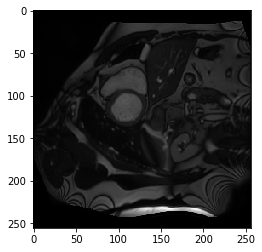

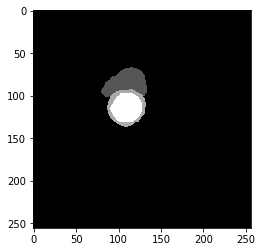

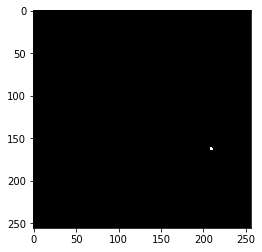

best performance: dice 0.92, idx 48


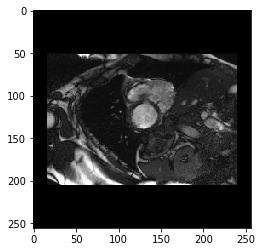

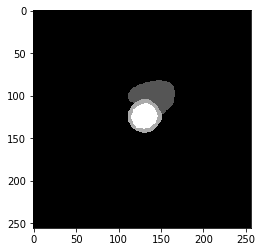

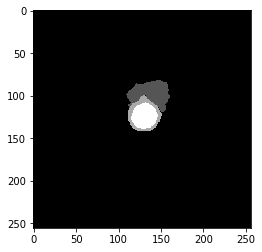

----------

EPOCH 63 of 140

Training Loss: 3.1544
0 Class, True Pos 57573416.0, False Pos 294952.0, False Neg 137256.0, Dice score 1.00
1 Class, True Pos 442296.0, False Pos 108522.0, False Neg 162181.0, Dice score 0.77
2 Class, True Pos 503254.0, False Pos 117324.0, False Neg 161405.0, Dice score 0.78
3 Class, True Pos 569810.0, False Pos 28202.0, False Neg 88158.0, Dice score 0.91
----------
Vaildation Loss: 5.2322
0 Class, True Pos 62858352.0, False Pos 407252.0, False Neg 210105.0, Dice score 1.00
1 Class, True Pos 454895.0, False Pos 176788.0, False Neg 176031.0, Dice score 0.72
2 Class, True Pos 454116.0, False Pos 99667.0, False Neg 213809.0, Dice score 0.74
3 Class, True Pos 529065.0, False Pos 31577.0, False Neg 115339.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


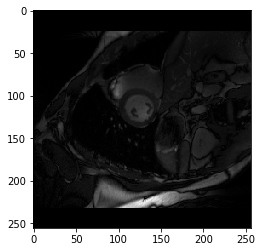

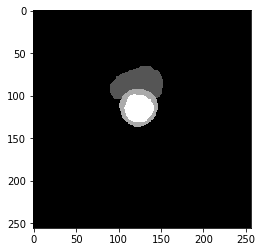

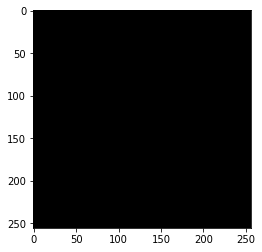

best performance: dice 0.92, idx 39


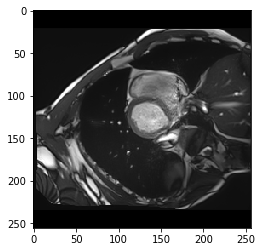

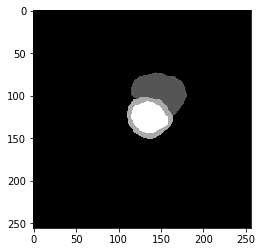

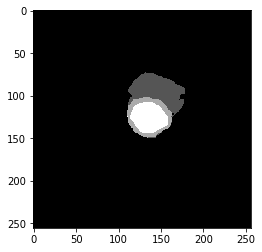

----------

EPOCH 64 of 140

Training Loss: 3.2137
0 Class, True Pos 57641676.0, False Pos 262035.0, False Neg 151849.0, Dice score 1.00
1 Class, True Pos 427769.0, False Pos 114235.0, False Neg 140381.0, Dice score 0.77
2 Class, True Pos 491030.0, False Pos 117025.0, False Neg 149277.0, Dice score 0.79
3 Class, True Pos 553209.0, False Pos 30784.0, False Neg 82572.0, Dice score 0.91
----------
Vaildation Loss: 5.1855
0 Class, True Pos 62825200.0, False Pos 383391.0, False Neg 243258.0, Dice score 1.00
1 Class, True Pos 457940.0, False Pos 192617.0, False Neg 172986.0, Dice score 0.71
2 Class, True Pos 477400.0, False Pos 120407.0, False Neg 190525.0, Dice score 0.75
3 Class, True Pos 526207.0, False Pos 28551.0, False Neg 118197.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


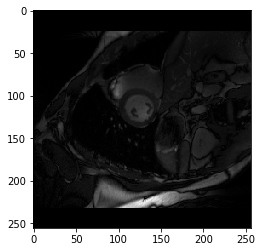

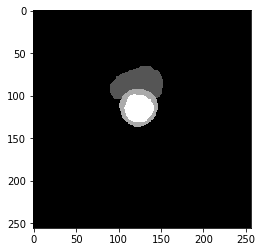

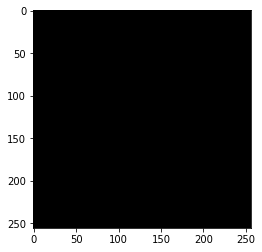

best performance: dice 0.93, idx 48


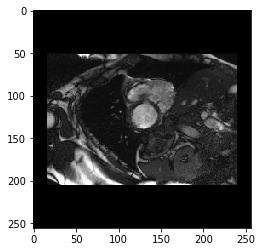

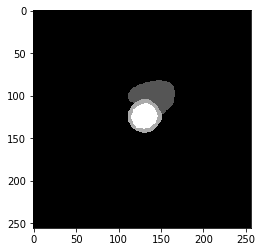

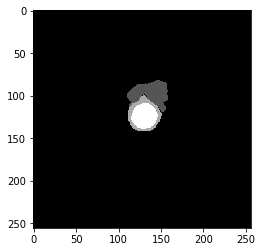

----------

EPOCH 65 of 140

Training Loss: 3.1894
0 Class, True Pos 57653824.0, False Pos 282171.0, False Neg 135932.0, Dice score 1.00
1 Class, True Pos 421447.0, False Pos 103404.0, False Neg 154945.0, Dice score 0.77
2 Class, True Pos 486869.0, False Pos 112145.0, False Neg 154187.0, Dice score 0.79
3 Class, True Pos 551766.0, False Pos 26133.0, False Neg 78789.0, Dice score 0.91
----------
Vaildation Loss: 5.1761
0 Class, True Pos 62884536.0, False Pos 410834.0, False Neg 183920.0, Dice score 1.00
1 Class, True Pos 450405.0, False Pos 155555.0, False Neg 180521.0, Dice score 0.73
2 Class, True Pos 460916.0, False Pos 104391.0, False Neg 207009.0, Dice score 0.75
3 Class, True Pos 520970.0, False Pos 24104.0, False Neg 123434.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


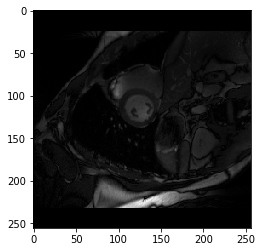

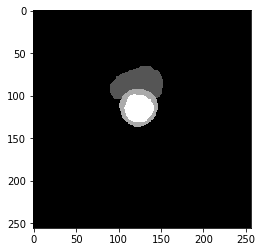

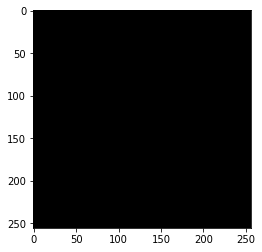

best performance: dice 0.93, idx 48


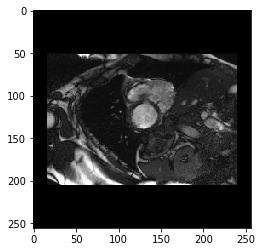

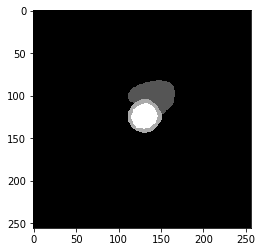

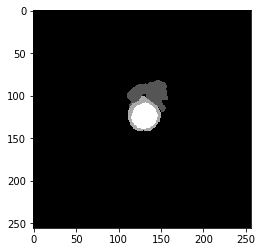

----------

EPOCH 66 of 140

Training Loss: 3.1176
0 Class, True Pos 57589620.0, False Pos 302293.0, False Neg 130262.0, Dice score 1.00
1 Class, True Pos 430988.0, False Pos 103048.0, False Neg 173181.0, Dice score 0.76
2 Class, True Pos 505083.0, False Pos 109450.0, False Neg 153648.0, Dice score 0.79
3 Class, True Pos 571740.0, False Pos 25534.0, False Neg 83234.0, Dice score 0.91
----------
Vaildation Loss: 5.2981
0 Class, True Pos 62884544.0, False Pos 426152.0, False Neg 183908.0, Dice score 1.00
1 Class, True Pos 447198.0, False Pos 152958.0, False Neg 183728.0, Dice score 0.73
2 Class, True Pos 456484.0, False Pos 101934.0, False Neg 211441.0, Dice score 0.74
3 Class, True Pos 517932.0, False Pos 24505.0, False Neg 126472.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


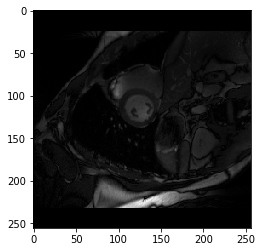

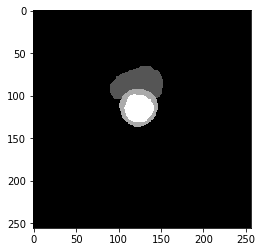

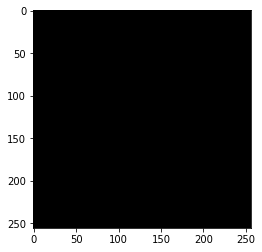

best performance: dice 0.93, idx 48


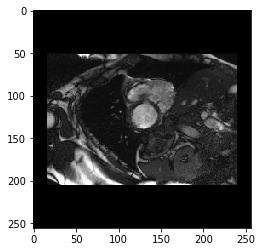

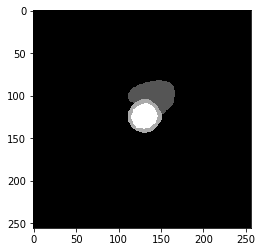

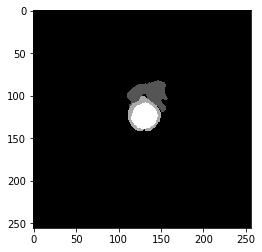

----------

EPOCH 67 of 140

Training Loss: 3.0724
0 Class, True Pos 57592584.0, False Pos 290839.0, False Neg 135077.0, Dice score 1.00
1 Class, True Pos 440244.0, False Pos 111439.0, False Neg 161751.0, Dice score 0.76
2 Class, True Pos 503047.0, False Pos 110494.0, False Neg 153749.0, Dice score 0.79
3 Class, True Pos 563096.0, False Pos 26020.0, False Neg 88215.0, Dice score 0.91
----------
Vaildation Loss: 5.6636
0 Class, True Pos 62911532.0, False Pos 484830.0, False Neg 156924.0, Dice score 0.99
1 Class, True Pos 420717.0, False Pos 117383.0, False Neg 210209.0, Dice score 0.72
2 Class, True Pos 449204.0, False Pos 109713.0, False Neg 218721.0, Dice score 0.73
3 Class, True Pos 498249.0, False Pos 20083.0, False Neg 146155.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


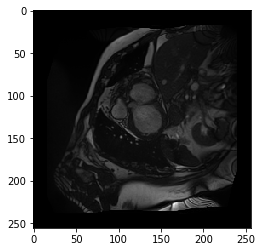

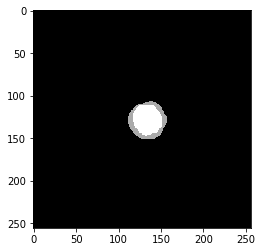

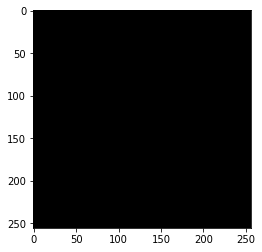

best performance: dice 0.92, idx 48


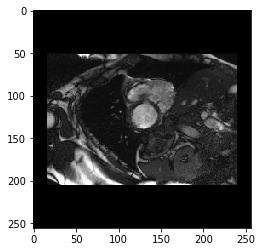

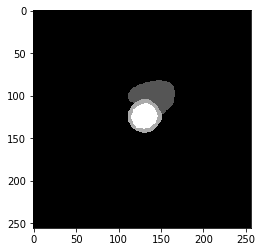

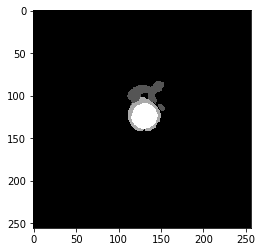

----------

EPOCH 68 of 140

Training Loss: 3.0154
0 Class, True Pos 57608992.0, False Pos 255074.0, False Neg 121954.0, Dice score 1.00
1 Class, True Pos 457775.0, False Pos 92144.0, False Neg 146345.0, Dice score 0.79
2 Class, True Pos 507260.0, False Pos 114697.0, False Neg 146866.0, Dice score 0.80
3 Class, True Pos 574002.0, False Pos 27804.0, False Neg 74554.0, Dice score 0.92
----------
Vaildation Loss: 5.5834
0 Class, True Pos 62912360.0, False Pos 478171.0, False Neg 156089.0, Dice score 0.99
1 Class, True Pos 428236.0, False Pos 127992.0, False Neg 202690.0, Dice score 0.72
2 Class, True Pos 442463.0, False Pos 97334.0, False Neg 225462.0, Dice score 0.73
3 Class, True Pos 503469.0, False Pos 21679.0, False Neg 140935.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


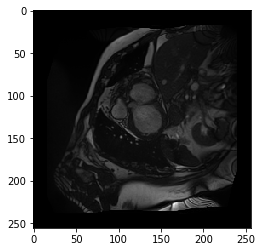

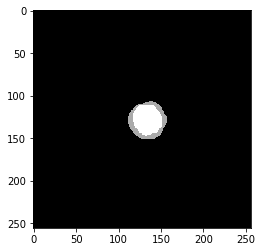

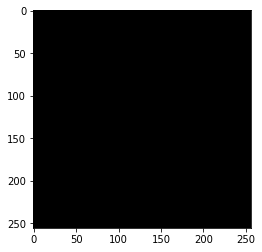

best performance: dice 0.93, idx 48


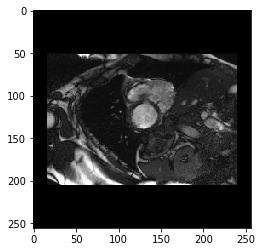

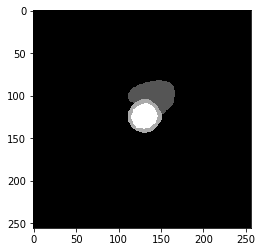

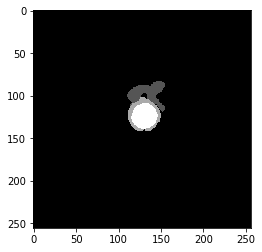

----------

EPOCH 69 of 140

Training Loss: 3.1482
0 Class, True Pos 57616456.0, False Pos 271351.0, False Neg 135630.0, Dice score 1.00
1 Class, True Pos 441444.0, False Pos 102678.0, False Neg 139839.0, Dice score 0.78
2 Class, True Pos 497836.0, False Pos 113198.0, False Neg 154067.0, Dice score 0.79
3 Class, True Pos 568747.0, False Pos 26049.0, False Neg 83740.0, Dice score 0.91
----------
Vaildation Loss: 5.4623
0 Class, True Pos 62903072.0, False Pos 455220.0, False Neg 165384.0, Dice score 1.00
1 Class, True Pos 428093.0, False Pos 124540.0, False Neg 202833.0, Dice score 0.72
2 Class, True Pos 456514.0, False Pos 110836.0, False Neg 211411.0, Dice score 0.74
3 Class, True Pos 510078.0, False Pos 23358.0, False Neg 134326.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


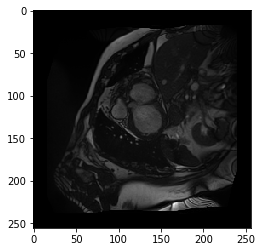

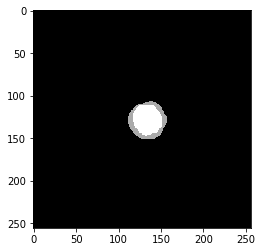

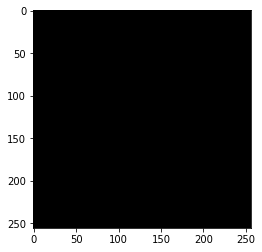

best performance: dice 0.92, idx 48


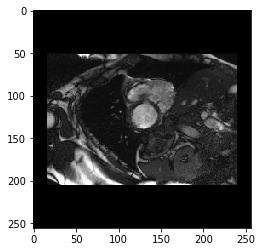

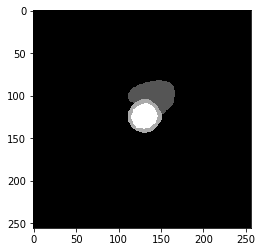

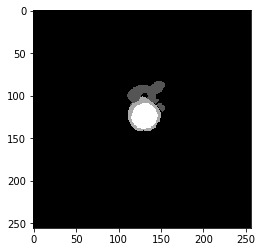

----------

EPOCH 70 of 140

Training Loss: 3.1331
0 Class, True Pos 57580716.0, False Pos 302603.0, False Neg 132704.0, Dice score 1.00
1 Class, True Pos 438683.0, False Pos 104571.0, False Neg 165920.0, Dice score 0.76
2 Class, True Pos 504779.0, False Pos 111518.0, False Neg 154338.0, Dice score 0.79
3 Class, True Pos 568756.0, False Pos 26129.0, False Neg 91859.0, Dice score 0.91
----------
Vaildation Loss: 5.1232
0 Class, True Pos 62859896.0, False Pos 390994.0, False Neg 208568.0, Dice score 1.00
1 Class, True Pos 453768.0, False Pos 166204.0, False Neg 177158.0, Dice score 0.73
2 Class, True Pos 476962.0, False Pos 119460.0, False Neg 190963.0, Dice score 0.75
3 Class, True Pos 521252.0, False Pos 23183.0, False Neg 123152.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


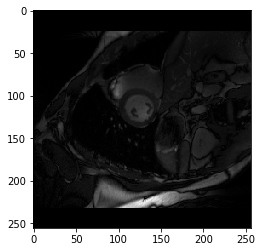

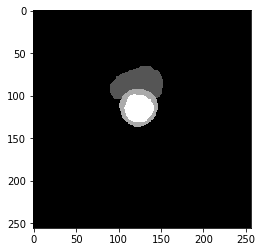

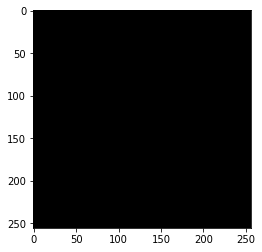

best performance: dice 0.93, idx 48


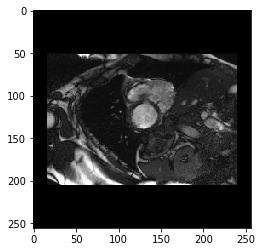

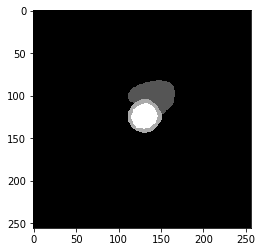

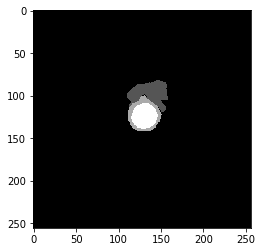

----------

EPOCH 71 of 140

Training Loss: 3.0843
0 Class, True Pos 57571208.0, False Pos 294878.0, False Neg 126151.0, Dice score 1.00
1 Class, True Pos 450267.0, False Pos 104748.0, False Neg 158838.0, Dice score 0.77
2 Class, True Pos 509636.0, False Pos 109949.0, False Neg 161137.0, Dice score 0.79
3 Class, True Pos 573025.0, False Pos 24037.0, False Neg 87486.0, Dice score 0.91
----------
Vaildation Loss: 5.5069
0 Class, True Pos 62895580.0, False Pos 458894.0, False Neg 172874.0, Dice score 1.00
1 Class, True Pos 431436.0, False Pos 134085.0, False Neg 199490.0, Dice score 0.72
2 Class, True Pos 454766.0, False Pos 109163.0, False Neg 213159.0, Dice score 0.74
3 Class, True Pos 505835.0, False Pos 21950.0, False Neg 138569.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


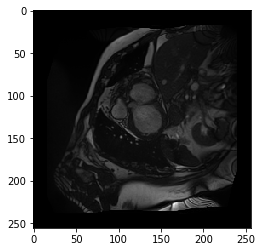

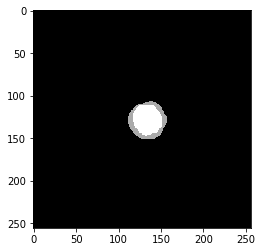

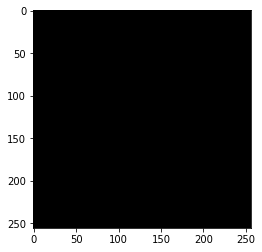

best performance: dice 0.93, idx 48


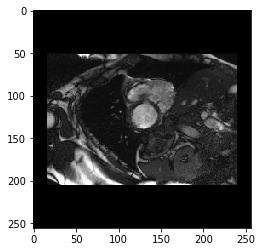

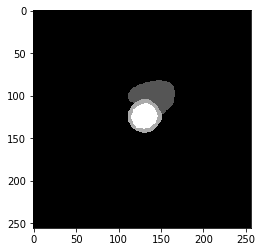

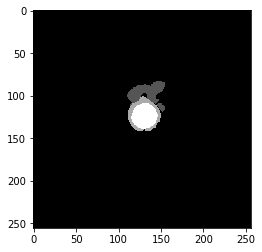

----------

EPOCH 72 of 140

Training Loss: 3.1196
0 Class, True Pos 57630920.0, False Pos 259881.0, False Neg 134789.0, Dice score 1.00
1 Class, True Pos 430439.0, False Pos 108196.0, False Neg 139079.0, Dice score 0.78
2 Class, True Pos 497002.0, False Pos 112841.0, False Neg 151977.0, Dice score 0.79
3 Class, True Pos 571922.0, False Pos 26578.0, False Neg 81651.0, Dice score 0.91
----------
Vaildation Loss: 5.2109
0 Class, True Pos 62875004.0, False Pos 409423.0, False Neg 193456.0, Dice score 1.00
1 Class, True Pos 446627.0, False Pos 151075.0, False Neg 184299.0, Dice score 0.73
2 Class, True Pos 470893.0, False Pos 115465.0, False Neg 197032.0, Dice score 0.75
3 Class, True Pos 519274.0, False Pos 23954.0, False Neg 125130.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


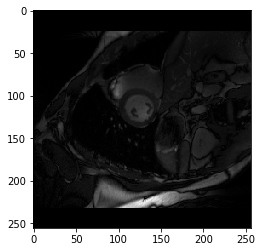

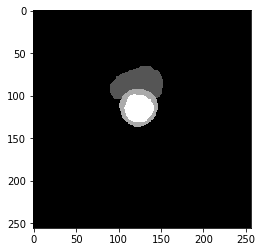

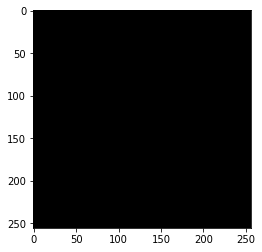

best performance: dice 0.93, idx 48


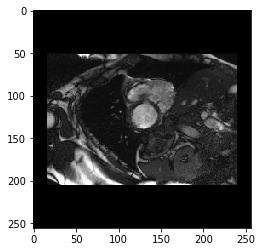

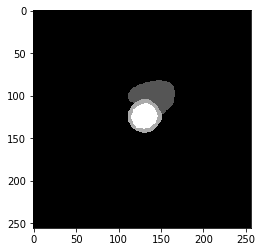

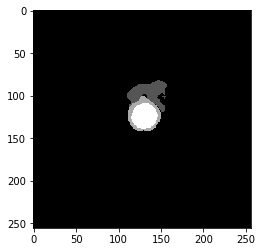

----------

EPOCH 73 of 140

Training Loss: 3.1725
0 Class, True Pos 57593544.0, False Pos 290087.0, False Neg 130128.0, Dice score 1.00
1 Class, True Pos 438914.0, False Pos 103677.0, False Neg 164949.0, Dice score 0.77
2 Class, True Pos 496115.0, False Pos 113892.0, False Neg 161277.0, Dice score 0.78
3 Class, True Pos 572299.0, False Pos 29219.0, False Neg 80521.0, Dice score 0.91
----------
Vaildation Loss: 5.2292
0 Class, True Pos 62849172.0, False Pos 399690.0, False Neg 219283.0, Dice score 1.00
1 Class, True Pos 450864.0, False Pos 169939.0, False Neg 180062.0, Dice score 0.72
2 Class, True Pos 475323.0, False Pos 120044.0, False Neg 192602.0, Dice score 0.75
3 Class, True Pos 520896.0, False Pos 25782.0, False Neg 123508.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


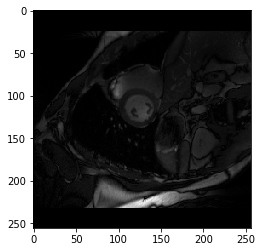

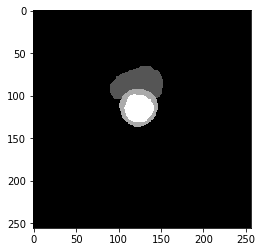

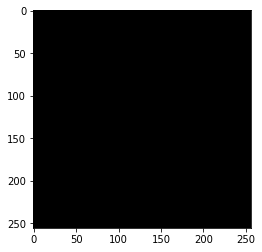

best performance: dice 0.93, idx 48


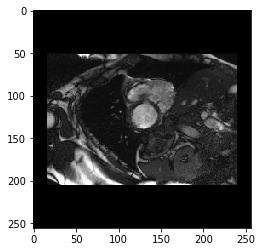

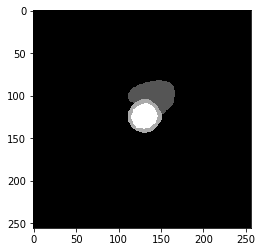

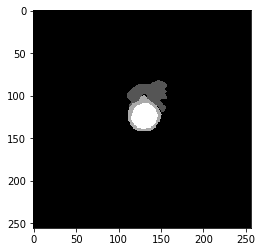

----------

EPOCH 74 of 140

Training Loss: 3.0644
0 Class, True Pos 57627796.0, False Pos 259206.0, False Neg 132004.0, Dice score 1.00
1 Class, True Pos 441147.0, False Pos 101669.0, False Neg 150936.0, Dice score 0.78
2 Class, True Pos 503641.0, False Pos 111145.0, False Neg 137322.0, Dice score 0.80
3 Class, True Pos 567260.0, False Pos 25884.0, False Neg 77642.0, Dice score 0.92
----------
Vaildation Loss: 5.0330
0 Class, True Pos 62833704.0, False Pos 365552.0, False Neg 234758.0, Dice score 1.00
1 Class, True Pos 465577.0, False Pos 195044.0, False Neg 165349.0, Dice score 0.72
2 Class, True Pos 475985.0, False Pos 114688.0, False Neg 191940.0, Dice score 0.76
3 Class, True Pos 531953.0, False Pos 29214.0, False Neg 112451.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


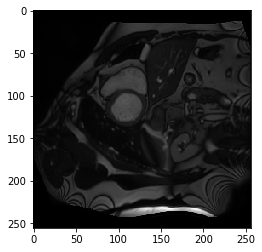

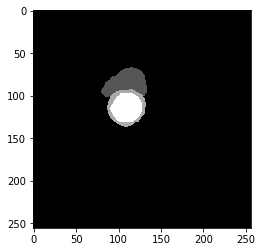

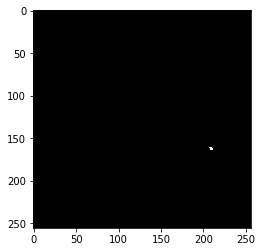

best performance: dice 0.92, idx 48


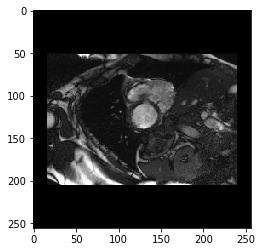

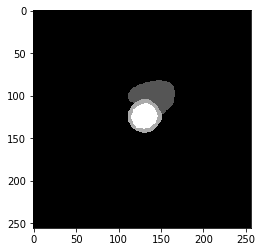

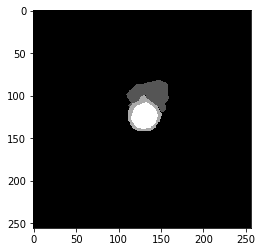

----------

EPOCH 75 of 140

Training Loss: 3.0421
0 Class, True Pos 57575764.0, False Pos 301134.0, False Neg 125627.0, Dice score 1.00
1 Class, True Pos 448264.0, False Pos 99748.0, False Neg 159833.0, Dice score 0.78
2 Class, True Pos 503860.0, False Pos 110592.0, False Neg 163986.0, Dice score 0.79
3 Class, True Pos 569394.0, False Pos 29008.0, False Neg 91036.0, Dice score 0.90
----------
Vaildation Loss: 5.0031
0 Class, True Pos 62845260.0, False Pos 370312.0, False Neg 223204.0, Dice score 1.00
1 Class, True Pos 462136.0, False Pos 183706.0, False Neg 168790.0, Dice score 0.72
2 Class, True Pos 475931.0, False Pos 114643.0, False Neg 191994.0, Dice score 0.76
3 Class, True Pos 531591.0, False Pos 28140.0, False Neg 112813.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


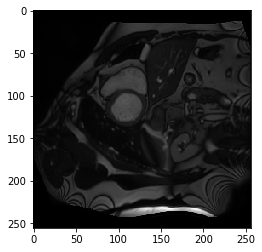

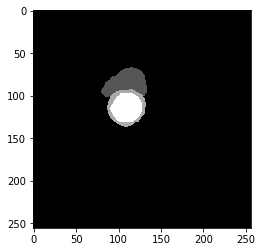

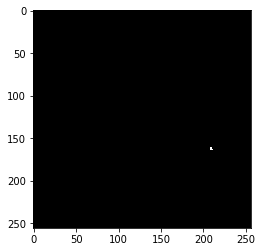

best performance: dice 0.93, idx 48


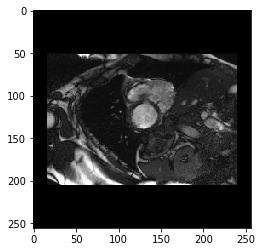

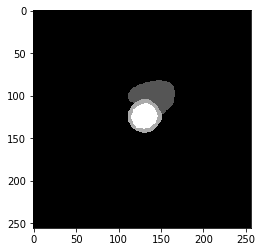

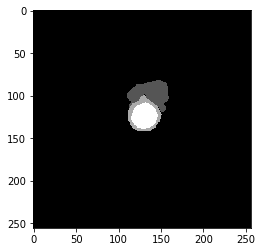

----------

EPOCH 76 of 140

Training Loss: 3.0399
0 Class, True Pos 57588220.0, False Pos 266460.0, False Neg 138865.0, Dice score 1.00
1 Class, True Pos 457120.0, False Pos 110301.0, False Neg 145375.0, Dice score 0.78
2 Class, True Pos 506366.0, False Pos 112604.0, False Neg 149282.0, Dice score 0.79
3 Class, True Pos 569596.0, False Pos 27093.0, False Neg 82936.0, Dice score 0.91
----------
Vaildation Loss: 4.8930
0 Class, True Pos 62865560.0, False Pos 365516.0, False Neg 202900.0, Dice score 1.00
1 Class, True Pos 458036.0, False Pos 163242.0, False Neg 172890.0, Dice score 0.73
2 Class, True Pos 483432.0, False Pos 118837.0, False Neg 184493.0, Dice score 0.76
3 Class, True Pos 531503.0, False Pos 25589.0, False Neg 112901.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


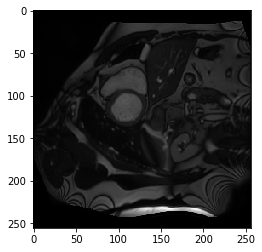

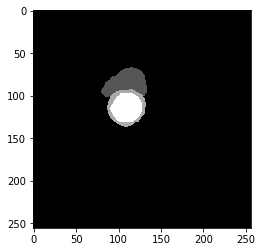

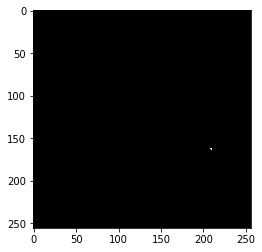

best performance: dice 0.93, idx 48


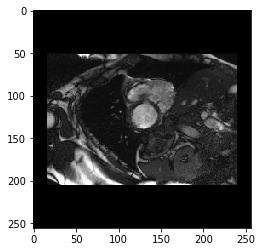

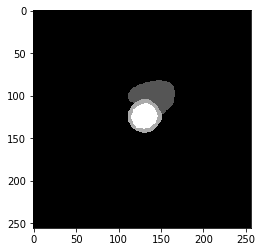

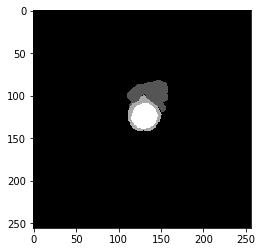

----------

EPOCH 77 of 140

Training Loss: 3.1969
0 Class, True Pos 57618168.0, False Pos 280238.0, False Neg 146548.0, Dice score 1.00
1 Class, True Pos 429256.0, False Pos 113397.0, False Neg 148744.0, Dice score 0.77
2 Class, True Pos 494518.0, False Pos 115461.0, False Neg 154070.0, Dice score 0.79
3 Class, True Pos 560104.0, False Pos 26614.0, False Neg 86348.0, Dice score 0.91
----------
Vaildation Loss: 5.2289
0 Class, True Pos 62894800.0, False Pos 423559.0, False Neg 173653.0, Dice score 1.00
1 Class, True Pos 442104.0, False Pos 139986.0, False Neg 188822.0, Dice score 0.73
2 Class, True Pos 464906.0, False Pos 109048.0, False Neg 203019.0, Dice score 0.75
3 Class, True Pos 515383.0, False Pos 21922.0, False Neg 129021.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


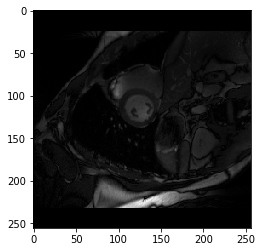

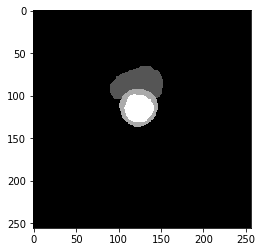

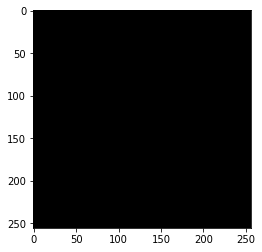

best performance: dice 0.93, idx 39


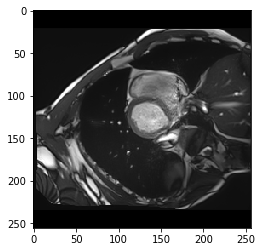

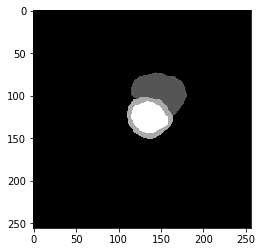

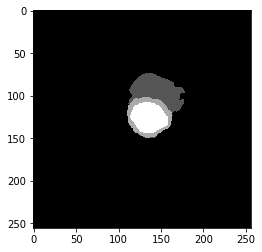

----------

EPOCH 78 of 140

Training Loss: 3.0410
0 Class, True Pos 57627256.0, False Pos 257663.0, False Neg 137649.0, Dice score 1.00
1 Class, True Pos 450414.0, False Pos 106500.0, False Neg 127536.0, Dice score 0.79
2 Class, True Pos 498965.0, False Pos 108144.0, False Neg 148991.0, Dice score 0.80
3 Class, True Pos 562802.0, False Pos 26024.0, False Neg 84155.0, Dice score 0.91
----------
Vaildation Loss: 5.1778
0 Class, True Pos 62858420.0, False Pos 399292.0, False Neg 210037.0, Dice score 1.00
1 Class, True Pos 453506.0, False Pos 169555.0, False Neg 177420.0, Dice score 0.72
2 Class, True Pos 463575.0, False Pos 108772.0, False Neg 204350.0, Dice score 0.75
3 Class, True Pos 528673.0, False Pos 29919.0, False Neg 115731.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


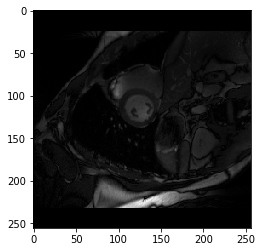

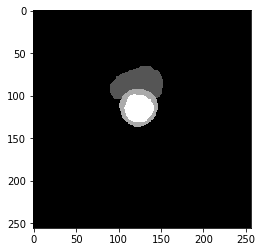

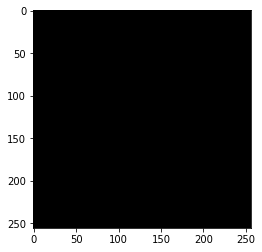

best performance: dice 0.92, idx 39


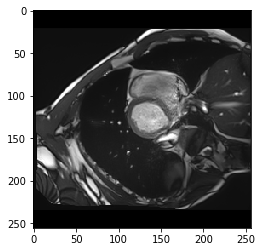

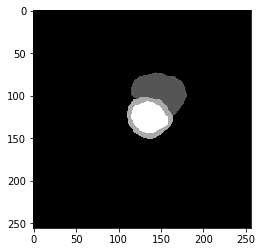

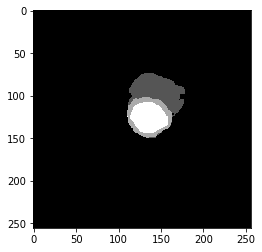

----------

EPOCH 79 of 140

Training Loss: 3.1734
0 Class, True Pos 57577032.0, False Pos 287670.0, False Neg 139790.0, Dice score 1.00
1 Class, True Pos 438567.0, False Pos 108684.0, False Neg 163262.0, Dice score 0.76
2 Class, True Pos 506806.0, False Pos 114549.0, False Neg 156289.0, Dice score 0.79
3 Class, True Pos 575781.0, False Pos 28673.0, False Neg 80235.0, Dice score 0.91
----------
Vaildation Loss: 4.9631
0 Class, True Pos 62821076.0, False Pos 351463.0, False Neg 247390.0, Dice score 1.00
1 Class, True Pos 470954.0, False Pos 206118.0, False Neg 159972.0, Dice score 0.72
2 Class, True Pos 482155.0, False Pos 119847.0, False Neg 185770.0, Dice score 0.76
3 Class, True Pos 532553.0, False Pos 27555.0, False Neg 111851.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


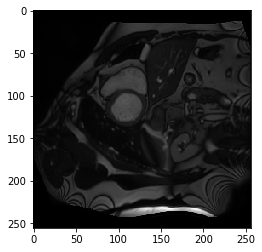

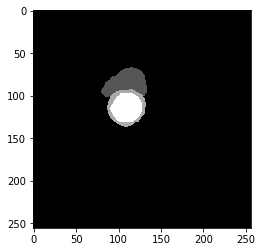

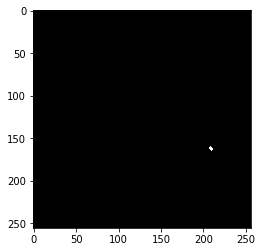

best performance: dice 0.93, idx 48


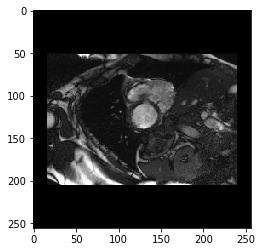

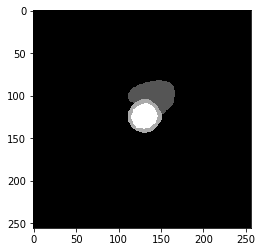

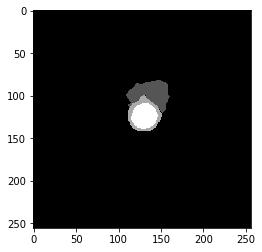

----------

EPOCH 80 of 140

Training Loss: 3.1278
0 Class, True Pos 57615188.0, False Pos 275821.0, False Neg 138550.0, Dice score 1.00
1 Class, True Pos 434210.0, False Pos 110145.0, False Neg 144890.0, Dice score 0.77
2 Class, True Pos 501890.0, False Pos 112870.0, False Neg 149148.0, Dice score 0.79
3 Class, True Pos 560741.0, False Pos 26906.0, False Neg 93154.0, Dice score 0.90
----------
Vaildation Loss: 4.8331
0 Class, True Pos 62870280.0, False Pos 358388.0, False Neg 198173.0, Dice score 1.00
1 Class, True Pos 459924.0, False Pos 163741.0, False Neg 171002.0, Dice score 0.73
2 Class, True Pos 484427.0, False Pos 117516.0, False Neg 183498.0, Dice score 0.76
3 Class, True Pos 532283.0, False Pos 25149.0, False Neg 112121.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


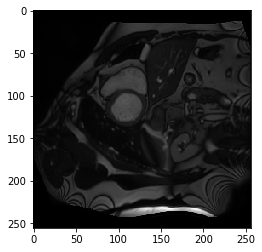

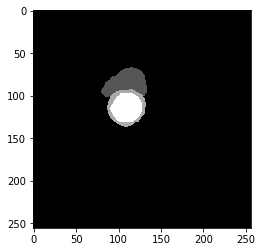

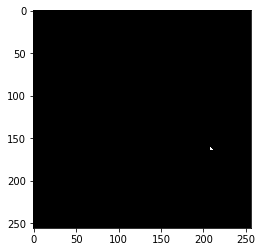

best performance: dice 0.93, idx 48


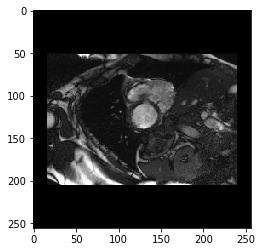

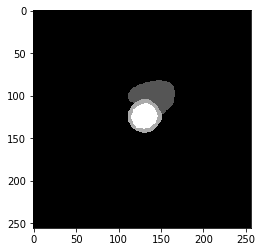

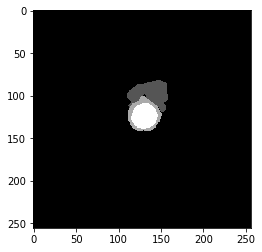

Dice Score: 0.8444
----------

EPOCH 81 of 140

Training Loss: 3.2289
0 Class, True Pos 57600672.0, False Pos 297821.0, False Neg 139185.0, Dice score 1.00
1 Class, True Pos 425491.0, False Pos 101616.0, False Neg 167886.0, Dice score 0.76
2 Class, True Pos 493944.0, False Pos 118044.0, False Neg 155659.0, Dice score 0.78
3 Class, True Pos 568792.0, False Pos 31383.0, False Neg 86134.0, Dice score 0.91
----------
Vaildation Loss: 5.2626
0 Class, True Pos 62897244.0, False Pos 431357.0, False Neg 171213.0, Dice score 1.00
1 Class, True Pos 440631.0, False Pos 141290.0, False Neg 190295.0, Dice score 0.73
2 Class, True Pos 458498.0, False Pos 104723.0, False Neg 209427.0, Dice score 0.74
3 Class, True Pos 515763.0, False Pos 22206.0, False Neg 128641.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


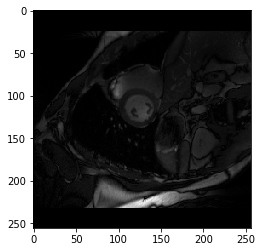

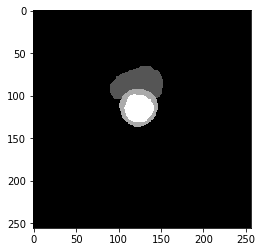

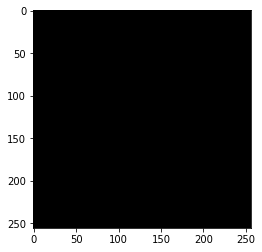

best performance: dice 0.93, idx 39


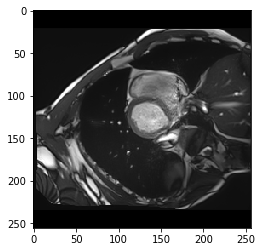

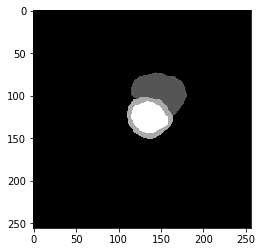

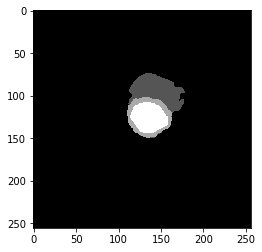

----------

EPOCH 82 of 140

Training Loss: 3.2751
0 Class, True Pos 57606520.0, False Pos 273246.0, False Neg 157951.0, Dice score 1.00
1 Class, True Pos 433573.0, False Pos 117543.0, False Neg 137875.0, Dice score 0.77
2 Class, True Pos 492759.0, False Pos 121524.0, False Neg 159997.0, Dice score 0.78
3 Class, True Pos 559161.0, False Pos 33429.0, False Neg 89919.0, Dice score 0.90
----------
Vaildation Loss: 5.4552
0 Class, True Pos 62909312.0, False Pos 455320.0, False Neg 159133.0, Dice score 1.00
1 Class, True Pos 424485.0, False Pos 117019.0, False Neg 206441.0, Dice score 0.72
2 Class, True Pos 463352.0, False Pos 116683.0, False Neg 204573.0, Dice score 0.74
3 Class, True Pos 504874.0, False Pos 20655.0, False Neg 139530.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


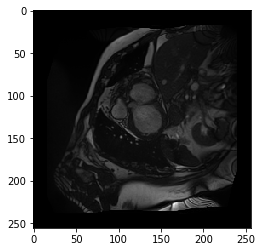

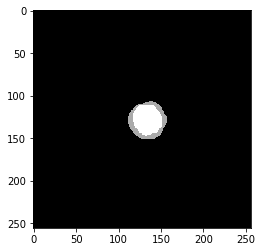

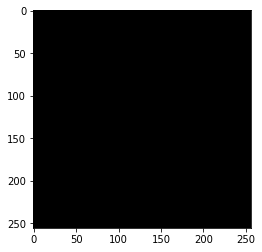

best performance: dice 0.92, idx 48


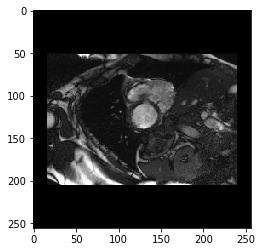

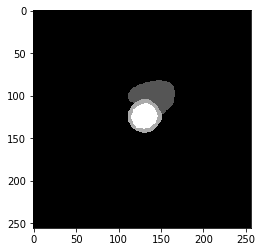

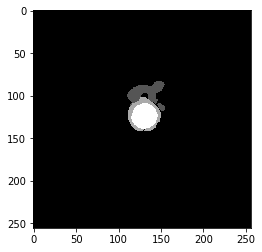

----------

EPOCH 83 of 140

Training Loss: 3.2059
0 Class, True Pos 57576816.0, False Pos 294942.0, False Neg 136803.0, Dice score 1.00
1 Class, True Pos 441602.0, False Pos 105161.0, False Neg 164576.0, Dice score 0.77
2 Class, True Pos 500277.0, False Pos 115926.0, False Neg 157019.0, Dice score 0.79
3 Class, True Pos 575971.0, False Pos 27053.0, False Neg 84684.0, Dice score 0.91
----------
Vaildation Loss: 5.5840
0 Class, True Pos 62878744.0, False Pos 456963.0, False Neg 189722.0, Dice score 0.99
1 Class, True Pos 437447.0, False Pos 147658.0, False Neg 193479.0, Dice score 0.72
2 Class, True Pos 455233.0, False Pos 112331.0, False Neg 212692.0, Dice score 0.74
3 Class, True Pos 501887.0, False Pos 21458.0, False Neg 142517.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


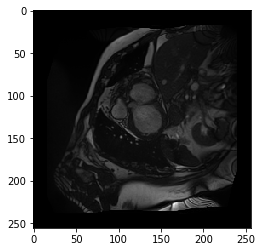

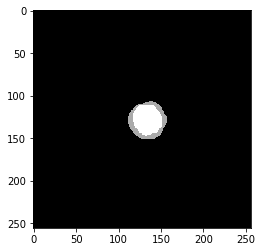

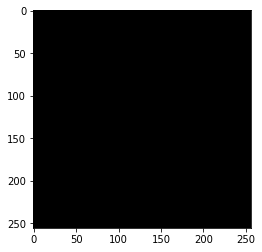

best performance: dice 0.93, idx 48


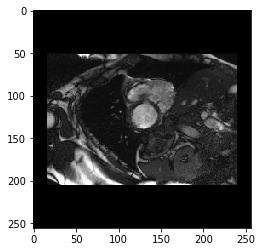

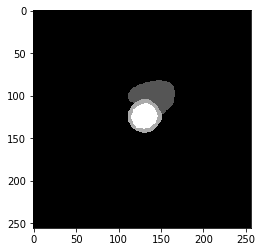

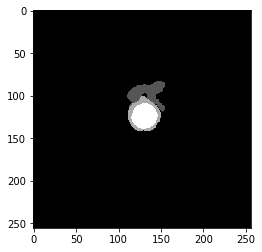

----------

EPOCH 84 of 140

Training Loss: 3.1189
0 Class, True Pos 57613432.0, False Pos 271851.0, False Neg 132265.0, Dice score 1.00
1 Class, True Pos 437201.0, False Pos 105553.0, False Neg 148302.0, Dice score 0.78
2 Class, True Pos 502098.0, False Pos 111513.0, False Neg 152888.0, Dice score 0.79
3 Class, True Pos 568196.0, False Pos 27923.0, False Neg 83385.0, Dice score 0.91
----------
Vaildation Loss: 5.3769
0 Class, True Pos 62880872.0, False Pos 429961.0, False Neg 187580.0, Dice score 1.00
1 Class, True Pos 441167.0, False Pos 145818.0, False Neg 189759.0, Dice score 0.72
2 Class, True Pos 468229.0, False Pos 118024.0, False Neg 199696.0, Dice score 0.75
3 Class, True Pos 506931.0, False Pos 20705.0, False Neg 137473.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


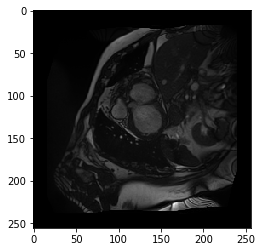

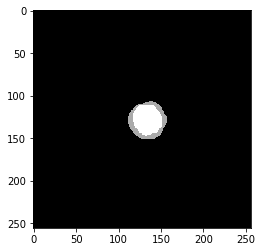

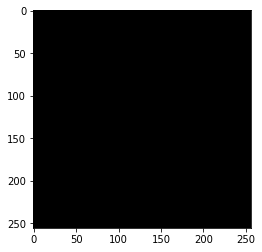

best performance: dice 0.93, idx 48


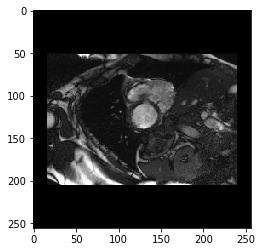

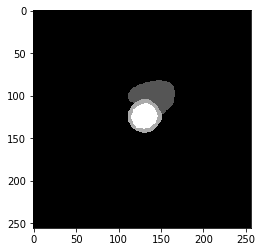

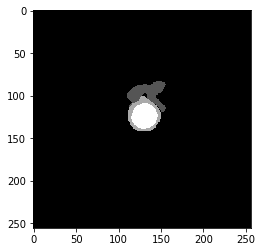

----------

EPOCH 85 of 140

Training Loss: 3.1398
0 Class, True Pos 57591920.0, False Pos 297211.0, False Neg 133112.0, Dice score 1.00
1 Class, True Pos 434686.0, False Pos 104369.0, False Neg 164405.0, Dice score 0.76
2 Class, True Pos 502922.0, False Pos 110263.0, False Neg 155111.0, Dice score 0.79
3 Class, True Pos 568285.0, False Pos 28109.0, False Neg 87324.0, Dice score 0.91
----------
Vaildation Loss: 5.2360
0 Class, True Pos 62889444.0, False Pos 421917.0, False Neg 179017.0, Dice score 1.00
1 Class, True Pos 443343.0, False Pos 143555.0, False Neg 187583.0, Dice score 0.73
2 Class, True Pos 463329.0, False Pos 106464.0, False Neg 204596.0, Dice score 0.75
3 Class, True Pos 519375.0, False Pos 24289.0, False Neg 125029.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


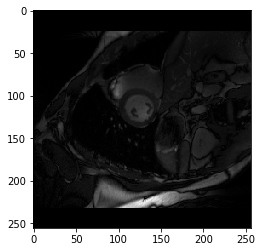

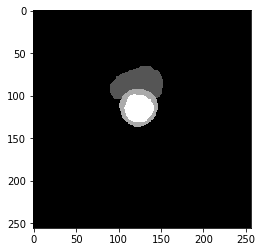

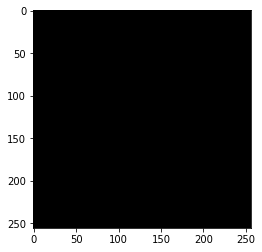

best performance: dice 0.93, idx 48


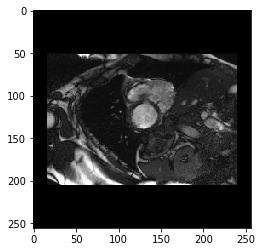

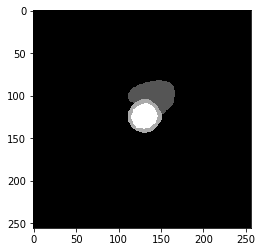

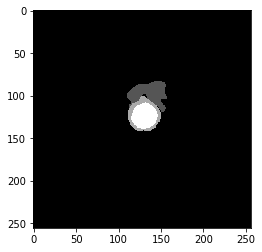

----------

EPOCH 86 of 140

Training Loss: 3.1175
0 Class, True Pos 57601820.0, False Pos 286656.0, False Neg 130020.0, Dice score 1.00
1 Class, True Pos 438025.0, False Pos 103413.0, False Neg 144747.0, Dice score 0.78
2 Class, True Pos 501257.0, False Pos 111441.0, False Neg 161036.0, Dice score 0.79
3 Class, True Pos 569888.0, False Pos 25259.0, False Neg 90966.0, Dice score 0.91
----------
Vaildation Loss: 5.1430
0 Class, True Pos 62862560.0, False Pos 395326.0, False Neg 205893.0, Dice score 1.00
1 Class, True Pos 451120.0, False Pos 161500.0, False Neg 179806.0, Dice score 0.73
2 Class, True Pos 475083.0, False Pos 116809.0, False Neg 192842.0, Dice score 0.75
3 Class, True Pos 523560.0, False Pos 25750.0, False Neg 120844.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


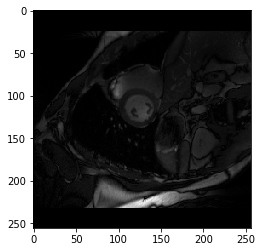

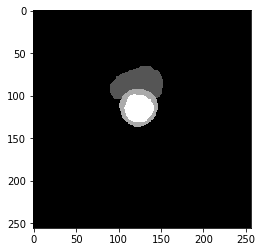

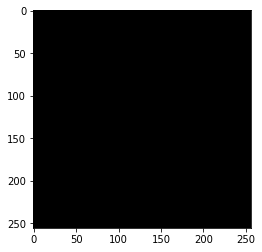

best performance: dice 0.93, idx 48


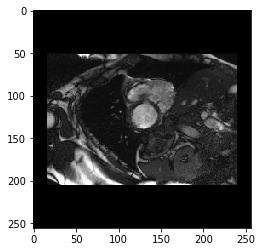

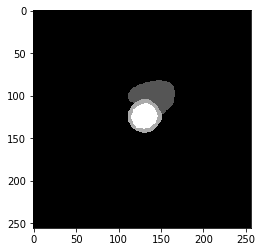

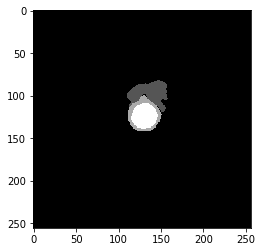

----------

EPOCH 87 of 140

Training Loss: 3.0675
0 Class, True Pos 57607048.0, False Pos 272307.0, False Neg 134250.0, Dice score 1.00
1 Class, True Pos 448332.0, False Pos 103445.0, False Neg 152323.0, Dice score 0.78
2 Class, True Pos 500246.0, False Pos 109645.0, False Neg 144665.0, Dice score 0.80
3 Class, True Pos 570107.0, False Pos 26631.0, False Neg 80790.0, Dice score 0.91
----------
Vaildation Loss: 5.4124
0 Class, True Pos 62904576.0, False Pos 452426.0, False Neg 163878.0, Dice score 1.00
1 Class, True Pos 434269.0, False Pos 131334.0, False Neg 196657.0, Dice score 0.73
2 Class, True Pos 451987.0, False Pos 101939.0, False Neg 215938.0, Dice score 0.74
3 Class, True Pos 511954.0, False Pos 23224.0, False Neg 132450.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


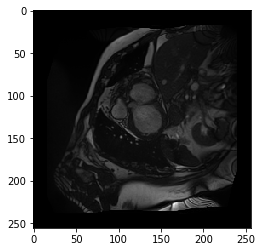

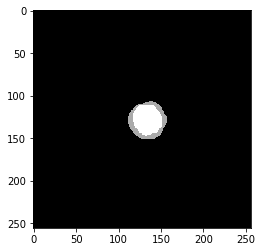

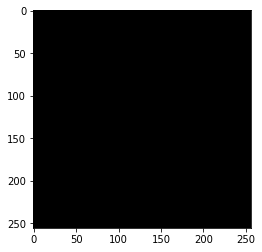

best performance: dice 0.93, idx 48


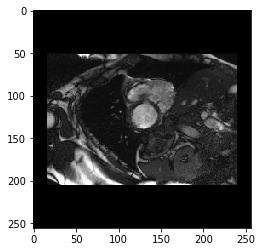

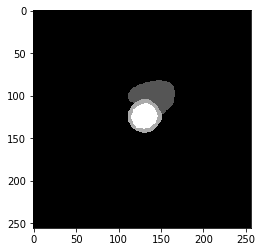

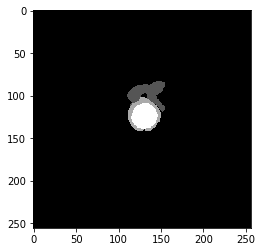

----------

EPOCH 88 of 140

Training Loss: 3.1245
0 Class, True Pos 57576508.0, False Pos 283484.0, False Neg 130940.0, Dice score 1.00
1 Class, True Pos 442541.0, False Pos 109181.0, False Neg 161369.0, Dice score 0.77
2 Class, True Pos 507977.0, False Pos 111643.0, False Neg 156065.0, Dice score 0.79
3 Class, True Pos 579940.0, False Pos 26476.0, False Neg 82410.0, Dice score 0.91
----------
Vaildation Loss: 5.2993
0 Class, True Pos 62900672.0, False Pos 437609.0, False Neg 167784.0, Dice score 1.00
1 Class, True Pos 437074.0, False Pos 133171.0, False Neg 193852.0, Dice score 0.73
2 Class, True Pos 457268.0, False Pos 103763.0, False Neg 210657.0, Dice score 0.74
3 Class, True Pos 517795.0, False Pos 24359.0, False Neg 126609.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


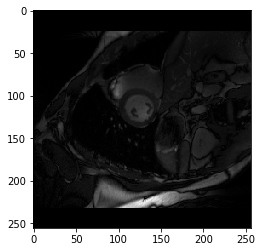

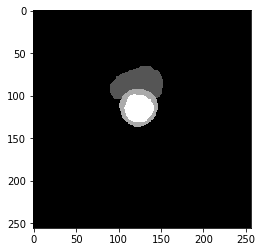

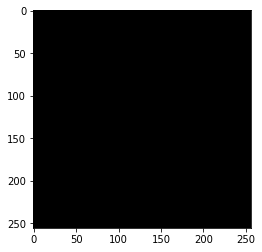

best performance: dice 0.93, idx 48


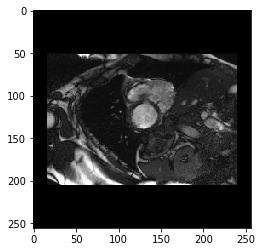

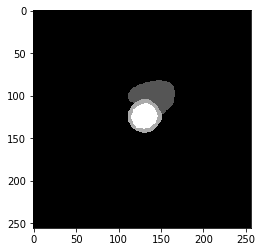

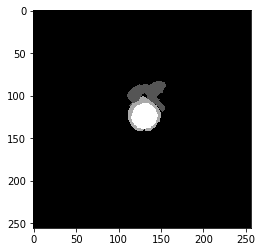

----------

EPOCH 89 of 140

Training Loss: 3.0323
0 Class, True Pos 57648840.0, False Pos 258849.0, False Neg 127329.0, Dice score 1.00
1 Class, True Pos 438776.0, False Pos 96302.0, False Neg 140209.0, Dice score 0.79
2 Class, True Pos 497572.0, False Pos 106492.0, False Neg 146006.0, Dice score 0.80
3 Class, True Pos 562560.0, False Pos 28373.0, False Neg 76472.0, Dice score 0.91
----------
Vaildation Loss: 5.1163
0 Class, True Pos 62859792.0, False Pos 388767.0, False Neg 208670.0, Dice score 1.00
1 Class, True Pos 455934.0, False Pos 171692.0, False Neg 174992.0, Dice score 0.72
2 Class, True Pos 475288.0, False Pos 116071.0, False Neg 192637.0, Dice score 0.75
3 Class, True Pos 520840.0, False Pos 23333.0, False Neg 123564.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


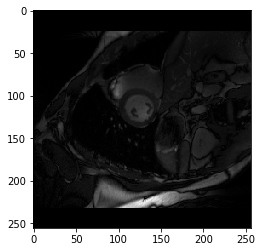

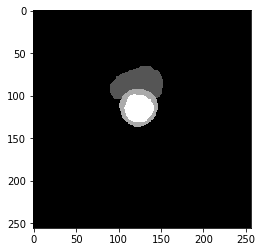

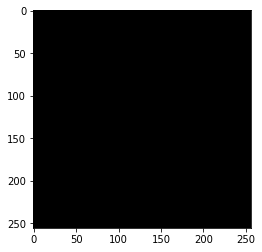

best performance: dice 0.93, idx 48


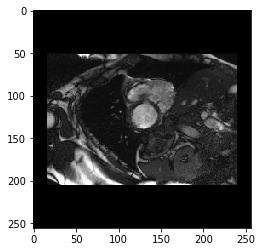

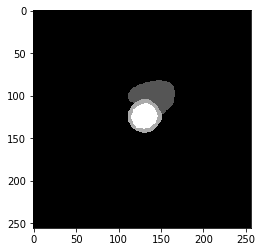

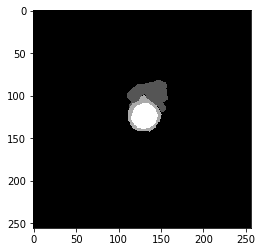

----------

EPOCH 90 of 140

Training Loss: 3.1725
0 Class, True Pos 57570284.0, False Pos 296147.0, False Neg 133102.0, Dice score 1.00
1 Class, True Pos 443832.0, False Pos 106948.0, False Neg 163988.0, Dice score 0.77
2 Class, True Pos 503642.0, False Pos 115288.0, False Neg 161994.0, Dice score 0.78
3 Class, True Pos 574400.0, False Pos 27222.0, False Neg 86521.0, Dice score 0.91
----------
Vaildation Loss: 5.1414
0 Class, True Pos 62880384.0, False Pos 402252.0, False Neg 188075.0, Dice score 1.00
1 Class, True Pos 447984.0, False Pos 150476.0, False Neg 182942.0, Dice score 0.73
2 Class, True Pos 474126.0, False Pos 115696.0, False Neg 193799.0, Dice score 0.75
3 Class, True Pos 518515.0, False Pos 22281.0, False Neg 125889.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


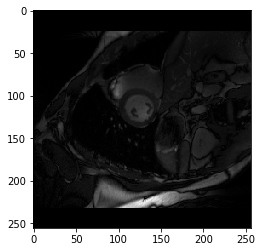

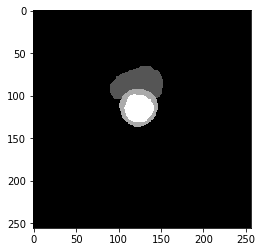

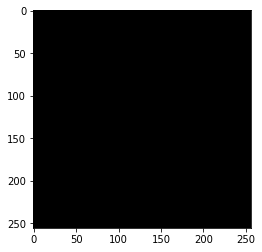

best performance: dice 0.93, idx 48


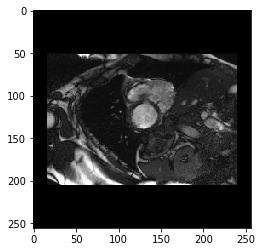

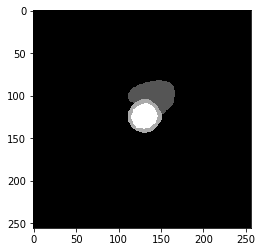

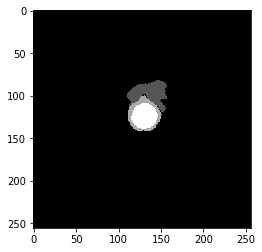

----------

EPOCH 91 of 140

Training Loss: 3.1567
0 Class, True Pos 57605264.0, False Pos 276877.0, False Neg 134597.0, Dice score 1.00
1 Class, True Pos 436585.0, False Pos 107633.0, False Neg 157533.0, Dice score 0.77
2 Class, True Pos 502111.0, False Pos 111756.0, False Neg 146508.0, Dice score 0.80
3 Class, True Pos 569146.0, False Pos 28393.0, False Neg 86021.0, Dice score 0.91
----------
Vaildation Loss: 4.9901
0 Class, True Pos 62851432.0, False Pos 368562.0, False Neg 217034.0, Dice score 1.00
1 Class, True Pos 461148.0, False Pos 174270.0, False Neg 169778.0, Dice score 0.73
2 Class, True Pos 479541.0, False Pos 118899.0, False Neg 188384.0, Dice score 0.76
3 Class, True Pos 530388.0, False Pos 27481.0, False Neg 114016.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


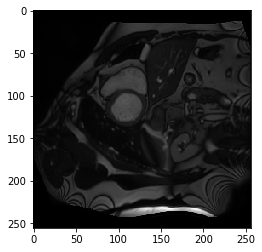

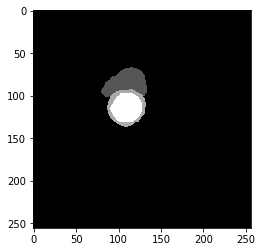

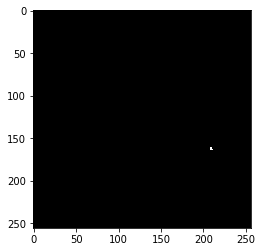

best performance: dice 0.93, idx 48


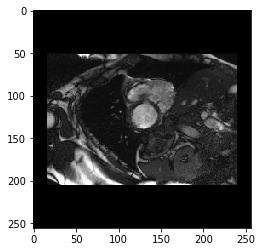

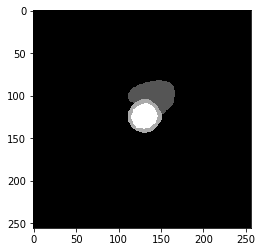

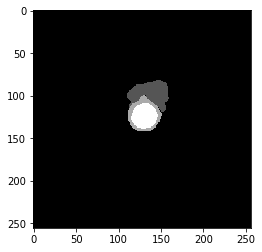

----------

EPOCH 92 of 140

Training Loss: 3.0061
0 Class, True Pos 57612152.0, False Pos 273008.0, False Neg 129225.0, Dice score 1.00
1 Class, True Pos 449965.0, False Pos 99729.0, False Neg 149482.0, Dice score 0.78
2 Class, True Pos 497944.0, False Pos 110633.0, False Neg 149131.0, Dice score 0.79
3 Class, True Pos 569010.0, False Pos 25316.0, False Neg 80848.0, Dice score 0.91
----------
Vaildation Loss: 5.3698
0 Class, True Pos 62886072.0, False Pos 438406.0, False Neg 182382.0, Dice score 1.00
1 Class, True Pos 435972.0, False Pos 137418.0, False Neg 194954.0, Dice score 0.72
2 Class, True Pos 462046.0, False Pos 112052.0, False Neg 205879.0, Dice score 0.74
3 Class, True Pos 515325.0, False Pos 24418.0, False Neg 129079.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


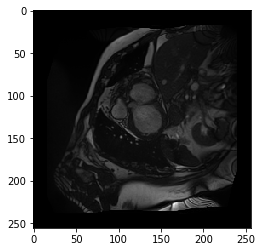

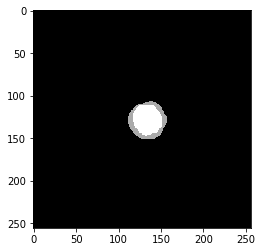

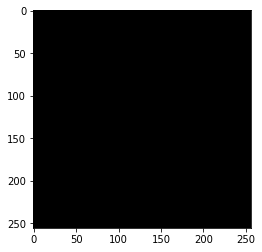

best performance: dice 0.92, idx 48


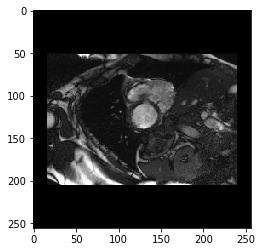

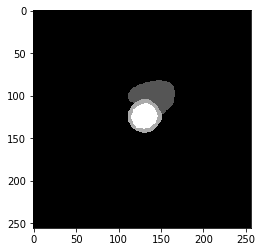

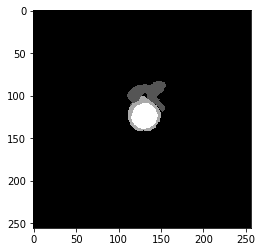

----------

EPOCH 93 of 140

Training Loss: 3.0943
0 Class, True Pos 57571480.0, False Pos 290707.0, False Neg 135798.0, Dice score 1.00
1 Class, True Pos 449773.0, False Pos 104505.0, False Neg 158530.0, Dice score 0.77
2 Class, True Pos 506692.0, False Pos 112482.0, False Neg 157884.0, Dice score 0.79
3 Class, True Pos 574249.0, False Pos 27874.0, False Neg 83356.0, Dice score 0.91
----------
Vaildation Loss: 4.9972
0 Class, True Pos 62840072.0, False Pos 367783.0, False Neg 228387.0, Dice score 1.00
1 Class, True Pos 462698.0, False Pos 187315.0, False Neg 168228.0, Dice score 0.72
2 Class, True Pos 477897.0, False Pos 117090.0, False Neg 190028.0, Dice score 0.76
3 Class, True Pos 531362.0, False Pos 27497.0, False Neg 113042.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


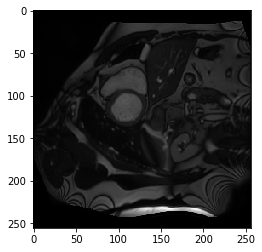

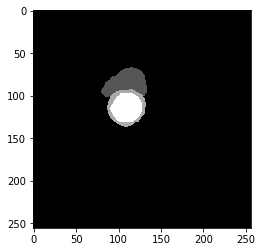

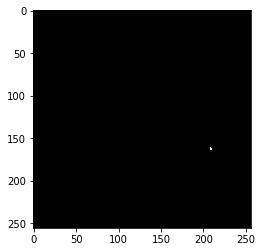

best performance: dice 0.93, idx 48


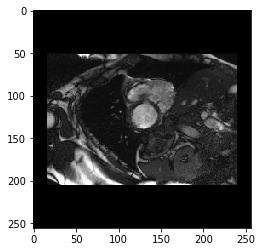

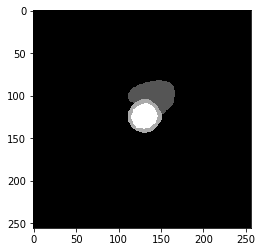

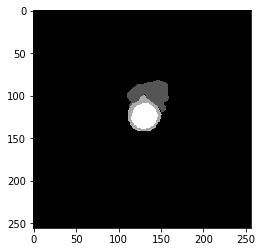

----------

EPOCH 94 of 140

Training Loss: 3.1108
0 Class, True Pos 57616628.0, False Pos 272376.0, False Neg 130641.0, Dice score 1.00
1 Class, True Pos 441505.0, False Pos 105664.0, False Neg 145430.0, Dice score 0.78
2 Class, True Pos 501554.0, False Pos 110017.0, False Neg 153539.0, Dice score 0.79
3 Class, True Pos 562337.0, False Pos 27680.0, False Neg 86127.0, Dice score 0.91
----------
Vaildation Loss: 5.2532
0 Class, True Pos 62866700.0, False Pos 414485.0, False Neg 201749.0, Dice score 1.00
1 Class, True Pos 447239.0, False Pos 161033.0, False Neg 183687.0, Dice score 0.72
2 Class, True Pos 467408.0, False Pos 111412.0, False Neg 200517.0, Dice score 0.75
3 Class, True Pos 519037.0, False Pos 24390.0, False Neg 125367.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


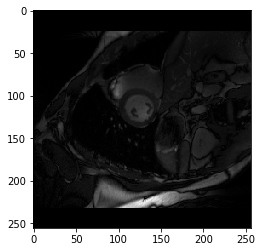

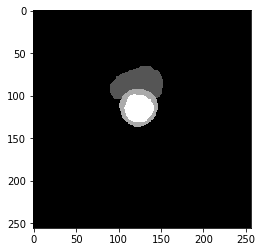

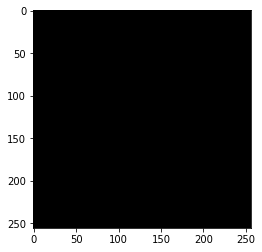

best performance: dice 0.93, idx 48


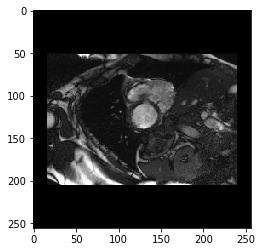

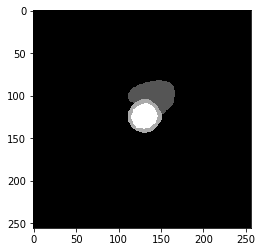

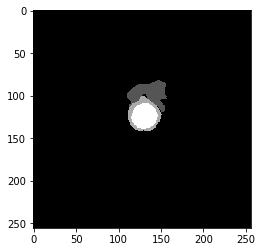

----------

EPOCH 95 of 140

Training Loss: 3.0015
0 Class, True Pos 57586632.0, False Pos 269391.0, False Neg 135269.0, Dice score 1.00
1 Class, True Pos 460737.0, False Pos 103031.0, False Neg 146145.0, Dice score 0.79
2 Class, True Pos 503527.0, False Pos 113704.0, False Neg 151561.0, Dice score 0.79
3 Class, True Pos 575303.0, False Pos 25439.0, False Neg 78590.0, Dice score 0.92
----------
Vaildation Loss: 5.1770
0 Class, True Pos 62894348.0, False Pos 416121.0, False Neg 174110.0, Dice score 1.00
1 Class, True Pos 442439.0, False Pos 139554.0, False Neg 188487.0, Dice score 0.73
2 Class, True Pos 465308.0, False Pos 108503.0, False Neg 202617.0, Dice score 0.75
3 Class, True Pos 521207.0, False Pos 24233.0, False Neg 123197.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


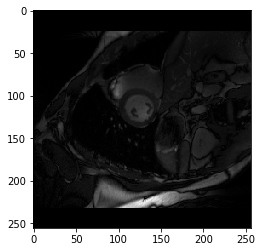

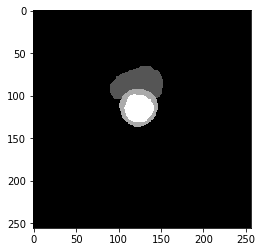

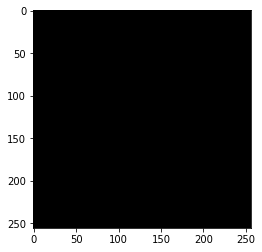

best performance: dice 0.93, idx 48


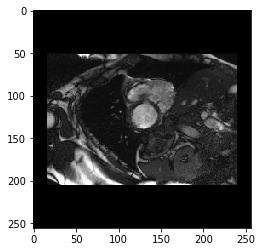

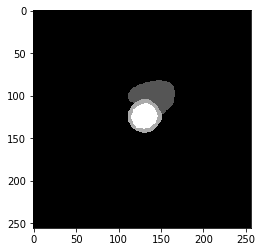

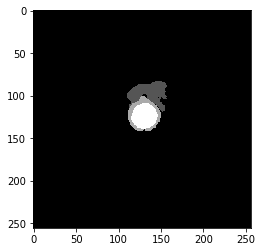

----------

EPOCH 96 of 140

Training Loss: 3.0701
0 Class, True Pos 57627424.0, False Pos 258275.0, False Neg 126385.0, Dice score 1.00
1 Class, True Pos 442480.0, False Pos 100058.0, False Neg 154898.0, Dice score 0.78
2 Class, True Pos 502422.0, False Pos 111159.0, False Neg 137986.0, Dice score 0.80
3 Class, True Pos 568284.0, False Pos 27653.0, False Neg 77876.0, Dice score 0.92
----------
Vaildation Loss: 5.1395
0 Class, True Pos 62865068.0, False Pos 395934.0, False Neg 203379.0, Dice score 1.00
1 Class, True Pos 455329.0, False Pos 170706.0, False Neg 175597.0, Dice score 0.72
2 Class, True Pos 467940.0, False Pos 110493.0, False Neg 199985.0, Dice score 0.75
3 Class, True Pos 521862.0, False Pos 24370.0, False Neg 122542.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


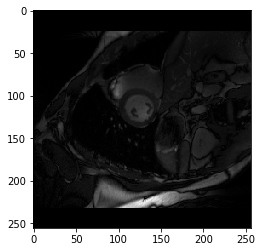

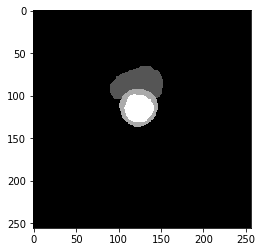

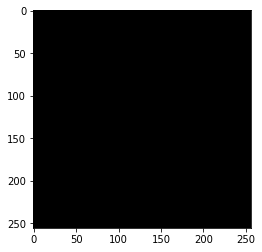

best performance: dice 0.93, idx 39


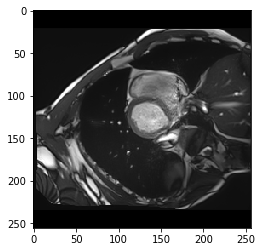

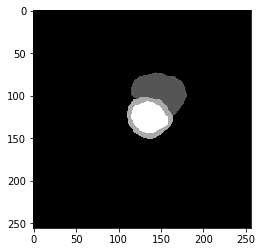

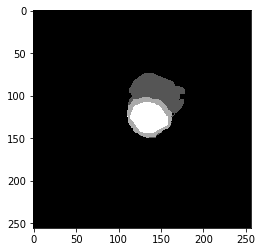

----------

EPOCH 97 of 140

Training Loss: 3.1353
0 Class, True Pos 57600052.0, False Pos 275668.0, False Neg 128789.0, Dice score 1.00
1 Class, True Pos 432988.0, False Pos 104611.0, False Neg 158449.0, Dice score 0.77
2 Class, True Pos 503967.0, False Pos 113285.0, False Neg 153831.0, Dice score 0.79
3 Class, True Pos 578960.0, False Pos 28228.0, False Neg 80723.0, Dice score 0.91
----------
Vaildation Loss: 5.3012
0 Class, True Pos 62836716.0, False Pos 403705.0, False Neg 231748.0, Dice score 0.99
1 Class, True Pos 456541.0, False Pos 185267.0, False Neg 174385.0, Dice score 0.72
2 Class, True Pos 467663.0, False Pos 115194.0, False Neg 200262.0, Dice score 0.75
3 Class, True Pos 520172.0, False Pos 26461.0, False Neg 124232.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


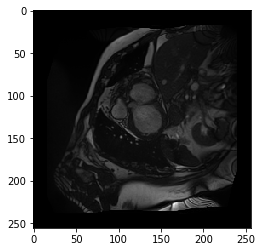

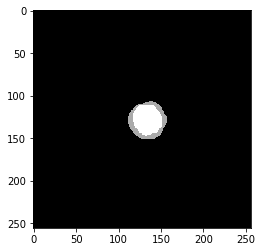

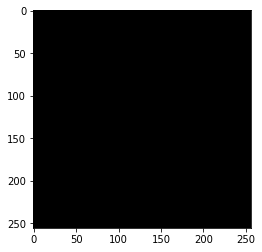

best performance: dice 0.93, idx 48


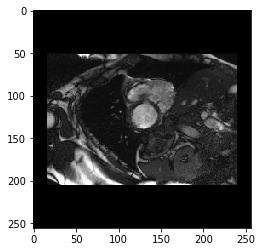

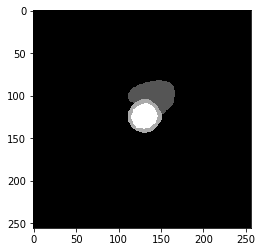

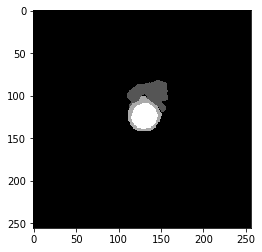

----------

EPOCH 98 of 140

Training Loss: 3.0899
0 Class, True Pos 57625240.0, False Pos 275290.0, False Neg 128546.0, Dice score 1.00
1 Class, True Pos 440662.0, False Pos 96830.0, False Neg 141530.0, Dice score 0.79
2 Class, True Pos 498103.0, False Pos 108086.0, False Neg 150200.0, Dice score 0.79
3 Class, True Pos 567406.0, False Pos 26148.0, False Neg 86078.0, Dice score 0.91
----------
Vaildation Loss: 5.1760
0 Class, True Pos 62870052.0, False Pos 403162.0, False Neg 198413.0, Dice score 1.00
1 Class, True Pos 454958.0, False Pos 170064.0, False Neg 175968.0, Dice score 0.72
2 Class, True Pos 462224.0, False Pos 105639.0, False Neg 205701.0, Dice score 0.75
3 Class, True Pos 521249.0, False Pos 24372.0, False Neg 123155.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


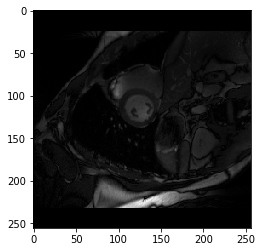

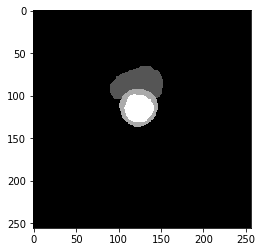

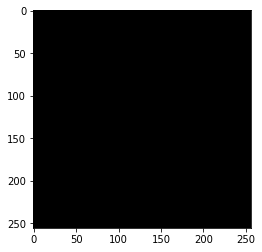

best performance: dice 0.93, idx 39


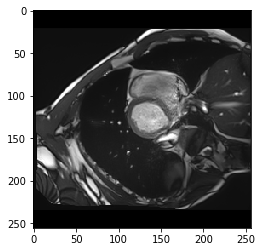

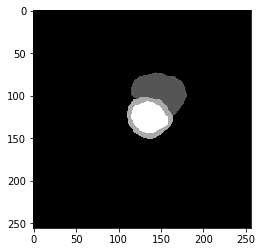

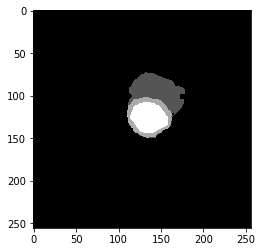

----------

EPOCH 99 of 140

Training Loss: 3.1825
0 Class, True Pos 57601292.0, False Pos 265851.0, False Neg 144374.0, Dice score 1.00
1 Class, True Pos 445333.0, False Pos 108320.0, False Neg 146361.0, Dice score 0.78
2 Class, True Pos 502753.0, False Pos 117124.0, False Neg 150470.0, Dice score 0.79
3 Class, True Pos 565888.0, False Pos 31202.0, False Neg 81292.0, Dice score 0.91
----------
Vaildation Loss: 4.9719
0 Class, True Pos 62876420.0, False Pos 381284.0, False Neg 192043.0, Dice score 1.00
1 Class, True Pos 453073.0, False Pos 155974.0, False Neg 177853.0, Dice score 0.73
2 Class, True Pos 476833.0, False Pos 114272.0, False Neg 191092.0, Dice score 0.76
3 Class, True Pos 528422.0, False Pos 25440.0, False Neg 115982.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


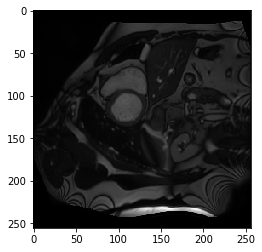

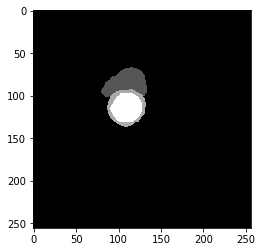

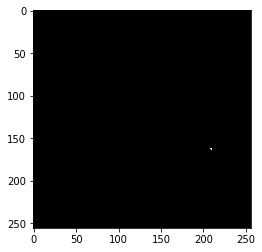

best performance: dice 0.93, idx 48


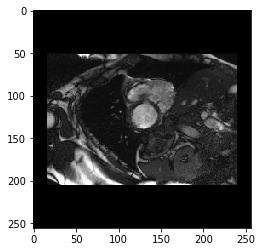

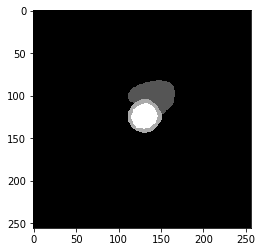

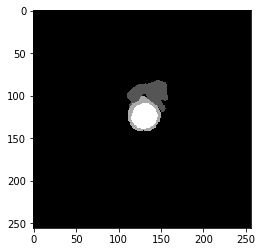

----------

EPOCH 100 of 140

Training Loss: 3.1115
0 Class, True Pos 57606408.0, False Pos 280698.0, False Neg 134566.0, Dice score 1.00
1 Class, True Pos 438452.0, False Pos 100446.0, False Neg 150339.0, Dice score 0.78
2 Class, True Pos 502028.0, False Pos 113444.0, False Neg 155414.0, Dice score 0.79
3 Class, True Pos 567287.0, False Pos 28990.0, False Neg 83259.0, Dice score 0.91
----------
Vaildation Loss: 5.5696
0 Class, True Pos 62902756.0, False Pos 466758.0, False Neg 165708.0, Dice score 0.99
1 Class, True Pos 428069.0, False Pos 126181.0, False Neg 202857.0, Dice score 0.72
2 Class, True Pos 450348.0, False Pos 109116.0, False Neg 217577.0, Dice score 0.73
3 Class, True Pos 505385.0, False Pos 23106.0, False Neg 139019.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


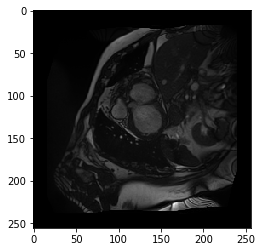

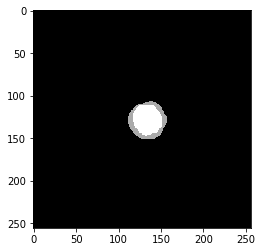

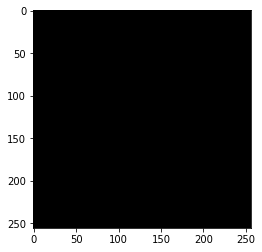

best performance: dice 0.92, idx 48


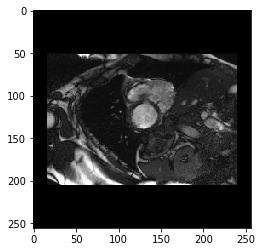

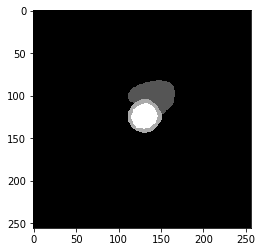

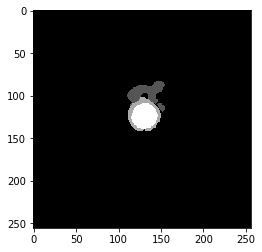

----------

EPOCH 101 of 140

Training Loss: 3.1661
0 Class, True Pos 57613752.0, False Pos 286233.0, False Neg 127425.0, Dice score 1.00
1 Class, True Pos 427127.0, False Pos 105510.0, False Neg 163847.0, Dice score 0.76
2 Class, True Pos 498066.0, False Pos 112870.0, False Neg 153975.0, Dice score 0.79
3 Class, True Pos 569361.0, False Pos 24838.0, False Neg 84204.0, Dice score 0.91
----------
Vaildation Loss: 5.3946
0 Class, True Pos 62882904.0, False Pos 437019.0, False Neg 185552.0, Dice score 1.00
1 Class, True Pos 441013.0, False Pos 146069.0, False Neg 189913.0, Dice score 0.72
2 Class, True Pos 460393.0, False Pos 109233.0, False Neg 207532.0, Dice score 0.74
3 Class, True Pos 511642.0, False Pos 23438.0, False Neg 132762.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


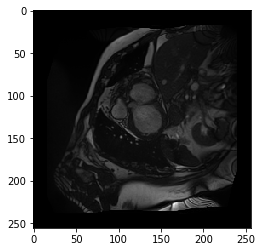

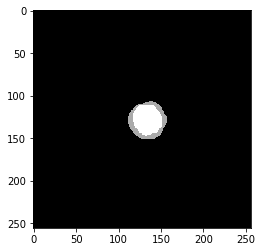

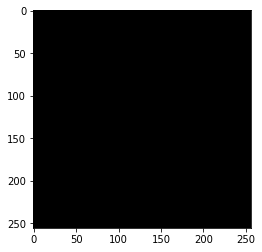

best performance: dice 0.93, idx 48


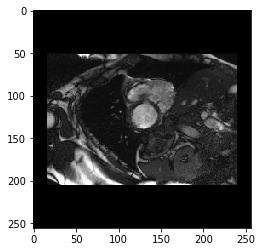

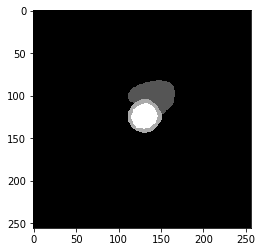

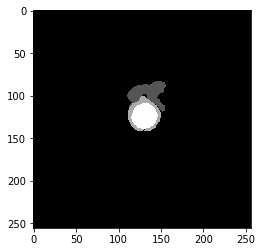

----------

EPOCH 102 of 140

Training Loss: 3.0333
0 Class, True Pos 57605944.0, False Pos 263017.0, False Neg 132701.0, Dice score 1.00
1 Class, True Pos 457629.0, False Pos 102273.0, False Neg 141674.0, Dice score 0.79
2 Class, True Pos 506161.0, False Pos 108694.0, False Neg 144423.0, Dice score 0.80
3 Class, True Pos 567162.0, False Pos 26876.0, False Neg 82062.0, Dice score 0.91
----------
Vaildation Loss: 5.0671
0 Class, True Pos 62845024.0, False Pos 378219.0, False Neg 223432.0, Dice score 1.00
1 Class, True Pos 463124.0, False Pos 188360.0, False Neg 167802.0, Dice score 0.72
2 Class, True Pos 467552.0, False Pos 108969.0, False Neg 200373.0, Dice score 0.75
3 Class, True Pos 531376.0, False Pos 29087.0, False Neg 113028.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


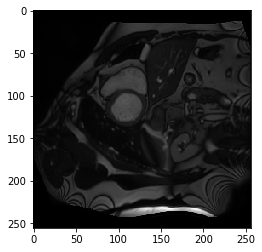

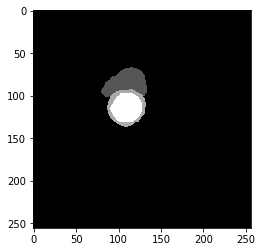

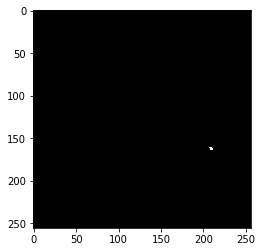

best performance: dice 0.92, idx 48


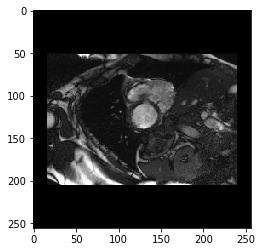

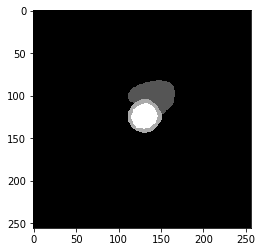

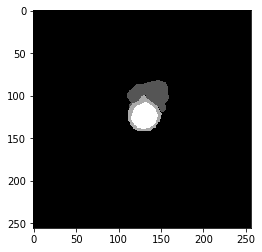

----------

EPOCH 103 of 140

Training Loss: 3.1733
0 Class, True Pos 57607992.0, False Pos 272991.0, False Neg 142174.0, Dice score 1.00
1 Class, True Pos 434046.0, False Pos 107932.0, False Neg 159000.0, Dice score 0.76
2 Class, True Pos 502544.0, False Pos 117465.0, False Neg 146944.0, Dice score 0.79
3 Class, True Pos 565105.0, False Pos 29683.0, False Neg 79953.0, Dice score 0.91
----------
Vaildation Loss: 4.9195
0 Class, True Pos 62800192.0, False Pos 339275.0, False Neg 268262.0, Dice score 1.00
1 Class, True Pos 476803.0, False Pos 228861.0, False Neg 154123.0, Dice score 0.71
2 Class, True Pos 480029.0, False Pos 115137.0, False Neg 187896.0, Dice score 0.76
3 Class, True Pos 539701.0, False Pos 31711.0, False Neg 104703.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


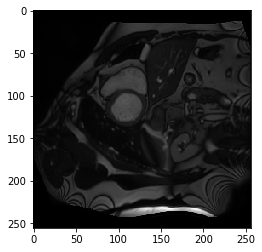

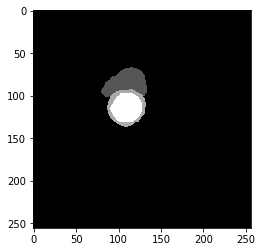

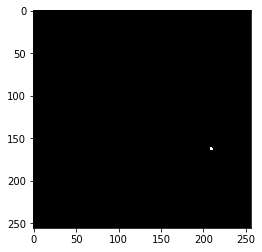

best performance: dice 0.92, idx 31


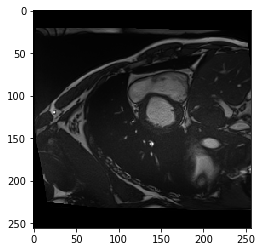

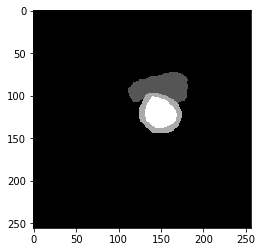

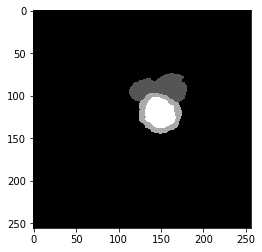

----------

EPOCH 104 of 140

Training Loss: 3.1126
0 Class, True Pos 57604676.0, False Pos 280062.0, False Neg 132407.0, Dice score 1.00
1 Class, True Pos 444409.0, False Pos 103906.0, False Neg 151980.0, Dice score 0.78
2 Class, True Pos 500126.0, False Pos 113788.0, False Neg 153263.0, Dice score 0.79
3 Class, True Pos 565044.0, False Pos 25754.0, False Neg 85860.0, Dice score 0.91
----------
Vaildation Loss: 5.3027
0 Class, True Pos 62904616.0, False Pos 441005.0, False Neg 163843.0, Dice score 1.00
1 Class, True Pos 436495.0, False Pos 134937.0, False Neg 194431.0, Dice score 0.73
2 Class, True Pos 454344.0, False Pos 100194.0, False Neg 213581.0, Dice score 0.74
3 Class, True Pos 516581.0, False Pos 23542.0, False Neg 127823.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


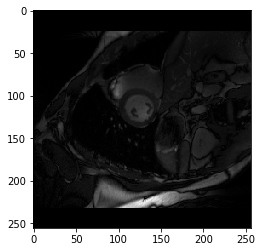

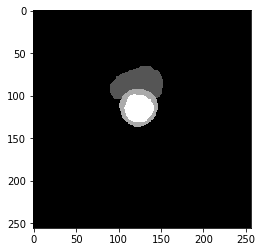

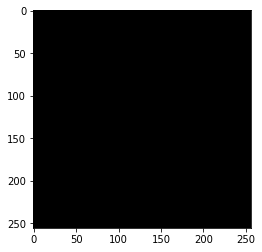

best performance: dice 0.93, idx 48


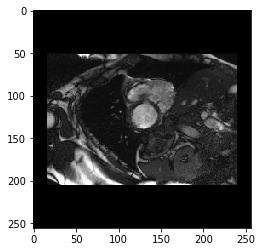

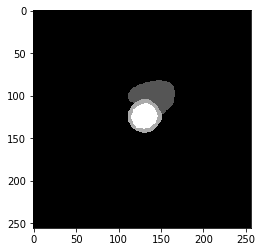

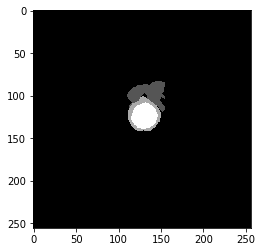

----------

EPOCH 105 of 140

Training Loss: 3.2136
0 Class, True Pos 57601560.0, False Pos 305066.0, False Neg 129964.0, Dice score 1.00
1 Class, True Pos 437699.0, False Pos 102320.0, False Neg 164615.0, Dice score 0.77
2 Class, True Pos 494997.0, False Pos 113304.0, False Neg 159221.0, Dice score 0.78
3 Class, True Pos 556927.0, False Pos 25877.0, False Neg 92767.0, Dice score 0.90
----------
Vaildation Loss: 4.9234
0 Class, True Pos 62824968.0, False Pos 348678.0, False Neg 243492.0, Dice score 1.00
1 Class, True Pos 469296.0, False Pos 200816.0, False Neg 161630.0, Dice score 0.72
2 Class, True Pos 484046.0, False Pos 119618.0, False Neg 183879.0, Dice score 0.76
3 Class, True Pos 535347.0, False Pos 28946.0, False Neg 109057.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


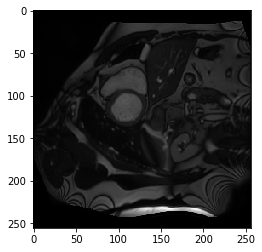

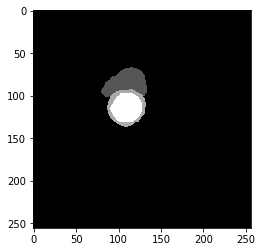

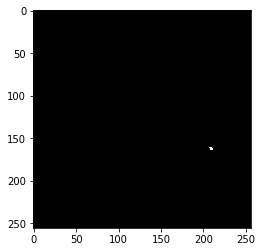

best performance: dice 0.93, idx 48


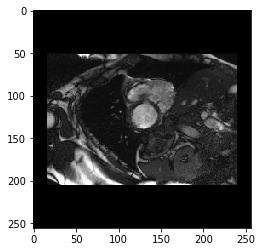

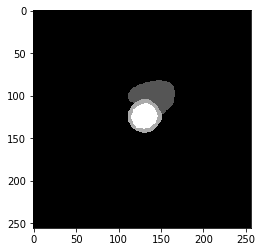

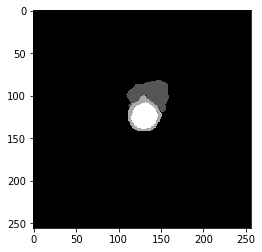

----------

EPOCH 106 of 140

Training Loss: 3.1197
0 Class, True Pos 57633784.0, False Pos 260683.0, False Neg 130752.0, Dice score 1.00
1 Class, True Pos 435134.0, False Pos 100251.0, False Neg 151625.0, Dice score 0.78
2 Class, True Pos 499532.0, False Pos 114488.0, False Neg 141601.0, Dice score 0.80
3 Class, True Pos 567953.0, False Pos 25936.0, False Neg 77380.0, Dice score 0.92
----------
Vaildation Loss: 5.3029
0 Class, True Pos 62874320.0, False Pos 419508.0, False Neg 194137.0, Dice score 1.00
1 Class, True Pos 444399.0, False Pos 151244.0, False Neg 186527.0, Dice score 0.72
2 Class, True Pos 466833.0, False Pos 114133.0, False Neg 201092.0, Dice score 0.75
3 Class, True Pos 516594.0, False Pos 24681.0, False Neg 127810.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


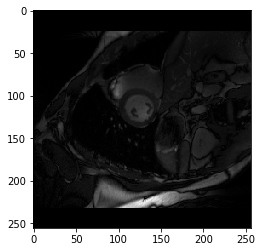

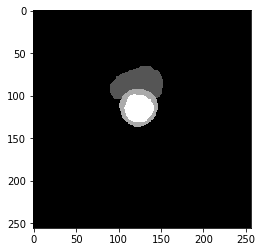

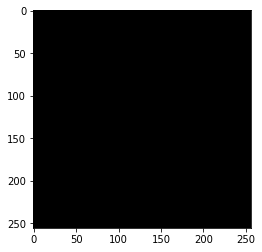

best performance: dice 0.93, idx 48


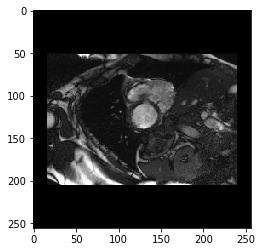

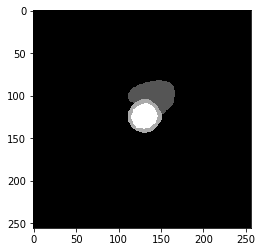

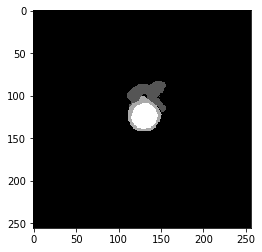

----------

EPOCH 107 of 140

Training Loss: 3.0693
0 Class, True Pos 57605132.0, False Pos 274299.0, False Neg 129948.0, Dice score 1.00
1 Class, True Pos 439796.0, False Pos 103172.0, False Neg 147161.0, Dice score 0.78
2 Class, True Pos 507364.0, False Pos 110305.0, False Neg 152415.0, Dice score 0.79
3 Class, True Pos 569602.0, False Pos 28094.0, False Neg 86346.0, Dice score 0.91
----------
Vaildation Loss: 5.4366
0 Class, True Pos 62913268.0, False Pos 458361.0, False Neg 155190.0, Dice score 1.00
1 Class, True Pos 430258.0, False Pos 126059.0, False Neg 200668.0, Dice score 0.72
2 Class, True Pos 453573.0, False Pos 103421.0, False Neg 214352.0, Dice score 0.74
3 Class, True Pos 506388.0, False Pos 20385.0, False Neg 138016.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


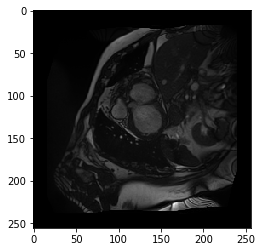

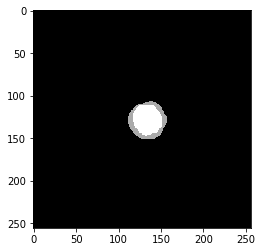

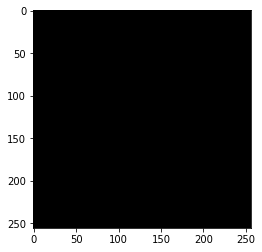

best performance: dice 0.93, idx 48


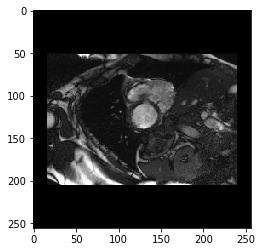

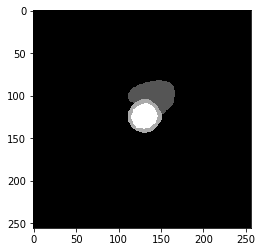

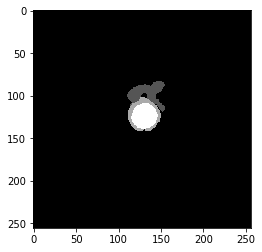

----------

EPOCH 108 of 140

Training Loss: 3.1551
0 Class, True Pos 57592584.0, False Pos 276274.0, False Neg 133593.0, Dice score 1.00
1 Class, True Pos 444903.0, False Pos 104644.0, False Neg 155323.0, Dice score 0.77
2 Class, True Pos 504308.0, False Pos 115151.0, False Neg 150983.0, Dice score 0.79
3 Class, True Pos 573073.0, False Pos 26817.0, False Neg 82987.0, Dice score 0.91
----------
Vaildation Loss: 5.4231
0 Class, True Pos 62906928.0, False Pos 455934.0, False Neg 161533.0, Dice score 1.00
1 Class, True Pos 435666.0, False Pos 133597.0, False Neg 195260.0, Dice score 0.73
2 Class, True Pos 451099.0, False Pos 100165.0, False Neg 216826.0, Dice score 0.74
3 Class, True Pos 507707.0, False Pos 20620.0, False Neg 136697.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


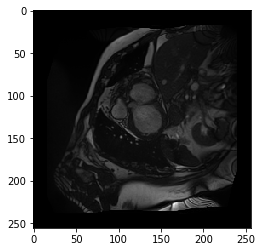

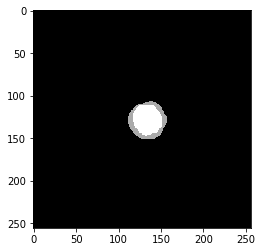

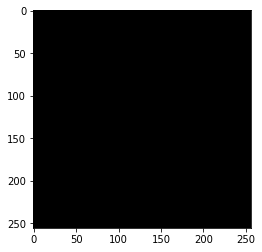

best performance: dice 0.93, idx 48


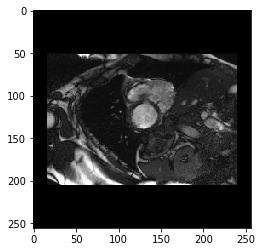

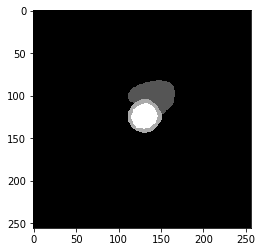

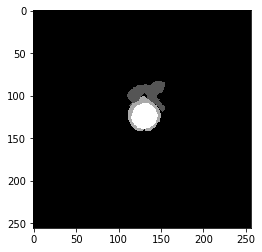

----------

EPOCH 109 of 140

Training Loss: 3.1561
0 Class, True Pos 57575540.0, False Pos 302530.0, False Neg 132973.0, Dice score 1.00
1 Class, True Pos 429638.0, False Pos 113789.0, False Neg 178809.0, Dice score 0.75
2 Class, True Pos 508132.0, False Pos 109074.0, False Neg 154088.0, Dice score 0.79
3 Class, True Pos 571351.0, False Pos 27707.0, False Neg 87230.0, Dice score 0.91
----------
Vaildation Loss: 5.3602
0 Class, True Pos 62892384.0, False Pos 436687.0, False Neg 176075.0, Dice score 1.00
1 Class, True Pos 439561.0, False Pos 139271.0, False Neg 191365.0, Dice score 0.73
2 Class, True Pos 462955.0, False Pos 111485.0, False Neg 204970.0, Dice score 0.75
3 Class, True Pos 508517.0, False Pos 20854.0, False Neg 135887.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


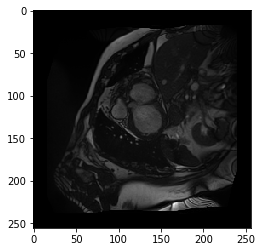

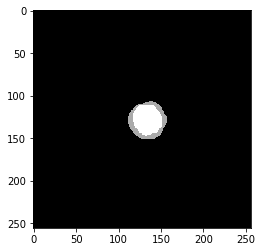

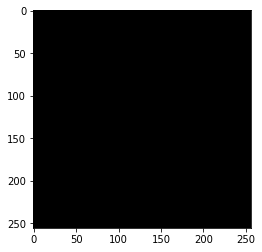

best performance: dice 0.93, idx 48


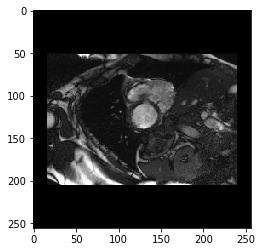

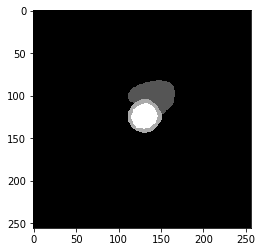

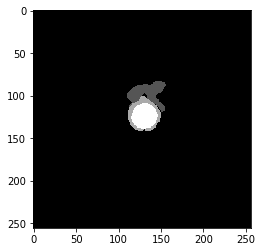

----------

EPOCH 110 of 140

Training Loss: 3.2344
0 Class, True Pos 57632148.0, False Pos 258257.0, False Neg 146676.0, Dice score 1.00
1 Class, True Pos 428540.0, False Pos 111624.0, False Neg 146649.0, Dice score 0.77
2 Class, True Pos 497835.0, False Pos 115544.0, False Neg 142979.0, Dice score 0.79
3 Class, True Pos 561979.0, False Pos 31827.0, False Neg 80948.0, Dice score 0.91
----------
Vaildation Loss: 5.0487
0 Class, True Pos 62833828.0, False Pos 366259.0, False Neg 234630.0, Dice score 1.00
1 Class, True Pos 465317.0, False Pos 193714.0, False Neg 165609.0, Dice score 0.72
2 Class, True Pos 481178.0, False Pos 120461.0, False Neg 186747.0, Dice score 0.76
3 Class, True Pos 526102.0, False Pos 24854.0, False Neg 118302.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


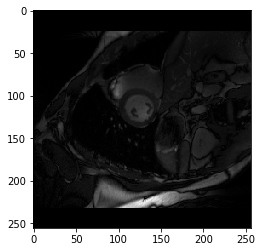

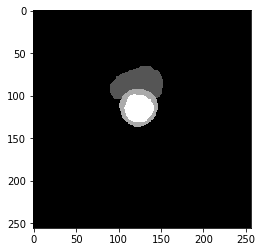

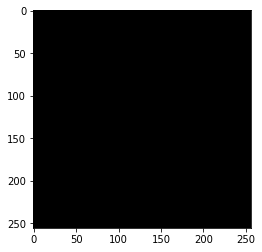

best performance: dice 0.93, idx 48


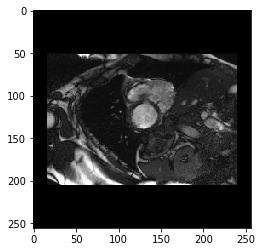

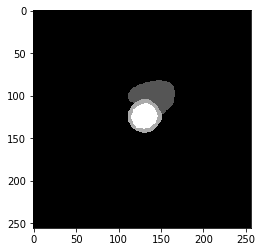

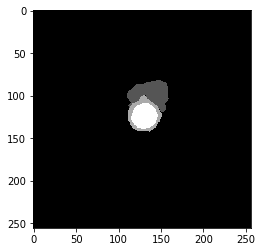

----------

EPOCH 111 of 140

Training Loss: 3.1783
0 Class, True Pos 57604208.0, False Pos 268997.0, False Neg 140598.0, Dice score 1.00
1 Class, True Pos 442804.0, False Pos 108819.0, False Neg 145938.0, Dice score 0.78
2 Class, True Pos 500069.0, False Pos 117241.0, False Neg 154154.0, Dice score 0.79
3 Class, True Pos 566918.0, False Pos 28710.0, False Neg 83077.0, Dice score 0.91
----------
Vaildation Loss: 5.1764
0 Class, True Pos 62881540.0, False Pos 409483.0, False Neg 186916.0, Dice score 1.00
1 Class, True Pos 445199.0, False Pos 146074.0, False Neg 185727.0, Dice score 0.73
2 Class, True Pos 469781.0, False Pos 112719.0, False Neg 198144.0, Dice score 0.75
3 Class, True Pos 521773.0, False Pos 25142.0, False Neg 122631.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


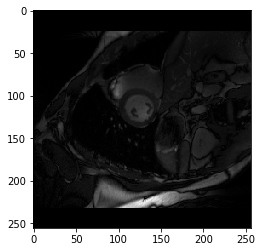

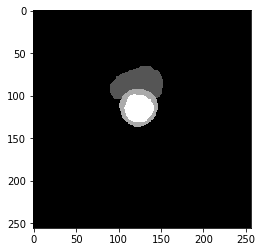

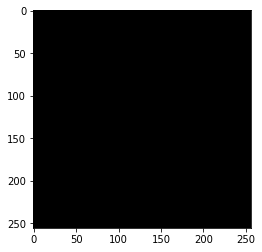

best performance: dice 0.93, idx 48


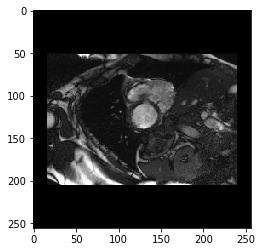

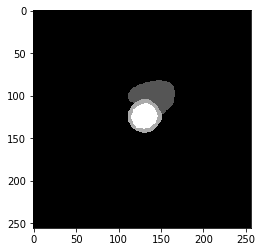

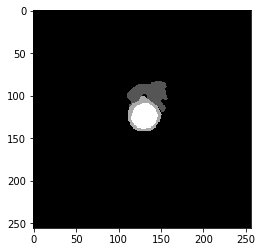

----------

EPOCH 112 of 140

Training Loss: 3.0418
0 Class, True Pos 57611620.0, False Pos 283341.0, False Neg 122283.0, Dice score 1.00
1 Class, True Pos 444830.0, False Pos 97954.0, False Neg 156152.0, Dice score 0.78
2 Class, True Pos 500837.0, False Pos 106890.0, False Neg 150777.0, Dice score 0.80
3 Class, True Pos 565765.0, False Pos 26521.0, False Neg 85494.0, Dice score 0.91
----------
Vaildation Loss: 5.3488
0 Class, True Pos 62874472.0, False Pos 426253.0, False Neg 193984.0, Dice score 1.00
1 Class, True Pos 446199.0, False Pos 154591.0, False Neg 184727.0, Dice score 0.72
2 Class, True Pos 460669.0, False Pos 109175.0, False Neg 207256.0, Dice score 0.74
3 Class, True Pos 515596.0, False Pos 24756.0, False Neg 128808.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


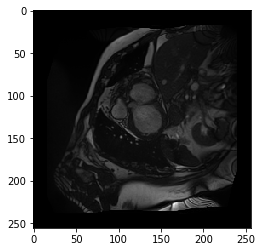

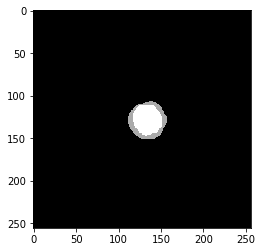

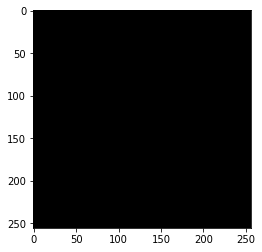

best performance: dice 0.93, idx 48


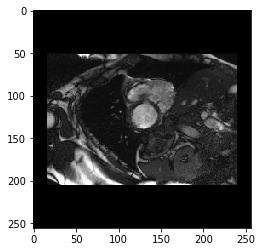

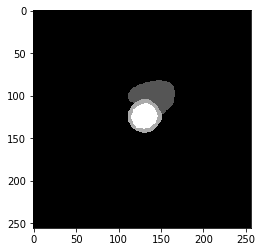

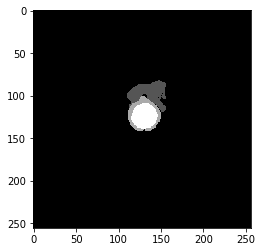

----------

EPOCH 113 of 140

Training Loss: 3.1191
0 Class, True Pos 57582792.0, False Pos 293437.0, False Neg 133526.0, Dice score 1.00
1 Class, True Pos 441644.0, False Pos 103975.0, False Neg 161900.0, Dice score 0.77
2 Class, True Pos 506503.0, False Pos 113226.0, False Neg 153537.0, Dice score 0.79
3 Class, True Pos 567750.0, False Pos 28428.0, False Neg 90103.0, Dice score 0.91
----------
Vaildation Loss: 5.5325
0 Class, True Pos 62901296.0, False Pos 461763.0, False Neg 167162.0, Dice score 1.00
1 Class, True Pos 433436.0, False Pos 134171.0, False Neg 197490.0, Dice score 0.72
2 Class, True Pos 453205.0, False Pos 106061.0, False Neg 214720.0, Dice score 0.74
3 Class, True Pos 501644.0, False Pos 20137.0, False Neg 142760.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


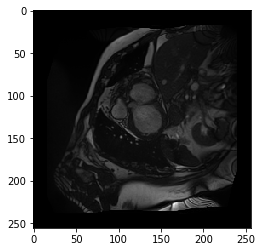

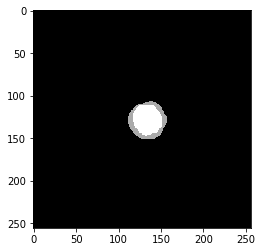

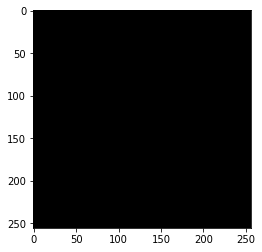

best performance: dice 0.93, idx 48


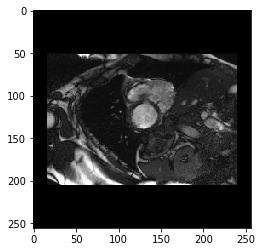

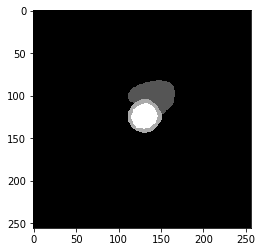

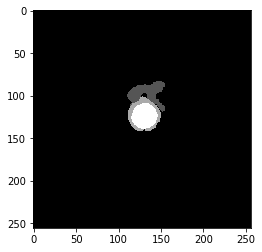

----------

EPOCH 114 of 140

Training Loss: 3.1186
0 Class, True Pos 57580728.0, False Pos 300894.0, False Neg 132627.0, Dice score 1.00
1 Class, True Pos 446831.0, False Pos 101986.0, False Neg 157942.0, Dice score 0.77
2 Class, True Pos 503100.0, False Pos 111085.0, False Neg 147954.0, Dice score 0.80
3 Class, True Pos 566797.0, False Pos 26348.0, False Neg 101790.0, Dice score 0.90
----------
Vaildation Loss: 5.9551
0 Class, True Pos 62932564.0, False Pos 536090.0, False Neg 135900.0, Dice score 0.99
1 Class, True Pos 403780.0, False Pos 97958.0, False Neg 227146.0, Dice score 0.71
2 Class, True Pos 430083.0, False Pos 103311.0, False Neg 237842.0, Dice score 0.72
3 Class, True Pos 489025.0, False Pos 18908.0, False Neg 155379.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 2


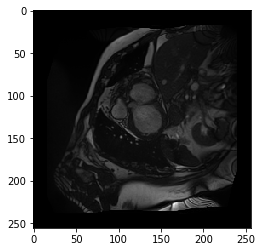

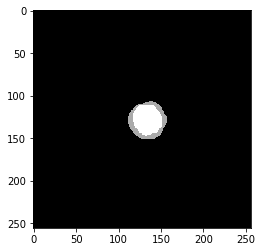

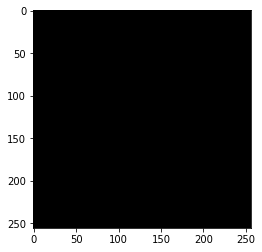

best performance: dice 0.92, idx 39


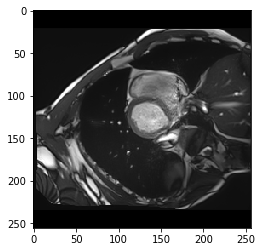

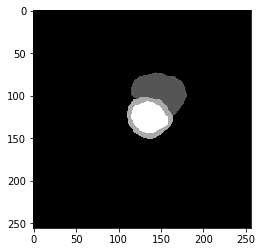

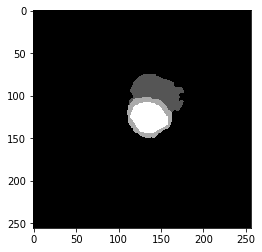

----------

EPOCH 115 of 140

Training Loss: 3.1648
0 Class, True Pos 57595044.0, False Pos 287426.0, False Neg 131611.0, Dice score 1.00
1 Class, True Pos 439470.0, False Pos 104876.0, False Neg 165563.0, Dice score 0.76
2 Class, True Pos 503046.0, False Pos 113120.0, False Neg 147741.0, Dice score 0.79
3 Class, True Pos 567568.0, False Pos 27201.0, False Neg 87708.0, Dice score 0.91
----------
Vaildation Loss: 5.2296
0 Class, True Pos 62880276.0, False Pos 416144.0, False Neg 188183.0, Dice score 1.00
1 Class, True Pos 447905.0, False Pos 154298.0, False Neg 183021.0, Dice score 0.73
2 Class, True Pos 463788.0, False Pos 106860.0, False Neg 204137.0, Dice score 0.75
3 Class, True Pos 518618.0, False Pos 23825.0, False Neg 125786.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


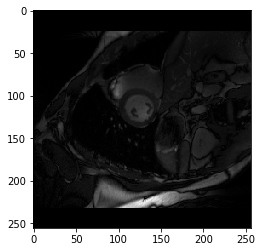

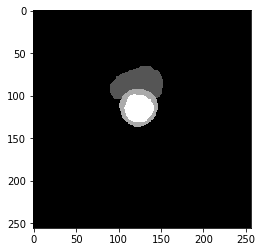

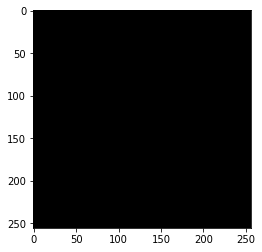

best performance: dice 0.93, idx 48


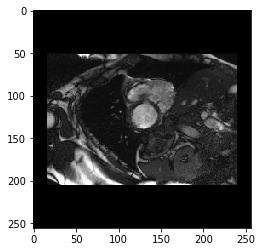

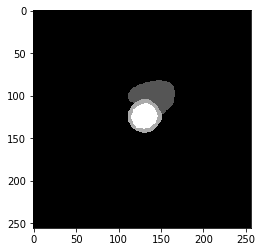

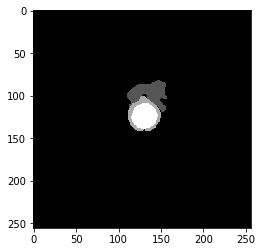

----------

EPOCH 116 of 140

Training Loss: 3.0657
0 Class, True Pos 57612892.0, False Pos 280215.0, False Neg 138212.0, Dice score 1.00
1 Class, True Pos 445797.0, False Pos 109157.0, False Neg 143768.0, Dice score 0.78
2 Class, True Pos 495865.0, False Pos 110848.0, False Neg 154455.0, Dice score 0.79
3 Class, True Pos 557261.0, False Pos 25725.0, False Neg 89510.0, Dice score 0.91
----------
Vaildation Loss: 4.9103
0 Class, True Pos 62839072.0, False Pos 353277.0, False Neg 229384.0, Dice score 1.00
1 Class, True Pos 466533.0, False Pos 189449.0, False Neg 164393.0, Dice score 0.73
2 Class, True Pos 484517.0, False Pos 119831.0, False Neg 183408.0, Dice score 0.76
3 Class, True Pos 532455.0, False Pos 26577.0, False Neg 111949.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


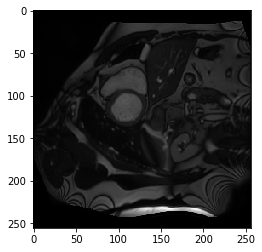

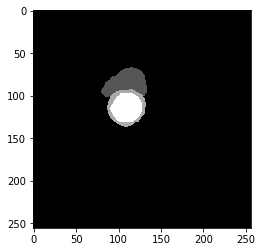

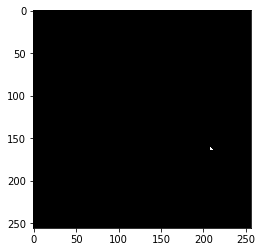

best performance: dice 0.93, idx 48


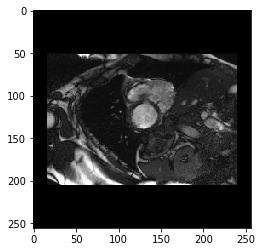

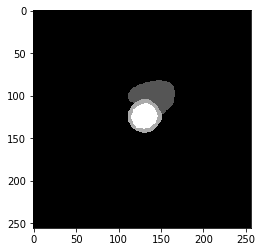

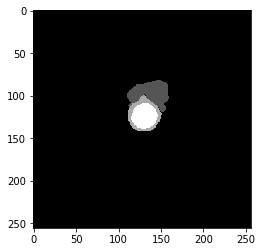

----------

EPOCH 117 of 140

Training Loss: 3.0676
0 Class, True Pos 57582888.0, False Pos 295516.0, False Neg 130903.0, Dice score 1.00
1 Class, True Pos 442766.0, False Pos 104467.0, False Neg 163020.0, Dice score 0.77
2 Class, True Pos 506357.0, False Pos 107908.0, False Neg 155368.0, Dice score 0.79
3 Class, True Pos 570975.0, False Pos 26871.0, False Neg 85471.0, Dice score 0.91
----------
Vaildation Loss: 5.5278
0 Class, True Pos 62903736.0, False Pos 464772.0, False Neg 164719.0, Dice score 1.00
1 Class, True Pos 433346.0, False Pos 134102.0, False Neg 197580.0, Dice score 0.72
2 Class, True Pos 447956.0, False Pos 100516.0, False Neg 219969.0, Dice score 0.74
3 Class, True Pos 505345.0, False Pos 21937.0, False Neg 139059.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


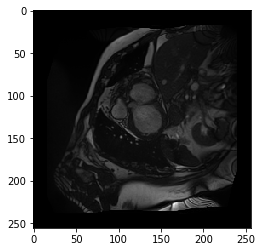

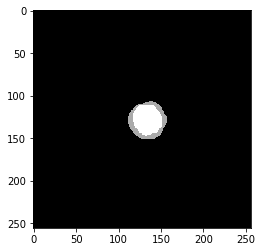

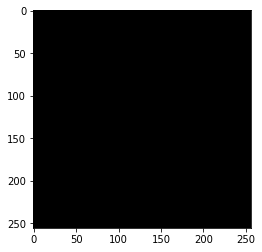

best performance: dice 0.93, idx 48


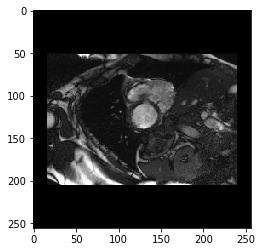

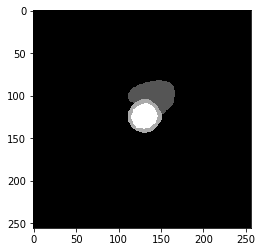

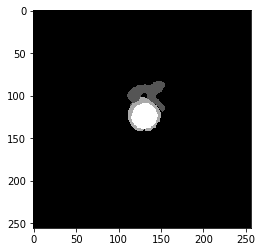

----------

EPOCH 118 of 140

Training Loss: 3.1919
0 Class, True Pos 57598928.0, False Pos 302378.0, False Neg 137105.0, Dice score 1.00
1 Class, True Pos 430330.0, False Pos 108185.0, False Neg 161551.0, Dice score 0.76
2 Class, True Pos 494457.0, False Pos 112665.0, False Neg 164408.0, Dice score 0.78
3 Class, True Pos 563265.0, False Pos 27552.0, False Neg 87716.0, Dice score 0.91
----------
Vaildation Loss: 5.1141
0 Class, True Pos 62855476.0, False Pos 385898.0, False Neg 212988.0, Dice score 1.00
1 Class, True Pos 455597.0, False Pos 168175.0, False Neg 175329.0, Dice score 0.73
2 Class, True Pos 476226.0, False Pos 118846.0, False Neg 191699.0, Dice score 0.75
3 Class, True Pos 525173.0, False Pos 26328.0, False Neg 119231.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


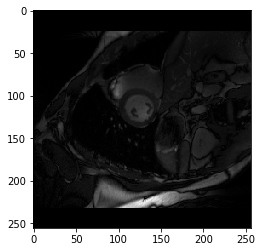

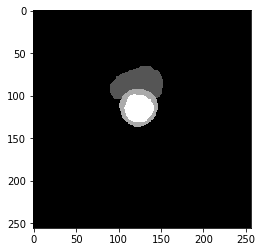

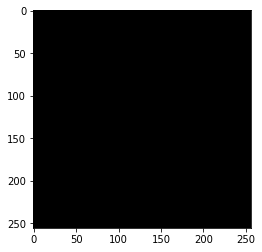

best performance: dice 0.93, idx 48


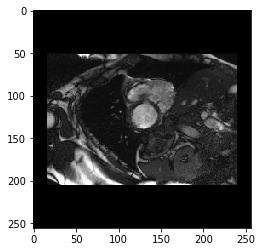

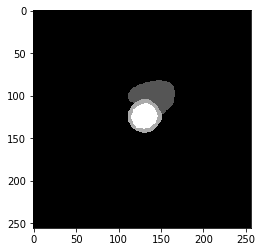

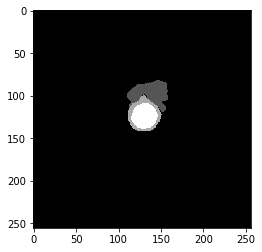

----------

EPOCH 119 of 140

Training Loss: 3.0118
0 Class, True Pos 57608420.0, False Pos 271568.0, False Neg 129667.0, Dice score 1.00
1 Class, True Pos 440531.0, False Pos 105093.0, False Neg 161956.0, Dice score 0.77
2 Class, True Pos 501944.0, False Pos 111173.0, False Neg 143297.0, Dice score 0.80
3 Class, True Pos 571712.0, False Pos 27317.0, False Neg 80231.0, Dice score 0.91
----------
Vaildation Loss: 5.1997
0 Class, True Pos 62867420.0, False Pos 406879.0, False Neg 201033.0, Dice score 1.00
1 Class, True Pos 454141.0, False Pos 167011.0, False Neg 176785.0, Dice score 0.73
2 Class, True Pos 463179.0, False Pos 106331.0, False Neg 204746.0, Dice score 0.75
3 Class, True Pos 521631.0, False Pos 25116.0, False Neg 122773.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


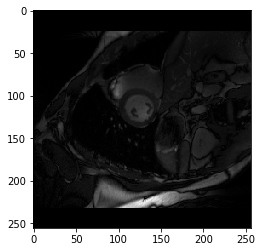

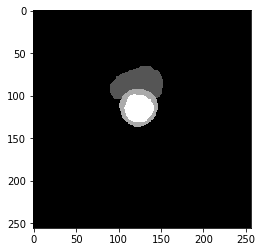

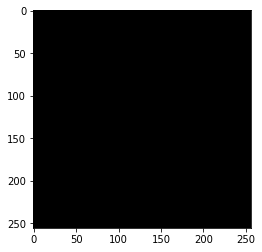

best performance: dice 0.93, idx 48


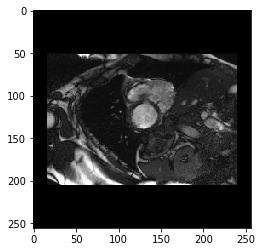

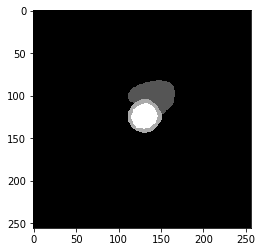

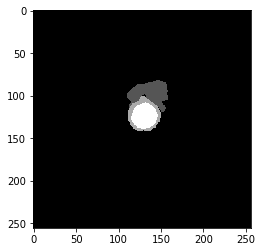

----------

EPOCH 120 of 140

Training Loss: 3.0117
0 Class, True Pos 57627904.0, False Pos 257068.0, False Neg 125140.0, Dice score 1.00
1 Class, True Pos 448908.0, False Pos 99984.0, False Neg 143009.0, Dice score 0.79
2 Class, True Pos 501980.0, False Pos 106347.0, False Neg 144339.0, Dice score 0.80
3 Class, True Pos 568880.0, False Pos 26685.0, False Neg 77596.0, Dice score 0.92
----------
Vaildation Loss: 5.5306
0 Class, True Pos 62891456.0, False Pos 460375.0, False Neg 177006.0, Dice score 0.99
1 Class, True Pos 433085.0, False Pos 139819.0, False Neg 197841.0, Dice score 0.72
2 Class, True Pos 455099.0, False Pos 108633.0, False Neg 212826.0, Dice score 0.74
3 Class, True Pos 502814.0, False Pos 20436.0, False Neg 141590.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


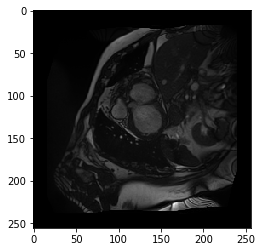

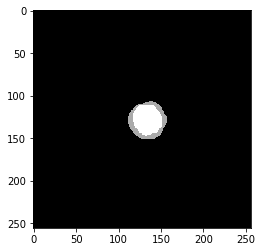

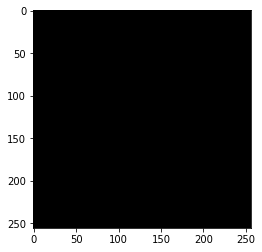

best performance: dice 0.93, idx 48


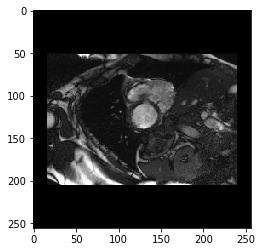

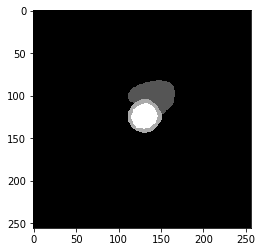

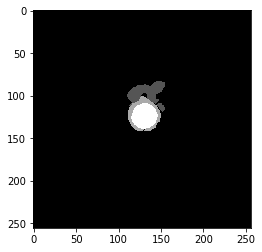

----------

EPOCH 121 of 140

Training Loss: 3.2120
0 Class, True Pos 57589952.0, False Pos 301406.0, False Neg 137837.0, Dice score 1.00
1 Class, True Pos 431449.0, False Pos 108673.0, False Neg 171249.0, Dice score 0.76
2 Class, True Pos 499474.0, False Pos 111773.0, False Neg 155646.0, Dice score 0.79
3 Class, True Pos 565207.0, False Pos 29820.0, False Neg 86940.0, Dice score 0.91
----------
Vaildation Loss: 4.8610
0 Class, True Pos 62858640.0, False Pos 356723.0, False Neg 209812.0, Dice score 1.00
1 Class, True Pos 460815.0, False Pos 168359.0, False Neg 170111.0, Dice score 0.73
2 Class, True Pos 484497.0, False Pos 118496.0, False Neg 183428.0, Dice score 0.76
3 Class, True Pos 535869.0, False Pos 28308.0, False Neg 108535.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


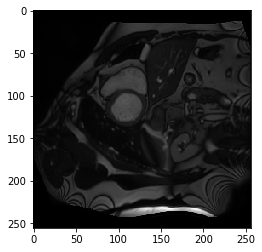

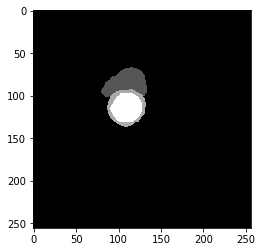

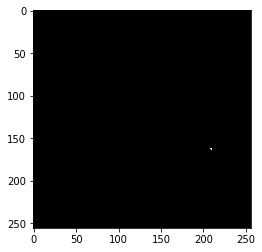

best performance: dice 0.93, idx 48


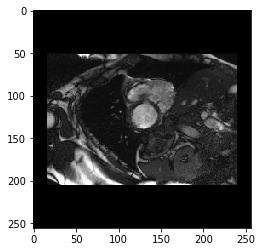

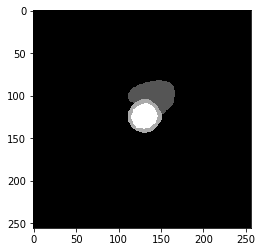

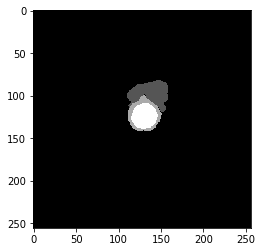

----------

EPOCH 122 of 140

Training Loss: 3.1457
0 Class, True Pos 57602472.0, False Pos 296440.0, False Neg 131090.0, Dice score 1.00
1 Class, True Pos 437325.0, False Pos 102789.0, False Neg 158176.0, Dice score 0.77
2 Class, True Pos 500145.0, False Pos 108426.0, False Neg 154560.0, Dice score 0.79
3 Class, True Pos 563825.0, False Pos 26340.0, False Neg 90169.0, Dice score 0.91
----------
Vaildation Loss: 5.8396
0 Class, True Pos 62920420.0, False Pos 516627.0, False Neg 148027.0, Dice score 0.99
1 Class, True Pos 416943.0, False Pos 115728.0, False Neg 213983.0, Dice score 0.72
2 Class, True Pos 433656.0, False Pos 97571.0, False Neg 234269.0, Dice score 0.72
3 Class, True Pos 491807.0, False Pos 18950.0, False Neg 152597.0, Dice score 0.85
----------
worst performance: dice 0.25, idx 2


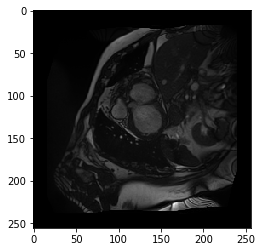

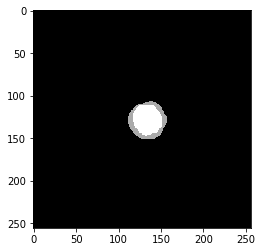

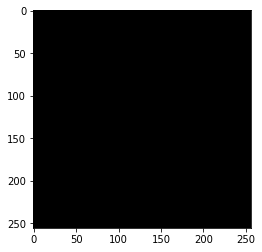

best performance: dice 0.93, idx 48


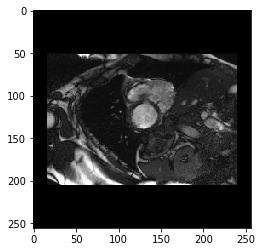

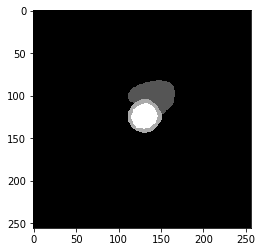

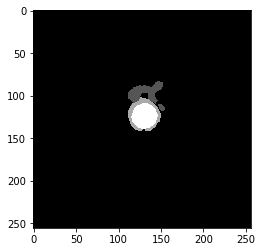

----------

EPOCH 123 of 140

Training Loss: 3.1899
0 Class, True Pos 57580556.0, False Pos 305468.0, False Neg 137257.0, Dice score 1.00
1 Class, True Pos 433644.0, False Pos 103904.0, False Neg 169276.0, Dice score 0.76
2 Class, True Pos 501735.0, False Pos 116847.0, False Neg 158379.0, Dice score 0.78
3 Class, True Pos 567832.0, False Pos 27773.0, False Neg 89080.0, Dice score 0.91
----------
Vaildation Loss: 5.3528
0 Class, True Pos 62903692.0, False Pos 443020.0, False Neg 164770.0, Dice score 1.00
1 Class, True Pos 437099.0, False Pos 133202.0, False Neg 193827.0, Dice score 0.73
2 Class, True Pos 457234.0, False Pos 104810.0, False Neg 210691.0, Dice score 0.74
3 Class, True Pos 510863.0, False Pos 21797.0, False Neg 133541.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


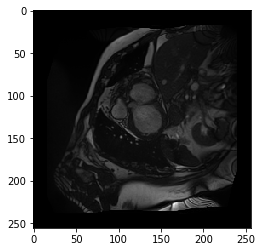

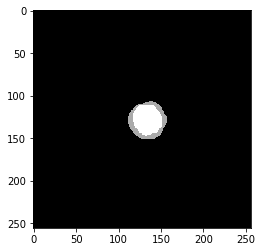

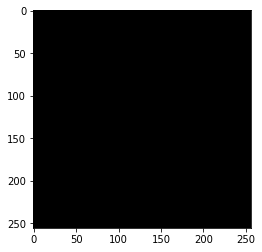

best performance: dice 0.93, idx 48


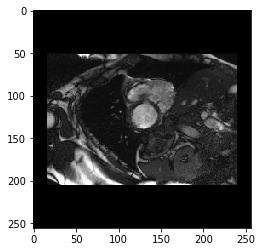

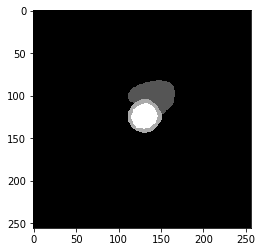

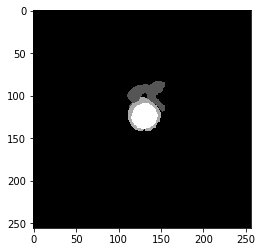

----------

EPOCH 124 of 140

Training Loss: 3.1515
0 Class, True Pos 57585168.0, False Pos 291115.0, False Neg 133818.0, Dice score 1.00
1 Class, True Pos 441594.0, False Pos 107029.0, False Neg 163521.0, Dice score 0.77
2 Class, True Pos 503402.0, False Pos 113712.0, False Neg 155998.0, Dice score 0.79
3 Class, True Pos 568996.0, False Pos 26743.0, False Neg 85262.0, Dice score 0.91
----------
Vaildation Loss: 5.0447
0 Class, True Pos 62824728.0, False Pos 362881.0, False Neg 243730.0, Dice score 1.00
1 Class, True Pos 463985.0, False Pos 192779.0, False Neg 166941.0, Dice score 0.72
2 Class, True Pos 484579.0, False Pos 125310.0, False Neg 183346.0, Dice score 0.76
3 Class, True Pos 529519.0, False Pos 27932.0, False Neg 114885.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


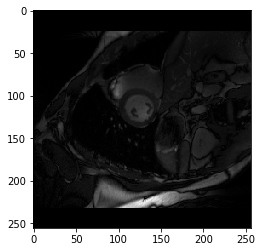

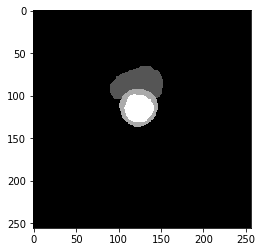

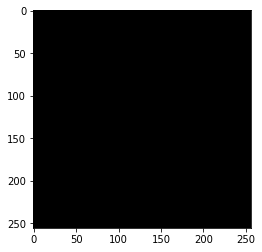

best performance: dice 0.93, idx 48


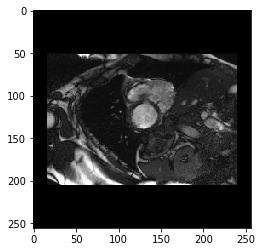

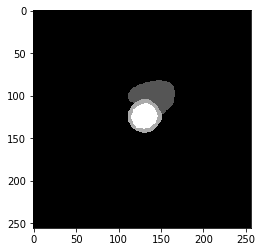

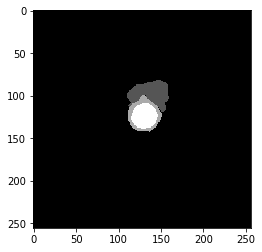

----------

EPOCH 125 of 140

Training Loss: 3.1180
0 Class, True Pos 57614688.0, False Pos 284091.0, False Neg 136895.0, Dice score 1.00
1 Class, True Pos 437585.0, False Pos 105193.0, False Neg 145924.0, Dice score 0.78
2 Class, True Pos 495698.0, False Pos 113701.0, False Neg 157519.0, Dice score 0.79
3 Class, True Pos 561856.0, False Pos 24949.0, False Neg 87596.0, Dice score 0.91
----------
Vaildation Loss: 5.4486
0 Class, True Pos 62880720.0, False Pos 441557.0, False Neg 187747.0, Dice score 1.00
1 Class, True Pos 435649.0, False Pos 141488.0, False Neg 195277.0, Dice score 0.72
2 Class, True Pos 463860.0, False Pos 117705.0, False Neg 204065.0, Dice score 0.74
3 Class, True Pos 508297.0, False Pos 22446.0, False Neg 136107.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


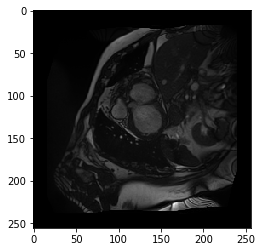

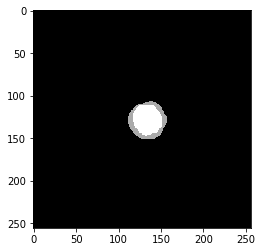

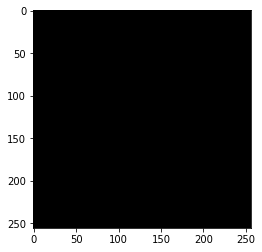

best performance: dice 0.93, idx 48


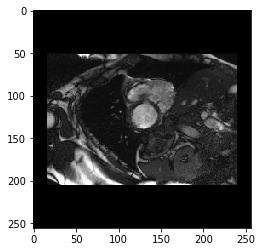

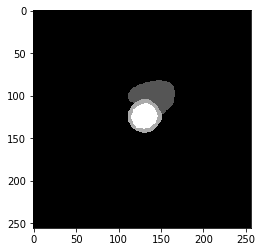

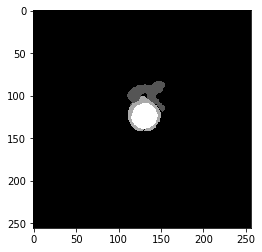

----------

EPOCH 126 of 140

Training Loss: 3.0966
0 Class, True Pos 57584384.0, False Pos 306106.0, False Neg 127590.0, Dice score 1.00
1 Class, True Pos 444328.0, False Pos 99823.0, False Neg 160465.0, Dice score 0.77
2 Class, True Pos 499506.0, False Pos 109675.0, False Neg 157357.0, Dice score 0.79
3 Class, True Pos 565235.0, False Pos 28710.0, False Neg 98902.0, Dice score 0.90
----------
Vaildation Loss: 4.8462
0 Class, True Pos 62828928.0, False Pos 341351.0, False Neg 239524.0, Dice score 1.00
1 Class, True Pos 472444.0, False Pos 199020.0, False Neg 158482.0, Dice score 0.73
2 Class, True Pos 482149.0, False Pos 115401.0, False Neg 185776.0, Dice score 0.76
3 Class, True Pos 541099.0, False Pos 31315.0, False Neg 103305.0, Dice score 0.89
----------
worst performance: dice 0.25, idx 20


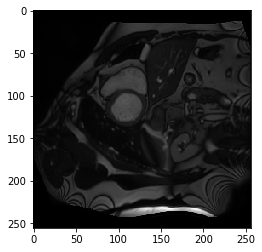

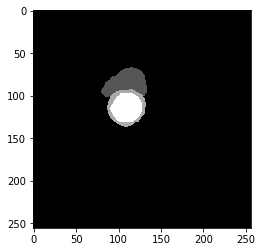

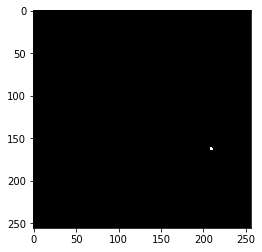

best performance: dice 0.92, idx 48


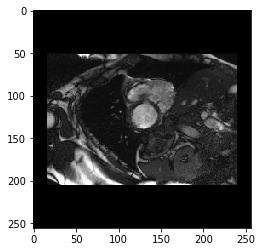

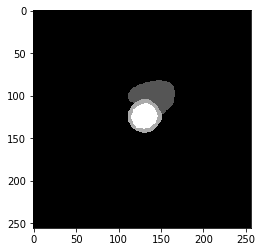

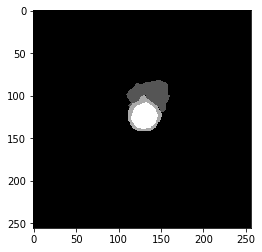

----------

EPOCH 127 of 140

Training Loss: 3.1367
0 Class, True Pos 57595928.0, False Pos 276195.0, False Neg 132169.0, Dice score 1.00
1 Class, True Pos 443617.0, False Pos 108411.0, False Neg 160818.0, Dice score 0.77
2 Class, True Pos 500388.0, False Pos 114136.0, False Neg 153819.0, Dice score 0.79
3 Class, True Pos 567945.0, False Pos 31140.0, False Neg 83076.0, Dice score 0.91
----------
Vaildation Loss: 5.0014
0 Class, True Pos 62848512.0, False Pos 373044.0, False Neg 219945.0, Dice score 1.00
1 Class, True Pos 460536.0, False Pos 179335.0, False Neg 170390.0, Dice score 0.72
2 Class, True Pos 474043.0, False Pos 114194.0, False Neg 193882.0, Dice score 0.75
3 Class, True Pos 532964.0, False Pos 29084.0, False Neg 111440.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


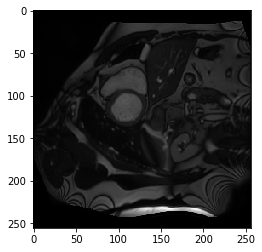

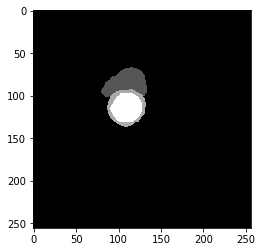

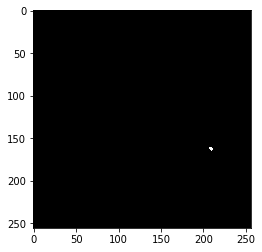

best performance: dice 0.92, idx 48


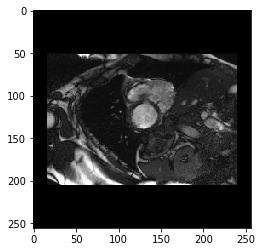

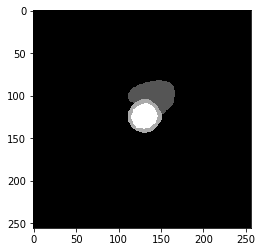

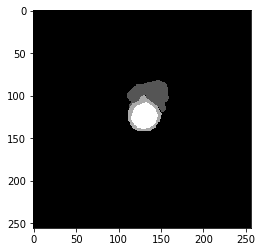

----------

EPOCH 128 of 140

Training Loss: 3.1536
0 Class, True Pos 57585856.0, False Pos 294183.0, False Neg 144132.0, Dice score 1.00
1 Class, True Pos 434721.0, False Pos 111965.0, False Neg 165774.0, Dice score 0.76
2 Class, True Pos 498561.0, False Pos 113826.0, False Neg 158502.0, Dice score 0.79
3 Class, True Pos 569380.0, False Pos 29259.0, False Neg 80825.0, Dice score 0.91
----------
Vaildation Loss: 5.4921
0 Class, True Pos 62902992.0, False Pos 454809.0, False Neg 165462.0, Dice score 1.00
1 Class, True Pos 427686.0, False Pos 123271.0, False Neg 203240.0, Dice score 0.72
2 Class, True Pos 462878.0, False Pos 117808.0, False Neg 205047.0, Dice score 0.74
3 Class, True Pos 502239.0, False Pos 20026.0, False Neg 142165.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


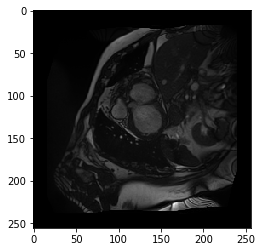

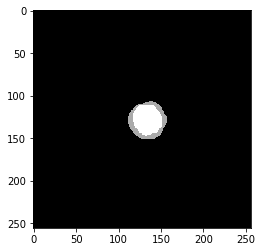

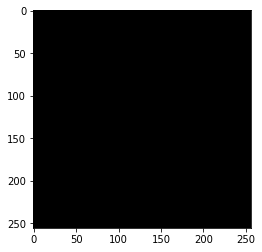

best performance: dice 0.93, idx 48


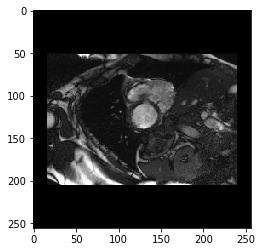

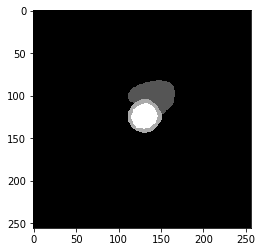

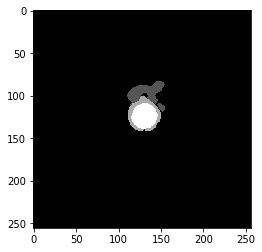

----------

EPOCH 129 of 140

Training Loss: 3.1155
0 Class, True Pos 57603368.0, False Pos 280577.0, False Neg 133285.0, Dice score 1.00
1 Class, True Pos 437076.0, False Pos 101986.0, False Neg 158334.0, Dice score 0.77
2 Class, True Pos 501739.0, False Pos 114988.0, False Neg 151509.0, Dice score 0.79
3 Class, True Pos 570498.0, False Pos 27530.0, False Neg 81953.0, Dice score 0.91
----------
Vaildation Loss: 4.9691
0 Class, True Pos 62838908.0, False Pos 358834.0, False Neg 229559.0, Dice score 1.00
1 Class, True Pos 466272.0, False Pos 188977.0, False Neg 164654.0, Dice score 0.73
2 Class, True Pos 481144.0, False Pos 118096.0, False Neg 186781.0, Dice score 0.76
3 Class, True Pos 531797.0, False Pos 27694.0, False Neg 112607.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


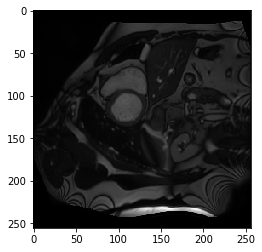

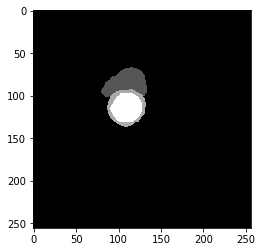

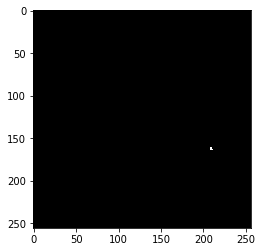

best performance: dice 0.93, idx 48


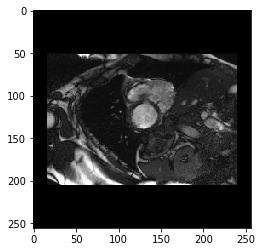

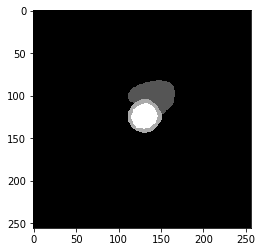

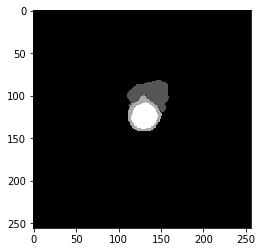

----------

EPOCH 130 of 140

Training Loss: 3.1168
0 Class, True Pos 57610624.0, False Pos 268862.0, False Neg 129237.0, Dice score 1.00
1 Class, True Pos 437581.0, False Pos 103872.0, False Neg 146662.0, Dice score 0.78
2 Class, True Pos 503708.0, False Pos 113635.0, False Neg 152386.0, Dice score 0.79
3 Class, True Pos 573555.0, False Pos 25917.0, False Neg 84001.0, Dice score 0.91
----------
Vaildation Loss: 5.5062
0 Class, True Pos 62902368.0, False Pos 458885.0, False Neg 166091.0, Dice score 1.00
1 Class, True Pos 432200.0, False Pos 131388.0, False Neg 198726.0, Dice score 0.72
2 Class, True Pos 455314.0, False Pos 108092.0, False Neg 212611.0, Dice score 0.74
3 Class, True Pos 502877.0, False Pos 20590.0, False Neg 141527.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


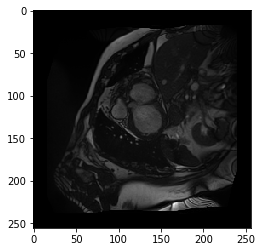

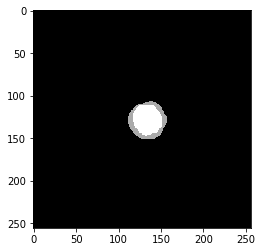

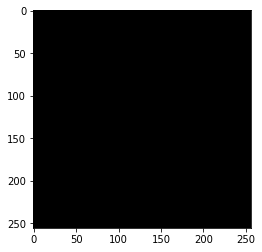

best performance: dice 0.93, idx 48


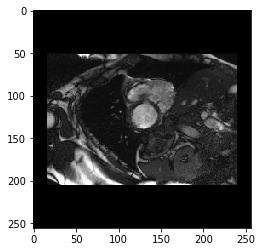

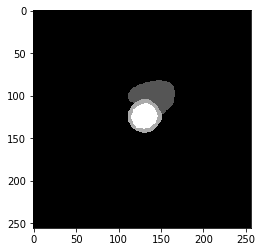

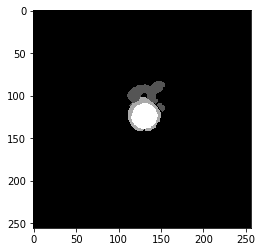

----------

EPOCH 131 of 140

Training Loss: 3.2361
0 Class, True Pos 57628384.0, False Pos 273940.0, False Neg 146169.0, Dice score 1.00
1 Class, True Pos 433638.0, False Pos 108818.0, False Neg 151956.0, Dice score 0.77
2 Class, True Pos 491976.0, False Pos 117901.0, False Neg 144002.0, Dice score 0.79
3 Class, True Pos 555072.0, False Pos 28027.0, False Neg 86559.0, Dice score 0.91
----------
Vaildation Loss: 5.1747
0 Class, True Pos 62878420.0, False Pos 407552.0, False Neg 190035.0, Dice score 1.00
1 Class, True Pos 451529.0, False Pos 157858.0, False Neg 179397.0, Dice score 0.73
2 Class, True Pos 463941.0, False Pos 107294.0, False Neg 203984.0, Dice score 0.75
3 Class, True Pos 520951.0, False Pos 24165.0, False Neg 123453.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


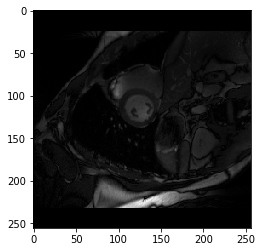

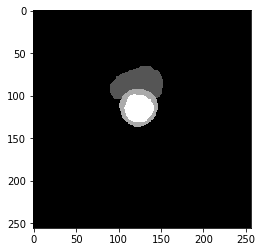

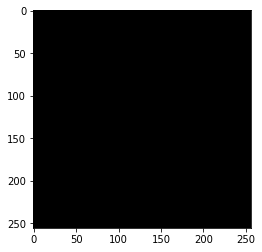

best performance: dice 0.93, idx 48


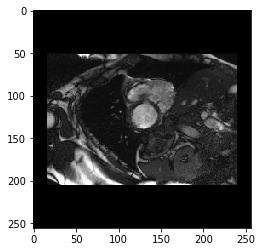

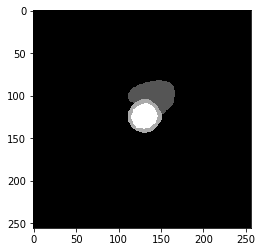

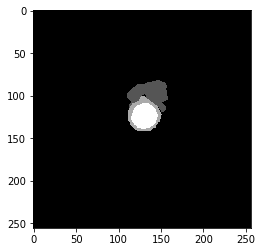

----------

EPOCH 132 of 140

Training Loss: 3.2320
0 Class, True Pos 57569508.0, False Pos 310879.0, False Neg 139483.0, Dice score 1.00
1 Class, True Pos 438465.0, False Pos 111196.0, False Neg 171958.0, Dice score 0.76
2 Class, True Pos 498540.0, False Pos 113807.0, False Neg 161808.0, Dice score 0.78
3 Class, True Pos 567593.0, False Pos 27775.0, False Neg 90408.0, Dice score 0.91
----------
Vaildation Loss: 5.0354
0 Class, True Pos 62857864.0, False Pos 375123.0, False Neg 210596.0, Dice score 1.00
1 Class, True Pos 457808.0, False Pos 169465.0, False Neg 173118.0, Dice score 0.73
2 Class, True Pos 479003.0, False Pos 118522.0, False Neg 188922.0, Dice score 0.76
3 Class, True Pos 527605.0, False Pos 26325.0, False Neg 116799.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


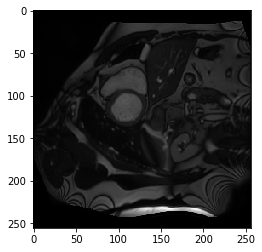

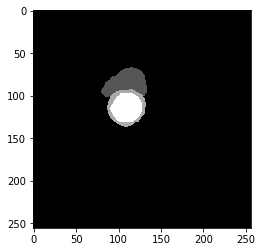

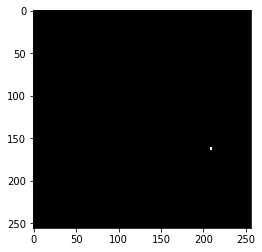

best performance: dice 0.93, idx 48


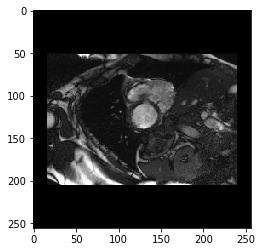

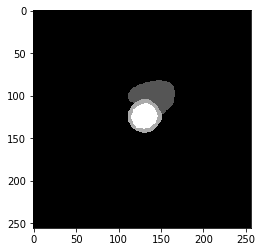

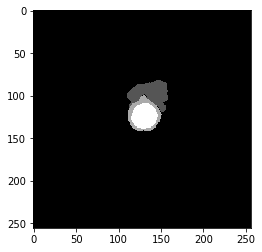

----------

EPOCH 133 of 140

Training Loss: 3.0356
0 Class, True Pos 57607160.0, False Pos 273281.0, False Neg 126698.0, Dice score 1.00
1 Class, True Pos 442949.0, False Pos 103600.0, False Neg 148646.0, Dice score 0.78
2 Class, True Pos 505438.0, False Pos 108471.0, False Neg 151107.0, Dice score 0.80
3 Class, True Pos 571362.0, False Pos 25500.0, False Neg 84401.0, Dice score 0.91
----------
Vaildation Loss: 5.2598
0 Class, True Pos 62872280.0, False Pos 418055.0, False Neg 196181.0, Dice score 1.00
1 Class, True Pos 449455.0, False Pos 162388.0, False Neg 181471.0, Dice score 0.72
2 Class, True Pos 459003.0, False Pos 103721.0, False Neg 208922.0, Dice score 0.75
3 Class, True Pos 521145.0, False Pos 25669.0, False Neg 123259.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


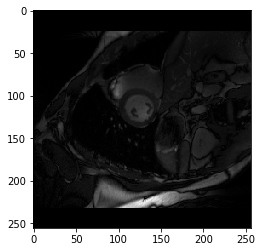

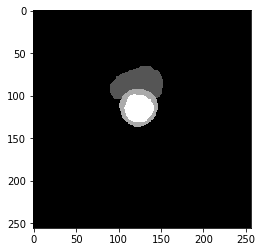

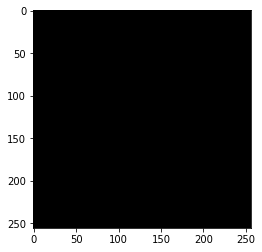

best performance: dice 0.93, idx 48


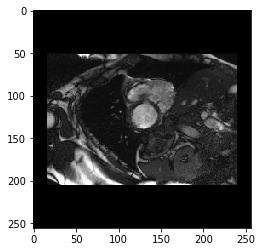

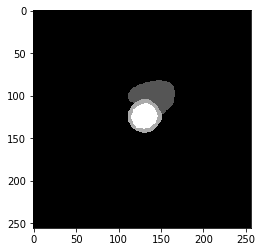

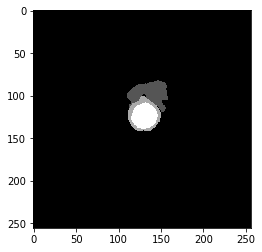

----------

EPOCH 134 of 140

Training Loss: 2.9894
0 Class, True Pos 57606120.0, False Pos 268575.0, False Neg 127763.0, Dice score 1.00
1 Class, True Pos 451885.0, False Pos 97519.0, False Neg 142604.0, Dice score 0.79
2 Class, True Pos 503666.0, False Pos 111079.0, False Neg 153489.0, Dice score 0.79
3 Class, True Pos 573123.0, False Pos 25788.0, False Neg 79105.0, Dice score 0.92
----------
Vaildation Loss: 5.6088
0 Class, True Pos 62927544.0, False Pos 486984.0, False Neg 140919.0, Dice score 1.00
1 Class, True Pos 419975.0, False Pos 113773.0, False Neg 210951.0, Dice score 0.72
2 Class, True Pos 446883.0, False Pos 101645.0, False Neg 221042.0, Dice score 0.73
3 Class, True Pos 496604.0, False Pos 18310.0, False Neg 147800.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


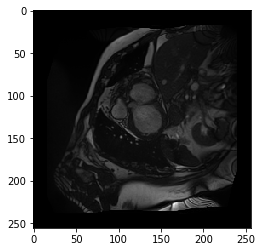

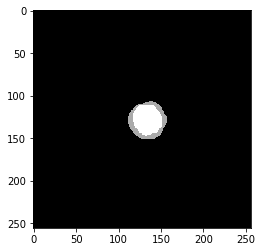

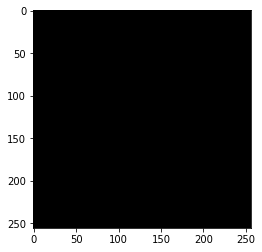

best performance: dice 0.93, idx 48


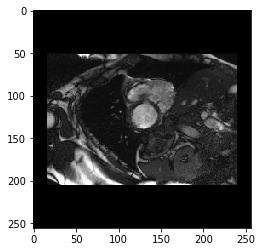

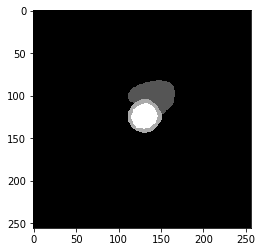

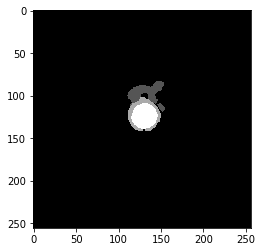

----------

EPOCH 135 of 140

Training Loss: 3.0287
0 Class, True Pos 57606800.0, False Pos 267891.0, False Neg 127988.0, Dice score 1.00
1 Class, True Pos 443866.0, False Pos 105394.0, False Neg 145509.0, Dice score 0.78
2 Class, True Pos 505102.0, False Pos 106975.0, False Neg 155555.0, Dice score 0.79
3 Class, True Pos 575810.0, False Pos 25919.0, False Neg 77127.0, Dice score 0.92
----------
Vaildation Loss: 5.4130
0 Class, True Pos 62878360.0, False Pos 435172.0, False Neg 190098.0, Dice score 1.00
1 Class, True Pos 436446.0, False Pos 141752.0, False Neg 194480.0, Dice score 0.72
2 Class, True Pos 464623.0, False Pos 116249.0, False Neg 203302.0, Dice score 0.74
3 Class, True Pos 513682.0, False Pos 25429.0, False Neg 130722.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 2


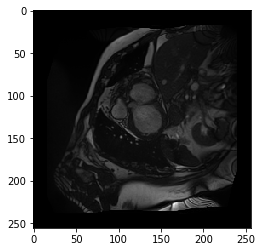

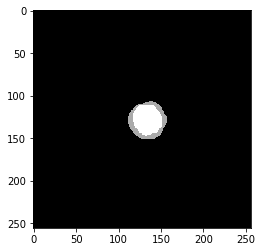

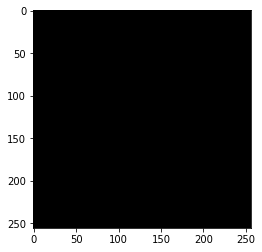

best performance: dice 0.92, idx 48


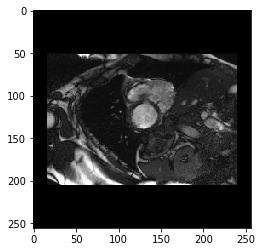

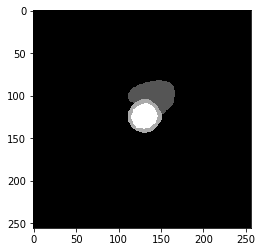

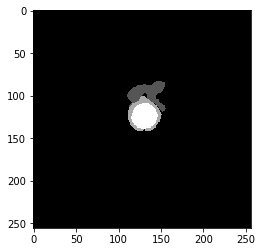

----------

EPOCH 136 of 140

Training Loss: 3.1377
0 Class, True Pos 57584804.0, False Pos 300317.0, False Neg 131713.0, Dice score 1.00
1 Class, True Pos 440861.0, False Pos 107317.0, False Neg 162992.0, Dice score 0.77
2 Class, True Pos 494254.0, False Pos 114307.0, False Neg 159341.0, Dice score 0.78
3 Class, True Pos 569368.0, False Pos 26529.0, False Neg 94424.0, Dice score 0.90
----------
Vaildation Loss: 4.9931
0 Class, True Pos 62867584.0, False Pos 378666.0, False Neg 200866.0, Dice score 1.00
1 Class, True Pos 455271.0, False Pos 162760.0, False Neg 175655.0, Dice score 0.73
2 Class, True Pos 475893.0, False Pos 113017.0, False Neg 192032.0, Dice score 0.76
3 Class, True Pos 530754.0, False Pos 27760.0, False Neg 113650.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 20


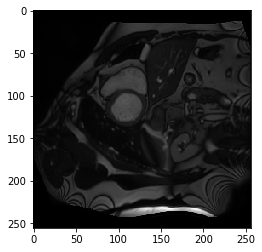

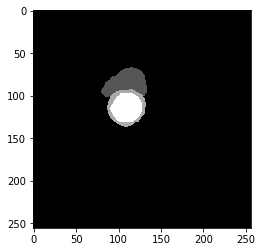

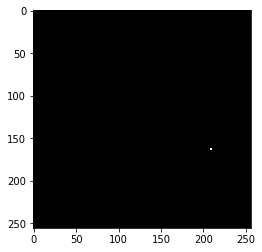

best performance: dice 0.93, idx 48


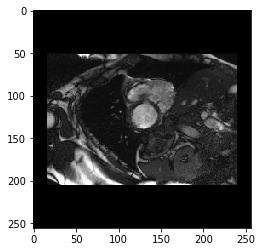

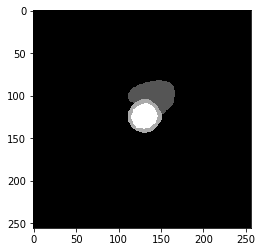

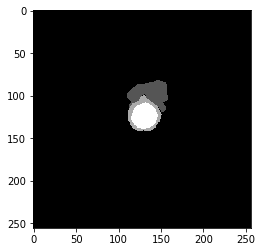

----------

EPOCH 137 of 140

Training Loss: 3.1007
0 Class, True Pos 57589536.0, False Pos 272193.0, False Neg 138287.0, Dice score 1.00
1 Class, True Pos 446758.0, False Pos 110528.0, False Neg 155458.0, Dice score 0.77
2 Class, True Pos 507606.0, False Pos 112087.0, False Neg 151060.0, Dice score 0.79
3 Class, True Pos 572733.0, False Pos 26323.0, False Neg 76326.0, Dice score 0.92
----------
Vaildation Loss: 5.0315
0 Class, True Pos 62846436.0, False Pos 368810.0, False Neg 222014.0, Dice score 1.00
1 Class, True Pos 462684.0, False Pos 179180.0, False Neg 168242.0, Dice score 0.73
2 Class, True Pos 479842.0, False Pos 119733.0, False Neg 188083.0, Dice score 0.76
3 Class, True Pos 528230.0, False Pos 26790.0, False Neg 116174.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


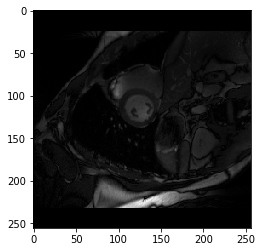

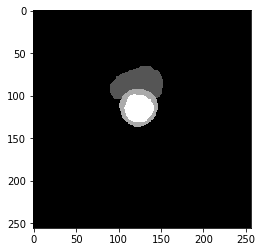

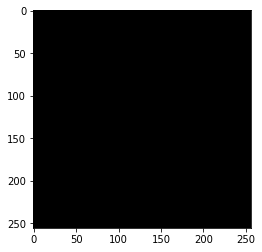

best performance: dice 0.93, idx 48


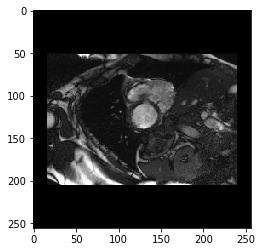

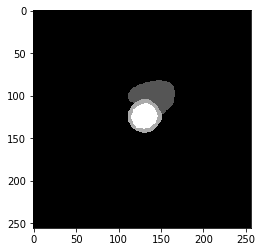

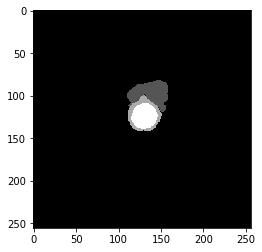

----------

EPOCH 138 of 140

Training Loss: 3.1400
0 Class, True Pos 57591808.0, False Pos 284017.0, False Neg 131040.0, Dice score 1.00
1 Class, True Pos 446111.0, False Pos 103781.0, False Neg 157397.0, Dice score 0.77
2 Class, True Pos 501531.0, False Pos 112062.0, False Neg 153279.0, Dice score 0.79
3 Class, True Pos 574152.0, False Pos 24284.0, False Neg 82428.0, Dice score 0.91
----------
Vaildation Loss: 5.4384
0 Class, True Pos 62893492.0, False Pos 448781.0, False Neg 174974.0, Dice score 1.00
1 Class, True Pos 433787.0, False Pos 134798.0, False Neg 197139.0, Dice score 0.72
2 Class, True Pos 461246.0, False Pos 113245.0, False Neg 206679.0, Dice score 0.74
3 Class, True Pos 505752.0, False Pos 20620.0, False Neg 138652.0, Dice score 0.86
----------
worst performance: dice 0.25, idx 2


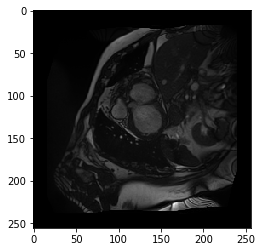

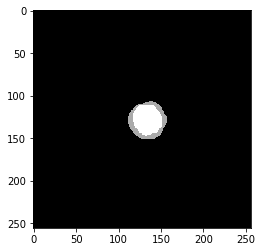

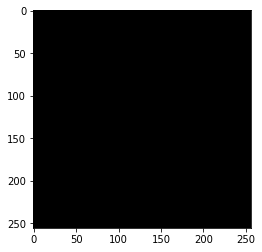

best performance: dice 0.93, idx 48


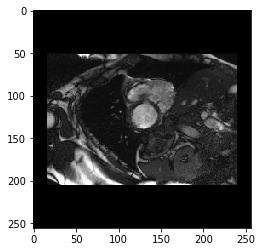

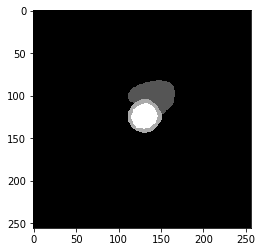

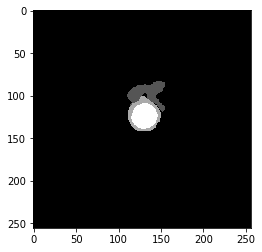

----------

EPOCH 139 of 140

Training Loss: 2.9629
0 Class, True Pos 57616496.0, False Pos 254114.0, False Neg 128053.0, Dice score 1.00
1 Class, True Pos 458227.0, False Pos 101485.0, False Neg 140477.0, Dice score 0.79
2 Class, True Pos 504131.0, False Pos 107490.0, False Neg 143450.0, Dice score 0.80
3 Class, True Pos 569500.0, False Pos 26313.0, False Neg 77422.0, Dice score 0.92
----------
Vaildation Loss: 5.1872
0 Class, True Pos 62866652.0, False Pos 403897.0, False Neg 201802.0, Dice score 1.00
1 Class, True Pos 449213.0, False Pos 158993.0, False Neg 181713.0, Dice score 0.73
2 Class, True Pos 472777.0, False Pos 115747.0, False Neg 195148.0, Dice score 0.75
3 Class, True Pos 520071.0, False Pos 24359.0, False Neg 124333.0, Dice score 0.87
----------
worst performance: dice 0.25, idx 35


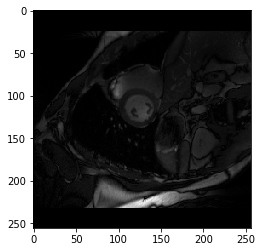

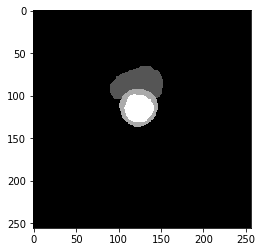

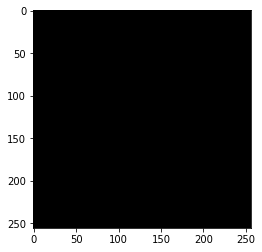

best performance: dice 0.93, idx 48


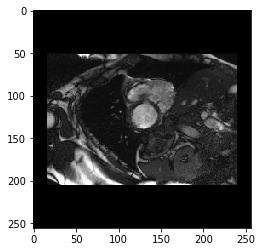

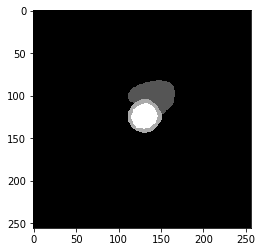

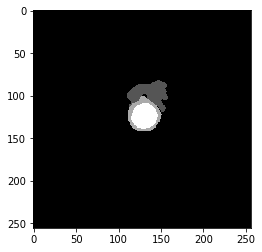

----------

EPOCH 140 of 140

Training Loss: 3.1014
0 Class, True Pos 57587880.0, False Pos 296723.0, False Neg 129242.0, Dice score 1.00
1 Class, True Pos 447821.0, False Pos 103249.0, False Neg 157160.0, Dice score 0.77
2 Class, True Pos 503616.0, False Pos 109683.0, False Neg 157194.0, Dice score 0.79
3 Class, True Pos 561970.0, False Pos 26804.0, False Neg 92863.0, Dice score 0.90
----------
Vaildation Loss: 5.1953
0 Class, True Pos 62900736.0, False Pos 424670.0, False Neg 167716.0, Dice score 1.00
1 Class, True Pos 436539.0, False Pos 132889.0, False Neg 194387.0, Dice score 0.73
2 Class, True Pos 460046.0, False Pos 103861.0, False Neg 207879.0, Dice score 0.75
3 Class, True Pos 525539.0, False Pos 27427.0, False Neg 118865.0, Dice score 0.88
----------
worst performance: dice 0.25, idx 35


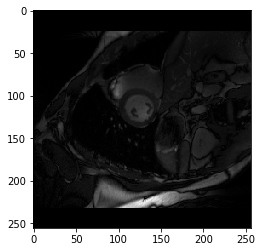

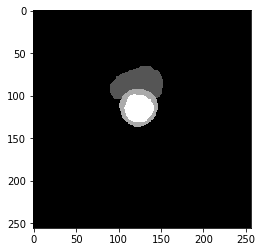

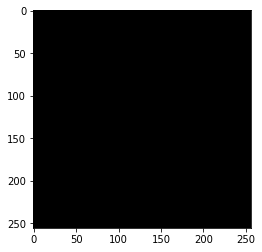

best performance: dice 0.92, idx 48


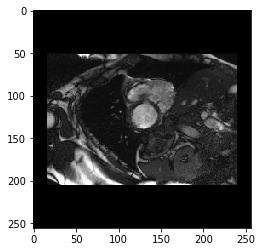

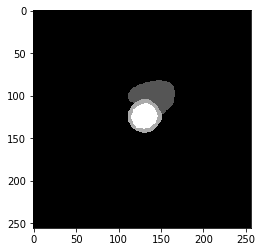

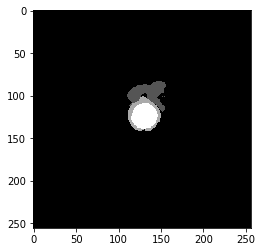

----------


In [19]:
best_model_wts, dice_score = run_training(model,device,num_class,scheduler,optimizer,dice_loss,num_epochs*2,train_generator,train_dataset,validation_generator,validation_dataset,writer)

In [24]:
print(dice_score)

tensor(0.8444)


In [20]:
## load best model weights
model.load_state_dict(best_model_wts)
## save model
torch.save(model.state_dict(), 'aug_trained_unet_new_weight.pt')

### fine tune a little bit

In [21]:
# intialize optimizer and lr decay
optimizer = torch.optim.Adam(model.parameters(),lr=0.0001)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
model.to(device)

unet(
  (conv1): Sequential(
    (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv2): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv3): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e

In [ ]:
best_model_wts, dice_score = run_training(model,device,num_class,scheduler,optimizer,dice_loss,num_epochs,train_generator,train_dataset,validation_generator,validation_dataset,writer)

## Save model as ONNX

In [22]:
dummy_input = torch.randn(1, 1, 256, 256, device='cpu')
torch.onnx.export(model.cpu(), dummy_input, "aug_trained_unet.onnx", verbose=True)

graph(%0 : Float(1, 1, 256, 256)
      %1 : Float(16, 1, 3, 3)
      %2 : Float(16)
      %3 : Float(16)
      %4 : Float(16)
      %5 : Float(16)
      %6 : Float(16)
      %7 : Long()
      %8 : Float(16, 16, 3, 3)
      %9 : Float(16)
      %10 : Float(16)
      %11 : Float(16)
      %12 : Float(16)
      %13 : Float(16)
      %14 : Long()
      %15 : Float(32, 16, 3, 3)
      %16 : Float(32)
      %17 : Float(32)
      %18 : Float(32)
      %19 : Float(32)
      %20 : Float(32)
      %21 : Long()
      %22 : Float(32, 32, 3, 3)
      %23 : Float(32)
      %24 : Float(32)
      %25 : Float(32)
      %26 : Float(32)
      %27 : Float(32)
      %28 : Long()
      %29 : Float(64, 32, 3, 3)
      %30 : Float(64)
      %31 : Float(64)
      %32 : Float(64)
      %33 : Float(64)
      %34 : Float(64)
      %35 : Long()
      %36 : Float(64, 64, 3, 3)
      %37 : Float(64)
      %38 : Float(64)
      %39 : Float(64)
      %40 : Float(64)
      %41 : Float(64)
      %42 : Long()
      %43 :

In [23]:
# print learnt weights to verify MATLAB has correctly imported them
for name, param in model.named_parameters():
    print (name, param.data)

conv1.0.weight tensor([[[[ 0.1895,  0.0953, -0.2902],
          [-0.0022, -0.2863, -0.0254],
          [ 0.0612,  0.0529,  0.1110]]],


        [[[ 0.0123, -0.2452,  0.2033],
          [ 0.3249, -0.0034, -0.0153],
          [ 0.2373, -0.2279, -0.2551]]],


        [[[-0.1256,  0.2376,  0.0910],
          [-0.2634, -0.2345, -0.1327],
          [-0.0301, -0.2236,  0.3609]]],


        [[[ 0.0506, -0.0944,  0.3433],
          [-0.0924, -0.2255,  0.0375],
          [ 0.2410, -0.1353, -0.1529]]],


        [[[-0.0370, -0.0511, -0.2271],
          [-0.0021,  0.1344,  0.0939],
          [-0.1280,  0.0158, -0.2401]]],


        [[[-0.2766, -0.2135,  0.2581],
          [ 0.1841,  0.1330,  0.3001],
          [-0.0865,  0.0200, -0.1454]]],


        [[[-0.1094,  0.3222, -0.0645],
          [ 0.0294,  0.1662, -0.1262],
          [-0.0214, -0.0419, -0.0231]]],


        [[[-0.0959, -0.1131,  0.3220],
          [-0.1755, -0.0760, -0.2931],
          [ 0.2373,  0.1589,  0.0215]]],


        [[[-0.190

conv2m.0.weight tensor([[[[-0.0482, -0.0251, -0.0179],
          [-0.0003,  0.0040, -0.0283],
          [ 0.0105, -0.0338, -0.0016]],

         [[ 0.0242, -0.0029, -0.0370],
          [ 0.0013,  0.0362,  0.0129],
          [ 0.0062,  0.0271,  0.0296]],

         [[ 0.0581,  0.0335,  0.0497],
          [ 0.0078,  0.0547, -0.0081],
          [-0.0379, -0.0356, -0.0122]],

         ...,

         [[ 0.0006, -0.0339,  0.0170],
          [-0.0582, -0.0166, -0.0029],
          [-0.0719, -0.0855, -0.0619]],

         [[-0.1031, -0.1343, -0.1465],
          [-0.1164, -0.1254, -0.1289],
          [-0.0275, -0.0931, -0.1142]],

         [[-0.0075,  0.0018,  0.0404],
          [-0.0182,  0.0292,  0.0219],
          [-0.0284, -0.0287, -0.0167]]],


        [[[-0.0328,  0.0214,  0.0071],
          [-0.0185, -0.0283, -0.0106],
          [-0.0030, -0.0370,  0.0228]],

         [[-0.0651, -0.0548, -0.0009],
          [-0.0106, -0.0018, -0.0304],
          [-0.0354, -0.0543, -0.0079]],

         [[ 0.0